# Starting it is pre-processing of the dataset and later from Modelling part it is the task assigned and main part of the work.

## **Importing libraries**:

In [334]:
import pandas as pd
import numpy as np
from numpy import percentile
import pickle

from math import sqrt
import statistics
import matplotlib.dates as mdates
import matplotlib.pyplot as plt

from fbprophet import Prophet
from fbprophet.diagnostics import cross_validation
import time

import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

import pymssql
import pandas.io.sql as psql

## **Extracting Data from Database:**

In [335]:
df=pd.read_csv('AAGL_daily.csv')

In [336]:
df

,Unnamed: 0,DailyUsagesId,AccountNumber,Usagedate,Value,Consumed,MeterId,CreatedDate,UpdatedDate,RatePlanDetailId,AMIMeterNumber,UsageAttribute1,UsageAttribute2,UsageAttribute3,UsageAttribute4,UsageAttribute5
0,0,1,52,2019-08-01 00:00:00.000,0.000,NaN,38,2021-08-16 07:18:26.563,2021-08-16 06:59:37.463,NaN,42040176627,15,1.0,NaN,load_usage1,158
1,1,2,52,2019-08-01 00:00:00.000,0.000,NaN,38,2021-08-16 07:18:26.563,2021-08-16 06:59:37.463,NaN,42040176627,15,1.0,NaN,load_usage2,158
2,2,3,52,2019-08-01 00:00:00.000,6.552,NaN,38,2021-08-16 07:18:26.563,2021-08-16 06:59:37.463,NaN,42040176627,15,1.0,off peak,Usage,158
3,3,4,52,2019-08-01 00:00:00.000,1.027,NaN,38,2021-08-16 07:18:26.563,2021-08-16 06:59:37.463,NaN,42040176627,15,1.0,shoulder,Usage,158
4,4,5,52,2019-08-02 00:00:00.000,0.000,NaN,38,2021-08-16 07:18:26.563,2021-08-16 06:59:37.463,NaN,42040176627,15,1.0,NaN,load_usage1,158
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47556,47556,47557,4,2021-08-03 00:00:00.000,0.000,0.0000,2,2021-08-16 07:18:26.563,2021-08-16 06:59:37.463,1269.0,70013281060,15,1.0,NaN,load_usage2,182
47557,47557,47558,4,2021-08-03 00:00:00.000,22.566,4.9025,2,2021-08-16 07:18:26.563,2021-08-16 06:59:37.463,1271.0,70013281060,15,1.0,FlatRate,Usage,182
47558,47558,47559,4,2021-08-04 00:00:00.000,0.000,0.0000,2,2021-08-16 07:18:26.563,2021-08-16 06:59:37.463,1268.0,70013281060,15,1.0,NaN,load_usage1,182
47559,47559,47560,4,2021-08-04 00:00:00.000,0.000,0.0000,2,2021-08-16 07:18:26.563,2021-08-16 06:59:37.463,1269.0,70013281060,15,1.0,NaN,load_usage2,182


## **Data Pre-Processing:**

In [337]:
df = df[df.UsageAttribute4=='Usage']

In [338]:
df = df.drop(['Unnamed: 0','CreatedDate','UpdatedDate','AMIMeterNumber','UsageAttribute1','UsageAttribute2','UsageAttribute4'],axis=1)

In [339]:
df['UsageAttribute3'].value_counts()

FlatRate    6882
off peak    5384
shoulder    5384
peak        5379
Name: UsageAttribute3, dtype: int64

In [340]:
df['Usagedate'] = pd.to_datetime(df['Usagedate'])

In [341]:
df.AccountNumber.nunique()

25

In [342]:
df.MeterId.nunique()

25

In [343]:
df = df.drop(['DailyUsagesId','Consumed','RatePlanDetailId'],axis=1)
df

,AccountNumber,Usagedate,Value,MeterId,UsageAttribute3,UsageAttribute5
2,52,2019-08-01,6.552,38,off peak,158
3,52,2019-08-01,1.027,38,shoulder,158
6,52,2019-08-02,10.411,38,off peak,158
7,52,2019-08-02,10.883,38,peak,158
8,52,2019-08-02,10.650,38,shoulder,158
...,...,...,...,...,...,...
47548,4,2021-07-31,1.250,2,FlatRate,182
47551,4,2021-08-01,1.569,2,FlatRate,182
47554,4,2021-08-02,5.530,2,FlatRate,182
47557,4,2021-08-03,22.566,2,FlatRate,182


In [344]:
#Mapping a given Meter ID to its Account Number
def meterIdtoAccount(meter):
    AccountDF = df[df.MeterId == meter]
    return AccountDF

## **Removing Meters with 90% 0 values:**

In [347]:
def percentof0(dataset,acc):
    met=[]
    percent=[]
    ano=[]
    df2=dataset[dataset.AccountNumber==acc]
    meterID_list = dataset[dataset.AccountNumber == acc].MeterId.unique()
    for i in meterID_list:
            ano.append(acc)
            met.append(i)
            meterID_df = df2[df2.MeterId == i]
            t=len(meterID_df)
            c=(meterID_df['Value']==0).sum()
            p=(c/t)*100
            percent.append(p)
    dfg=pd.DataFrame(list(zip(ano, met, percent)),
              columns=['AccountNumber','MeterId','Percent'])
    return dfg
    
    

In [348]:
percentof0(df,52)

,AccountNumber,MeterId,Percent
0,52,38,0.0


In [349]:
def allmeters(dataset):
    d = pd.DataFrame()
    f = []
    account_list = dataset.AccountNumber.unique()
    for i in account_list:
            d = percentof0(dataset,i)
            f.append(d)
    
    f = pd.concat(f)
    return f

In [350]:
am=allmeters(df)
am

,AccountNumber,MeterId,Percent
0,52,38,0.000000
0,17,11,0.000000
0,70,52,0.000000
0,48,35,0.000000
0,13,9,0.000000
0,60,44,0.000000
0,58,43,0.000000
0,18,12,0.000000
0,34,24,0.000000
0,12,8,100.000000


In [351]:
metr=am[am.Percent>=90]
metr0_list=metr['MeterId'].tolist()
print(metr0_list)

[8]


In [352]:
for i in metr0_list:
    df=df[df.MeterId!=i]
df

,AccountNumber,Usagedate,Value,MeterId,UsageAttribute3,UsageAttribute5
2,52,2019-08-01,6.552,38,off peak,158
3,52,2019-08-01,1.027,38,shoulder,158
6,52,2019-08-02,10.411,38,off peak,158
7,52,2019-08-02,10.883,38,peak,158
8,52,2019-08-02,10.650,38,shoulder,158
...,...,...,...,...,...,...
47548,4,2021-07-31,1.250,2,FlatRate,182
47551,4,2021-08-01,1.569,2,FlatRate,182
47554,4,2021-08-02,5.530,2,FlatRate,182
47557,4,2021-08-03,22.566,2,FlatRate,182


In [353]:
df.MeterId.nunique()

24

## **Replacing 0 with nearby 0 value to avoid Mape infinity value:**

In [354]:
df['Value']=df['Value'].replace(0,0.0001)
df

,AccountNumber,Usagedate,Value,MeterId,UsageAttribute3,UsageAttribute5
2,52,2019-08-01,6.552,38,off peak,158
3,52,2019-08-01,1.027,38,shoulder,158
6,52,2019-08-02,10.411,38,off peak,158
7,52,2019-08-02,10.883,38,peak,158
8,52,2019-08-02,10.650,38,shoulder,158
...,...,...,...,...,...,...
47548,4,2021-07-31,1.250,2,FlatRate,182
47551,4,2021-08-01,1.569,2,FlatRate,182
47554,4,2021-08-02,5.530,2,FlatRate,182
47557,4,2021-08-03,22.566,2,FlatRate,182


## **Function for calculating how many days data is there for meterId:**

In [355]:
def account_days(dataset,acc):
    met=[]
    days=[]
    ano=[]
    df2=dataset[dataset.AccountNumber==acc]
    meterID_list = dataset[dataset.AccountNumber == acc].MeterId.unique()
    for i in meterID_list:
        ano.append(acc)
        met.append(i)
        meterID_df = df2[df2.MeterId == i]
        
        if (meterID_df['UsageAttribute3']=='FlatRate').all():
                days.append(meterID_df.shape[0])
                
        else:
                days.append(int((meterID_df.shape[0])/3))
    dfg=pd.DataFrame(list(zip(ano, met, days)),
              columns=['AccountNumber','MeterId','Days'])
    
    return dfg

In [356]:
account_days(df,52)

,AccountNumber,MeterId,Days
0,52,38,734


In [357]:
def total_days(dataset):
    d = pd.DataFrame()
    f = []
    account_list = dataset.AccountNumber.unique()
    for i in account_list:
            d = account_days(dataset,i)
            f.append(d)
    
    f = pd.concat(f)
    return f

In [358]:
td=total_days(df)

In [359]:
td_sort=td.sort_values(by='Days')
td_sort

,AccountNumber,MeterId,Days
0,60,44,99
0,48,35,106
0,13,9,139
0,34,24,297
0,37,26,321
0,26,19,344
0,55,40,345
0,70,52,377
0,38,27,391
0,47,34,392


## **Dividing the whole dataframe into different dataframes according to rateplan**

In [361]:
df_flat=df[df.UsageAttribute3=='FlatRate']
flatratelist=df_flat['MeterId'].unique()
print(flatratelist)

[11 44 43 24 39 49 26 27 40 34 20 32  2]


In [362]:
df_flat

,AccountNumber,Usagedate,Value,MeterId,UsageAttribute3,UsageAttribute5
3676,17,2019-08-01,14.392,11,FlatRate,173
3679,17,2019-08-02,41.802,11,FlatRate,173
3682,17,2019-08-03,35.966,11,FlatRate,173
3685,17,2019-08-04,44.142,11,FlatRate,173
3688,17,2019-08-05,35.430,11,FlatRate,173
...,...,...,...,...,...,...
47548,4,2021-07-31,1.250,2,FlatRate,182
47551,4,2021-08-01,1.569,2,FlatRate,182
47554,4,2021-08-02,5.530,2,FlatRate,182
47557,4,2021-08-03,22.566,2,FlatRate,182


In [363]:
wholelist=df['MeterId'].unique()
print(wholelist)

[38 11 52 35  9 44 43 12 24 39 19 49 26 27 40 33 14 13 34 36 20 32 15  2]


In [364]:
Toulist=list(set(wholelist) - set(flatratelist)) + list(set(flatratelist) - set(wholelist))
print(Toulist)

[33, 35, 36, 38, 9, 12, 13, 14, 15, 19, 52]


In [365]:
df_TOU = df.merge(df_flat, how = 'outer' ,indicator=True).loc[lambda x : x['_merge']=='left_only']
df_TOU = df_TOU.drop('_merge',axis=1)
df_TOU

,AccountNumber,Usagedate,Value,MeterId,UsageAttribute3,UsageAttribute5
0,52,2019-08-01,6.552,38,off peak,158
1,52,2019-08-01,1.027,38,shoulder,158
2,52,2019-08-02,10.411,38,off peak,158
3,52,2019-08-02,10.883,38,peak,158
4,52,2019-08-02,10.650,38,shoulder,158
...,...,...,...,...,...,...
21892,21,2021-08-03,9.778,15,peak,130
21893,21,2021-08-03,7.570,15,shoulder,130
21894,21,2021-08-04,7.539,15,off peak,130
21895,21,2021-08-04,8.194,15,peak,130


## Changing the dataframe structure of TOU in order to apply the prophet model

In [366]:
df_TOU_pivot = pd.pivot_table(df_TOU, values='Value', index=['AccountNumber', 'MeterId','Usagedate'],
                    columns=['UsageAttribute3'])
df_TOU_pivot=df_TOU_pivot.reset_index()
df_TOU_pivot = df_TOU_pivot.rename_axis(None, axis=1)
df_TOU_pivot

,AccountNumber,MeterId,Usagedate,off peak,peak,shoulder
0,13,9,2021-03-19,0.550,4.561,2.197
1,13,9,2021-03-20,0.795,3.632,3.617
2,13,9,2021-03-21,1.021,4.163,2.109
3,13,9,2021-03-22,2.712,4.647,4.844
4,13,9,2021-03-23,1.492,3.434,3.813
...,...,...,...,...,...,...
5379,70,52,2021-07-30,18.666,17.700,21.356
5380,70,52,2021-07-31,34.742,11.958,20.942
5381,70,52,2021-08-01,29.864,12.475,24.994
5382,70,52,2021-08-02,23.030,10.112,23.786


In [367]:
df_TOU_pivot['peak'].fillna(method='bfill',inplace=True)
df_TOU_pivot

,AccountNumber,MeterId,Usagedate,off peak,peak,shoulder
0,13,9,2021-03-19,0.550,4.561,2.197
1,13,9,2021-03-20,0.795,3.632,3.617
2,13,9,2021-03-21,1.021,4.163,2.109
3,13,9,2021-03-22,2.712,4.647,4.844
4,13,9,2021-03-23,1.492,3.434,3.813
...,...,...,...,...,...,...
5379,70,52,2021-07-30,18.666,17.700,21.356
5380,70,52,2021-07-31,34.742,11.958,20.942
5381,70,52,2021-08-01,29.864,12.475,24.994
5382,70,52,2021-08-02,23.030,10.112,23.786


In [368]:
TOU_withDays=pd.merge(df_TOU_pivot,td_sort, on=['MeterId','AccountNumber'])

In [369]:
TOU_withDays

,AccountNumber,MeterId,Usagedate,off peak,peak,shoulder,Days
0,13,9,2021-03-19,0.550,4.561,2.197,139
1,13,9,2021-03-20,0.795,3.632,3.617,139
2,13,9,2021-03-21,1.021,4.163,2.109,139
3,13,9,2021-03-22,2.712,4.647,4.844,139
4,13,9,2021-03-23,1.492,3.434,3.813,139
...,...,...,...,...,...,...,...
5379,70,52,2021-07-30,18.666,17.700,21.356,377
5380,70,52,2021-07-31,34.742,11.958,20.942,377
5381,70,52,2021-08-01,29.864,12.475,24.994,377
5382,70,52,2021-08-02,23.030,10.112,23.786,377


# TOU type of data with days above 365

In [370]:
TOU_withDays_above365=TOU_withDays[TOU_withDays['Days']>365]

In [371]:
TOU_list_above365=TOU_withDays_above365['MeterId'].unique()
print(TOU_list_above365)

[12 13 14 15 33 36 38 52]


# Flat rate above 365 days for a Meter Id

In [372]:
flat_withDays=pd.merge(df_flat,td_sort, on=['MeterId','AccountNumber'])

In [373]:
flat_withDays_above365=flat_withDays[flat_withDays['Days']>365]

In [374]:
flat_withDays_above365

,AccountNumber,Usagedate,Value,MeterId,UsageAttribute3,UsageAttribute5,Days
0,17,2019-08-01,14.392,11,FlatRate,173,735
1,17,2019-08-02,41.802,11,FlatRate,173,735
2,17,2019-08-03,35.966,11,FlatRate,173,735
3,17,2019-08-04,44.142,11,FlatRate,173,735
4,17,2019-08-05,35.430,11,FlatRate,173,735
...,...,...,...,...,...,...,...
6480,4,2021-07-31,1.250,2,FlatRate,182,735
6481,4,2021-08-01,1.569,2,FlatRate,182,735
6482,4,2021-08-02,5.530,2,FlatRate,182,735
6483,4,2021-08-03,22.566,2,FlatRate,182,735


In [874]:
flat_withDays_above365_new=flat_withDays_above365[flat_withDays_above365['Usagedate']>='2021-01-01']

In [877]:
TOU_withDays_above365_new=TOU_withDays_above365[TOU_withDays_above365['Usagedate']>='2021-01-01']

In [876]:
flat_withDays_above365_new[flat_withDays['MeterId']==11]

,AccountNumber,Usagedate,Value,MeterId,UsageAttribute3,UsageAttribute5,Days
519,17,2021-01-01,19.216,11,FlatRate,173,735
520,17,2021-01-02,21.332,11,FlatRate,173,735
521,17,2021-01-03,19.061,11,FlatRate,173,735
522,17,2021-01-04,20.429,11,FlatRate,173,735
523,17,2021-01-05,25.038,11,FlatRate,173,735
...,...,...,...,...,...,...,...
730,17,2021-07-31,25.645,11,FlatRate,173,735
731,17,2021-08-01,48.886,11,FlatRate,173,735
732,17,2021-08-02,28.304,11,FlatRate,173,735
733,17,2021-08-03,48.148,11,FlatRate,173,735


In [878]:
TOU_withDays_above365_new[TOU_withDays['MeterId']==12]

,AccountNumber,MeterId,Usagedate,off peak,peak,shoulder,Days
658,18,12,2021-01-01,2.988,3.321,2.333,734
659,18,12,2021-01-02,8.140,4.485,3.745,734
660,18,12,2021-01-03,7.112,2.257,3.505,734
661,18,12,2021-01-04,4.173,2.438,5.028,734
662,18,12,2021-01-05,3.739,3.624,3.068,734
...,...,...,...,...,...,...,...
869,18,12,2021-07-31,17.932,10.904,12.938,734
870,18,12,2021-08-01,19.506,9.430,11.450,734
871,18,12,2021-08-02,9.062,12.485,18.537,734
872,18,12,2021-08-03,4.493,11.073,13.960,734


# Function to get from_date and to_date to know no.of days for meter

In [375]:
meters=[]
ano = []
n_days =[]
min_dt=[]
max_dt=[]
rate_plan=[]
for i in flat_withDays_above365['MeterId'].unique():
    #ano.append(ddcopy[ddcopy.MeterId == i].AccountNumber)
    meters.append(i)
    n_days.append(len(flat_withDays_above365[(flat_withDays_above365['MeterId']==i)]))
    min_dt.append(flat_withDays_above365[flat_withDays_above365['MeterId']==i]['Usagedate'].min())
    max_dt.append(flat_withDays_above365[flat_withDays_above365['MeterId']==i]['Usagedate'].max())

In [376]:
df_days = pd.DataFrame({
    'MeterID':meters, 
    'n_days':n_days,
    'from_date':min_dt, 
    'to_date':max_dt
}).sort_values('n_days', ascending=False)
df_days

,MeterID,n_days,from_date,to_date
0,11,735,2019-08-01,2021-08-04
8,2,735,2019-08-01,2021-08-04
3,49,729,2019-08-06,2021-08-03
7,32,699,2019-09-05,2021-08-03
6,20,686,2019-09-19,2021-08-04
1,43,546,2020-02-06,2021-08-04
2,39,510,2020-03-12,2021-08-03
5,34,392,2020-07-08,2021-08-03
4,27,391,2020-07-09,2021-08-03


In [377]:
meters1=[]
ano1 = []
n_days1 =[]
min_dt1=[]
max_dt1=[]
rate_plan1=[]
for i in TOU_withDays_above365['MeterId'].unique():
    #ano.append(ddcopy[ddcopy.MeterId == i].AccountNumber)
    meters1.append(i)
    n_days1.append(len(TOU_withDays_above365[(TOU_withDays_above365['MeterId']==i)]))
    min_dt1.append(TOU_withDays_above365[TOU_withDays_above365['MeterId']==i]['Usagedate'].min())
    max_dt1.append(TOU_withDays_above365[TOU_withDays_above365['MeterId']==i]['Usagedate'].max())

In [378]:
df_days1 = pd.DataFrame({
    'MeterID':meters1, 
    'n_days':n_days1,
    'from_date':min_dt1, 
    'to_date':max_dt1
}).sort_values('n_days', ascending=False)
df_days1

,MeterID,n_days,from_date,to_date
0,12,735,2019-08-01,2021-08-04
2,14,735,2019-08-01,2021-08-04
3,15,735,2019-08-01,2021-08-04
6,38,735,2019-08-01,2021-08-04
5,36,610,2019-08-01,2021-06-30
4,33,454,2020-05-08,2021-08-04
1,13,414,2020-06-16,2021-08-03
7,52,377,2020-07-23,2021-08-03


In [379]:
flatratelist_above365=flat_withDays_above365['MeterId'].unique()
print(flatratelist_above365)

[11 43 39 49 27 34 20 32  2]


## checking each meter id in ToU have all three times

In [380]:
meters=[]
l=[]
for met in Toulist:
            l1= len(df[df['MeterId']==met]['UsageAttribute3'].unique())
            l.append(l1)
            meters.append(met)
met_l=pd.DataFrame(list(zip(meters,l)),
              columns=['MeterId','l'])
met_l

,MeterId,l
0,33,3
1,35,3
2,36,3
3,38,3
4,9,3
5,12,3
6,13,3
7,14,3
8,15,3
9,19,3


## **Functions for calculating performance:**

In [382]:
#Minimum, Maximum and Median
def min_max_median(df):
    quartiles = percentile(df, [25, 50, 75])
    data_min, data_max = df.min(), df.max()
    return data_max,data_min,quartiles[1]

In [383]:
def median(df):
    return statistics.median(df)

In [384]:
from sklearn.metrics import mean_absolute_percentage_error
def mape(y_true, y_pred): 
    return mean_absolute_percentage_error(y_true,y_pred)

In [385]:
def mape_new(yTrue,yPredicted):
    return np.abs((yTrue - yPredicted) / yTrue) * 100

In [386]:
from sklearn.metrics import mean_squared_error
def rmse(y_true, y_pred):
    return sqrt(mean_squared_error(y_true, y_pred))

In [387]:
import warnings;
warnings.simplefilter('ignore')

# Modelling(Prophet)

# Task to be done:
##**We should should train all the data availabe and must predict the results for the coming 1week.After predicting 1week of data we will be getting the original values from the client as data additions to the previous data, so we must compare the predicted with the values added which are said to be original.So this comparision gives us the MAPE score and above 50 as its score will be flagged and others are unflagged.So now we will add the 1week data of the original to our previous data and this time, train it again after including the 1week of data.Now again predict for the other future 1week and compare after getting original values and this process is done for the 4weeks and out of which we will be getting the conclusion that which accounts are changing over weeks and increasing its scores and we can easily be able to tell which are good and bad.**  

##**For the above mentioned task we are getting high mape scores for few meters at continuous intervals of time so to check why are those occuring and to know the exact reason why is this problem occuring we going through the graphs of different meters of different rateplans which have train,original and predicted comparisions to know our exact solution for our problem**

##**The below function takes MeterId and the type of attribute as input and gives us the MAPE score for all 4weeks as in the process we discussed above.**

In [851]:
#Main function for prediction.
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from datetime import datetime
def account_and_days_billcycle11(met,t):
                    meterID_df = pd.DataFrame()
                    final=pd.DataFrame()
                    overall_sum = 0 
                    predict_list=[]
                    predict_date_list=[]
                    mape_list = []
                    met_list=[]
                    acc_list=[]
                    matrix_df=pd.DataFrame()
                    met_list.append(met)
                    acc_met=meterIdtoAccount(met)
                    acc=acc_met['AccountNumber'].iloc[0]
                    acc_list.append(acc)
                    if  (met in flatratelist_above365) and (t=='FlatRate'):
                            meterID_df = flat_withDays_above365[flat_withDays_above365.MeterId == met]
                            meterID_df = meterID_df.drop(['AccountNumber','MeterId','UsageAttribute3','UsageAttribute5','Days'],axis=1)
                            final = meterID_df.reset_index()[['Usagedate','Value']].rename({'Usagedate':'ds','Value':'y'}, axis='columns')
                    elif met in TOU_list_above365:
                            meterID_df = TOU_withDays_above365[TOU_withDays_above365.MeterId == met]
                            if t=='off peak':
                                    meterID_df = meterID_df.drop(['AccountNumber','MeterId','peak','shoulder','Days'],axis=1)
                                    final = meterID_df.reset_index()[['Usagedate','off peak']].rename({'Usagedate':'ds','off peak':'y'}, axis='columns')
                            elif t=='peak':
                                    meterID_df = meterID_df.drop(['AccountNumber','MeterId','off peak','shoulder','Days'],axis=1)
                                    final = meterID_df.reset_index()[['Usagedate','peak']].rename({'Usagedate':'ds','peak':'y'}, axis='columns')
                            elif t=='shoulder':
                                    meterID_df = meterID_df.drop(['AccountNumber','MeterId','off peak','peak','Days'],axis=1)
                                    final = meterID_df.reset_index()[['Usagedate','shoulder']].rename({'Usagedate':'ds','shoulder':'y'}, axis='columns')
                    for i in range(0,28,7):
                                    train = final[:len(final)-(28-i)]#Train changes throughout the loops as we should increase 1week for every training session to get the  next week predictions.
                                    actual=final[len(train):len(train)+7]
                                    sum_actual=actual['y'].sum()
                                    test=pd.DataFrame()
                                    if  (len(train)>=365):
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = True, uncertainty_samples=0,seasonality_mode='multiplicative').add_seasonality(name='quarterly',period=365.4,fourier_order=5)
                                    else:
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False,uncertainty_samples=0)
                                    p.add_country_holidays(country_name='AUS') 
                                    p.fit(train)
                                    prediction = p.make_future_dataframe(periods=7 , freq='D')
                                    fore = p.predict(prediction)
                                    test['Predictions'] = fore['yhat']
                                    pred_df=pd.DataFrame()
                                    pred_df=test['Predictions']
                                    dff=pd.concat([prediction,pred_df],axis=1)
                                    sum_predictions = test['Predictions'][-7:].sum()
                                    sum_predictions_final = sum_predictions 
                                    MAPE_val = mape_new(sum_actual, sum_predictions_final)
                                    MAPE_new = round(MAPE_val, 3)
                                    mape_list.append(MAPE_new)
                                    overall_sum = overall_sum + sum_predictions
                                    plt.figure(figsize=(16,8))
                                    plt.title('Plot for the meter: ' +str(met))
                                    plt.plot(train.y,label='train')
                                    plt.plot(actual.y,label='actual')
                                    plt.plot(test.Predictions[-7:],label='Predictions')
                                    plt.legend()
                                    plt.show()
                                    print(actual)
                                    print(dff[-7:])
                                    print(MAPE_val)
                    matrix_df['mape_weekly'] = mape_list
                    matrix_df['meterID'] = met
                    matrix_df['type']=['flag' if x>=50 else 'unflag' for x in matrix_df['mape_weekly']]  
                    print(matrix_df)

##**As from the below graphs we can see how each meter is behaving throughout the 4weeks of the cycle for its predictions.
when comes to the peak rate plan, meter no.33 is not continous and consistent compared to all the meters but 36 was fine with its continuity but may be due to its cycles over the seasons the prediction is going wrong for this meter.**

##**when comes to off peak they are meter no's 14,33 and 36. But all the 3 have different reasons for their high mape score and abnormailty.Meter 14 mape score was high during the 1st time and went down again for the 2nd time and 3rd time and was again high during the 4th time, but when clearly checked the graphs it was evident that meter 14 is fine with its data but may be due to its cycles over seasons are being unpredictable over these weeks which caused the high Mape score.And coming to 33 its very clear that due to the inconsistency in data and data being not continous is the reason for its high score over all 4times.But not getting the exact reason why 36 meter id is getting wrong results at a sudden in its 2nd time prediction.**

##**Same as the reasons for off peak even shoulder is getting high mape scores for all the above mentioned meters.
One thing is to be noted is 36 meter id data is continous for most of the time and its fine but predictions are going wrong.**

##**so as i was going through all the graphs i found that predictions for few weeks were being predicted wrong due to the reason of cycles of seasonality due to whole data being so much and so many trends are been followed but when we look at the last 6 months of seasonality there are flagged meters at all which shows our analyis was correct.**

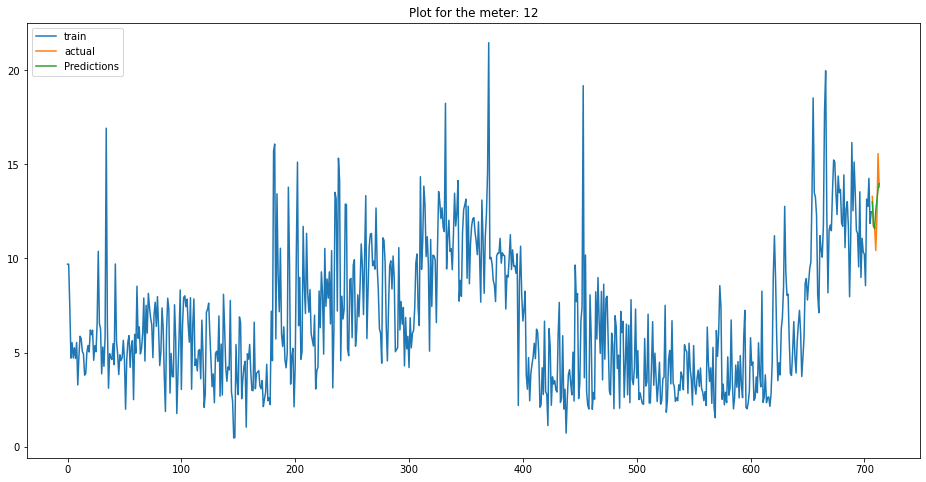

            ds       y
707 2021-07-08  13.292
708 2021-07-09  11.680
709 2021-07-10  11.707
710 2021-07-11  10.425
711 2021-07-12  12.097
712 2021-07-13  15.571
713 2021-07-14  13.801
            ds  Predictions
707 2021-07-08    13.014457
708 2021-07-09    11.764618
709 2021-07-10    11.576654
710 2021-07-11    12.521521
711 2021-07-12    13.093188
712 2021-07-13    13.675960
713 2021-07-14    13.978104
1.1871581194190097


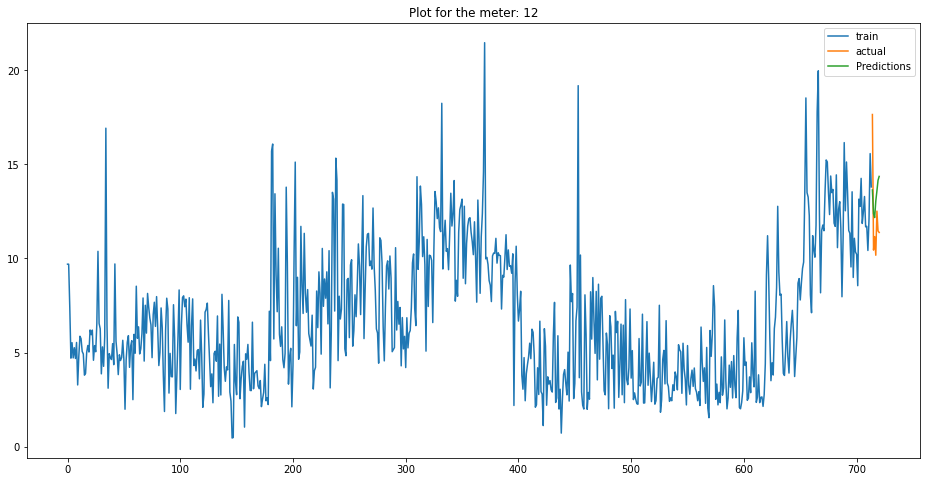

            ds       y
714 2021-07-15  17.649
715 2021-07-16  10.444
716 2021-07-17  11.161
717 2021-07-18  10.171
718 2021-07-19  12.515
719 2021-07-20  11.461
720 2021-07-21  11.381
            ds  Predictions
714 2021-07-15    13.640036
715 2021-07-16    12.377307
716 2021-07-17    12.172275
717 2021-07-18    13.046652
718 2021-07-19    13.586645
719 2021-07-20    14.155777
720 2021-07-21    14.359525
10.092019142060456


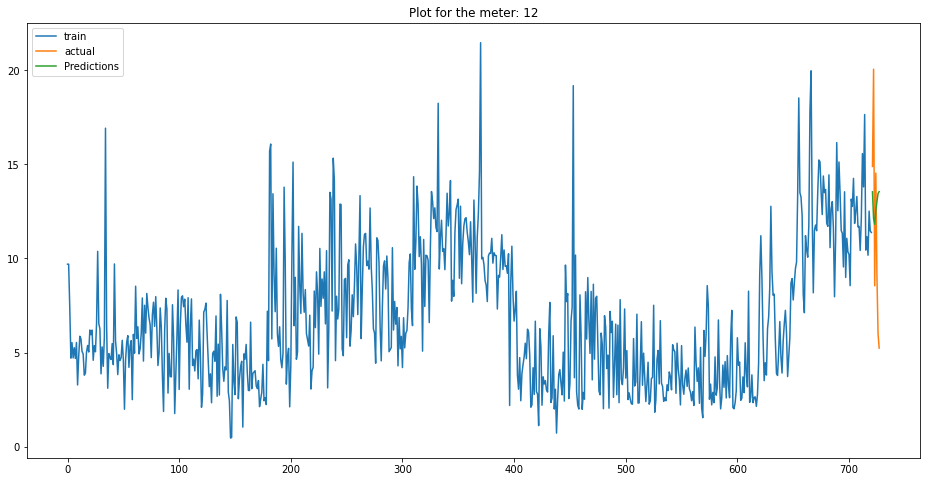

            ds       y
721 2021-07-22  14.887
722 2021-07-23  20.058
723 2021-07-24   8.550
724 2021-07-25  14.535
725 2021-07-26   9.069
726 2021-07-27   6.010
727 2021-07-28   5.238
            ds  Predictions
721 2021-07-22    13.541129
722 2021-07-23    12.107124
723 2021-07-24    11.817337
724 2021-07-25    12.557393
725 2021-07-26    13.011924
726 2021-07-27    13.454084
727 2021-07-28    13.551868
14.925726244044245


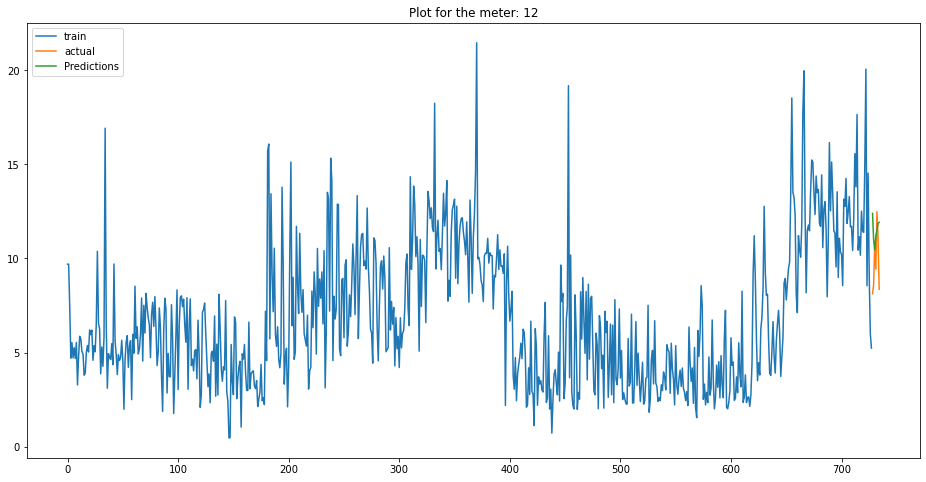

            ds       y
728 2021-07-29   8.122
729 2021-07-30   8.606
730 2021-07-31  10.904
731 2021-08-01   9.430
732 2021-08-02  12.485
733 2021-08-03  11.073
734 2021-08-04   8.365
            ds  Predictions
728 2021-07-29    12.394366
729 2021-07-30    10.975745
730 2021-07-31    10.457134
731 2021-08-01    11.194171
732 2021-08-02    11.503859
733 2021-08-03    11.859228
734 2021-08-04    11.917077
16.404407449451643
   mape_weekly  meterID    type
0        1.187       12  unflag
1       10.092       12  unflag
2       14.926       12  unflag
3       16.404       12  unflag


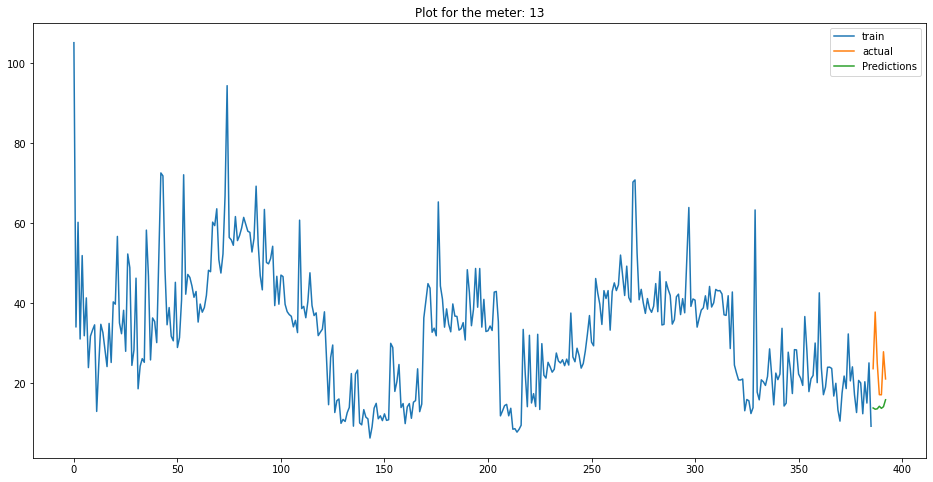

            ds       y
386 2021-07-07  23.689
387 2021-07-08  37.843
388 2021-07-09  25.026
389 2021-07-10  17.194
390 2021-07-11  17.164
391 2021-07-12  27.919
392 2021-07-13  21.124
            ds  Predictions
386 2021-07-07    13.879799
387 2021-07-08    13.564441
388 2021-07-09    13.662690
389 2021-07-10    14.302865
390 2021-07-11    13.786605
391 2021-07-12    14.189915
392 2021-07-13    15.921590
41.569492620732106


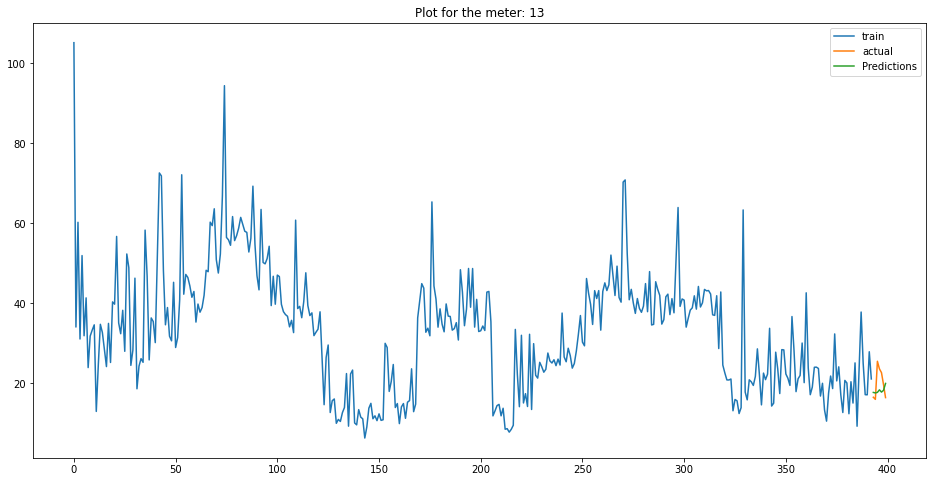

            ds       y
393 2021-07-14  16.553
394 2021-07-15  16.025
395 2021-07-16  25.540
396 2021-07-17  23.643
397 2021-07-18  22.706
398 2021-07-19  19.719
399 2021-07-20  16.463
            ds  Predictions
393 2021-07-14    17.754812
394 2021-07-15    17.632181
395 2021-07-16    17.772860
396 2021-07-17    18.398634
397 2021-07-18    17.840661
398 2021-07-19    18.282241
399 2021-07-20    20.004578
9.216584125583156


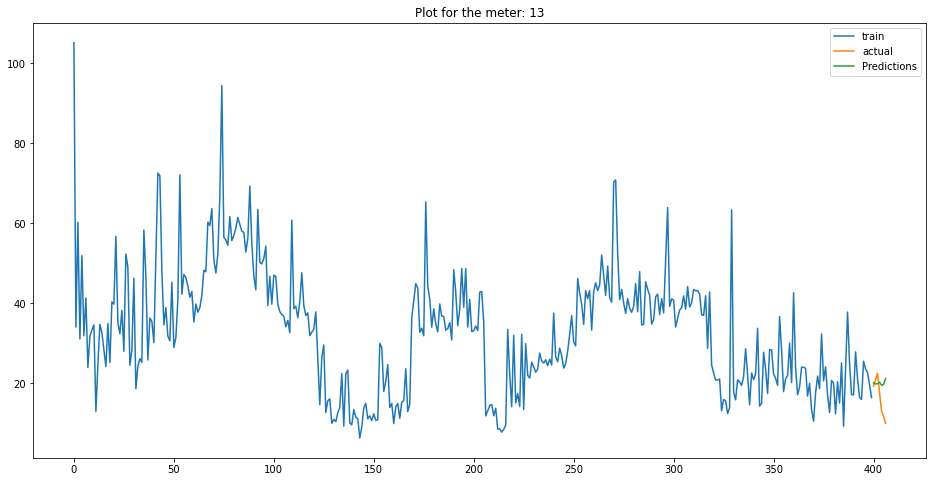

            ds       y
400 2021-07-21  19.299
401 2021-07-22  20.951
402 2021-07-23  22.549
403 2021-07-24  17.714
404 2021-07-25  13.102
405 2021-07-26  11.801
406 2021-07-27  10.003
            ds  Predictions
400 2021-07-21    20.152572
401 2021-07-22    19.879131
402 2021-07-23    19.925981
403 2021-07-24    20.323152
404 2021-07-25    19.545151
405 2021-07-26    19.744587
406 2021-07-27    21.218536
21.980877637730238


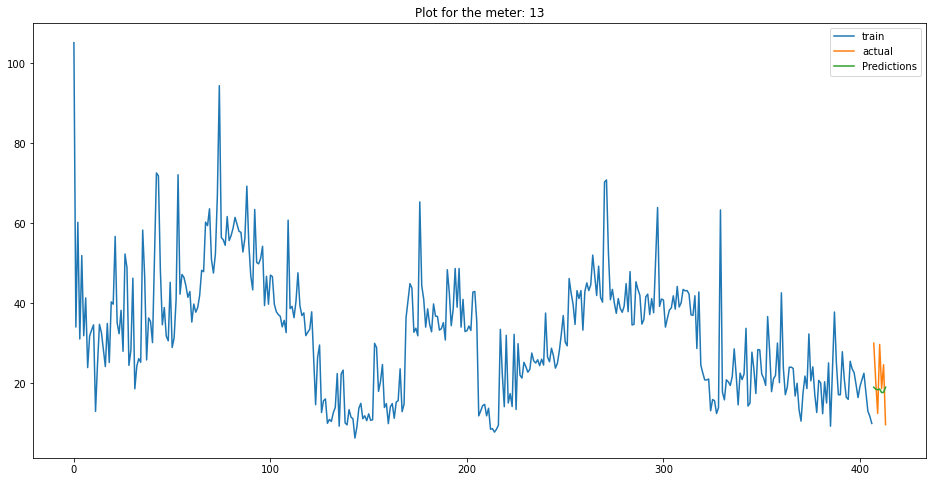

            ds       y
407 2021-07-28  30.045
408 2021-07-29  20.616
409 2021-07-30  12.503
410 2021-07-31  29.734
411 2021-08-01  18.705
412 2021-08-02  24.686
413 2021-08-03   9.708
            ds  Predictions
407 2021-07-28    19.054326
408 2021-07-29    18.592135
409 2021-07-30    18.425898
410 2021-07-31    18.612208
411 2021-08-01    17.714917
412 2021-08-02    17.781423
413 2021-08-03    19.062447
11.475336152704598
   mape_weekly  meterID    type
0       41.569       13  unflag
1        9.217       13  unflag
2       21.981       13  unflag
3       11.475       13  unflag


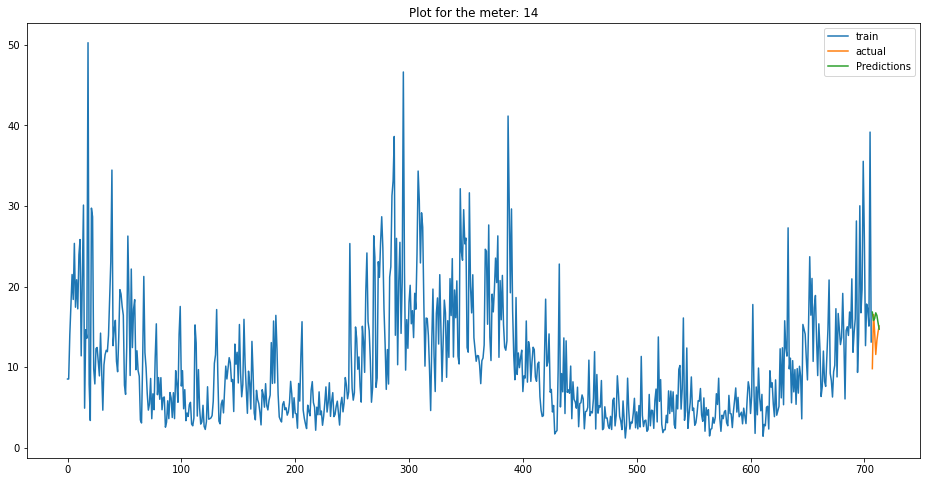

            ds       y
707 2021-07-08   9.813
708 2021-07-09  16.536
709 2021-07-10  14.430
710 2021-07-11  11.575
711 2021-07-12  13.313
712 2021-07-13  14.360
713 2021-07-14  15.114
            ds  Predictions
707 2021-07-08    16.835377
708 2021-07-09    15.793183
709 2021-07-10    16.028365
710 2021-07-11    16.744422
711 2021-07-12    16.414569
712 2021-07-13    15.536355
713 2021-07-14    14.720969
17.796995208769246


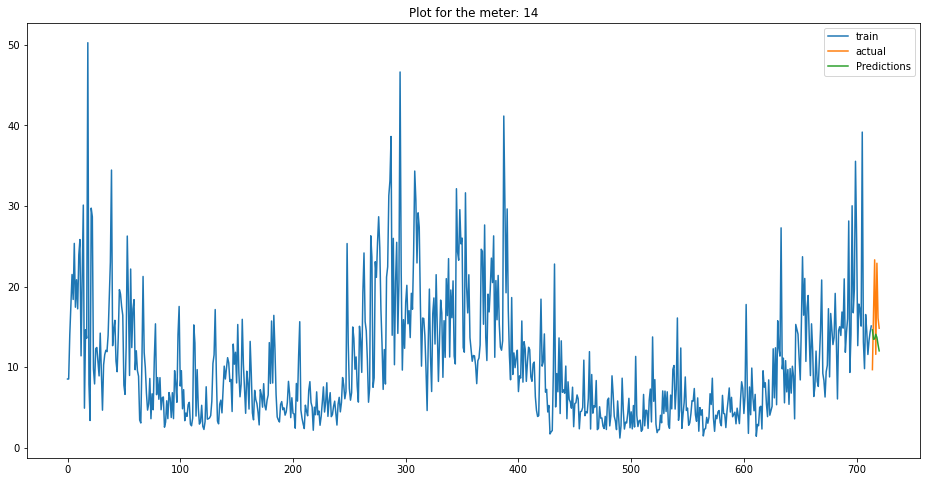

            ds       y
714 2021-07-15   9.690
715 2021-07-16  16.757
716 2021-07-17  23.322
717 2021-07-18  11.589
718 2021-07-19  22.900
719 2021-07-20  16.093
720 2021-07-21  14.833
            ds  Predictions
714 2021-07-15    14.636654
715 2021-07-16    13.458272
716 2021-07-17    13.518217
717 2021-07-18    14.083648
718 2021-07-19    13.688080
719 2021-07-20    12.805923
720 2021-07-21    12.023507
18.20539230611348


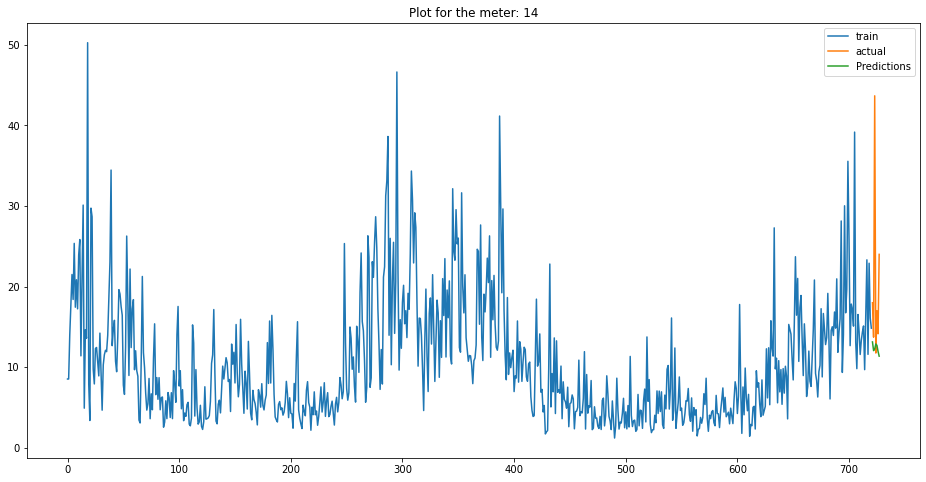

            ds       y
721 2021-07-22  18.000
722 2021-07-23  13.724
723 2021-07-24  43.682
724 2021-07-25  11.753
725 2021-07-26  17.011
726 2021-07-27  14.141
727 2021-07-28  23.999
            ds  Predictions
721 2021-07-22    13.131656
722 2021-07-23    12.053325
723 2021-07-24    12.251793
724 2021-07-25    12.879258
725 2021-07-26    12.710398
726 2021-07-27    11.961338
727 2021-07-28    11.367275
39.31906133165359


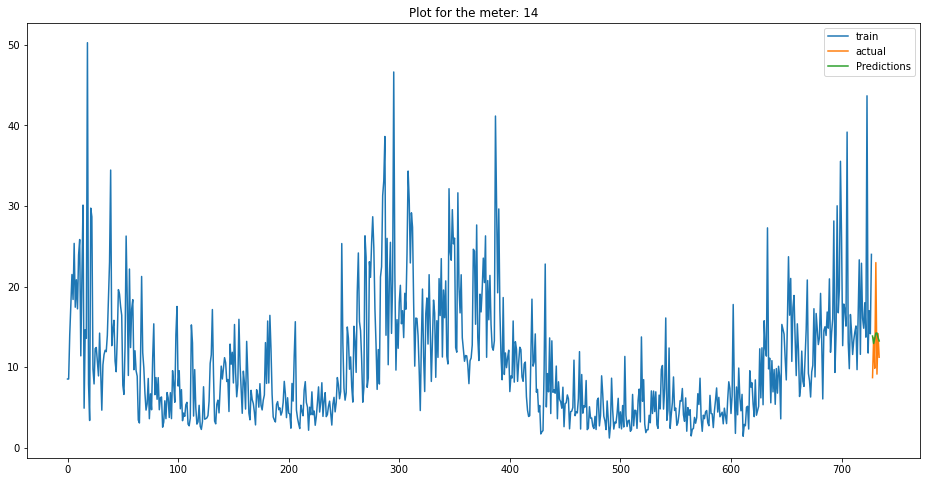

            ds       y
728 2021-07-29   8.701
729 2021-07-30  13.638
730 2021-07-31   9.861
731 2021-08-01  22.979
732 2021-08-02   9.134
733 2021-08-03  14.166
734 2021-08-04  11.234
            ds  Predictions
728 2021-07-29    13.862913
729 2021-07-30    12.939999
730 2021-07-31    13.566428
731 2021-08-01    14.219972
732 2021-08-02    14.246037
733 2021-08-03    13.656239
734 2021-08-04    13.252590
6.72274735420104
   mape_weekly  meterID    type
0       17.797       14  unflag
1       18.205       14  unflag
2       39.319       14  unflag
3        6.723       14  unflag


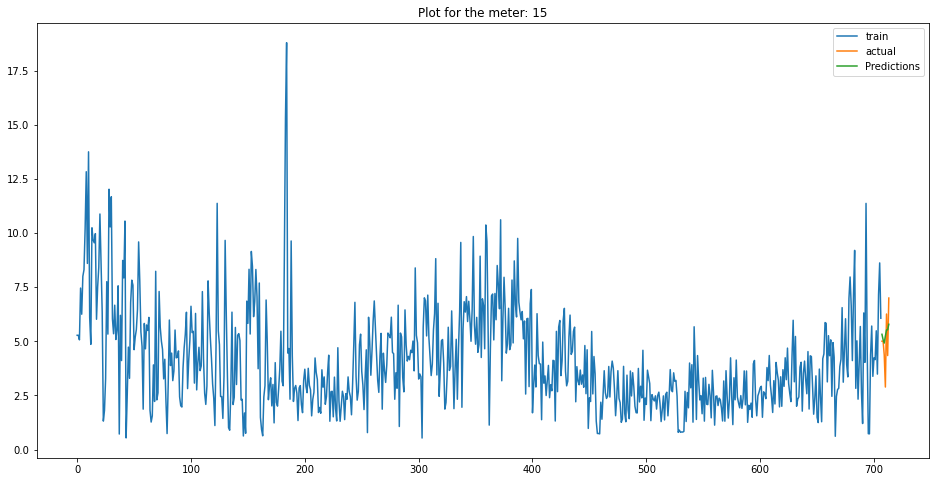

            ds      y
707 2021-07-08  5.006
708 2021-07-09  5.013
709 2021-07-10  4.370
710 2021-07-11  2.890
711 2021-07-12  6.261
712 2021-07-13  4.344
713 2021-07-14  6.999
            ds  Predictions
707 2021-07-08     5.325251
708 2021-07-09     5.075475
709 2021-07-10     4.920542
710 2021-07-11     5.246381
711 2021-07-12     5.526205
712 2021-07-13     5.534553
713 2021-07-14     5.787640
7.26154932195503


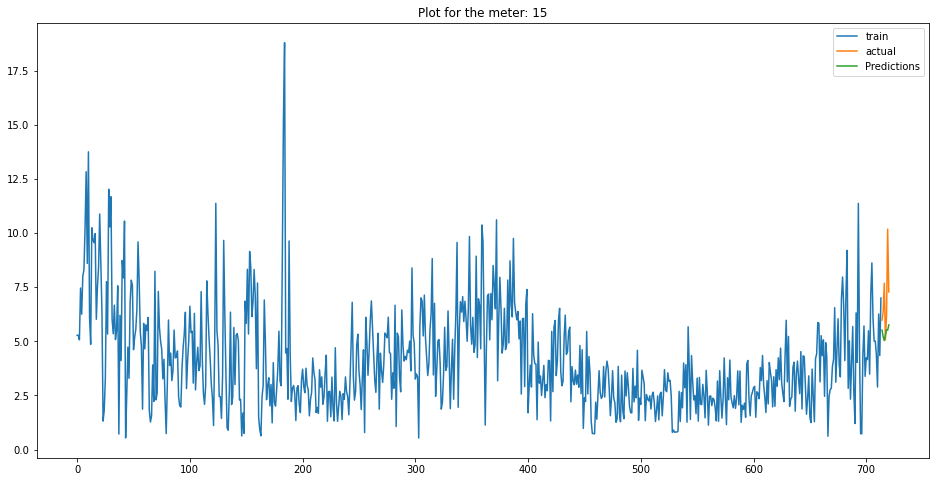

            ds       y
714 2021-07-15   5.981
715 2021-07-16   6.380
716 2021-07-17   7.685
717 2021-07-18   5.068
718 2021-07-19   6.215
719 2021-07-20  10.180
720 2021-07-21   7.282
            ds  Predictions
714 2021-07-15     5.518407
715 2021-07-16     5.213505
716 2021-07-17     5.033137
717 2021-07-18     5.298736
718 2021-07-19     5.532733
719 2021-07-20     5.513037
720 2021-07-21     5.758223
22.38777669160211


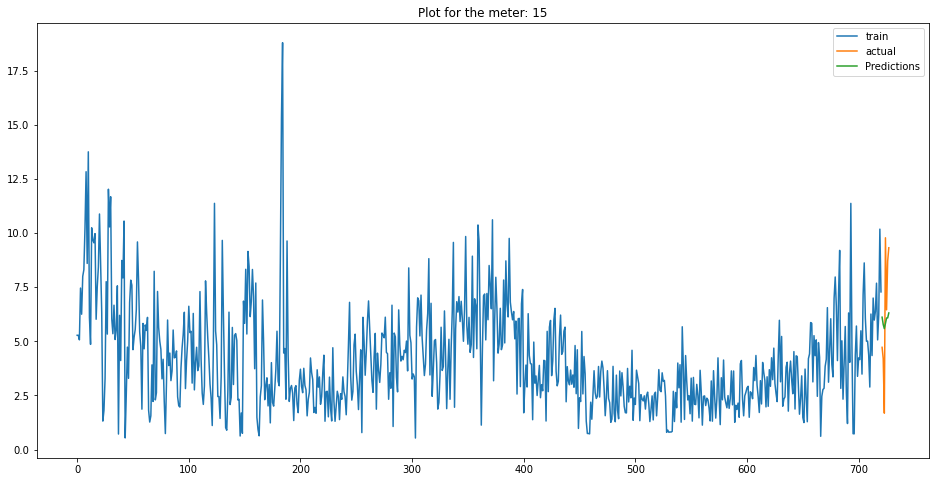

            ds      y
721 2021-07-22  4.724
722 2021-07-23  4.201
723 2021-07-24  1.684
724 2021-07-25  9.781
725 2021-07-26  6.454
726 2021-07-27  8.706
727 2021-07-28  9.321
            ds  Predictions
721 2021-07-22     6.115567
722 2021-07-23     5.779913
723 2021-07-24     5.585806
724 2021-07-25     5.827557
725 2021-07-26     6.076627
726 2021-07-27     6.082316
727 2021-07-28     6.310400
6.892676293669863


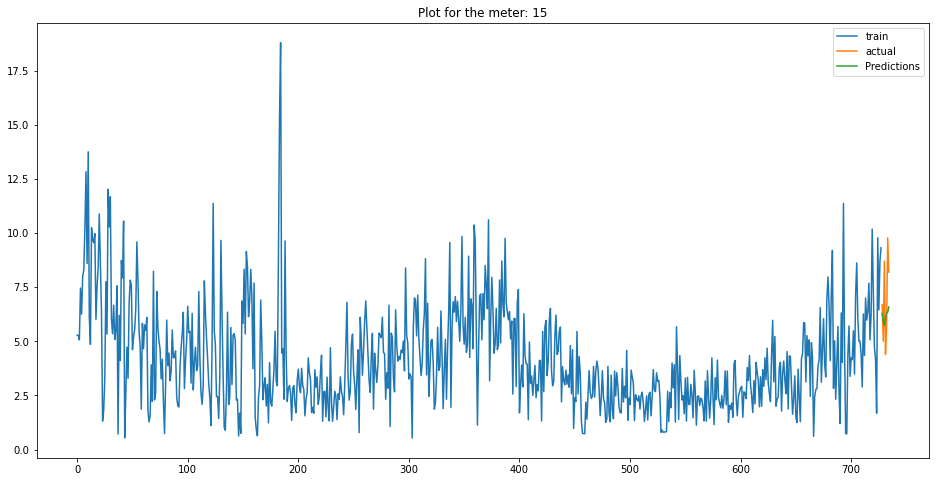

            ds      y
728 2021-07-29  6.694
729 2021-07-30  5.004
730 2021-07-31  8.703
731 2021-08-01  4.396
732 2021-08-02  5.663
733 2021-08-03  9.778
734 2021-08-04  8.194
            ds  Predictions
728 2021-07-29     6.289737
729 2021-07-30     5.950886
730 2021-07-31     5.735470
731 2021-08-01     6.059748
732 2021-08-02     6.308284
733 2021-08-03     6.339317
734 2021-08-04     6.587357
10.656590331785477
   mape_weekly  meterID    type
0        7.262       15  unflag
1       22.388       15  unflag
2        6.893       15  unflag
3       10.657       15  unflag


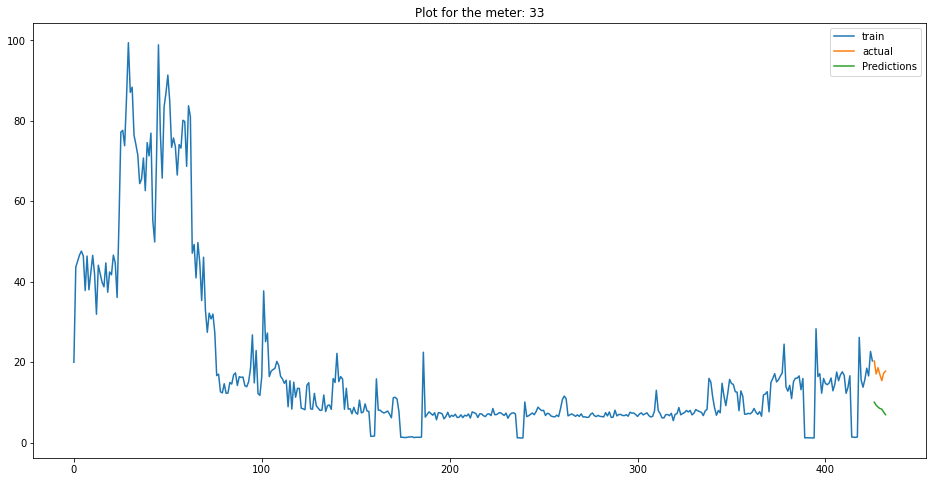

            ds       y
426 2021-07-08  20.283
427 2021-07-09  17.048
428 2021-07-10  18.618
429 2021-07-11  16.888
430 2021-07-12  15.407
431 2021-07-13  17.250
432 2021-07-14  17.743
            ds  Predictions
426 2021-07-08    10.041687
427 2021-07-09     9.304469
428 2021-07-10     8.829003
429 2021-07-11     8.459095
430 2021-07-12     8.320134
431 2021-07-13     7.570914
432 2021-07-14     6.940642
51.746680599806524


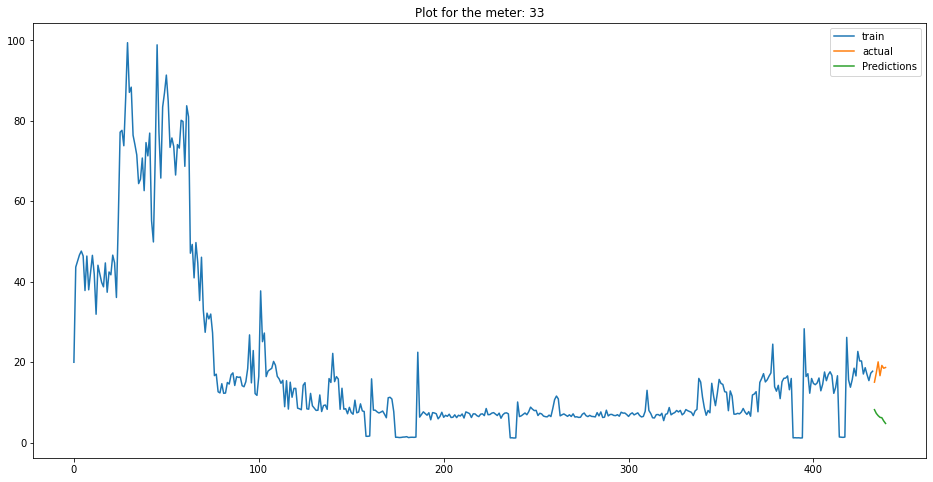

            ds       y
433 2021-07-15  15.018
434 2021-07-16  17.341
435 2021-07-17  20.065
436 2021-07-18  16.630
437 2021-07-19  19.176
438 2021-07-20  18.484
439 2021-07-21  18.665
            ds  Predictions
433 2021-07-15     8.184513
434 2021-07-16     7.264815
435 2021-07-17     6.697911
436 2021-07-18     6.278001
437 2021-07-19     6.182596
438 2021-07-20     5.384971
439 2021-07-21     4.760960
64.30521314516403


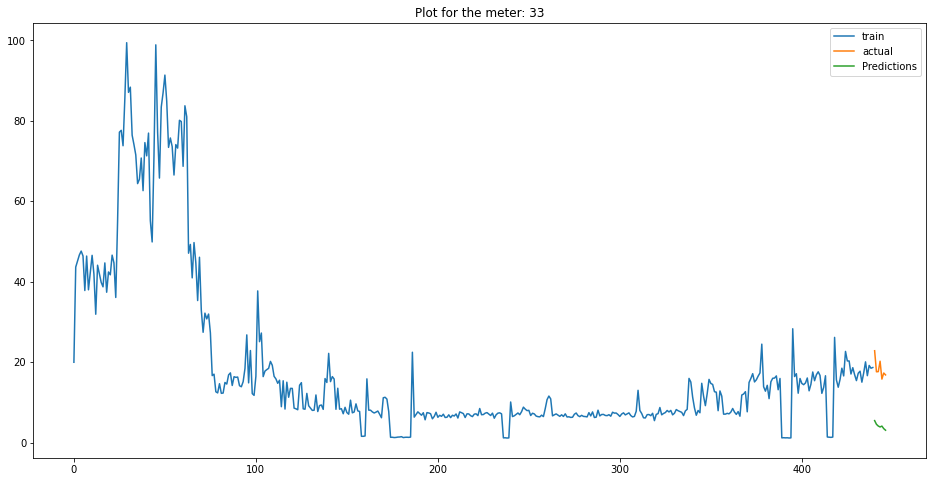

            ds       y
440 2021-07-22  22.836
441 2021-07-23  17.600
442 2021-07-24  17.633
443 2021-07-25  20.225
444 2021-07-26  15.783
445 2021-07-27  17.296
446 2021-07-28  16.820
            ds  Predictions
440 2021-07-22     5.467308
441 2021-07-23     4.550513
442 2021-07-24     4.117920
443 2021-07-25     3.882018
444 2021-07-26     4.102295
445 2021-07-27     3.473924
446 2021-07-28     3.078084
77.63367504369725


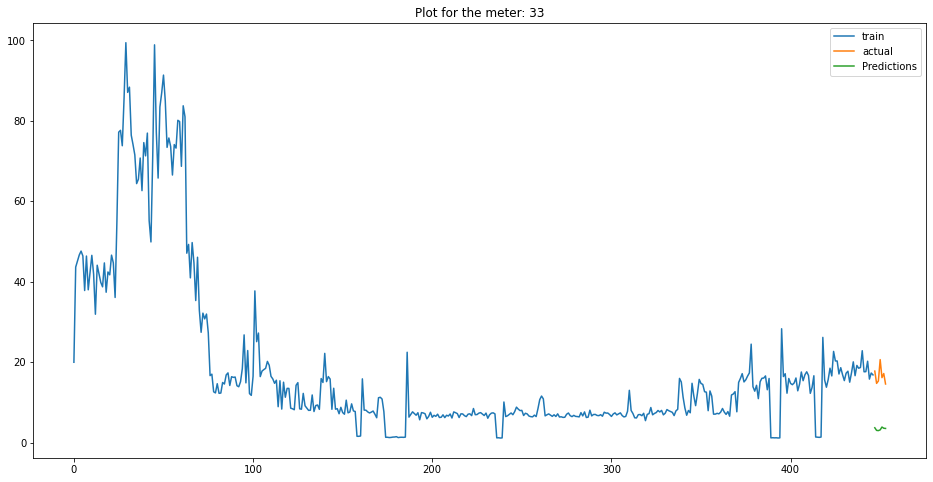

            ds       y
447 2021-07-29  17.768
448 2021-07-30  14.715
449 2021-07-31  15.315
450 2021-08-01  20.628
451 2021-08-02  16.147
452 2021-08-03  17.167
453 2021-08-04  14.565
            ds  Predictions
447 2021-07-29     3.687000
448 2021-07-30     3.032078
449 2021-07-31     2.981987
450 2021-08-01     3.159925
451 2021-08-02     3.868639
452 2021-08-03     3.570269
453 2021-08-04     3.518226
79.52098096174109
   mape_weekly  meterID  type
0       51.747       33  flag
1       64.305       33  flag
2       77.634       33  flag
3       79.521       33  flag


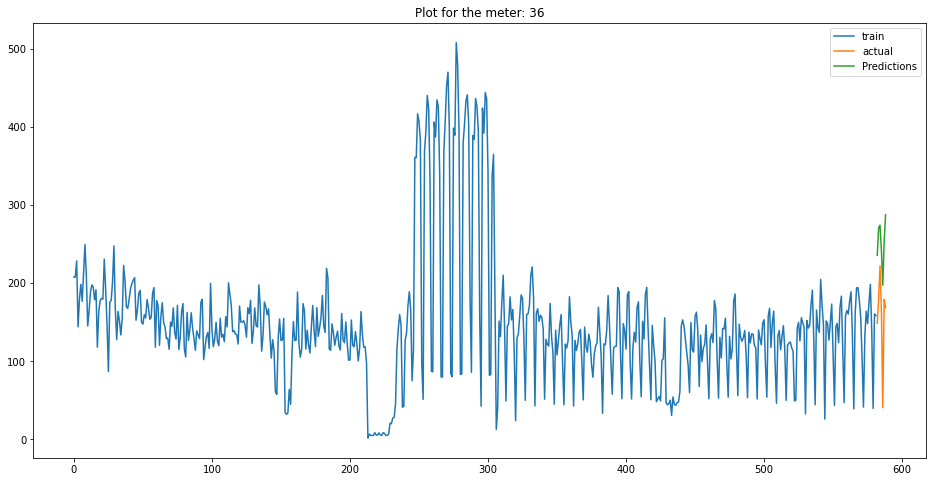

            ds        y
582 2021-06-03  148.772
583 2021-06-04  180.552
584 2021-06-05  222.170
585 2021-06-06  167.226
586 2021-06-07   40.776
587 2021-06-08  179.314
588 2021-06-09  168.730
            ds  Predictions
582 2021-06-03   235.656902
583 2021-06-04   271.093052
584 2021-06-05   274.357569
585 2021-06-06   242.399453
586 2021-06-07   197.506420
587 2021-06-08   253.052605
588 2021-06-09   287.609502
59.06202053061767


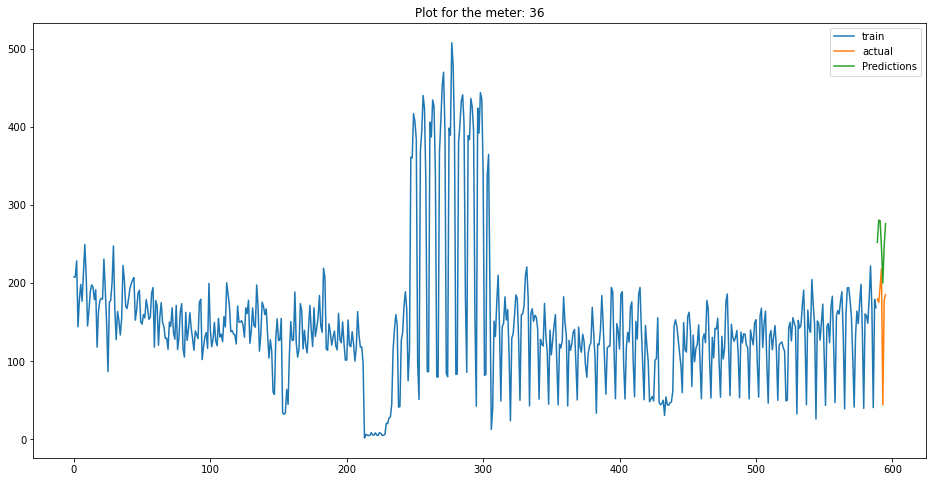

            ds        y
589 2021-06-10  179.906
590 2021-06-11  175.400
591 2021-06-12  194.940
592 2021-06-13  218.576
593 2021-06-14   44.072
594 2021-06-15  177.740
595 2021-06-16  185.544
            ds  Predictions
589 2021-06-10   252.329206
590 2021-06-11   280.792635
591 2021-06-12   280.081859
592 2021-06-13   246.566466
593 2021-06-14   200.299721
594 2021-06-15   247.602808
595 2021-06-16   276.241951
51.67046520870687


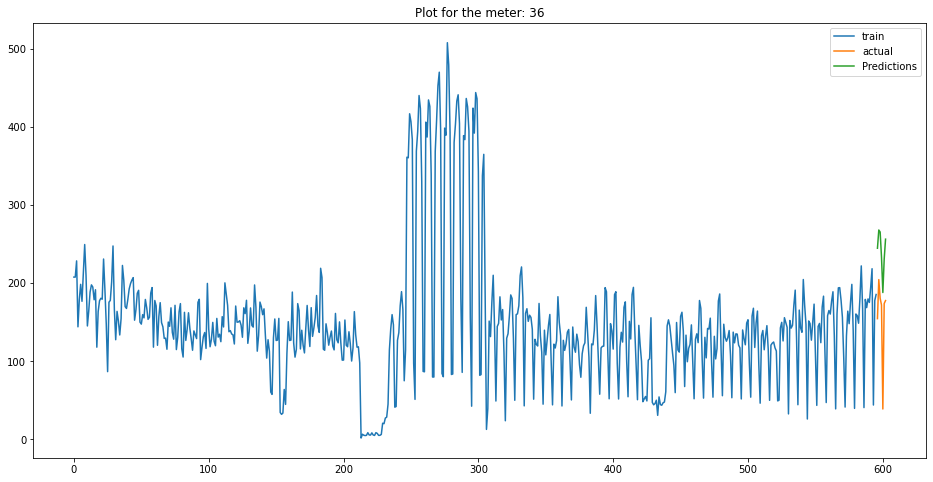

            ds        y
596 2021-06-17  154.642
597 2021-06-18  204.636
598 2021-06-19  180.734
599 2021-06-20  172.124
600 2021-06-21   38.986
601 2021-06-22  173.974
602 2021-06-23  177.794
            ds  Predictions
596 2021-06-17   244.781775
597 2021-06-18   268.128079
598 2021-06-19   265.520702
599 2021-06-20   233.489526
600 2021-06-21   188.085461
601 2021-06-22   230.808973
602 2021-06-23   256.395565
52.98081226370219


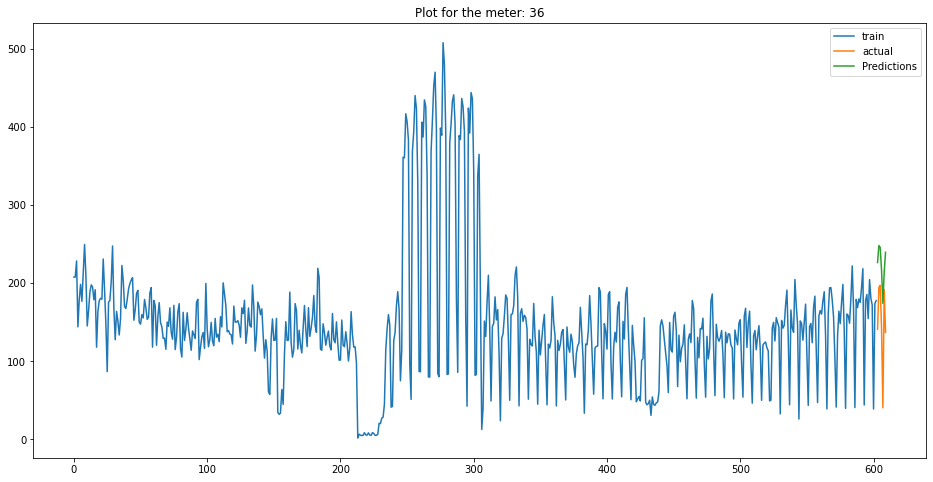

            ds        y
603 2021-06-24  140.902
604 2021-06-25  194.762
605 2021-06-26  197.236
606 2021-06-27  142.422
607 2021-06-28   40.538
608 2021-06-29  191.780
609 2021-06-30  137.056
            ds  Predictions
603 2021-06-24   226.468981
604 2021-06-25   248.299826
605 2021-06-26   245.716527
606 2021-06-27   216.407550
607 2021-06-28   174.229113
608 2021-06-29   214.405008
609 2021-06-30   239.597756
49.81628716995446
   mape_weekly  meterID    type
0       59.062       36    flag
1       51.670       36    flag
2       52.981       36    flag
3       49.816       36  unflag


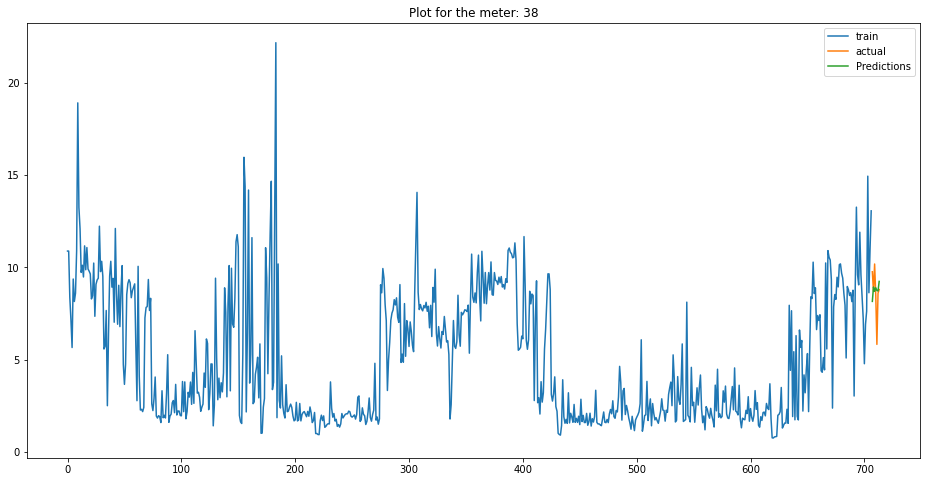

            ds       y
707 2021-07-08   9.761
708 2021-07-09   8.701
709 2021-07-10  10.181
710 2021-07-11   8.492
711 2021-07-12   5.822
712 2021-07-13   8.598
713 2021-07-14   8.799
            ds  Predictions
707 2021-07-08     8.153916
708 2021-07-09     8.935028
709 2021-07-10     8.698642
710 2021-07-11     8.891453
711 2021-07-12     8.740627
712 2021-07-13     8.722475
713 2021-07-14     9.237011
1.6985676650525035


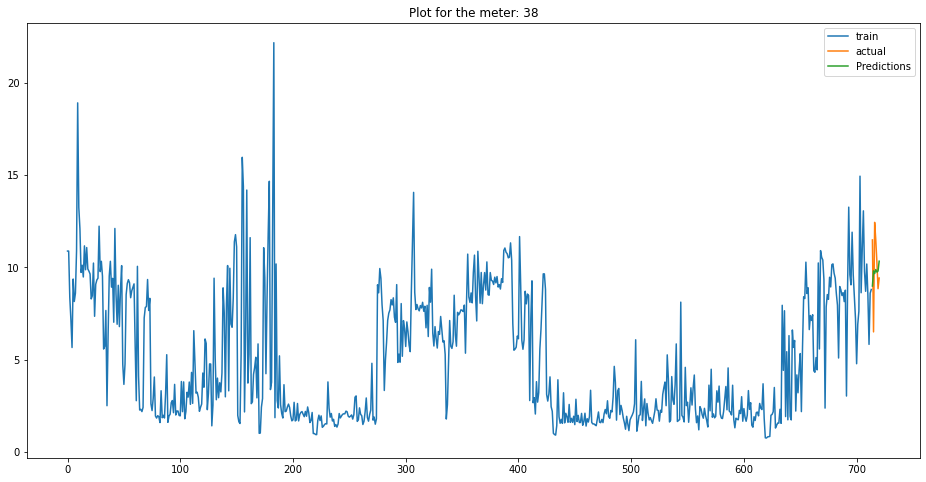

            ds       y
714 2021-07-15  11.488
715 2021-07-16   6.499
716 2021-07-17  12.441
717 2021-07-18  11.480
718 2021-07-19  10.265
719 2021-07-20   8.843
720 2021-07-21   9.421
            ds  Predictions
714 2021-07-15     8.986495
715 2021-07-16     9.810415
716 2021-07-17     9.661395
717 2021-07-18     9.881255
718 2021-07-19     9.742641
719 2021-07-20     9.800415
720 2021-07-21    10.333825
3.152546205457859


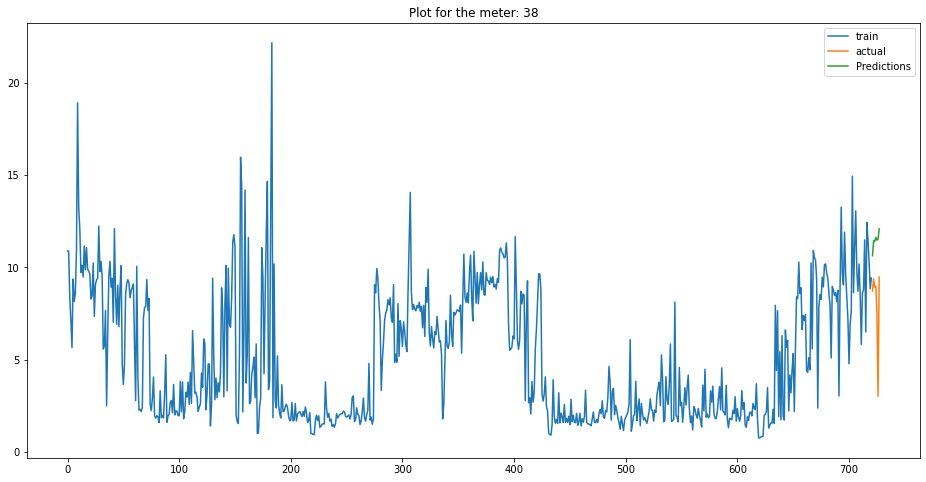

            ds      y
721 2021-07-22  8.711
722 2021-07-23  9.379
723 2021-07-24  8.924
724 2021-07-25  8.987
725 2021-07-26  7.514
726 2021-07-27  3.010
727 2021-07-28  9.473
            ds  Predictions
721 2021-07-22    10.627331
722 2021-07-23    11.446170
723 2021-07-24    11.399298
724 2021-07-25    11.630356
725 2021-07-26    11.476318
726 2021-07-27    11.524326
727 2021-07-28    12.084825
43.19908333241863


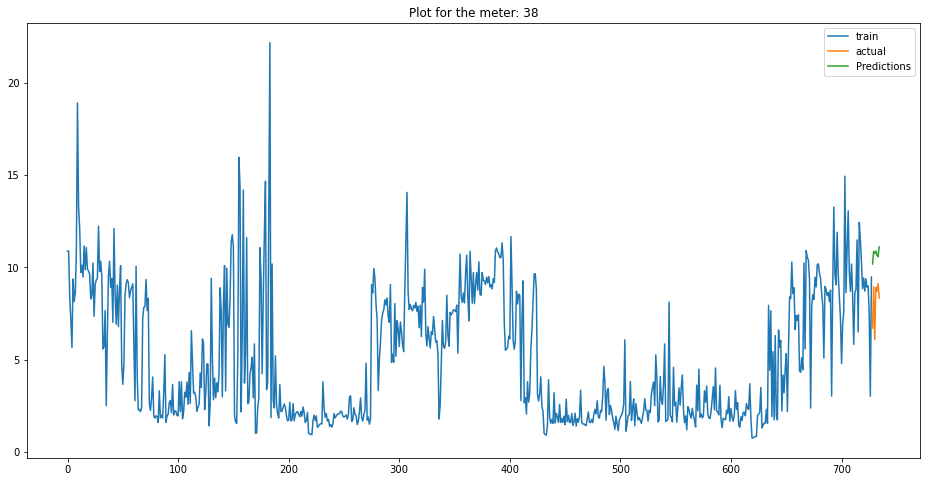

            ds      y
728 2021-07-29  6.699
729 2021-07-30  8.956
730 2021-07-31  6.082
731 2021-08-01  8.911
732 2021-08-02  8.709
733 2021-08-03  9.120
734 2021-08-04  8.334
            ds  Predictions
728 2021-07-29    10.177237
729 2021-07-30    10.860211
730 2021-07-31    10.753865
731 2021-08-01    10.884149
732 2021-08-02    10.659352
733 2021-08-03    10.579908
734 2021-08-04    11.109426
32.05919223963668
   mape_weekly  meterID    type
0        1.699       38  unflag
1        3.153       38  unflag
2       43.199       38  unflag
3       32.059       38  unflag


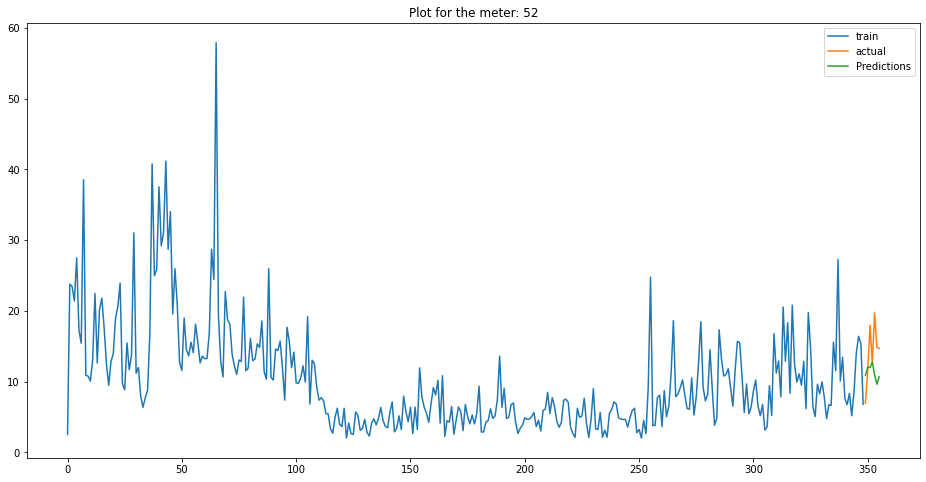

            ds       y
349 2021-07-07   6.955
350 2021-07-08  11.538
351 2021-07-09  17.986
352 2021-07-10  12.612
353 2021-07-11  19.722
354 2021-07-12  14.854
355 2021-07-13  14.712
            ds  Predictions
349 2021-07-07    10.902951
350 2021-07-08    12.057036
351 2021-07-09    11.991456
352 2021-07-10    12.778024
353 2021-07-11    11.011795
354 2021-07-12     9.630323
355 2021-07-13    10.680662
19.64520050117141


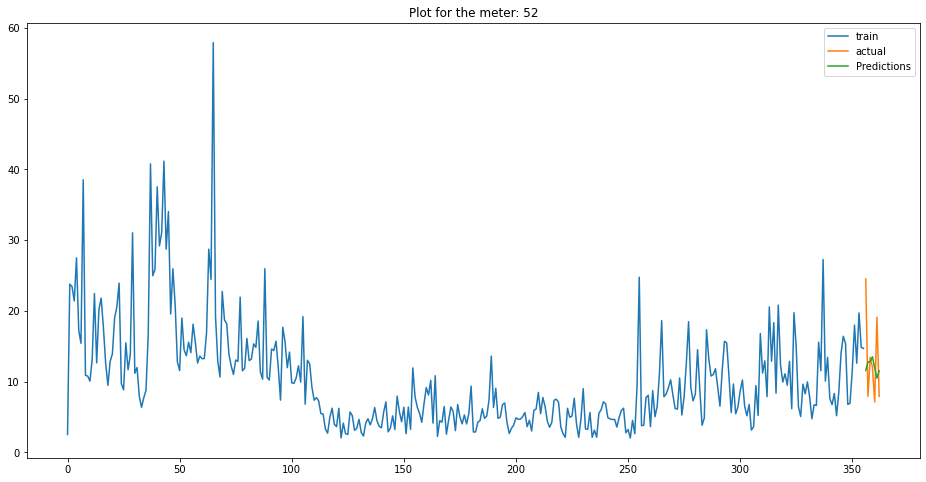

            ds       y
356 2021-07-14  24.533
357 2021-07-15   7.945
358 2021-07-16  13.442
359 2021-07-17  12.064
360 2021-07-18   7.136
361 2021-07-19  19.098
362 2021-07-20   7.929
            ds  Predictions
356 2021-07-14    11.566260
357 2021-07-15    12.789773
358 2021-07-16    12.856672
359 2021-07-17    13.520590
360 2021-07-18    11.952360
361 2021-07-19    10.502257
362 2021-07-20    11.531042
8.06108337588325


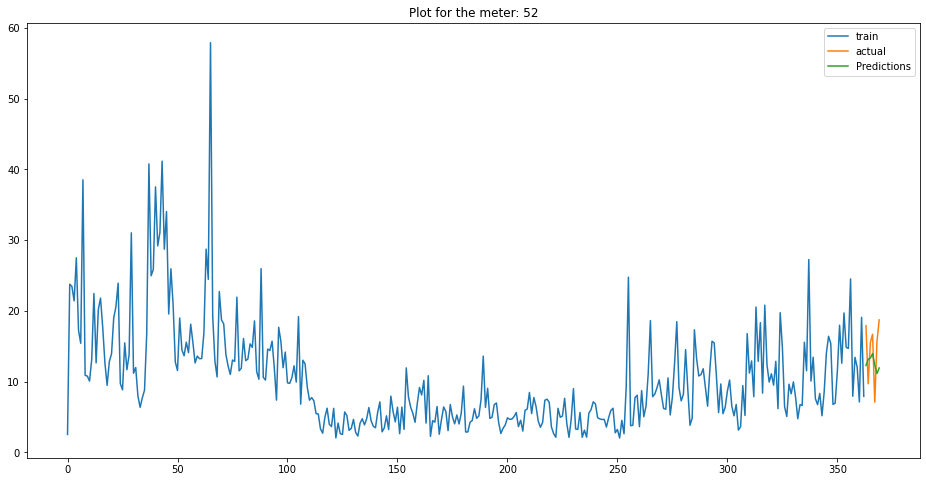

            ds       y
363 2021-07-21  17.921
364 2021-07-22   9.704
365 2021-07-23  15.562
366 2021-07-24  16.706
367 2021-07-25   7.112
368 2021-07-26  15.682
369 2021-07-27  18.730
            ds  Predictions
363 2021-07-21    12.295225
364 2021-07-22    13.170800
365 2021-07-23    13.350468
366 2021-07-24    13.973967
367 2021-07-25    12.338958
368 2021-07-26    11.152598
369 2021-07-27    11.939335
13.011278687450586


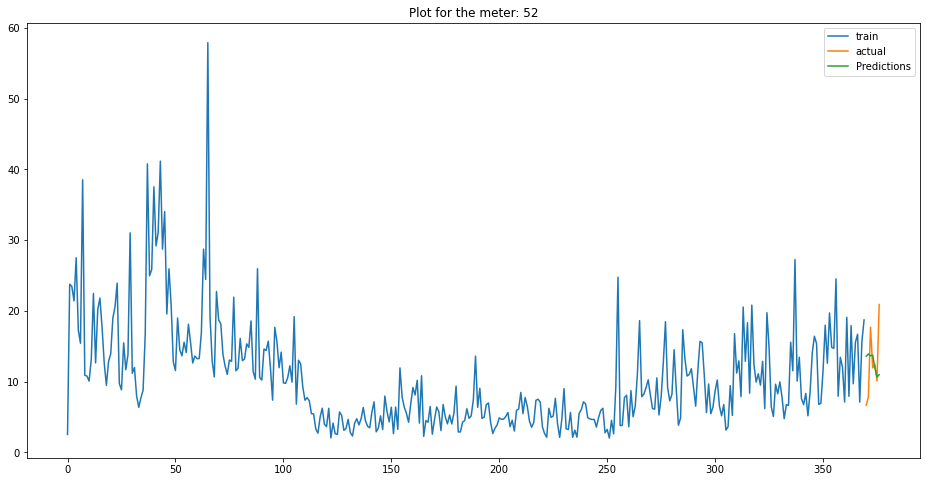

            ds       y
370 2021-07-28   6.674
371 2021-07-29   7.848
372 2021-07-30  17.700
373 2021-07-31  11.958
374 2021-08-01  12.475
375 2021-08-02  10.112
376 2021-08-03  20.910
            ds  Predictions
370 2021-07-28    13.607463
371 2021-07-29    13.921515
372 2021-07-30    13.652492
373 2021-07-31    13.767539
374 2021-08-01    11.946005
375 2021-08-02    10.643150
376 2021-08-03    10.992622
0.9737858630175464
   mape_weekly  meterID    type
0       19.645       52  unflag
1        8.061       52  unflag
2       13.011       52  unflag
3        0.974       52  unflag


In [852]:
for i in TOU_list_above365:
    account_and_days_billcycle11(i,'peak')

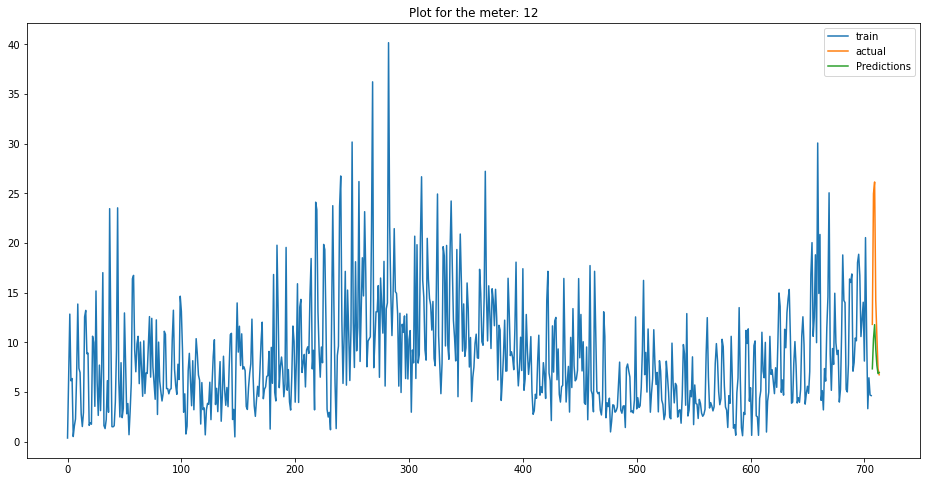

            ds       y
707 2021-07-08  11.799
708 2021-07-09  24.952
709 2021-07-10  26.139
710 2021-07-11  14.243
711 2021-07-12  10.544
712 2021-07-13   7.329
713 2021-07-14   6.725
            ds  Predictions
707 2021-07-08     7.323021
708 2021-07-09    10.325202
709 2021-07-10    11.771357
710 2021-07-11     9.326826
711 2021-07-12     7.660051
712 2021-07-13     6.845566
713 2021-07-14     6.952458
40.819926838079105


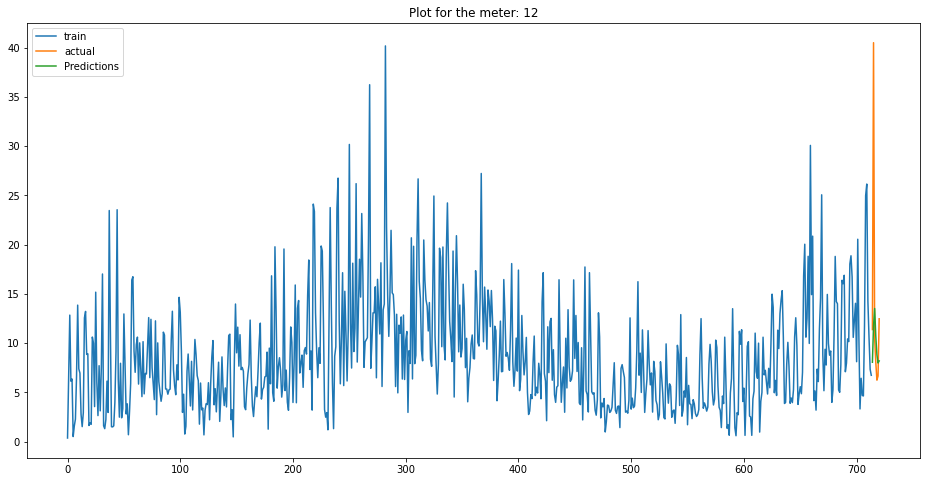

            ds       y
714 2021-07-15  11.367
715 2021-07-16  40.490
716 2021-07-17  10.397
717 2021-07-18   8.037
718 2021-07-19   6.230
719 2021-07-20   6.655
720 2021-07-21  12.462
            ds  Predictions
714 2021-07-15     8.048205
715 2021-07-16    11.733562
716 2021-07-17    13.502060
717 2021-07-18    10.706549
718 2021-07-19     8.819625
719 2021-07-20     7.972745
720 2021-07-21     8.182532
27.889249556110446


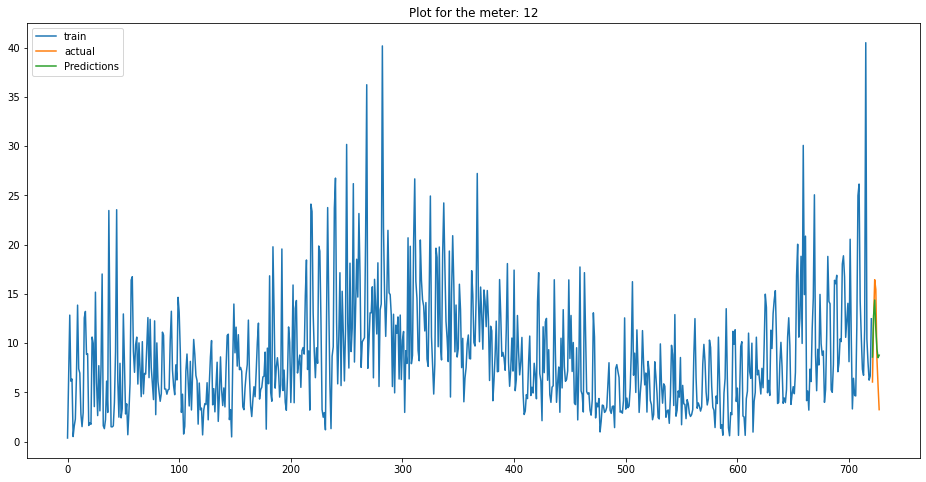

            ds       y
721 2021-07-22   6.044
722 2021-07-23  12.327
723 2021-07-24  16.425
724 2021-07-25  15.443
725 2021-07-26   8.408
726 2021-07-27   5.701
727 2021-07-28   3.236
            ds  Predictions
721 2021-07-22     8.578900
722 2021-07-23    12.764616
723 2021-07-24    14.364588
724 2021-07-25    11.413974
725 2021-07-26     9.408693
726 2021-07-27     8.513665
727 2021-07-28     8.764667
9.21090996829056


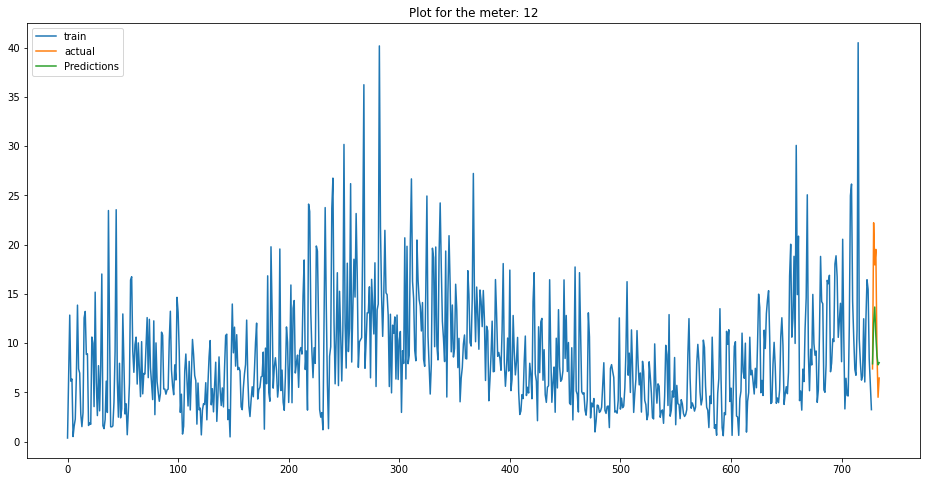

            ds       y
728 2021-07-29   7.376
729 2021-07-30  22.206
730 2021-07-31  17.932
731 2021-08-01  19.506
732 2021-08-02   9.062
733 2021-08-03   4.493
734 2021-08-04   6.445
            ds  Predictions
728 2021-07-29     7.894168
729 2021-07-30    12.044722
730 2021-07-31    13.654277
731 2021-08-01    10.740451
732 2021-08-02     8.728776
733 2021-08-03     7.788437
734 2021-08-04     8.003125
20.875711600134302
   mape_weekly  meterID    type
0       40.820       12  unflag
1       27.889       12  unflag
2        9.211       12  unflag
3       20.876       12  unflag


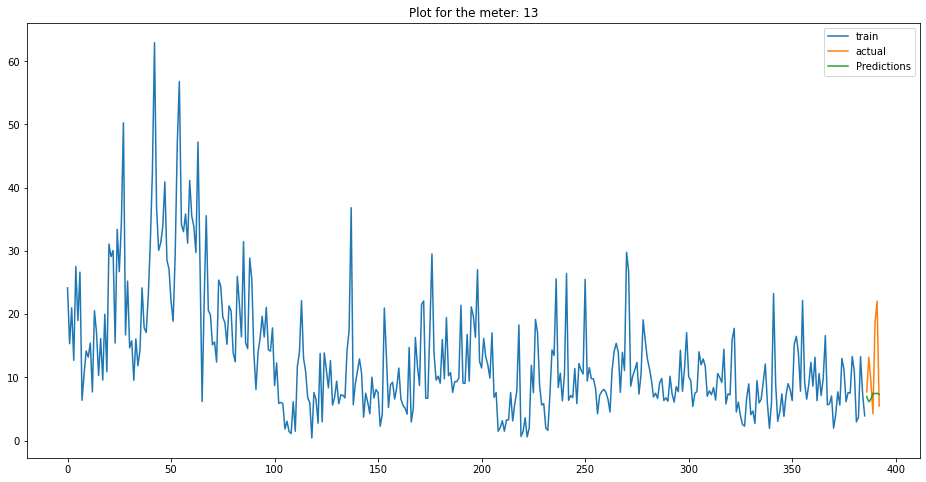

            ds       y
386 2021-07-07   7.680
387 2021-07-08  13.190
388 2021-07-09   9.431
389 2021-07-10   4.214
390 2021-07-11  18.647
391 2021-07-12  22.049
392 2021-07-13   5.458
            ds  Predictions
386 2021-07-07     6.958367
387 2021-07-08     6.120054
388 2021-07-09     6.528772
389 2021-07-10     7.509408
390 2021-07-11     7.399172
391 2021-07-12     7.483683
392 2021-07-13     7.286853
38.90303674165594


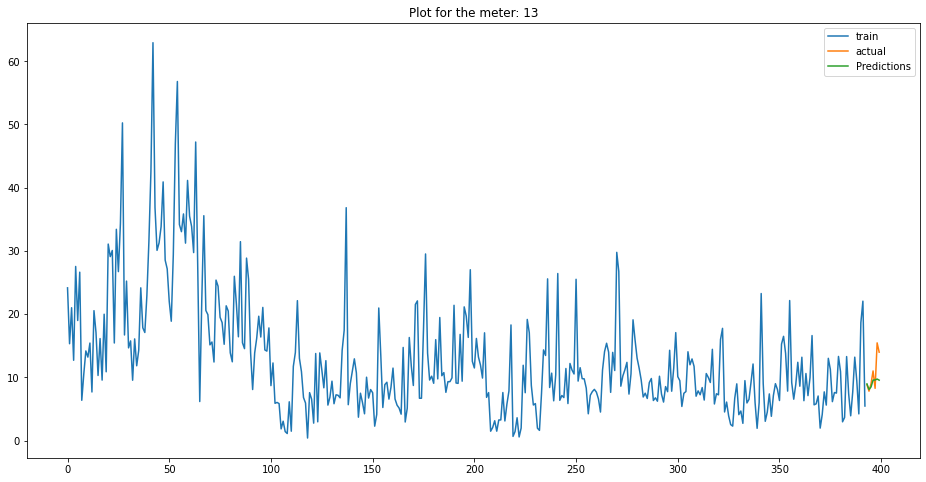

            ds       y
393 2021-07-14   8.825
394 2021-07-15   7.807
395 2021-07-16   8.978
396 2021-07-17  11.009
397 2021-07-18   8.258
398 2021-07-19  15.451
399 2021-07-20  13.980
            ds  Predictions
393 2021-07-14     8.955439
394 2021-07-15     8.080524
395 2021-07-16     8.480825
396 2021-07-17     9.562914
397 2021-07-18     9.578003
398 2021-07-19     9.729791
399 2021-07-20     9.548803
13.95771756851937


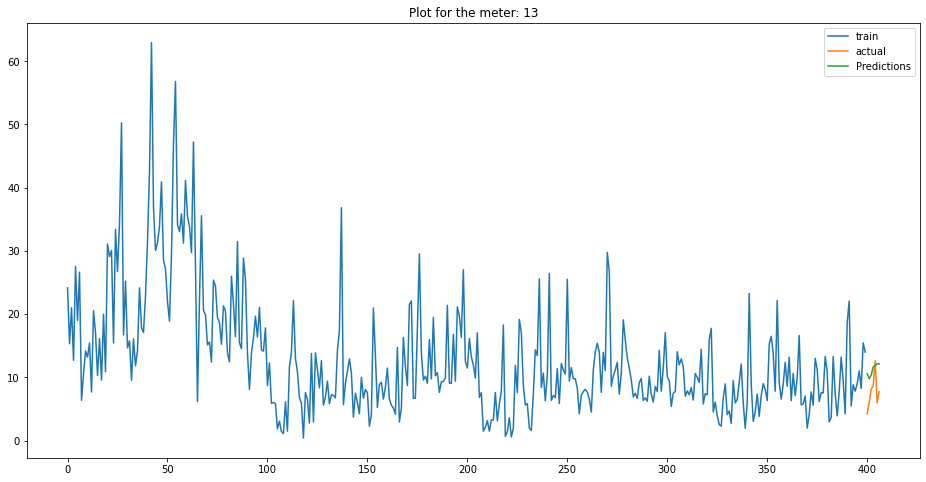

            ds       y
400 2021-07-21   4.237
401 2021-07-22   5.984
402 2021-07-23   8.144
403 2021-07-24   8.606
404 2021-07-25  12.608
405 2021-07-26   5.985
406 2021-07-27   7.708
            ds  Predictions
400 2021-07-21    10.558565
401 2021-07-22     9.781887
402 2021-07-23    10.330428
403 2021-07-24    11.644561
404 2021-07-25    11.821710
405 2021-07-26    12.153411
406 2021-07-27    12.120759
47.19049680835317


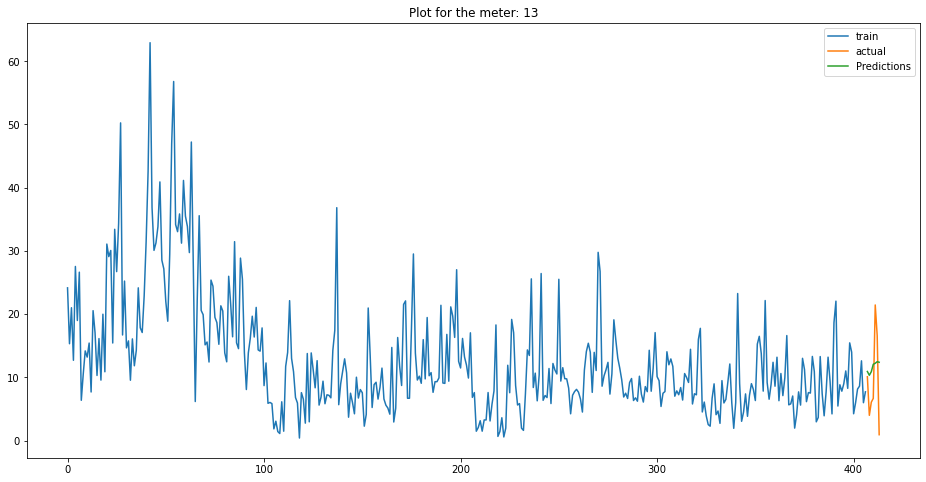

            ds       y
407 2021-07-28  10.092
408 2021-07-29   3.987
409 2021-07-30   6.068
410 2021-07-31   6.665
411 2021-08-01  21.447
412 2021-08-02  16.578
413 2021-08-03   0.925
            ds  Predictions
407 2021-07-28    10.920138
408 2021-07-29    10.321992
409 2021-07-30    10.893792
410 2021-07-31    12.065131
411 2021-08-01    12.222110
412 2021-08-02    12.472083
413 2021-08-03    12.382279
23.593449733075424
   mape_weekly  meterID    type
0       38.903       13  unflag
1       13.958       13  unflag
2       47.190       13  unflag
3       23.593       13  unflag


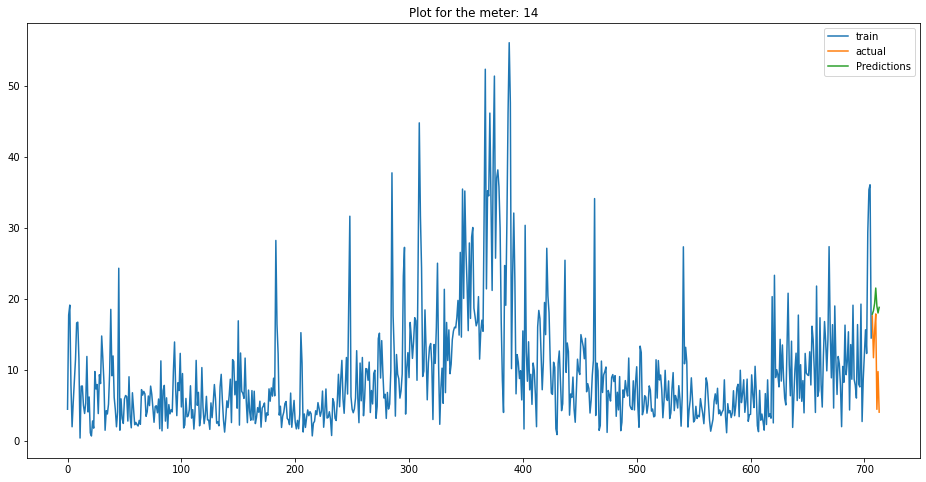

            ds       y
707 2021-07-08  17.644
708 2021-07-09  11.753
709 2021-07-10  15.582
710 2021-07-11  17.920
711 2021-07-12   4.484
712 2021-07-13   9.804
713 2021-07-14   4.088
            ds  Predictions
707 2021-07-08    17.884216
708 2021-07-09    18.385807
709 2021-07-10    19.401567
710 2021-07-11    21.562924
711 2021-07-12    19.018292
712 2021-07-13    18.052876
713 2021-07-14    18.842848
63.82470699672144


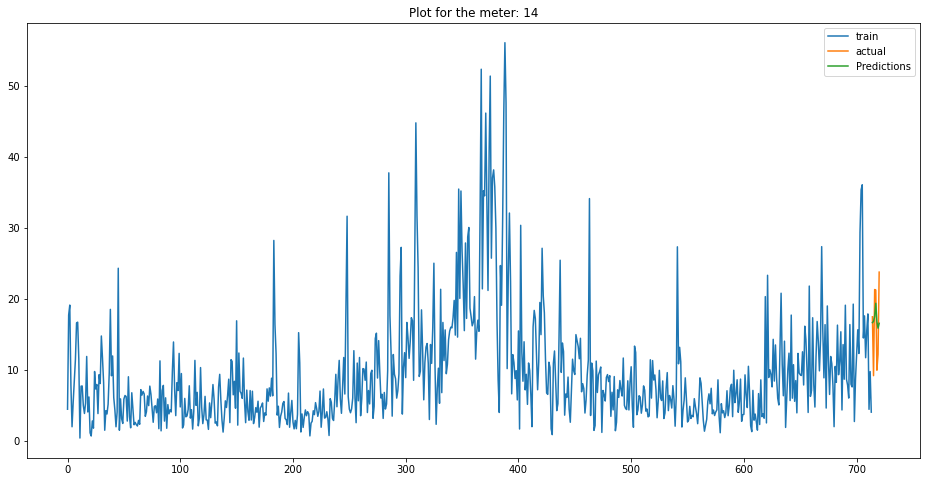

            ds       y
714 2021-07-15  17.515
715 2021-07-16   9.226
716 2021-07-17  21.355
717 2021-07-18  21.281
718 2021-07-19   9.995
719 2021-07-20  12.236
720 2021-07-21  23.806
            ds  Predictions
714 2021-07-15    16.694580
715 2021-07-16    16.870464
716 2021-07-17    17.592380
717 2021-07-18    19.412782
718 2021-07-19    16.818439
719 2021-07-20    15.913664
720 2021-07-21    16.599265
3.888241255848456


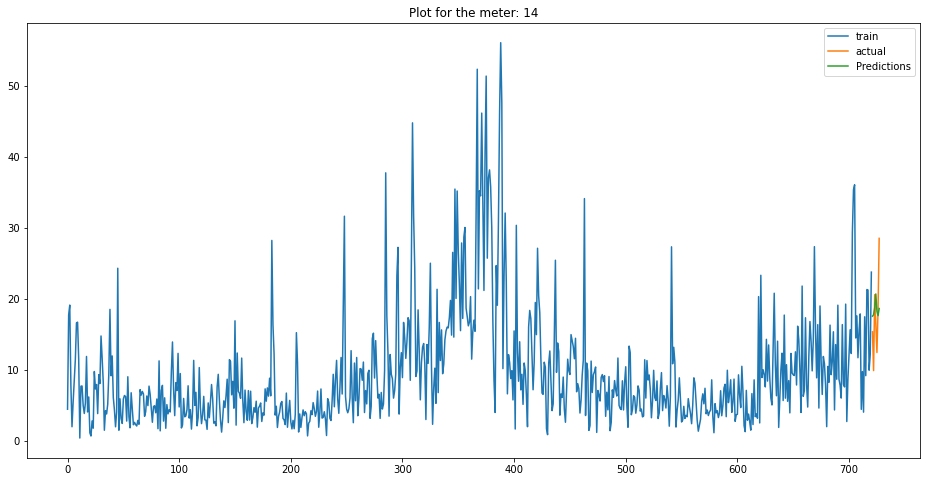

            ds       y
721 2021-07-22  15.399
722 2021-07-23   9.937
723 2021-07-24  20.631
724 2021-07-25  16.425
725 2021-07-26  12.487
726 2021-07-27  18.555
727 2021-07-28  28.560
            ds  Predictions
721 2021-07-22    17.601291
722 2021-07-23    17.807656
723 2021-07-24    18.779166
724 2021-07-25    20.732674
725 2021-07-26    18.298926
726 2021-07-27    17.676789
727 2021-07-28    18.686647
6.22092021829344


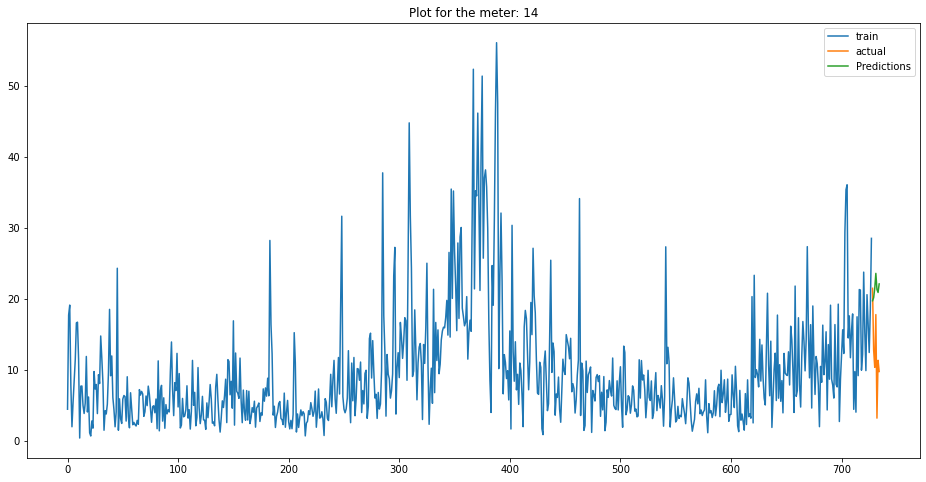

            ds       y
728 2021-07-29  21.528
729 2021-07-30  12.849
730 2021-07-31  10.396
731 2021-08-01  17.828
732 2021-08-02   3.245
733 2021-08-03  11.390
734 2021-08-04   9.811
            ds  Predictions
728 2021-07-29    19.776373
729 2021-07-30    20.196287
730 2021-07-31    21.501483
731 2021-08-01    23.628954
732 2021-08-02    21.349100
733 2021-08-03    20.943779
734 2021-08-04    22.140046
71.78767968458543
   mape_weekly  meterID    type
0       63.825       14    flag
1        3.888       14  unflag
2        6.221       14  unflag
3       71.788       14    flag


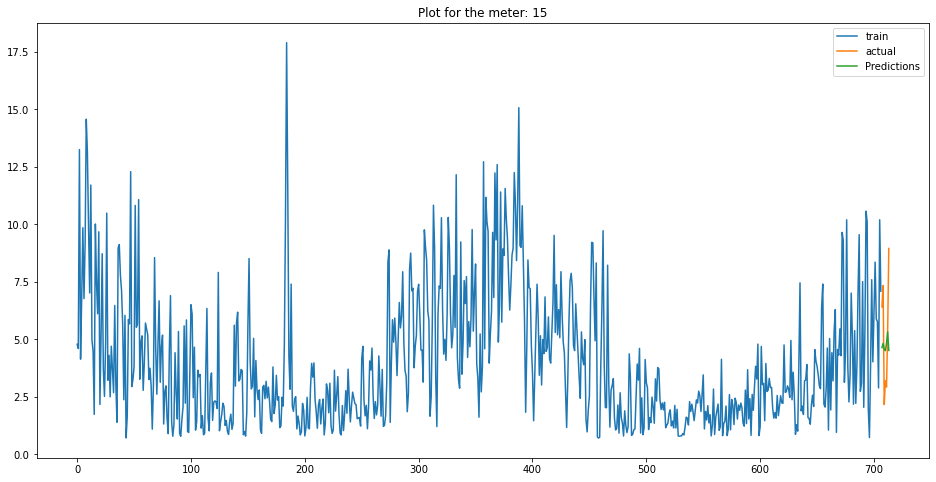

            ds      y
707 2021-07-08  6.415
708 2021-07-09  7.344
709 2021-07-10  2.170
710 2021-07-11  3.200
711 2021-07-12  2.932
712 2021-07-13  5.352
713 2021-07-14  8.957
            ds  Predictions
707 2021-07-08     4.646112
708 2021-07-09     4.831399
709 2021-07-10     4.563818
710 2021-07-11     4.514501
711 2021-07-12     4.836306
712 2021-07-13     5.335474
713 2021-07-14     4.523247
8.576145172440834


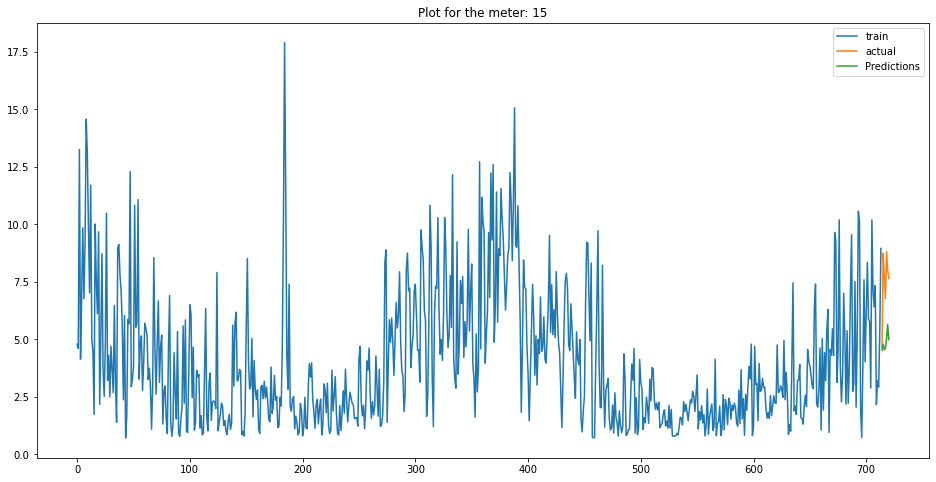

            ds      y
714 2021-07-15  4.666
715 2021-07-16  8.752
716 2021-07-17  7.777
717 2021-07-18  6.763
718 2021-07-19  8.815
719 2021-07-20  8.015
720 2021-07-21  7.654
            ds  Predictions
714 2021-07-15     4.527351
715 2021-07-16     4.789368
716 2021-07-17     4.558512
717 2021-07-18     4.612840
718 2021-07-19     5.034909
719 2021-07-20     5.654260
720 2021-07-21     4.991891
34.8439586548145


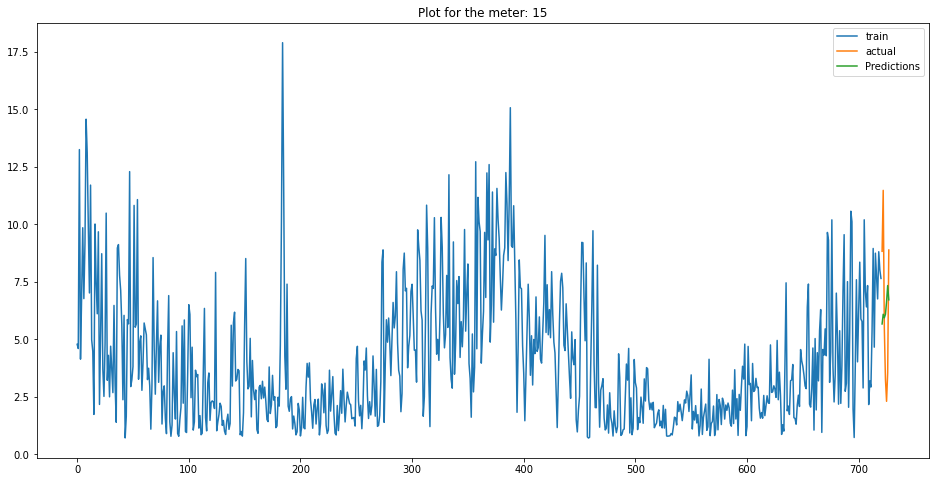

            ds       y
721 2021-07-22   8.834
722 2021-07-23  11.483
723 2021-07-24   5.498
724 2021-07-25   3.276
725 2021-07-26   2.311
726 2021-07-27   3.549
727 2021-07-28   8.890
            ds  Predictions
721 2021-07-22     5.674117
722 2021-07-23     6.096592
723 2021-07-24     5.943559
724 2021-07-25     6.092873
725 2021-07-26     6.636023
726 2021-07-27     7.343736
727 2021-07-28     6.724838
1.5299364578011152


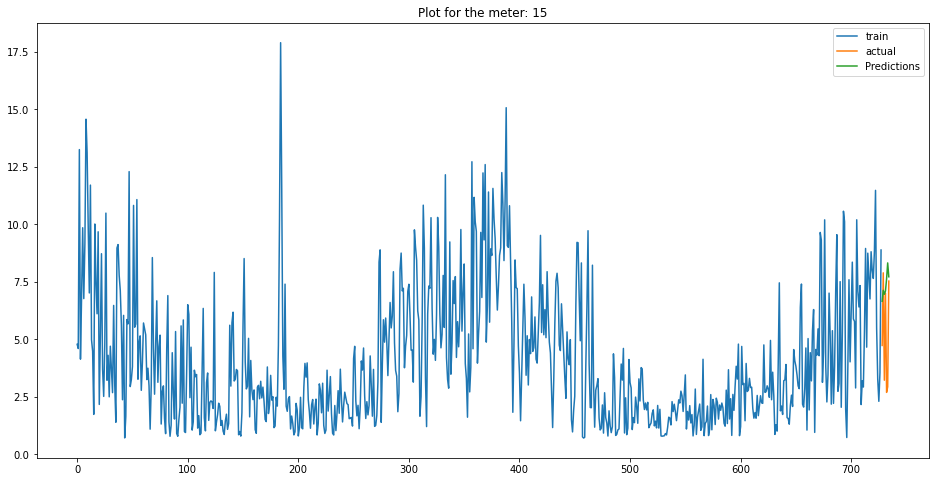

            ds      y
728 2021-07-29  4.740
729 2021-07-30  7.898
730 2021-07-31  3.229
731 2021-08-01  7.018
732 2021-08-02  2.699
733 2021-08-03  2.942
734 2021-08-04  7.539
            ds  Predictions
728 2021-07-29     6.661486
729 2021-07-30     7.137579
730 2021-07-31     6.966171
731 2021-08-01     7.106763
732 2021-08-02     7.633787
733 2021-08-03     8.328818
734 2021-08-04     7.725501
42.96438625466377
   mape_weekly  meterID    type
0        8.576       15  unflag
1       34.844       15  unflag
2        1.530       15  unflag
3       42.964       15  unflag


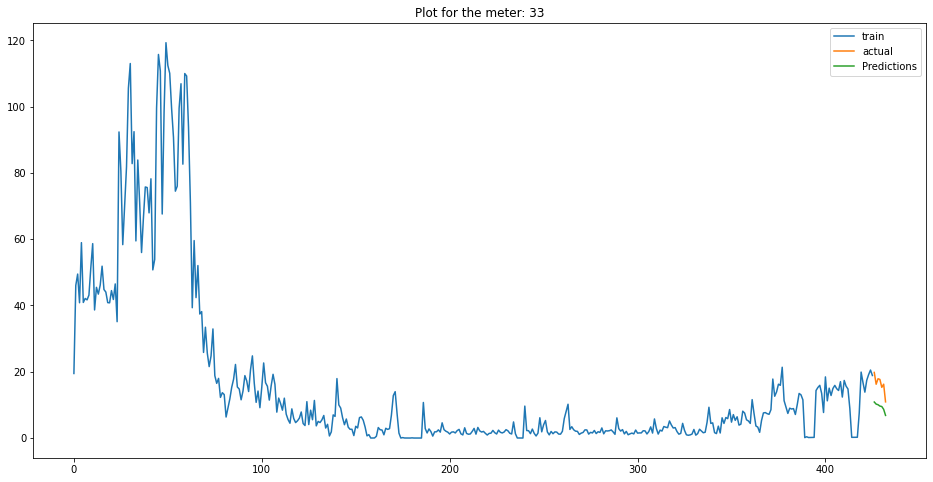

            ds       y
426 2021-07-08  19.789
427 2021-07-09  16.230
428 2021-07-10  17.886
429 2021-07-11  17.683
430 2021-07-12  15.294
431 2021-07-13  16.244
432 2021-07-14  10.913
            ds  Predictions
426 2021-07-08    10.861988
427 2021-07-09    10.233032
428 2021-07-10    10.051805
429 2021-07-11     9.638446
430 2021-07-12     9.506672
431 2021-07-13     8.655668
432 2021-07-14     6.826044
42.32354370023105


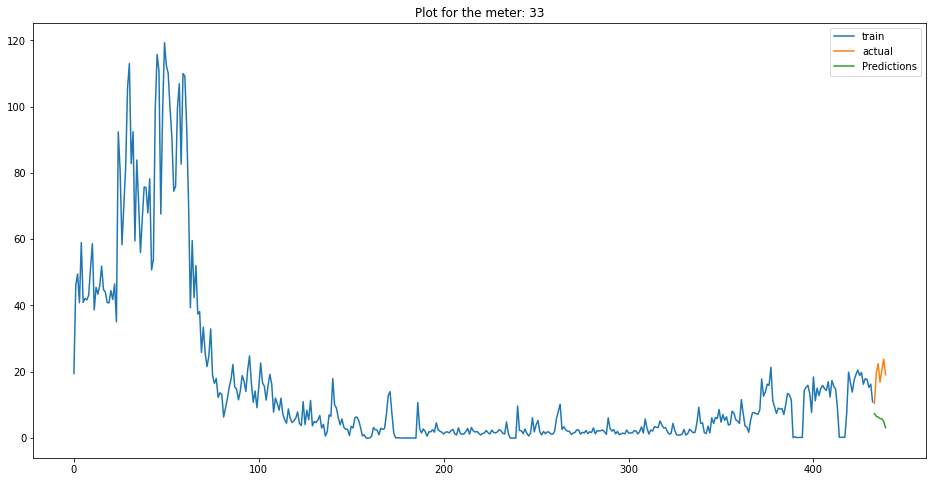

            ds       y
433 2021-07-15  10.493
434 2021-07-16  19.719
435 2021-07-17  22.416
436 2021-07-18  16.816
437 2021-07-19  20.459
438 2021-07-20  23.815
439 2021-07-21  19.083
            ds  Predictions
433 2021-07-15     7.374941
434 2021-07-16     6.553251
435 2021-07-17     6.323218
436 2021-07-18     5.877351
437 2021-07-19     5.822488
438 2021-07-20     5.006089
439 2021-07-21     3.115247
69.82508914670605


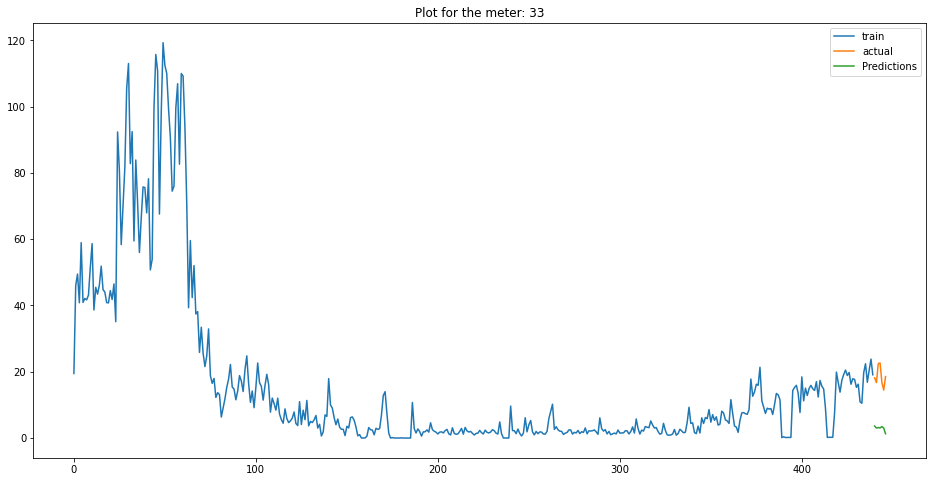

            ds       y
440 2021-07-22  18.168
441 2021-07-23  16.709
442 2021-07-24  22.436
443 2021-07-25  22.653
444 2021-07-26  16.717
445 2021-07-27  14.473
446 2021-07-28  18.540
            ds  Predictions
440 2021-07-22     3.618030
441 2021-07-23     3.019562
442 2021-07-24     3.142334
443 2021-07-25     3.043475
444 2021-07-26     3.458300
445 2021-07-27     3.009099
446 2021-07-28     1.299765
84.1239787166977


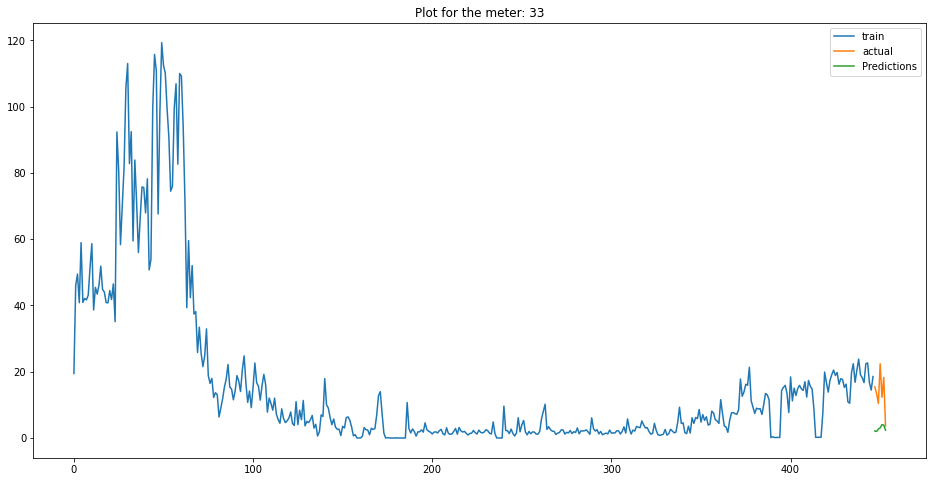

            ds       y
447 2021-07-29  15.459
448 2021-07-30  13.458
449 2021-07-31  10.400
450 2021-08-01  22.392
451 2021-08-02  12.299
452 2021-08-03  18.304
453 2021-08-04   3.633
            ds  Predictions
447 2021-07-29     2.122247
448 2021-07-30     2.000324
449 2021-07-31     2.687501
450 2021-08-01     3.083412
451 2021-08-02     4.017753
452 2021-08-03     3.932481
453 2021-08-04     2.374674
78.92710177322179
   mape_weekly  meterID    type
0       42.324       33  unflag
1       69.825       33    flag
2       84.124       33    flag
3       78.927       33    flag


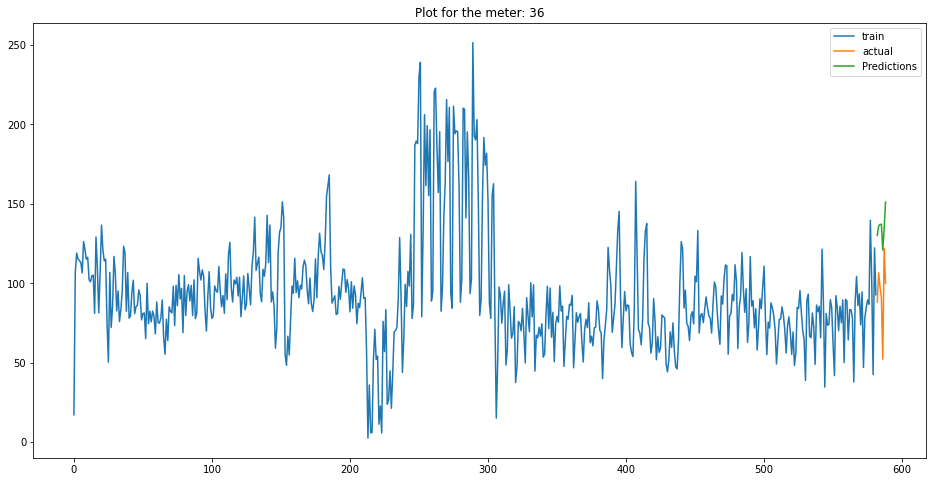

            ds        y
582 2021-06-03   88.162
583 2021-06-04  106.638
584 2021-06-05   97.490
585 2021-06-06   90.974
586 2021-06-07   52.250
587 2021-06-08  122.160
588 2021-06-09   99.904
            ds  Predictions
582 2021-06-03   130.190377
583 2021-06-04   136.031961
584 2021-06-05   137.131141
585 2021-06-06   137.103381
586 2021-06-07   120.915654
587 2021-06-08   134.278207
588 2021-06-09   151.110258
43.97698510218414


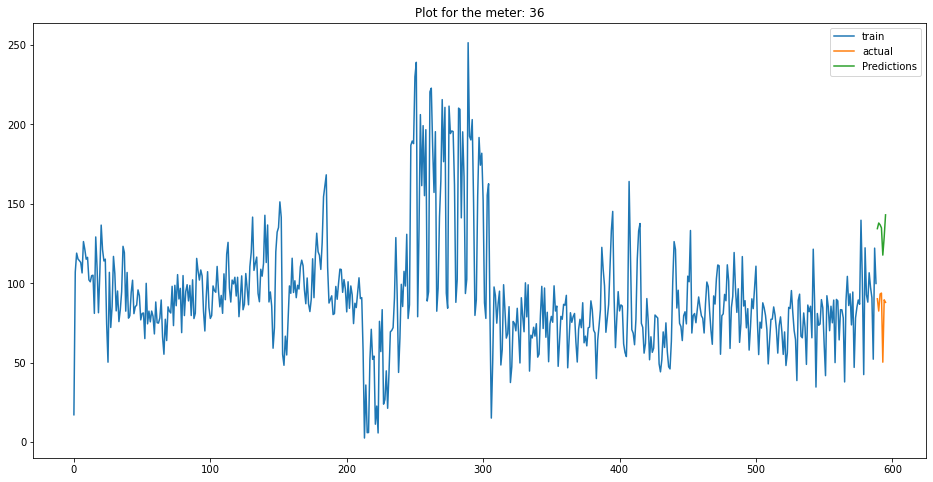

            ds       y
589 2021-06-10  90.274
590 2021-06-11  82.550
591 2021-06-12  93.270
592 2021-06-13  93.868
593 2021-06-14  50.368
594 2021-06-15  89.620
595 2021-06-16  88.030
            ds  Predictions
589 2021-06-10   134.416205
590 2021-06-11   137.947876
591 2021-06-12   136.842886
592 2021-06-13   134.907224
593 2021-06-14   117.755638
594 2021-06-15   128.985937
595 2021-06-16   143.101072
58.84159994135912


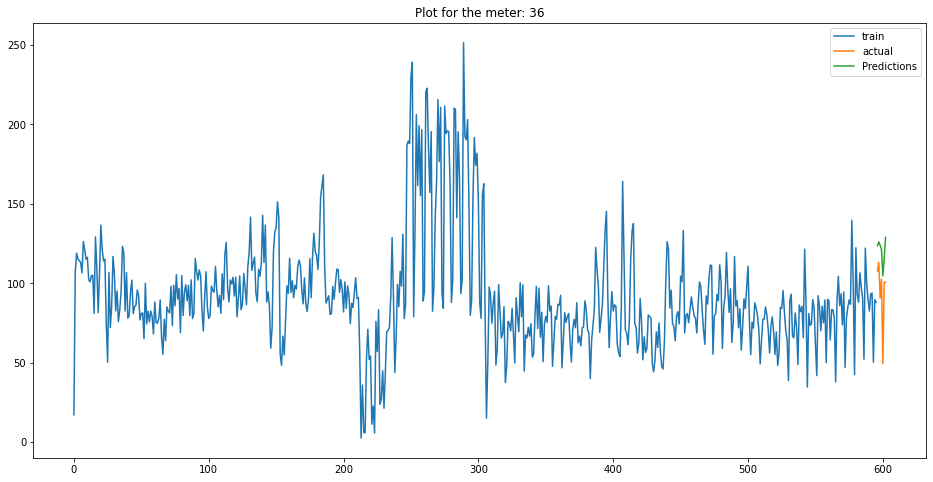

            ds        y
596 2021-06-17  107.780
597 2021-06-18  113.286
598 2021-06-19   90.726
599 2021-06-20  102.528
600 2021-06-21   49.418
601 2021-06-22  100.782
602 2021-06-23  100.706
            ds  Predictions
596 2021-06-17   123.626654
597 2021-06-18   126.010958
598 2021-06-19   123.973831
599 2021-06-20   121.425583
600 2021-06-21   104.676586
601 2021-06-22   115.193243
602 2021-06-23   129.011864
26.861956677903038


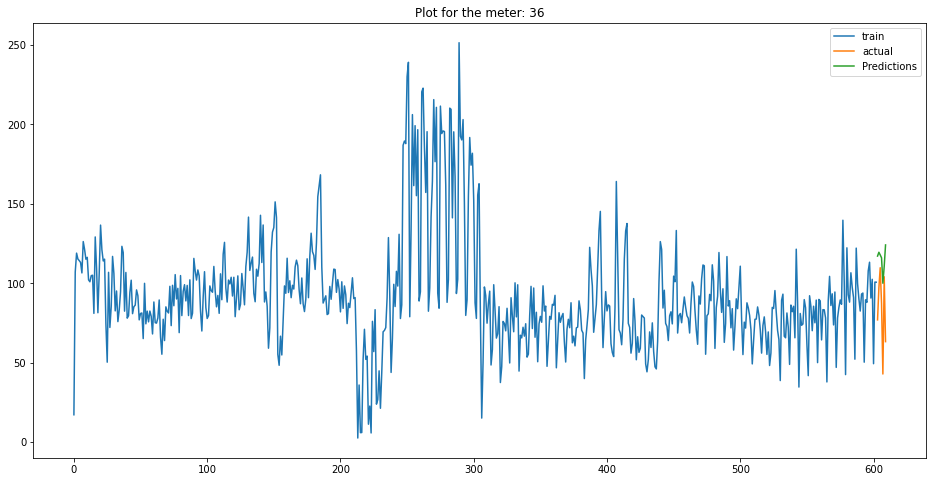

            ds        y
603 2021-06-24   77.008
604 2021-06-25   97.132
605 2021-06-26  109.828
606 2021-06-27   87.154
607 2021-06-28   42.928
608 2021-06-29  104.134
609 2021-06-30   63.302
            ds  Predictions
603 2021-06-24   117.151192
604 2021-06-25   119.546519
605 2021-06-26   117.875710
606 2021-06-27   116.046419
607 2021-06-28   100.047445
608 2021-06-29   110.681225
609 2021-06-30   124.162966
38.52637475228104
   mape_weekly  meterID    type
0       43.977       36  unflag
1       58.842       36    flag
2       26.862       36  unflag
3       38.526       36  unflag


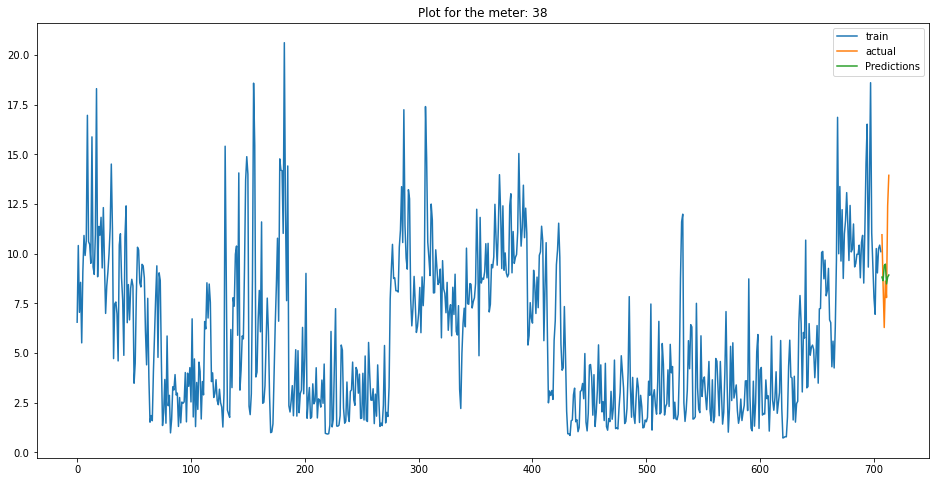

            ds       y
707 2021-07-08  10.954
708 2021-07-09   8.406
709 2021-07-10   6.284
710 2021-07-11   8.623
711 2021-07-12   7.791
712 2021-07-13  12.414
713 2021-07-14  13.945
            ds  Predictions
707 2021-07-08     8.822187
708 2021-07-09     8.640912
709 2021-07-10     9.403389
710 2021-07-11     9.473574
711 2021-07-12     8.481000
712 2021-07-13     8.821789
713 2021-07-14     8.925356
8.548742612720437


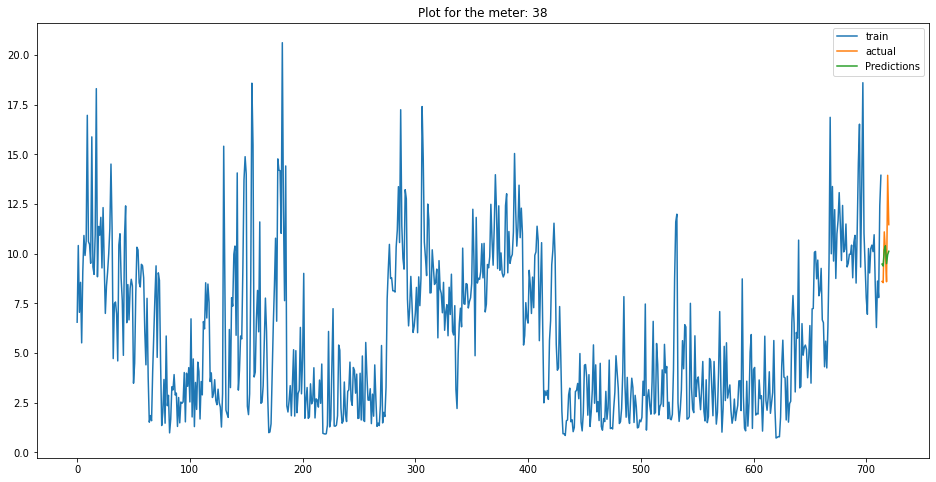

            ds       y
714 2021-07-15   8.603
715 2021-07-16   8.542
716 2021-07-17  11.098
717 2021-07-18  10.133
718 2021-07-19   8.588
719 2021-07-20  13.946
720 2021-07-21  11.462
            ds  Predictions
714 2021-07-15     9.475955
715 2021-07-16     9.378270
716 2021-07-17    10.195318
717 2021-07-18    10.399961
718 2021-07-19     9.499461
719 2021-07-20     9.952528
720 2021-07-21    10.122536
4.626059608624098


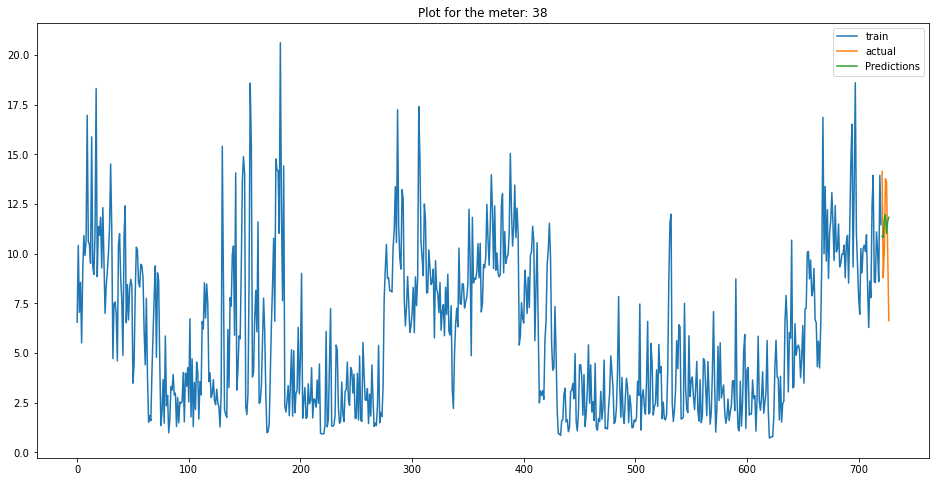

            ds       y
721 2021-07-22  14.141
722 2021-07-23   8.785
723 2021-07-24  10.140
724 2021-07-25  13.770
725 2021-07-26  13.597
726 2021-07-27  10.137
727 2021-07-28   6.630
            ds  Predictions
721 2021-07-22    10.869867
722 2021-07-23    10.807393
723 2021-07-24    11.765490
724 2021-07-25    11.968536
725 2021-07-26    11.017765
726 2021-07-27    11.629658
727 2021-07-28    11.833116
3.4868196819535213


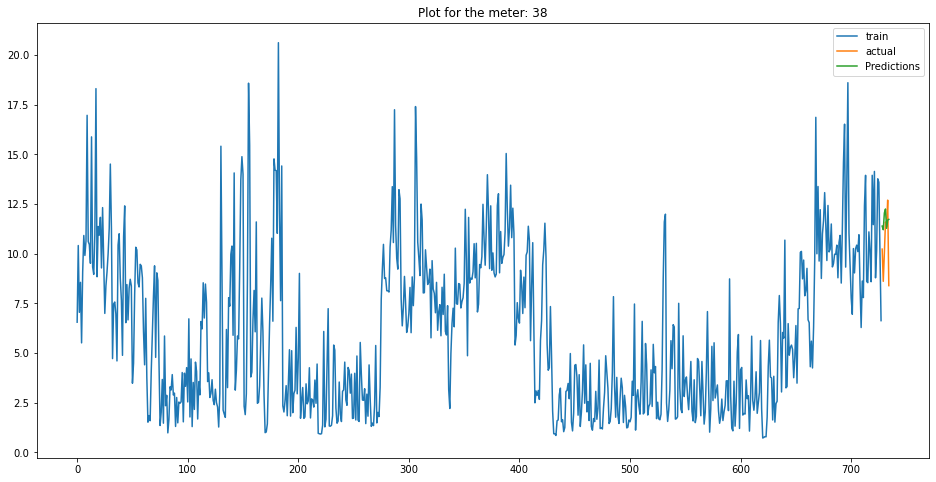

            ds       y
728 2021-07-29  10.231
729 2021-07-30   8.609
730 2021-07-31  10.017
731 2021-08-01  11.598
732 2021-08-02  11.380
733 2021-08-03  12.696
734 2021-08-04   8.392
            ds  Predictions
728 2021-07-29    11.388094
729 2021-07-30    11.207367
730 2021-07-31    12.049930
731 2021-08-01    12.249686
732 2021-08-02    11.276775
733 2021-08-03    11.692633
734 2021-08-04    11.727076
11.887277979836062
   mape_weekly  meterID    type
0        8.549       38  unflag
1        4.626       38  unflag
2        3.487       38  unflag
3       11.887       38  unflag


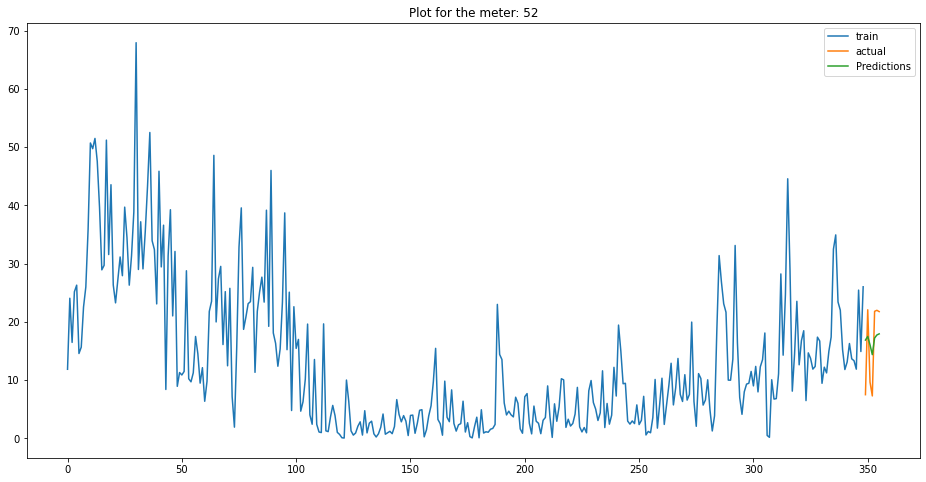

            ds       y
349 2021-07-07   7.491
350 2021-07-08  22.069
351 2021-07-09   9.645
352 2021-07-10   7.277
353 2021-07-11  21.802
354 2021-07-12  21.980
355 2021-07-13  21.756
            ds  Predictions
349 2021-07-07    16.869247
350 2021-07-08    17.488483
351 2021-07-09    16.045702
352 2021-07-10    14.368653
353 2021-07-11    17.218898
354 2021-07-12    17.740311
355 2021-07-13    17.934549
5.040031184257281


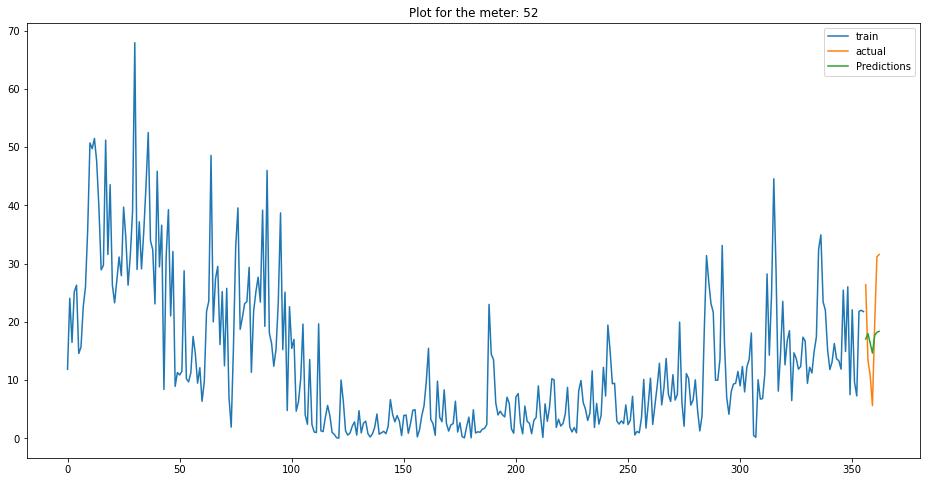

            ds       y
356 2021-07-14  26.361
357 2021-07-15  13.442
358 2021-07-16  10.767
359 2021-07-17   5.611
360 2021-07-18  19.654
361 2021-07-19  31.160
362 2021-07-20  31.560
            ds  Predictions
356 2021-07-14    17.067740
357 2021-07-15    17.974437
358 2021-07-16    16.313984
359 2021-07-17    14.630376
360 2021-07-18    17.687256
361 2021-07-19    18.196677
362 2021-07-20    18.372472
13.21645416291481


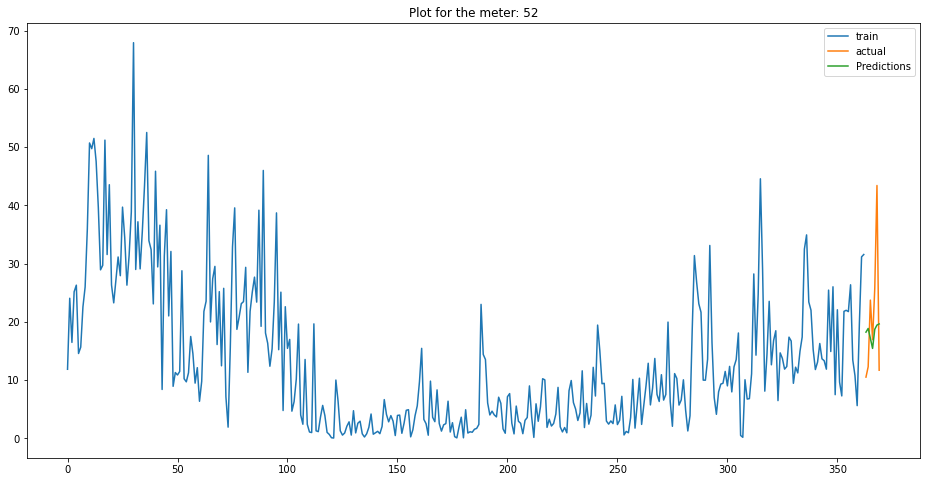

            ds       y
363 2021-07-21  10.507
364 2021-07-22  12.282
365 2021-07-23  23.730
366 2021-07-24  16.946
367 2021-07-25  25.758
368 2021-07-26  43.410
369 2021-07-27  11.691
            ds  Predictions
363 2021-07-21    18.228135
364 2021-07-22    18.860947
365 2021-07-23    17.166826
366 2021-07-24    15.434086
367 2021-07-25    18.721261
368 2021-07-26    19.447598
369 2021-07-27    19.637817
11.659411969481559


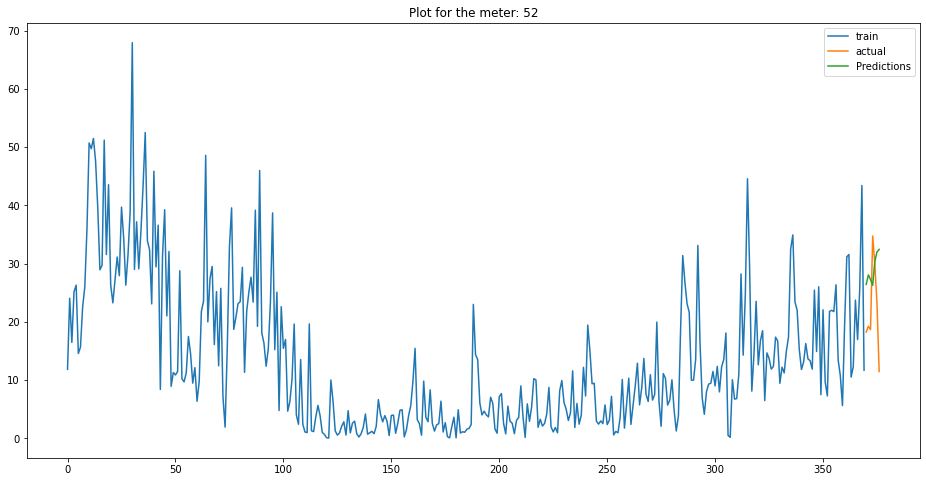

            ds       y
370 2021-07-28  18.258
371 2021-07-29  19.242
372 2021-07-30  18.666
373 2021-07-31  34.742
374 2021-08-01  29.864
375 2021-08-02  23.030
376 2021-08-03  11.474
            ds  Predictions
370 2021-07-28    26.421260
371 2021-07-29    28.061079
372 2021-07-30    27.265267
373 2021-07-31    26.273827
374 2021-08-01    30.403910
375 2021-08-02    32.002246
376 2021-08-03    32.447255
30.654346430844942
   mape_weekly  meterID    type
0        5.040       52  unflag
1       13.216       52  unflag
2       11.659       52  unflag
3       30.654       52  unflag


In [853]:
for i in TOU_list_above365:
    account_and_days_billcycle11(i,'off peak')

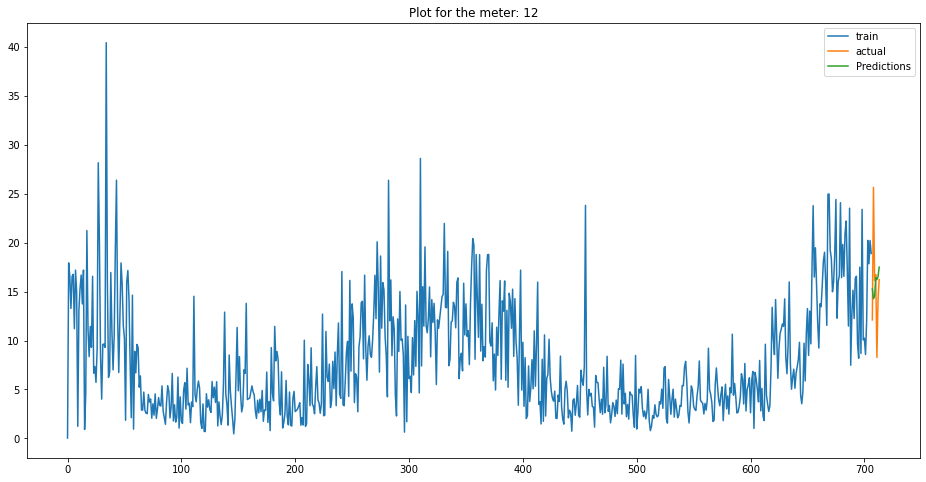

            ds       y
707 2021-07-08  12.106
708 2021-07-09  25.664
709 2021-07-10  16.136
710 2021-07-11  16.743
711 2021-07-12   8.268
712 2021-07-13  14.129
713 2021-07-14  16.235
            ds  Predictions
707 2021-07-08    15.272048
708 2021-07-09    14.281523
709 2021-07-10    14.540635
710 2021-07-11    16.453818
711 2021-07-12    16.239969
712 2021-07-13    16.534354
713 2021-07-14    17.507003
1.4168527583454442


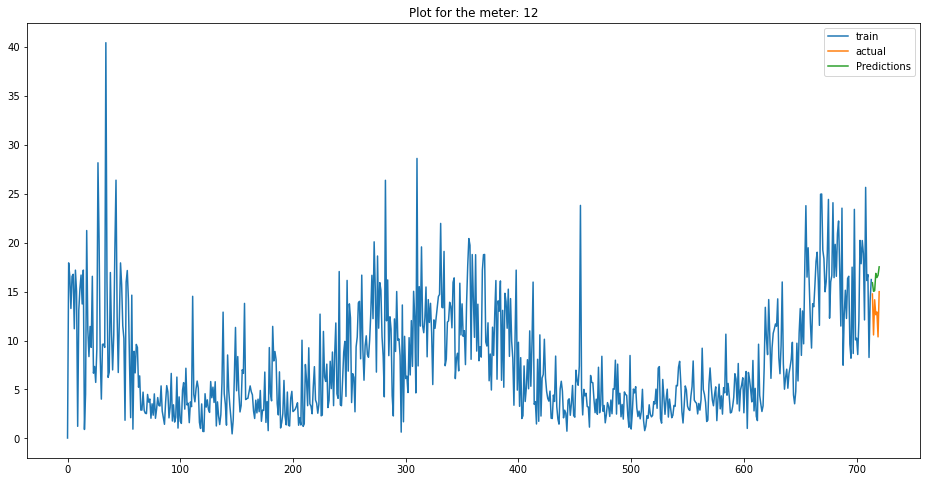

            ds       y
714 2021-07-15  14.759
715 2021-07-16  10.572
716 2021-07-17  14.168
717 2021-07-18  12.641
718 2021-07-19  12.923
719 2021-07-20  10.373
720 2021-07-21  14.995
            ds  Predictions
714 2021-07-15    15.914690
715 2021-07-16    15.033781
716 2021-07-17    15.089743
717 2021-07-18    16.866358
718 2021-07-19    16.439714
719 2021-07-20    16.678024
720 2021-07-21    17.532951
25.57116733530867


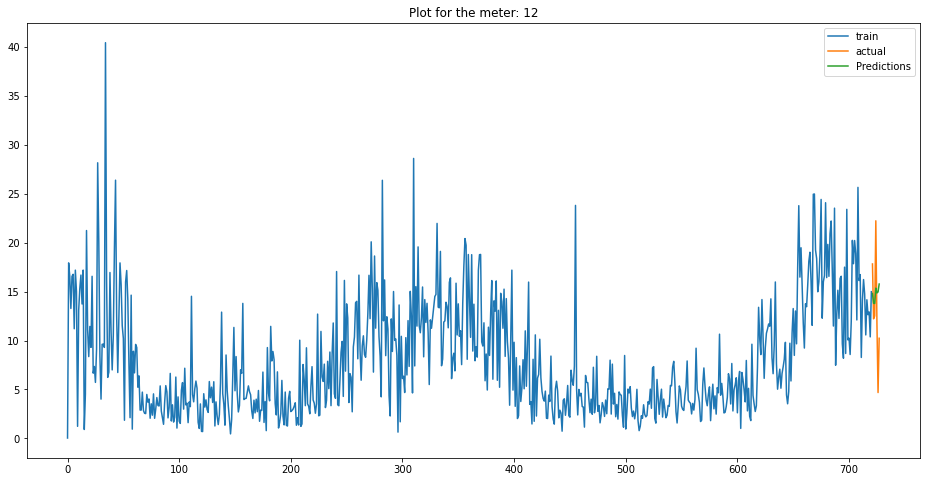

            ds       y
721 2021-07-22  17.831
722 2021-07-23  12.221
723 2021-07-24  12.517
724 2021-07-25  22.245
725 2021-07-26  11.758
726 2021-07-27   4.678
727 2021-07-28  10.231
            ds  Predictions
721 2021-07-22    14.814454
722 2021-07-23    13.810727
723 2021-07-24    13.788061
724 2021-07-25    15.357360
725 2021-07-26    14.865918
726 2021-07-27    14.969545
727 2021-07-28    15.775804
13.009115683363298


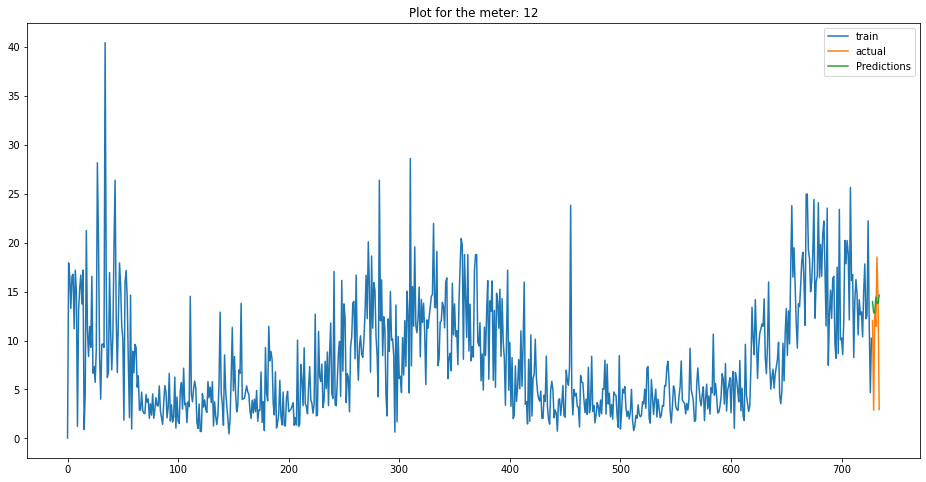

            ds       y
728 2021-07-29  12.049
729 2021-07-30   2.875
730 2021-07-31  12.938
731 2021-08-01  11.450
732 2021-08-02  18.537
733 2021-08-03  13.960
734 2021-08-04   2.943
            ds  Predictions
728 2021-07-29    13.983075
729 2021-07-30    12.870573
730 2021-07-31    12.813088
731 2021-08-01    14.435291
732 2021-08-02    13.798189
733 2021-08-03    13.795356
734 2021-08-04    14.638116
28.871051179583485
   mape_weekly  meterID    type
0        1.417       12  unflag
1       25.571       12  unflag
2       13.009       12  unflag
3       28.871       12  unflag


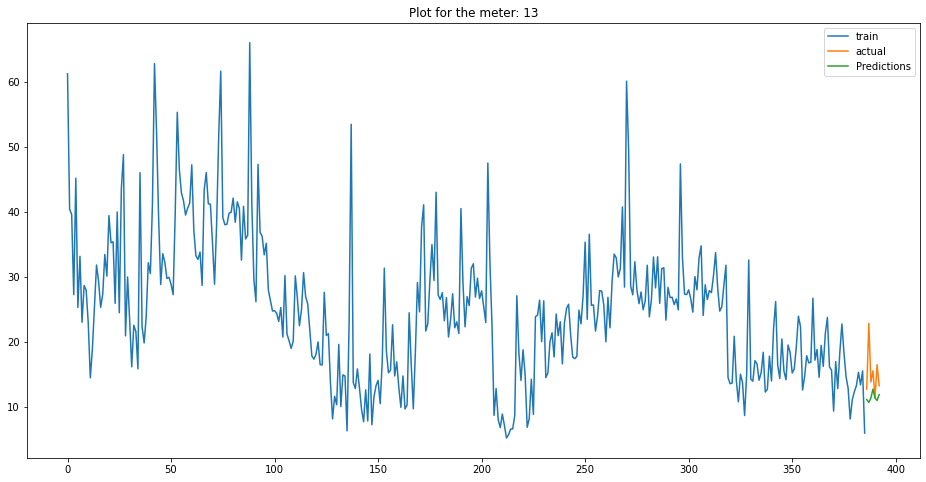

            ds       y
386 2021-07-07  12.722
387 2021-07-08  22.842
388 2021-07-09  13.803
389 2021-07-10  15.533
390 2021-07-11  11.428
391 2021-07-12  16.479
392 2021-07-13  13.221
            ds  Predictions
386 2021-07-07    11.111401
387 2021-07-08    10.662261
388 2021-07-09    11.332551
389 2021-07-10    12.714662
390 2021-07-11    11.340947
391 2021-07-12    10.961427
392 2021-07-13    11.874510
24.55034597148593


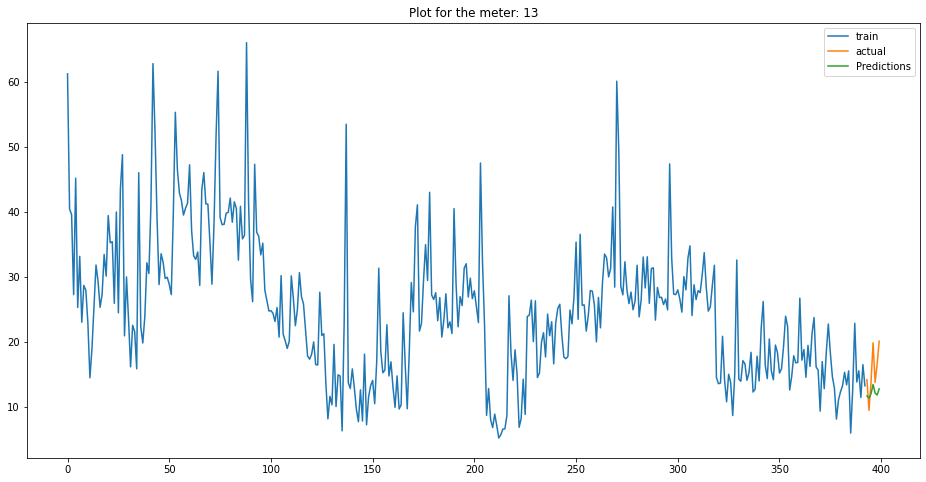

            ds       y
393 2021-07-14  14.182
394 2021-07-15   9.434
395 2021-07-16  13.764
396 2021-07-17  19.838
397 2021-07-18  13.746
398 2021-07-19  16.562
399 2021-07-20  20.089
            ds  Predictions
393 2021-07-14    11.673420
394 2021-07-15    11.334920
395 2021-07-16    11.997397
396 2021-07-17    13.423681
397 2021-07-18    12.097880
398 2021-07-19    11.799607
399 2021-07-20    12.745470
20.947474704021385


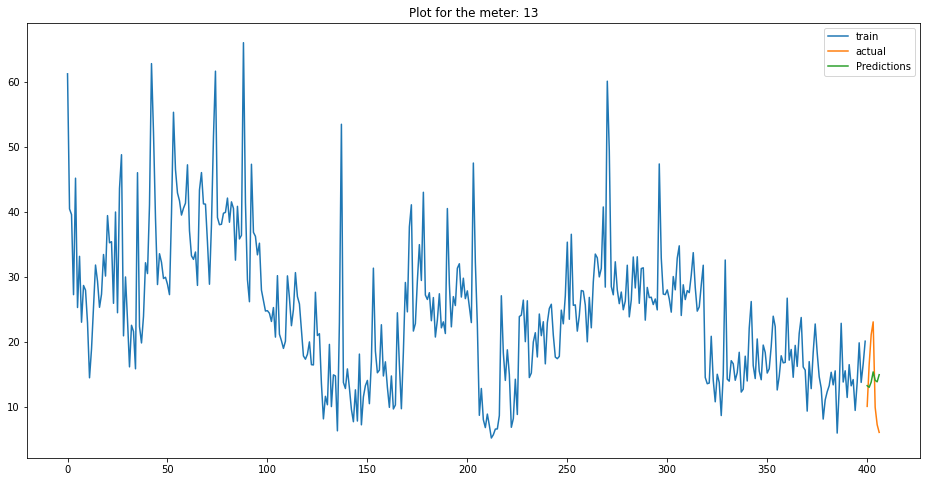

            ds       y
400 2021-07-21  10.055
401 2021-07-22  16.514
402 2021-07-23  21.077
403 2021-07-24  23.064
404 2021-07-25   9.902
405 2021-07-26   7.233
406 2021-07-27   6.054
            ds  Predictions
400 2021-07-21    13.240861
401 2021-07-22    12.990290
402 2021-07-23    13.788223
403 2021-07-24    15.363741
404 2021-07-25    14.056392
405 2021-07-26    13.837597
406 2021-07-27    14.931593
4.589716211310217


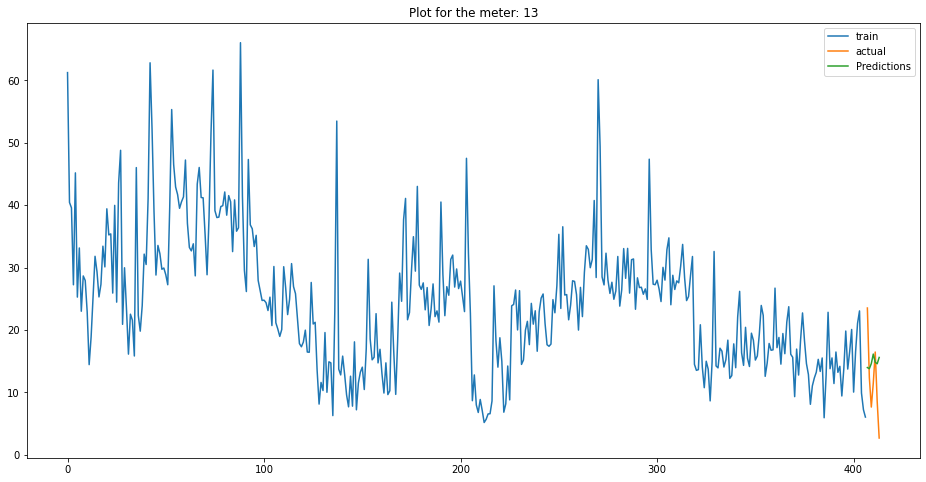

            ds       y
407 2021-07-28  23.529
408 2021-07-29  12.395
409 2021-07-30   7.657
410 2021-07-31  11.474
411 2021-08-01  16.476
412 2021-08-02   8.536
413 2021-08-03   2.696
            ds  Predictions
407 2021-07-28    13.985330
408 2021-07-29    13.805206
409 2021-07-30    14.616885
410 2021-07-31    16.146152
411 2021-08-01    14.824378
412 2021-08-02    14.592760
413 2021-08-03    15.607849
25.150804726114433
   mape_weekly  meterID    type
0       24.550       13  unflag
1       20.947       13  unflag
2        4.590       13  unflag
3       25.151       13  unflag


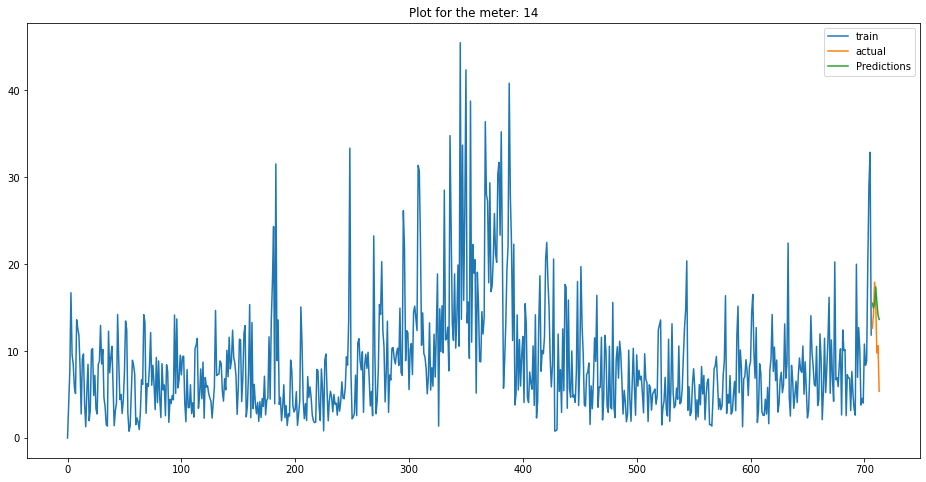

            ds       y
707 2021-07-08  12.649
708 2021-07-09  14.307
709 2021-07-10  17.948
710 2021-07-11  15.336
711 2021-07-12   9.790
712 2021-07-13  10.630
713 2021-07-14   5.394
            ds  Predictions
707 2021-07-08    15.518579
708 2021-07-09    14.946162
709 2021-07-10    15.392823
710 2021-07-11    17.400440
711 2021-07-12    15.616772
712 2021-07-13    14.138685
713 2021-07-14    13.662515
23.96399534480684


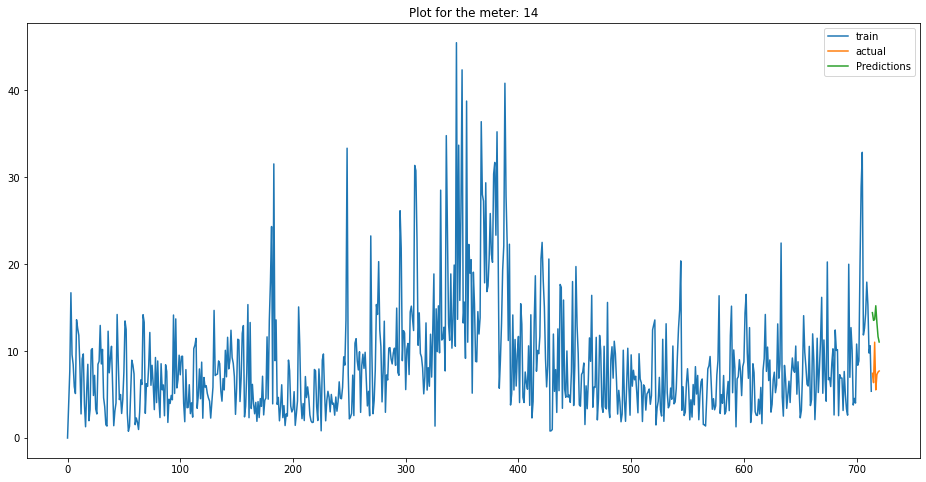

            ds       y
714 2021-07-15   7.459
715 2021-07-16   6.387
716 2021-07-17  11.040
717 2021-07-18   5.554
718 2021-07-19   7.314
719 2021-07-20   7.601
720 2021-07-21   7.728
            ds  Predictions
714 2021-07-15    14.438675
715 2021-07-16    13.545868
716 2021-07-17    13.651340
717 2021-07-18    15.229561
718 2021-07-19    13.270943
719 2021-07-20    11.685558
720 2021-07-21    11.061286
74.97736038857956


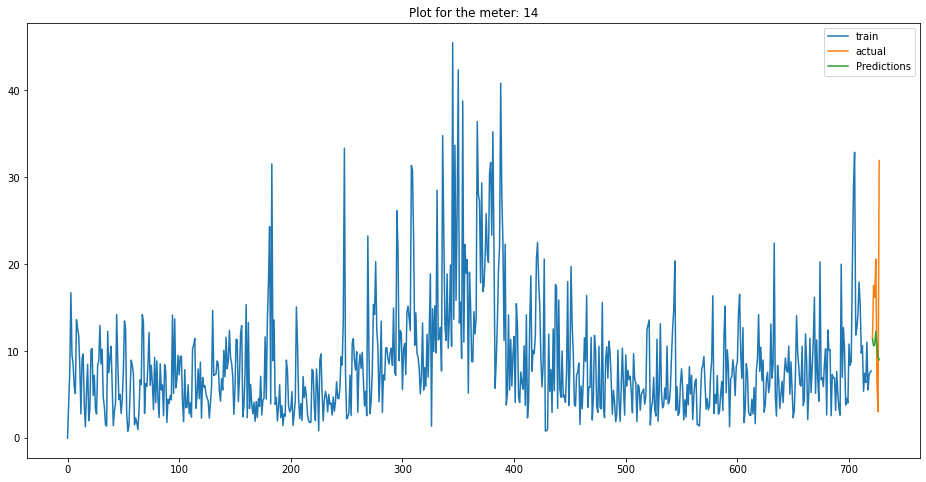

            ds       y
721 2021-07-22  11.468
722 2021-07-23  17.554
723 2021-07-24  16.198
724 2021-07-25  20.608
725 2021-07-26   6.355
726 2021-07-27   3.036
727 2021-07-28  31.929
            ds  Predictions
721 2021-07-22    11.437592
722 2021-07-23    10.611341
723 2021-07-24    10.767426
724 2021-07-25    12.286831
725 2021-07-26    10.639176
726 2021-07-27     9.369947
727 2021-07-28     9.018155
30.814884416407786


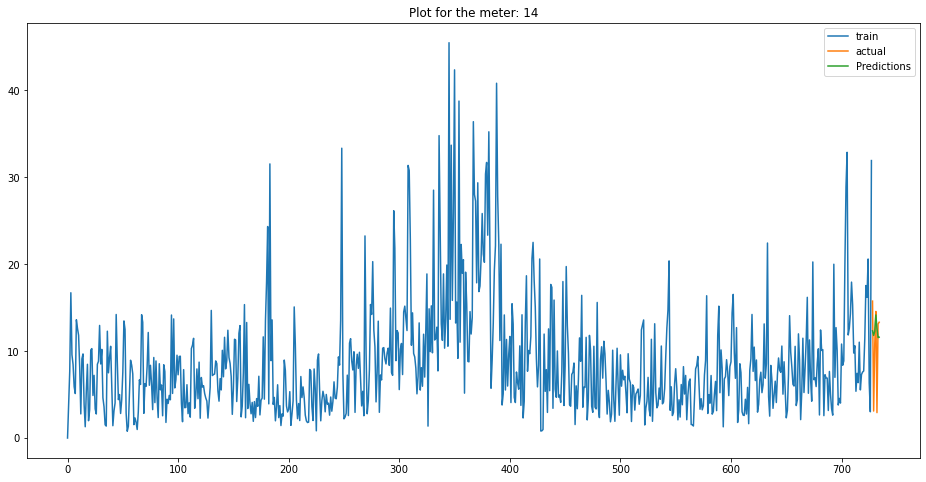

            ds       y
728 2021-07-29  15.764
729 2021-07-30   3.118
730 2021-07-31  10.786
731 2021-08-01  14.578
732 2021-08-02   2.937
733 2021-08-03  13.138
734 2021-08-04  13.335
            ds  Predictions
728 2021-07-29    12.348681
729 2021-07-30    11.813403
730 2021-07-31    12.285234
731 2021-08-01    14.170175
732 2021-08-02    12.653414
733 2021-08-03    11.574047
734 2021-08-04    11.612239
17.37970090895624
   mape_weekly  meterID    type
0       23.964       14  unflag
1       74.977       14    flag
2       30.815       14  unflag
3       17.380       14  unflag


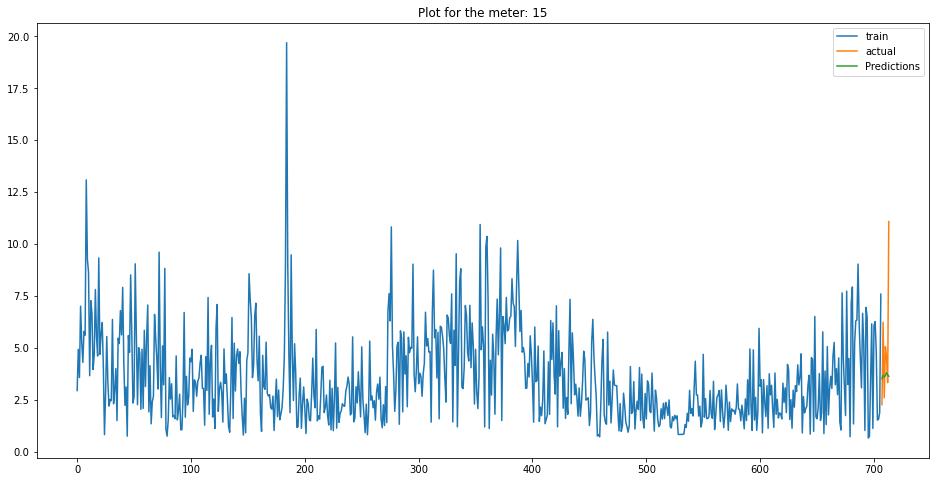

            ds       y
707 2021-07-08   2.262
708 2021-07-09   6.231
709 2021-07-10   2.596
710 2021-07-11   5.059
711 2021-07-12   4.567
712 2021-07-13   3.321
713 2021-07-14  11.081
            ds  Predictions
707 2021-07-08     3.513518
708 2021-07-09     3.672847
709 2021-07-10     3.588468
710 2021-07-11     3.672908
711 2021-07-12     3.804808
712 2021-07-13     3.701906
713 2021-07-14     3.632292
27.138570095080304


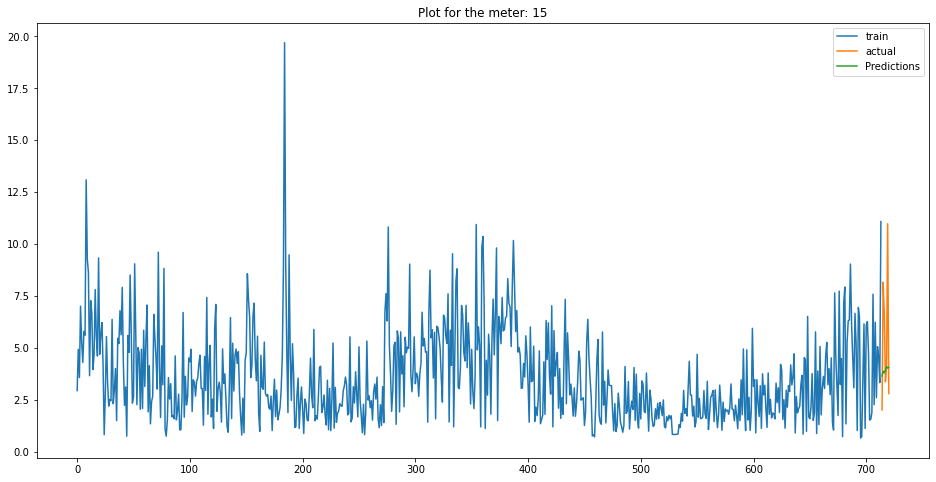

            ds       y
714 2021-07-15   2.007
715 2021-07-16   8.162
716 2021-07-17   6.686
717 2021-07-18   3.362
718 2021-07-19   4.031
719 2021-07-20  10.976
720 2021-07-21   2.794
            ds  Predictions
714 2021-07-15     3.645244
715 2021-07-16     3.871332
716 2021-07-17     3.793091
717 2021-07-18     3.931512
718 2021-07-19     4.099286
719 2021-07-20     4.029549
720 2021-07-21     4.051010
27.87357546241592


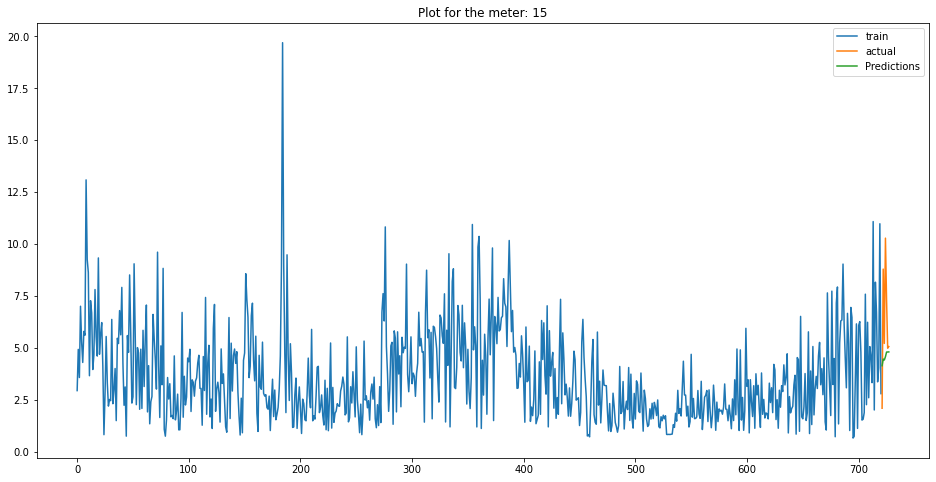

            ds       y
721 2021-07-22   2.090
722 2021-07-23   8.792
723 2021-07-24   5.212
724 2021-07-25  10.283
725 2021-07-26   7.325
726 2021-07-27   4.982
727 2021-07-28   5.061
            ds  Predictions
721 2021-07-22     4.139175
722 2021-07-23     4.461293
723 2021-07-24     4.413753
724 2021-07-25     4.571922
725 2021-07-26     4.795959
726 2021-07-27     4.799335
727 2021-07-28     4.803593
26.883003100512042


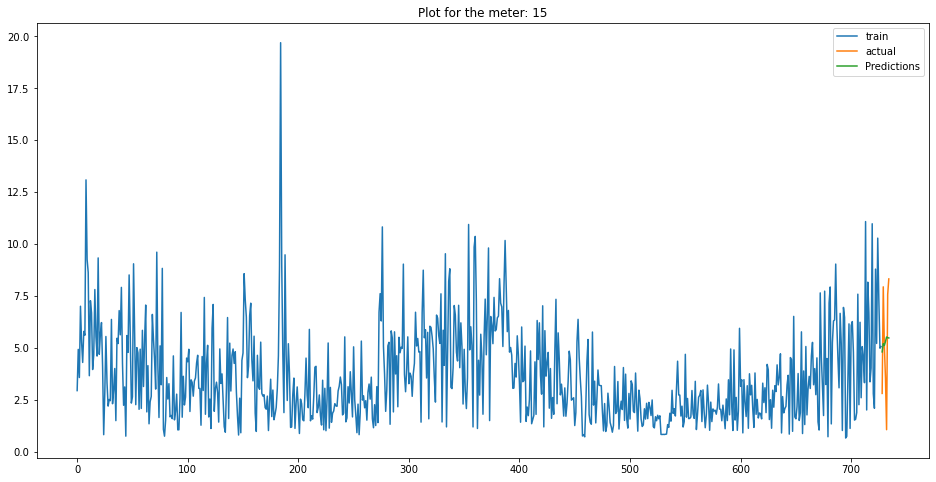

            ds      y
728 2021-07-29  2.805
729 2021-07-30  7.938
730 2021-07-31  5.056
731 2021-08-01  3.547
732 2021-08-02  1.058
733 2021-08-03  7.570
734 2021-08-04  8.319
            ds  Predictions
728 2021-07-29     4.804002
729 2021-07-30     5.203546
730 2021-07-31     5.114965
731 2021-08-01     5.304738
732 2021-08-02     5.522331
733 2021-08-03     5.489120
734 2021-08-04     5.475095
1.7105123279628451
   mape_weekly  meterID    type
0       27.139       15  unflag
1       27.874       15  unflag
2       26.883       15  unflag
3        1.711       15  unflag


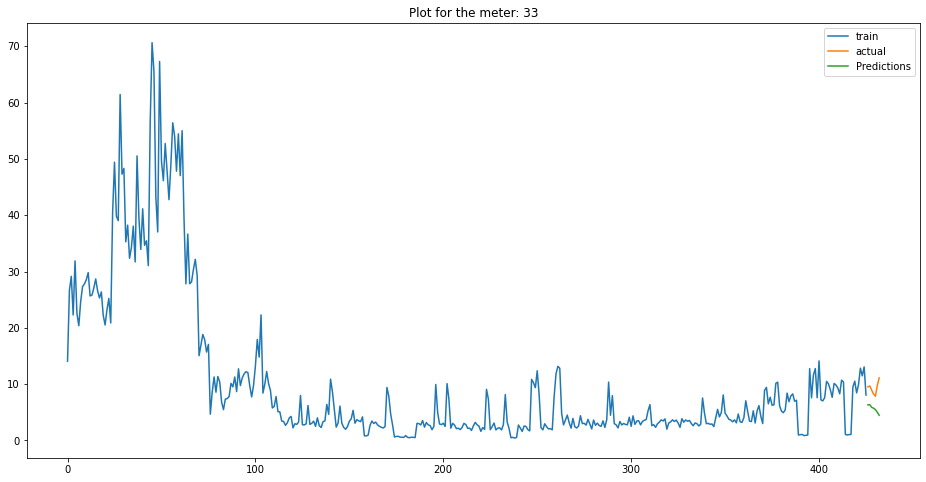

            ds       y
426 2021-07-08   9.511
427 2021-07-09   9.676
428 2021-07-10   8.959
429 2021-07-11   8.237
430 2021-07-12   7.858
431 2021-07-13   9.740
432 2021-07-14  11.111
            ds  Predictions
426 2021-07-08     6.325165
427 2021-07-09     6.355009
428 2021-07-10     5.889543
429 2021-07-11     5.740498
430 2021-07-12     5.473331
431 2021-07-13     5.014940
432 2021-07-14     4.480619
39.65601752318558


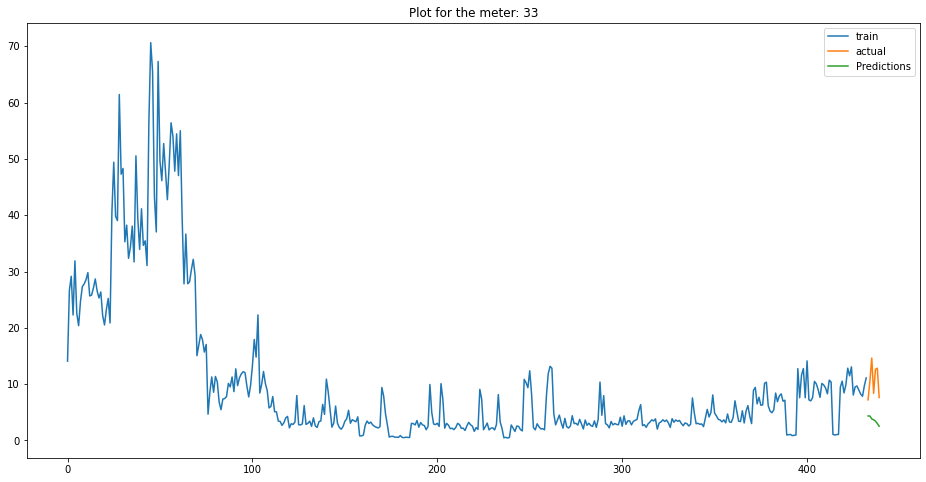

            ds       y
433 2021-07-15   7.208
434 2021-07-16  10.621
435 2021-07-17  14.642
436 2021-07-18   8.370
437 2021-07-19  12.638
438 2021-07-20  12.838
439 2021-07-21   7.623
            ds  Predictions
433 2021-07-15     4.360472
434 2021-07-16     4.343246
435 2021-07-17     3.826160
436 2021-07-18     3.675557
437 2021-07-19     3.430377
438 2021-07-20     3.009959
439 2021-07-21     2.527127
65.95496549498306


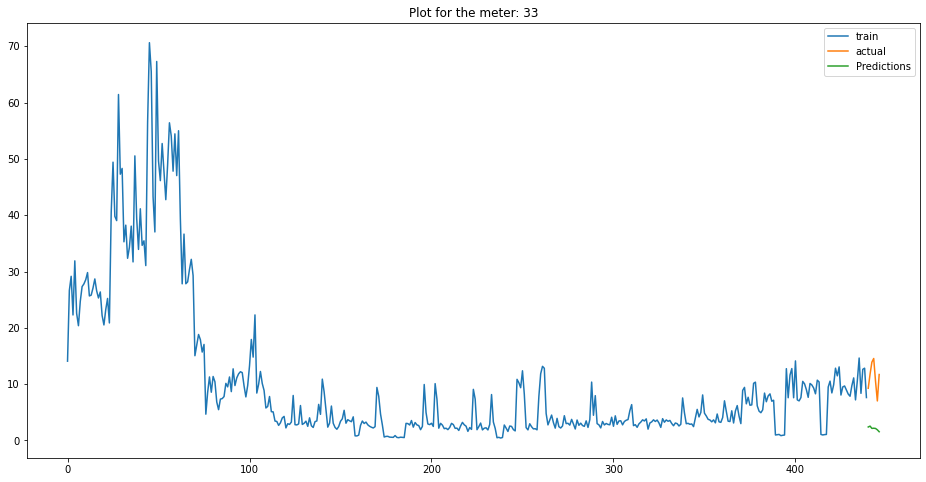

            ds       y
440 2021-07-22   9.272
441 2021-07-23  11.784
442 2021-07-24  13.913
443 2021-07-25  14.558
444 2021-07-26  10.515
445 2021-07-27   7.021
446 2021-07-28  11.712
            ds  Predictions
440 2021-07-22     2.396011
441 2021-07-23     2.553618
442 2021-07-24     2.145740
443 2021-07-25     2.177569
444 2021-07-26     2.136998
445 2021-07-27     1.897406
446 2021-07-28     1.555869
81.1320714078272


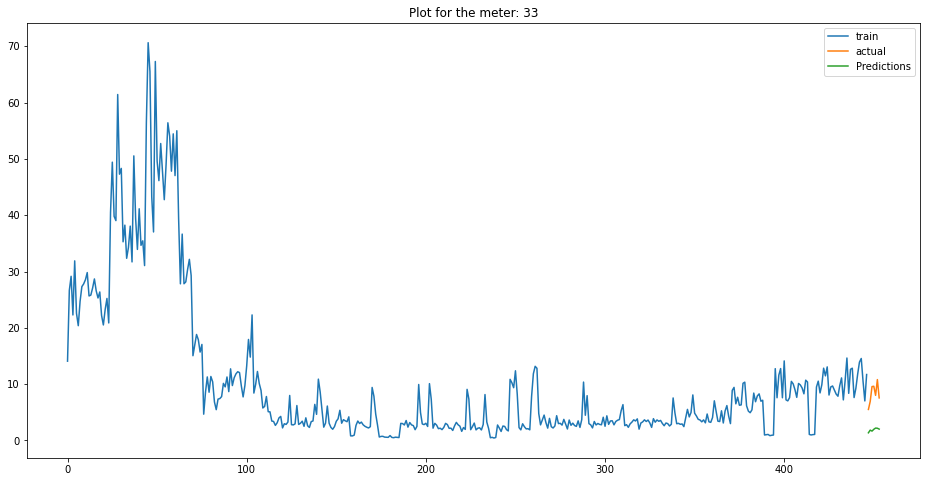

            ds       y
447 2021-07-29   5.512
448 2021-07-30   6.934
449 2021-07-31   9.571
450 2021-08-01   9.627
451 2021-08-02   8.012
452 2021-08-03  10.812
453 2021-08-04   7.561
            ds  Predictions
447 2021-07-29     1.364692
448 2021-07-30     1.840722
449 2021-07-31     1.668026
450 2021-08-01     1.987558
451 2021-08-02     2.204386
452 2021-08-03     2.174810
453 2021-08-04     2.018855
77.15099462747733
   mape_weekly  meterID    type
0       39.656       33  unflag
1       65.955       33    flag
2       81.132       33    flag
3       77.151       33    flag


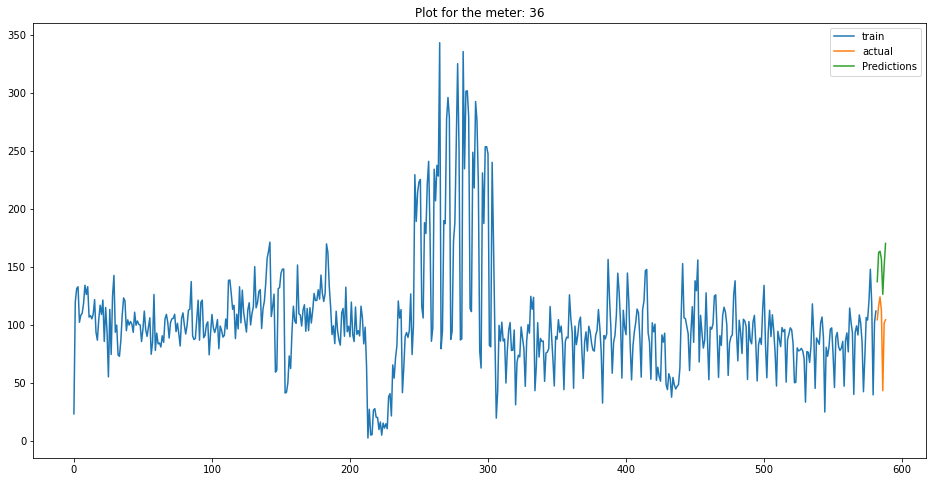

            ds        y
582 2021-06-03  104.510
583 2021-06-04  116.324
584 2021-06-05  124.120
585 2021-06-06  112.784
586 2021-06-07   43.404
587 2021-06-08  101.882
588 2021-06-09  104.464
            ds  Predictions
582 2021-06-03   137.344443
583 2021-06-04   162.438532
584 2021-06-05   163.469896
585 2021-06-06   156.798305
586 2021-06-07   126.392231
587 2021-06-08   150.642311
588 2021-06-09   170.233753
50.8604345524629


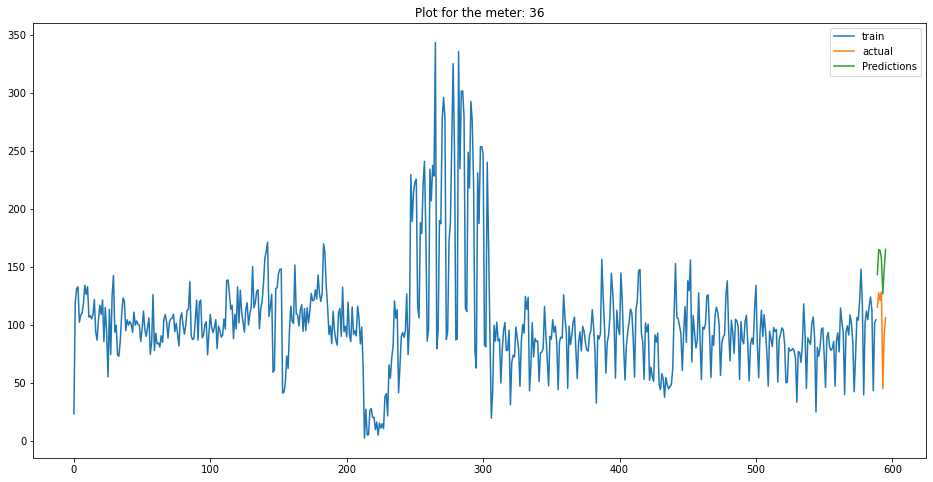

            ds        y
589 2021-06-10  115.352
590 2021-06-11  127.750
591 2021-06-12  121.170
592 2021-06-13  128.342
593 2021-06-14   45.148
594 2021-06-15   92.820
595 2021-06-16  106.312
            ds  Predictions
589 2021-06-10   143.514627
590 2021-06-11   164.902438
591 2021-06-12   164.207698
592 2021-06-13   156.562595
593 2021-06-14   126.639268
594 2021-06-15   147.987461
595 2021-06-16   165.097391
45.05634156053205


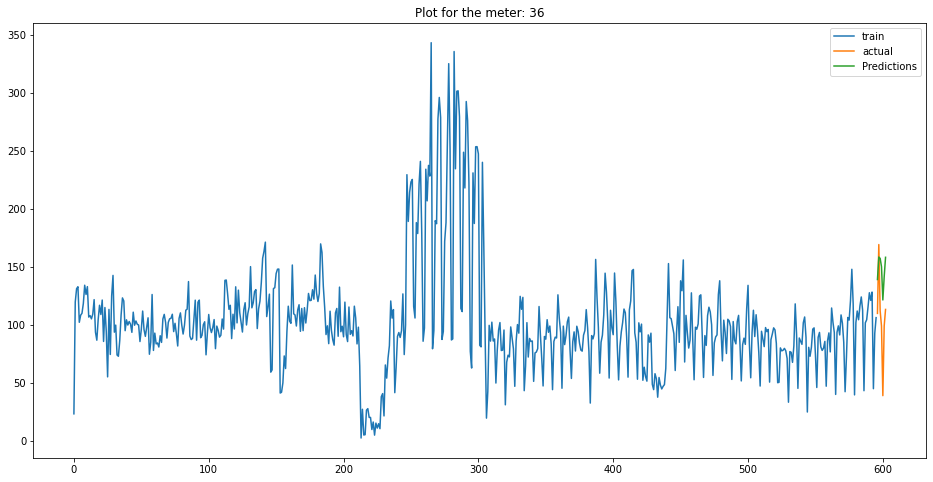

            ds        y
596 2021-06-17  109.972
597 2021-06-18  169.220
598 2021-06-19  112.226
599 2021-06-20   99.082
600 2021-06-21   39.166
601 2021-06-22   99.196
602 2021-06-23  113.376
            ds  Predictions
596 2021-06-17   139.139748
597 2021-06-18   158.500484
598 2021-06-19   157.320548
599 2021-06-20   150.187908
600 2021-06-21   121.547627
601 2021-06-22   141.584111
602 2021-06-23   158.256805
38.30297432189384


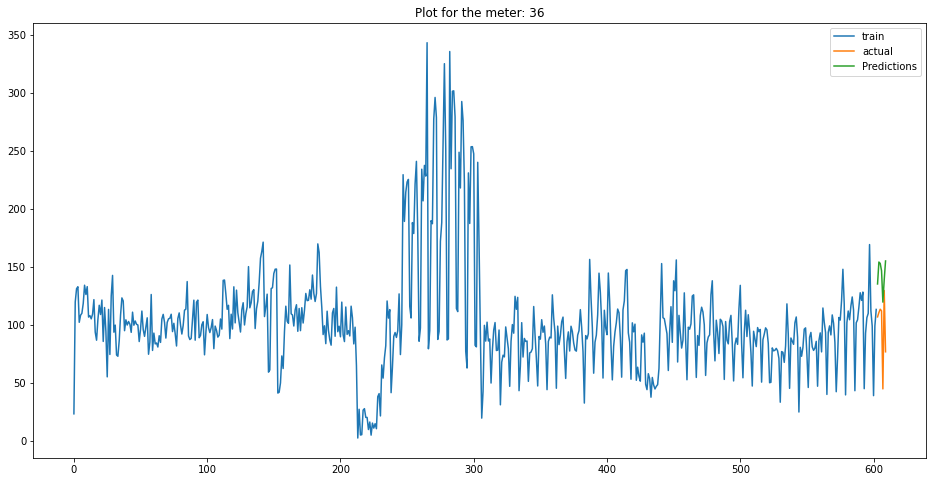

            ds        y
603 2021-06-24  106.942
604 2021-06-25  110.656
605 2021-06-26  113.576
606 2021-06-27  112.144
607 2021-06-28   44.976
608 2021-06-29  129.688
609 2021-06-30   76.906
            ds  Predictions
603 2021-06-24   135.304832
604 2021-06-25   154.178981
605 2021-06-26   152.993658
606 2021-06-27   146.676569
607 2021-06-28   119.669082
608 2021-06-29   138.785519
609 2021-06-30   155.109712
44.299275992268974
   mape_weekly  meterID    type
0       50.860       36    flag
1       45.056       36  unflag
2       38.303       36  unflag
3       44.299       36  unflag


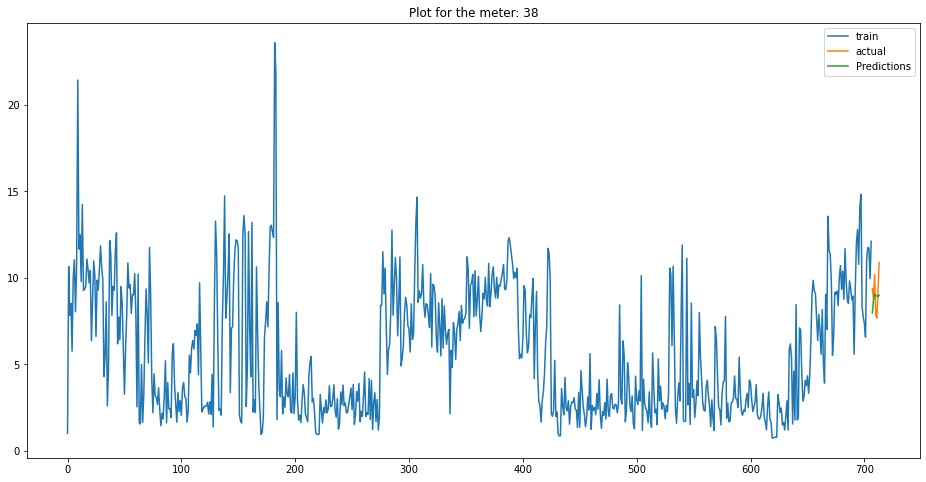

            ds       y
707 2021-07-08   9.384
708 2021-07-09   8.778
709 2021-07-10  10.196
710 2021-07-11   7.860
711 2021-07-12   7.686
712 2021-07-13   9.298
713 2021-07-14  10.883
            ds  Predictions
707 2021-07-08     7.971772
708 2021-07-09     8.714880
709 2021-07-10     9.060137
710 2021-07-11     8.958518
711 2021-07-12     8.954300
712 2021-07-13     8.923268
713 2021-07-14     9.003883
3.8983283150567574


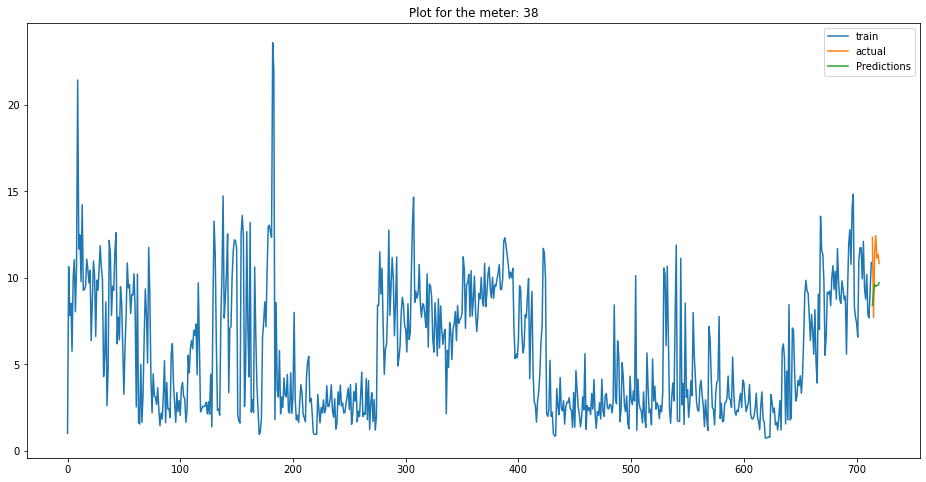

            ds       y
714 2021-07-15  12.344
715 2021-07-16   7.713
716 2021-07-17  11.400
717 2021-07-18  12.441
718 2021-07-19  11.144
719 2021-07-20  11.363
720 2021-07-21  10.826
            ds  Predictions
714 2021-07-15     8.403528
715 2021-07-16     9.196613
716 2021-07-17     9.609151
717 2021-07-18     9.517295
718 2021-07-19     9.548419
719 2021-07-20     9.576633
720 2021-07-21     9.713698
15.104894975815455


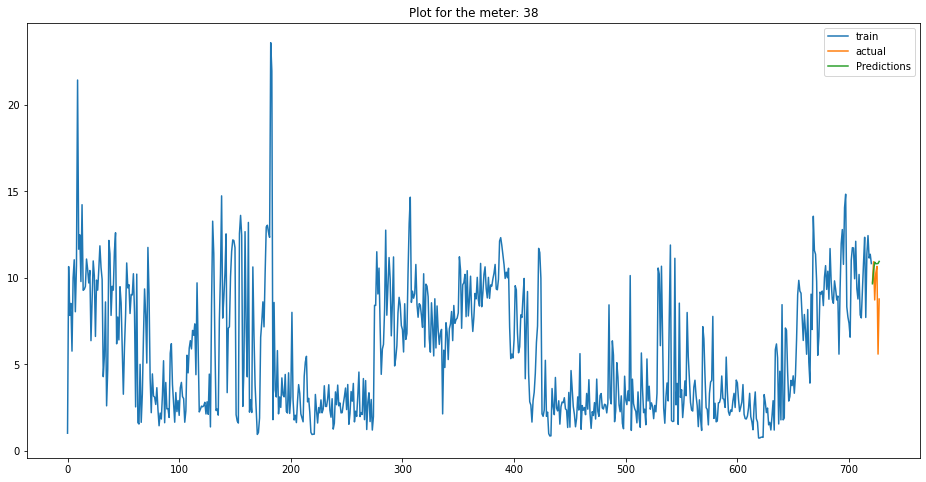

            ds       y
721 2021-07-22   9.718
722 2021-07-23  10.931
723 2021-07-24   8.723
724 2021-07-25  10.279
725 2021-07-26  10.662
726 2021-07-27   5.595
727 2021-07-28   8.776
            ds  Predictions
721 2021-07-22     9.658024
722 2021-07-23    10.427886
723 2021-07-24    10.906000
724 2021-07-25    10.817018
725 2021-07-26    10.819889
726 2021-07-27    10.829760
727 2021-07-28    10.949998
15.033974387192206


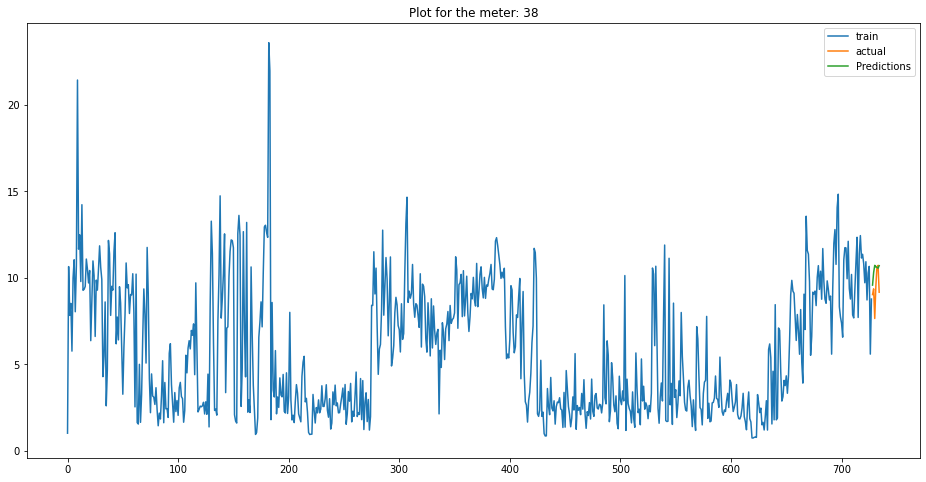

            ds       y
728 2021-07-29   9.034
729 2021-07-30   9.365
730 2021-07-31   7.651
731 2021-08-01   9.517
732 2021-08-02  10.652
733 2021-08-03  10.719
734 2021-08-04   9.170
            ds  Predictions
728 2021-07-29     9.579772
729 2021-07-30    10.309391
730 2021-07-31    10.721310
731 2021-08-01    10.628217
732 2021-08-02    10.616737
733 2021-08-03    10.556459
734 2021-08-04    10.704256
10.601046804723534
   mape_weekly  meterID    type
0        3.898       38  unflag
1       15.105       38  unflag
2       15.034       38  unflag
3       10.601       38  unflag


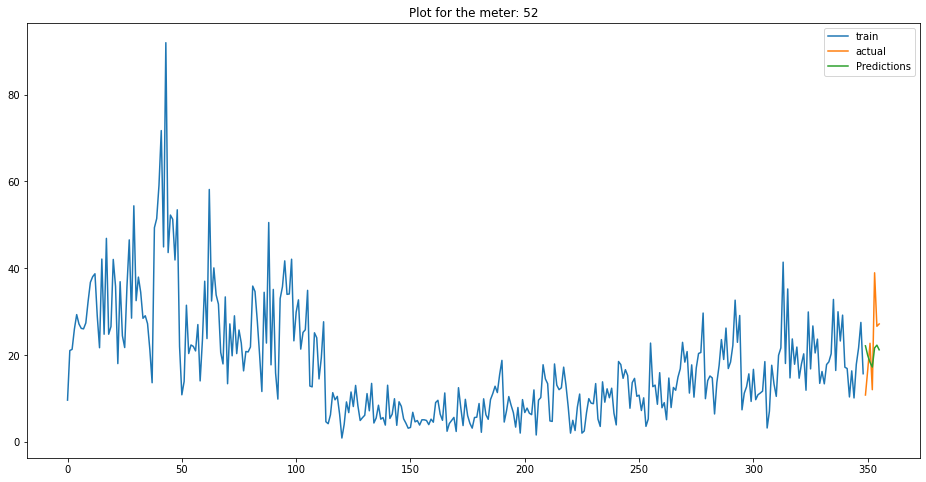

            ds       y
349 2021-07-07  10.840
350 2021-07-08  16.604
351 2021-07-09  22.752
352 2021-07-10  12.066
353 2021-07-11  38.984
354 2021-07-12  26.668
355 2021-07-13  27.204
            ds  Predictions
349 2021-07-07    22.165910
350 2021-07-08    19.945828
351 2021-07-09    18.368962
352 2021-07-10    17.281093
353 2021-07-11    21.680051
354 2021-07-12    22.319564
355 2021-07-13    21.250986
7.804127491987302


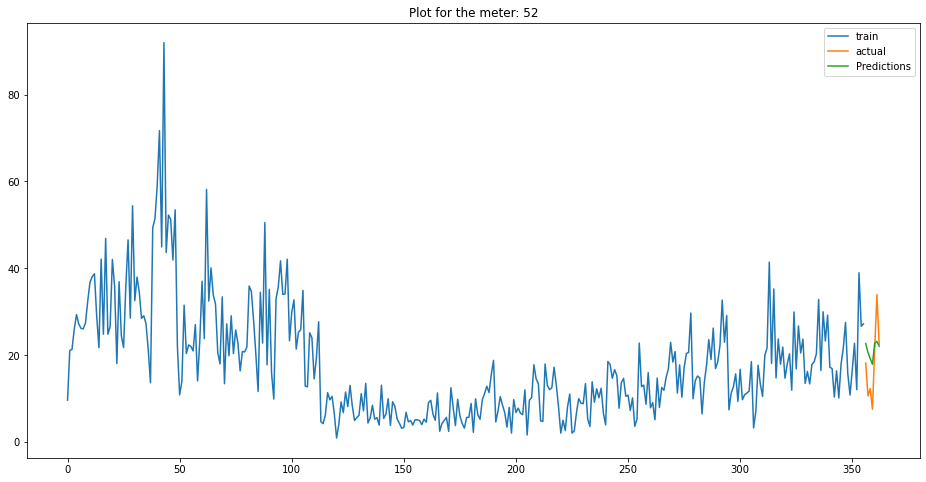

            ds       y
356 2021-07-14  18.204
357 2021-07-15  10.634
358 2021-07-16  12.310
359 2021-07-17   7.558
360 2021-07-18  21.389
361 2021-07-19  33.947
362 2021-07-20  22.548
            ds  Predictions
356 2021-07-14    22.673618
357 2021-07-15    20.630661
358 2021-07-16    19.223890
359 2021-07-17    17.918472
360 2021-07-18    22.755058
361 2021-07-19    23.182649
362 2021-07-20    22.084972
17.283609463579236


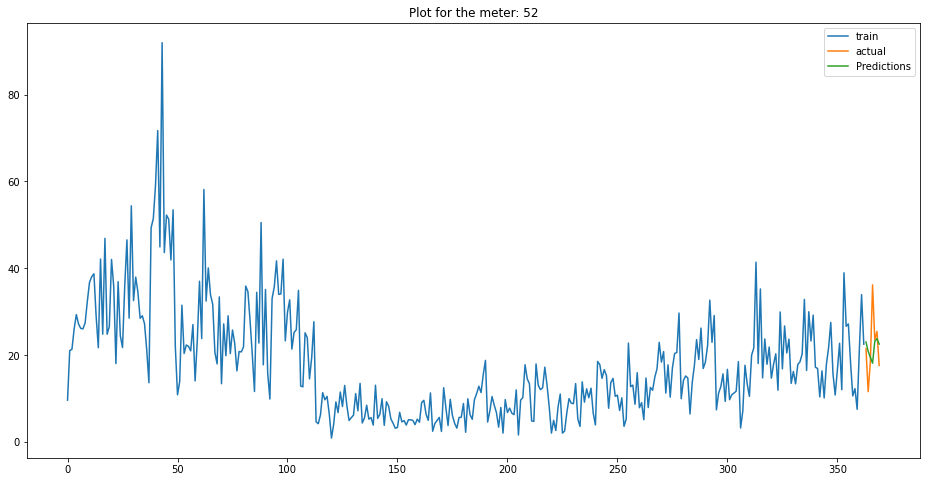

            ds       y
363 2021-07-21  21.522
364 2021-07-22  11.613
365 2021-07-23  18.549
366 2021-07-24  36.196
367 2021-07-25  23.556
368 2021-07-26  25.466
369 2021-07-27  17.649
            ds  Predictions
363 2021-07-21    23.036040
364 2021-07-22    20.878972
365 2021-07-23    19.518640
366 2021-07-24    18.170854
367 2021-07-25    23.192181
368 2021-07-26    23.818582
369 2021-07-27    22.572482
2.1761420485979186


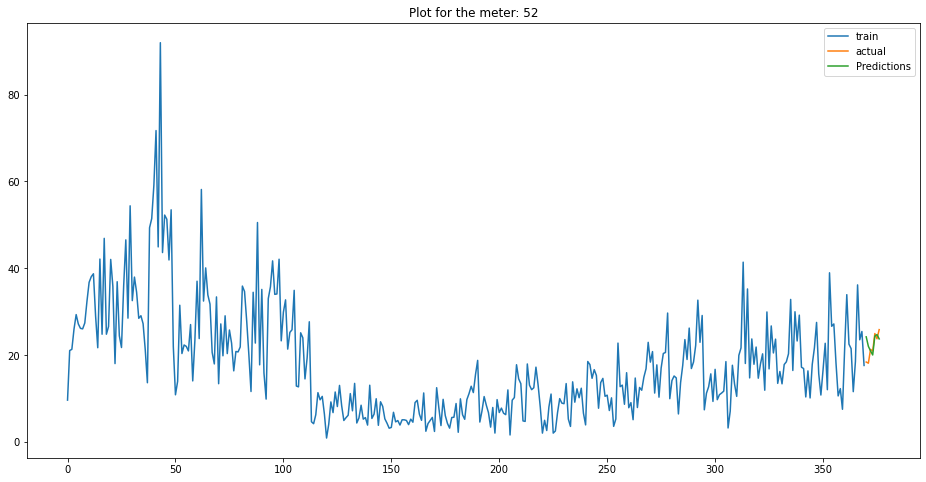

            ds       y
370 2021-07-28  18.436
371 2021-07-29  18.167
372 2021-07-30  21.356
373 2021-07-31  20.942
374 2021-08-01  24.994
375 2021-08-02  23.786
376 2021-08-03  25.898
            ds  Predictions
370 2021-07-28    24.234655
371 2021-07-29    22.046317
372 2021-07-30    21.001670
373 2021-07-31    20.060814
374 2021-08-01    24.422065
375 2021-08-02    24.754832
376 2021-08-03    23.763601
4.365801485482204
   mape_weekly  meterID    type
0        7.804       52  unflag
1       17.284       52  unflag
2        2.176       52  unflag
3        4.366       52  unflag


In [854]:
for i in TOU_list_above365:
    account_and_days_billcycle11(i,'shoulder')

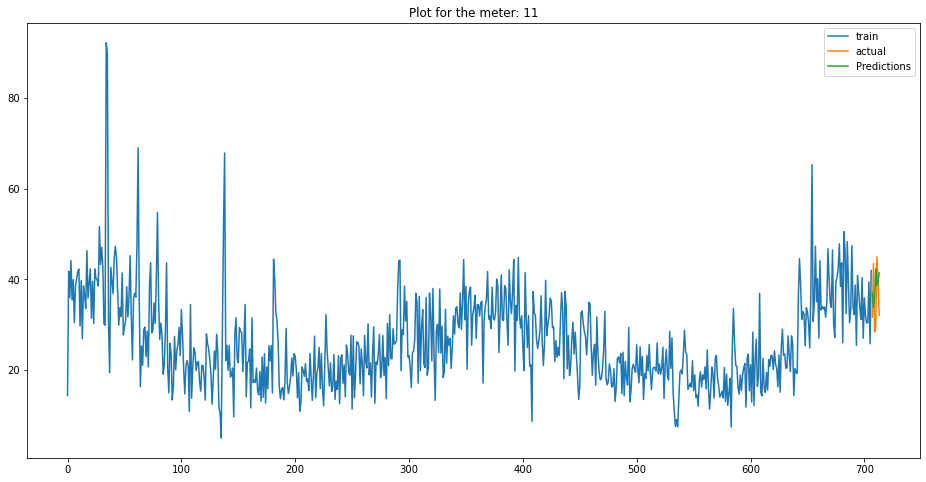

            ds       y
707 2021-07-08  31.663
708 2021-07-09  43.481
709 2021-07-10  28.400
710 2021-07-11  29.698
711 2021-07-12  44.989
712 2021-07-13  39.941
713 2021-07-14  32.097
            ds  Predictions
707 2021-07-08    37.165989
708 2021-07-09    33.735556
709 2021-07-10    35.686703
710 2021-07-11    42.349128
711 2021-07-12    38.663278
712 2021-07-13    39.457280
713 2021-07-14    41.429414
7.279505822457046


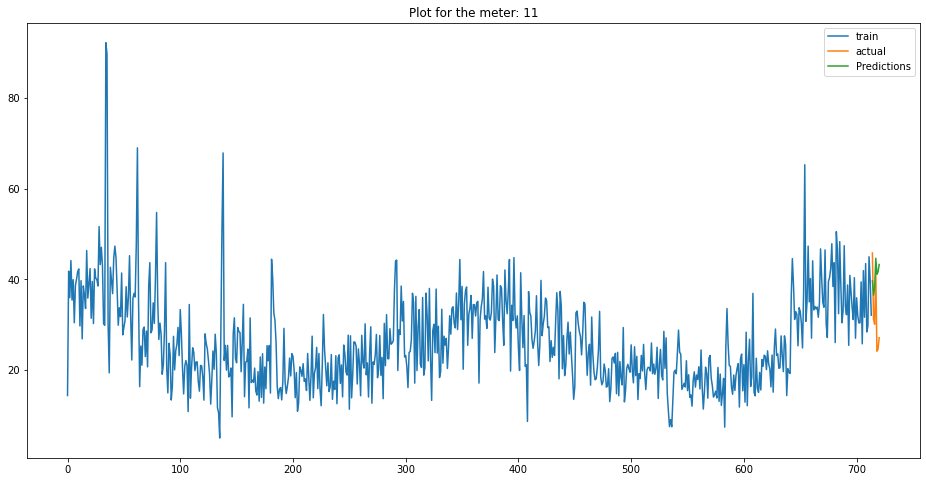

            ds       y
714 2021-07-15  45.820
715 2021-07-16  31.237
716 2021-07-17  30.108
717 2021-07-18  41.821
718 2021-07-19  24.158
719 2021-07-20  24.641
720 2021-07-21  27.141
            ds  Predictions
714 2021-07-15    39.666130
715 2021-07-16    36.487220
716 2021-07-17    38.177364
717 2021-07-18    44.644547
718 2021-07-19    41.114565
719 2021-07-20    41.658062
720 2021-07-21    43.271554
26.716983260855343


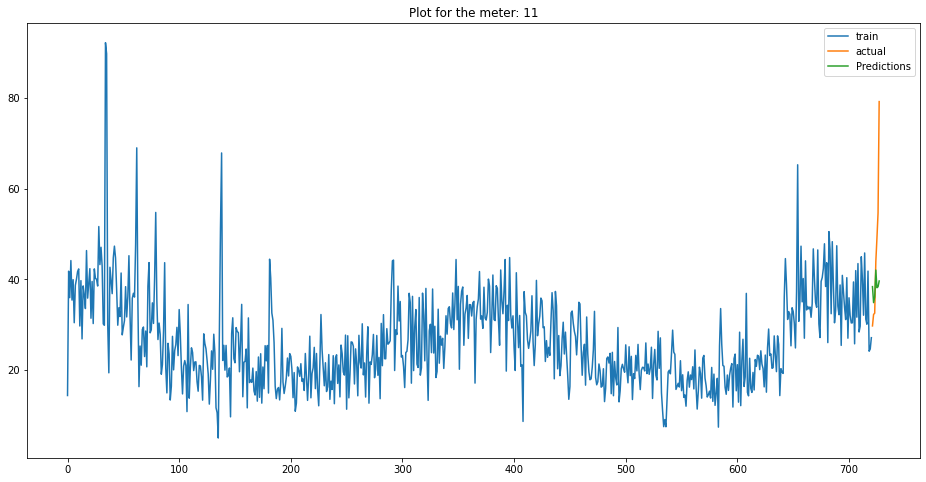

            ds       y
721 2021-07-22  29.735
722 2021-07-23  32.264
723 2021-07-24  32.540
724 2021-07-25  43.889
725 2021-07-26  49.072
726 2021-07-27  54.641
727 2021-07-28  79.195
            ds  Predictions
721 2021-07-22    38.397454
722 2021-07-23    34.874515
723 2021-07-24    36.133895
724 2021-07-25    42.045699
725 2021-07-26    38.158692
726 2021-07-27    38.374975
727 2021-07-28    39.638131
16.7154128860828


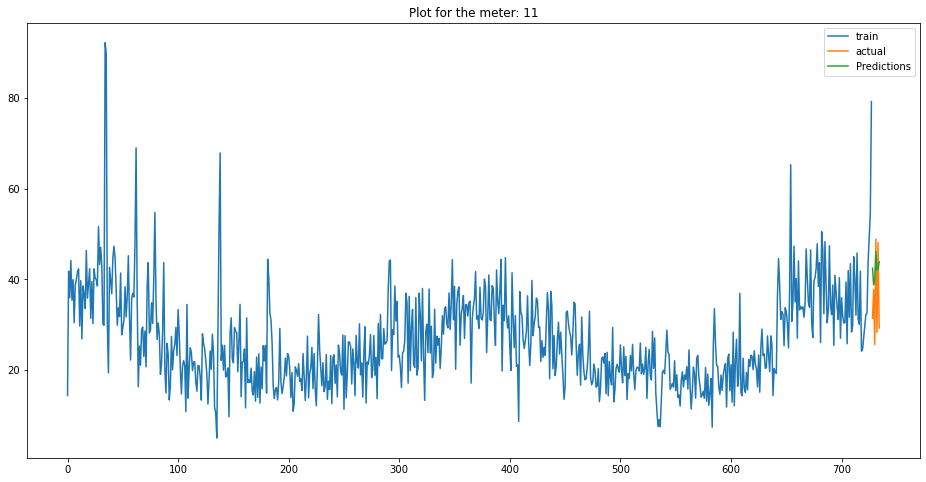

            ds       y
728 2021-07-29  31.440
729 2021-07-30  37.756
730 2021-07-31  25.645
731 2021-08-01  48.886
732 2021-08-02  28.304
733 2021-08-03  48.148
734 2021-08-04  29.280
            ds  Predictions
728 2021-07-29    42.475205
729 2021-07-30    38.791776
730 2021-07-31    39.936933
731 2021-08-01    46.143303
732 2021-08-02    42.080715
733 2021-08-03    42.272785
734 2021-08-04    43.867933
18.48385881743266
   mape_weekly  meterID    type
0        7.280       11  unflag
1       26.717       11  unflag
2       16.715       11  unflag
3       18.484       11  unflag


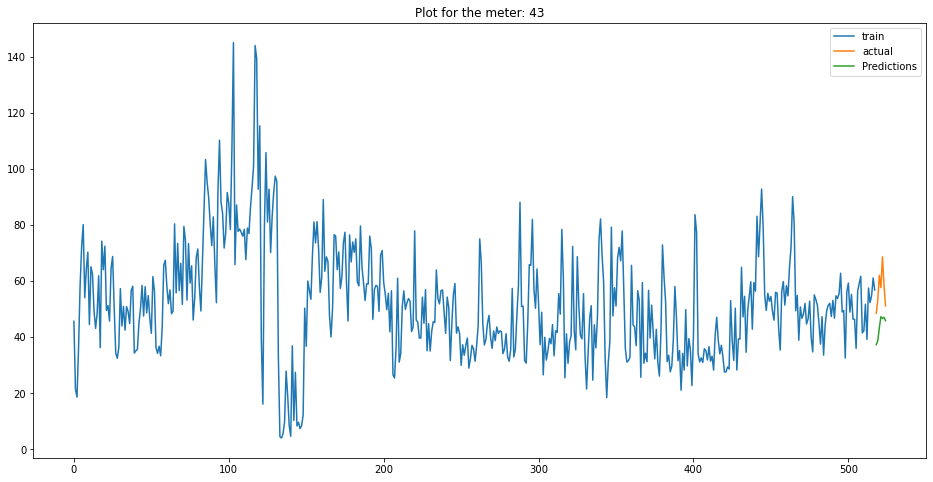

            ds       y
518 2021-07-08  48.530
519 2021-07-09  53.286
520 2021-07-10  62.030
521 2021-07-11  57.619
522 2021-07-12  68.623
523 2021-07-13  58.613
524 2021-07-14  51.144
            ds  Predictions
518 2021-07-08    37.343724
519 2021-07-09    38.701450
520 2021-07-10    43.409824
521 2021-07-11    47.293766
522 2021-07-12    46.648937
523 2021-07-13    47.054598
524 2021-07-14    45.875296
23.388414187194154


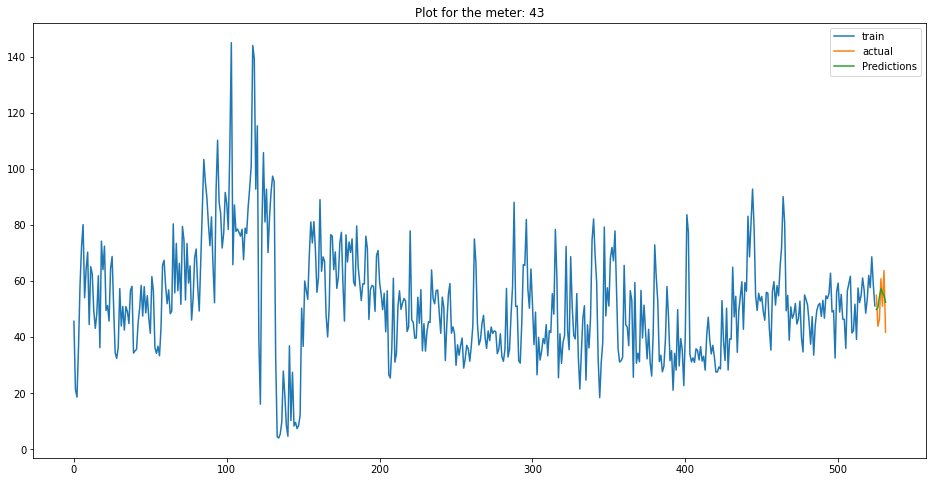

            ds       y
525 2021-07-15  54.931
526 2021-07-16  43.884
527 2021-07-17  46.399
528 2021-07-18  60.843
529 2021-07-19  51.019
530 2021-07-20  63.713
531 2021-07-21  41.751
            ds  Predictions
525 2021-07-15    49.835547
526 2021-07-16    50.507176
527 2021-07-17    54.480119
528 2021-07-18    57.371419
529 2021-07-19    55.734454
530 2021-07-20    54.892231
531 2021-07-21    52.446080
3.510516569479949


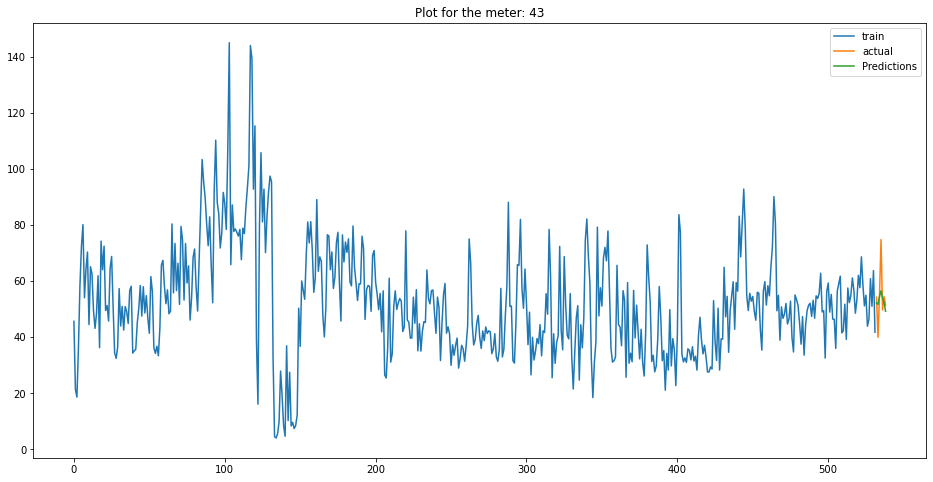

            ds       y
532 2021-07-22  54.260
533 2021-07-23  39.953
534 2021-07-24  55.106
535 2021-07-25  74.768
536 2021-07-26  49.680
537 2021-07-27  54.449
538 2021-07-28  51.360
            ds  Predictions
532 2021-07-22    52.203023
533 2021-07-23    51.652095
534 2021-07-24    54.536793
535 2021-07-25    56.530259
536 2021-07-26    53.973315
537 2021-07-27    52.475477
538 2021-07-28    49.237242
2.3625823828209347


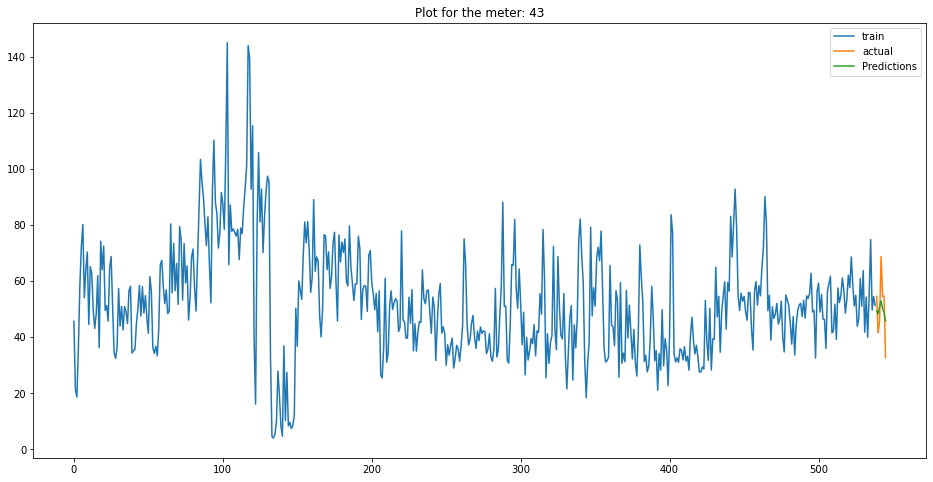

            ds       y
539 2021-07-29  54.515
540 2021-07-30  41.494
541 2021-07-31  45.619
542 2021-08-01  68.684
543 2021-08-02  54.523
544 2021-08-03  54.630
545 2021-08-04  32.670
            ds  Predictions
539 2021-07-29    49.285734
540 2021-07-30    48.244987
541 2021-07-31    50.932796
542 2021-08-01    52.916026
543 2021-08-02    50.134595
544 2021-08-03    48.781540
545 2021-08-04    45.723804
1.7366969999987134
   mape_weekly  meterID    type
0       23.388       43  unflag
1        3.511       43  unflag
2        2.363       43  unflag
3        1.737       43  unflag


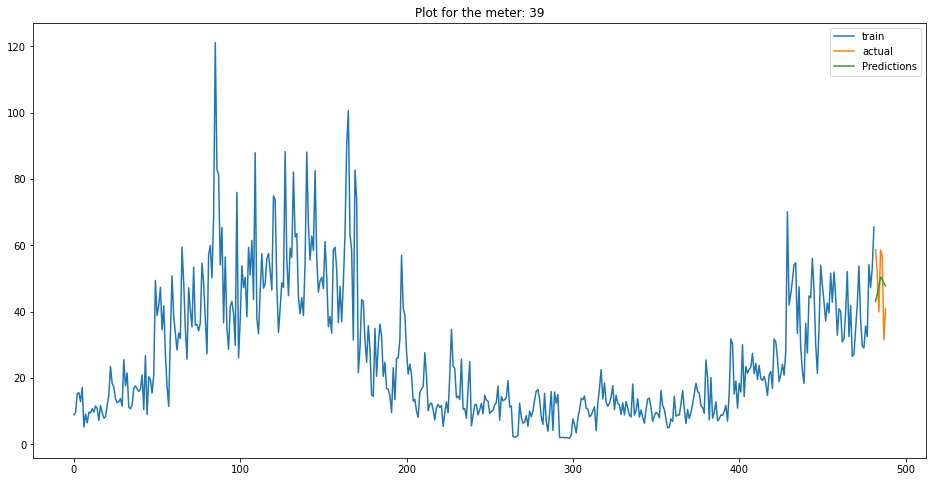

            ds       y
482 2021-07-07  58.674
483 2021-07-08  51.779
484 2021-07-09  39.930
485 2021-07-10  58.569
486 2021-07-11  56.639
487 2021-07-12  31.501
488 2021-07-13  40.812
            ds  Predictions
482 2021-07-07    43.084149
483 2021-07-08    45.274953
484 2021-07-09    47.603133
485 2021-07-10    50.395988
486 2021-07-11    49.713381
487 2021-07-12    48.550300
488 2021-07-13    47.795338
1.6237622524723105


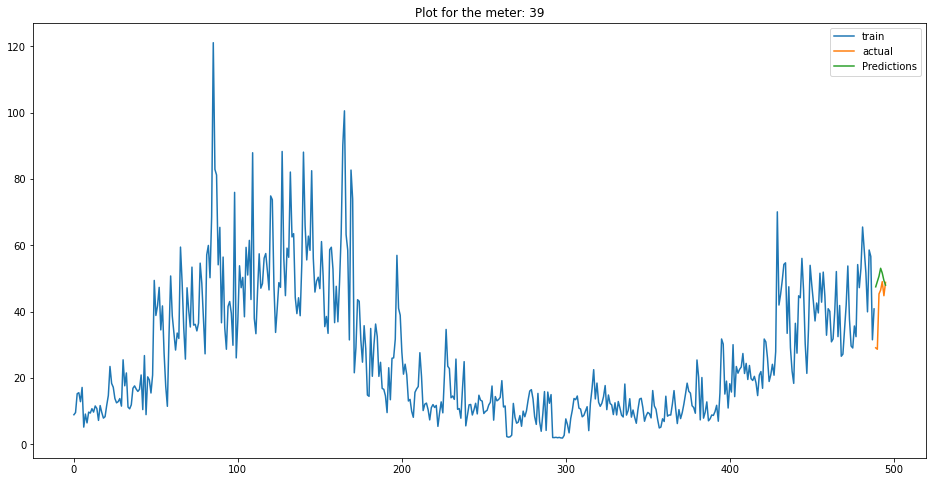

            ds       y
489 2021-07-14  29.082
490 2021-07-15  28.655
491 2021-07-16  45.336
492 2021-07-17  46.477
493 2021-07-18  49.031
494 2021-07-19  44.792
495 2021-07-20  48.803
            ds  Predictions
489 2021-07-14    47.471702
490 2021-07-15    49.072983
491 2021-07-16    50.676992
492 2021-07-17    53.064211
493 2021-07-18    51.610055
494 2021-07-19    49.398936
495 2021-07-20    47.993919
19.547395097164994


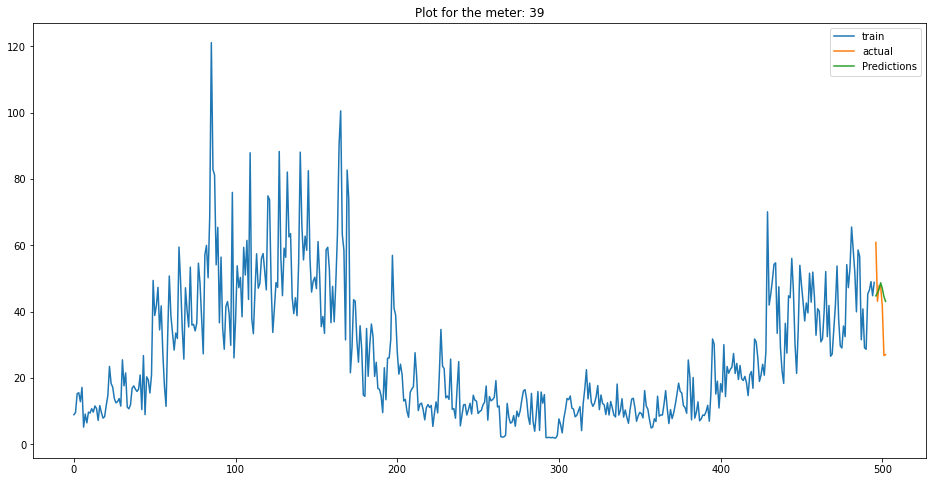

            ds       y
496 2021-07-21  60.857
497 2021-07-22  43.112
498 2021-07-23  47.831
499 2021-07-24  47.493
500 2021-07-25  41.593
501 2021-07-26  26.773
502 2021-07-27  27.047
            ds  Predictions
496 2021-07-21    44.735010
497 2021-07-22    45.689164
498 2021-07-23    46.876435
499 2021-07-24    48.693200
500 2021-07-25    46.968279
501 2021-07-26    44.559487
502 2021-07-27    43.086337
8.789068673003033


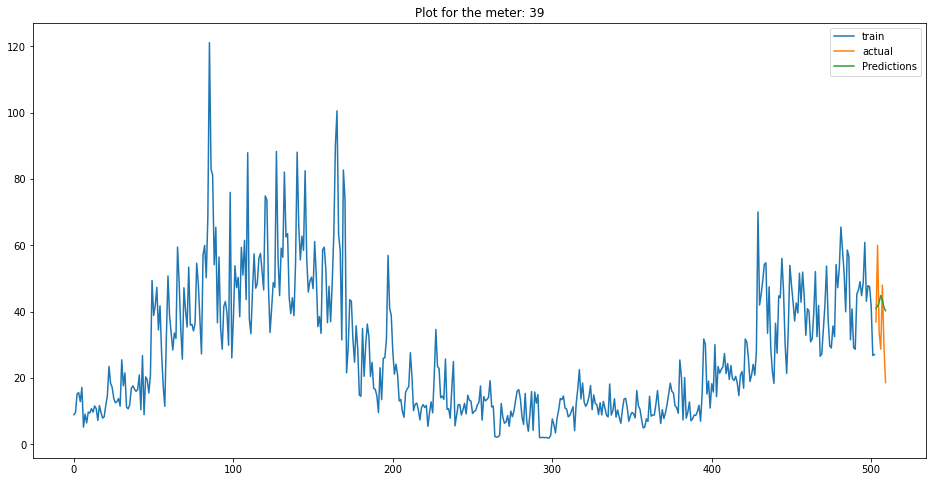

            ds       y
503 2021-07-28  36.922
504 2021-07-29  59.948
505 2021-07-30  33.650
506 2021-07-31  28.682
507 2021-08-01  48.006
508 2021-08-02  29.661
509 2021-08-03  18.595
            ds  Predictions
503 2021-07-28    40.930855
504 2021-07-29    41.658529
505 2021-07-30    42.925403
506 2021-07-31    44.846285
507 2021-08-01    43.391359
508 2021-08-02    41.285798
509 2021-08-03    40.275504
15.598962290443893
   mape_weekly  meterID    type
0        1.624       39  unflag
1       19.547       39  unflag
2        8.789       39  unflag
3       15.599       39  unflag


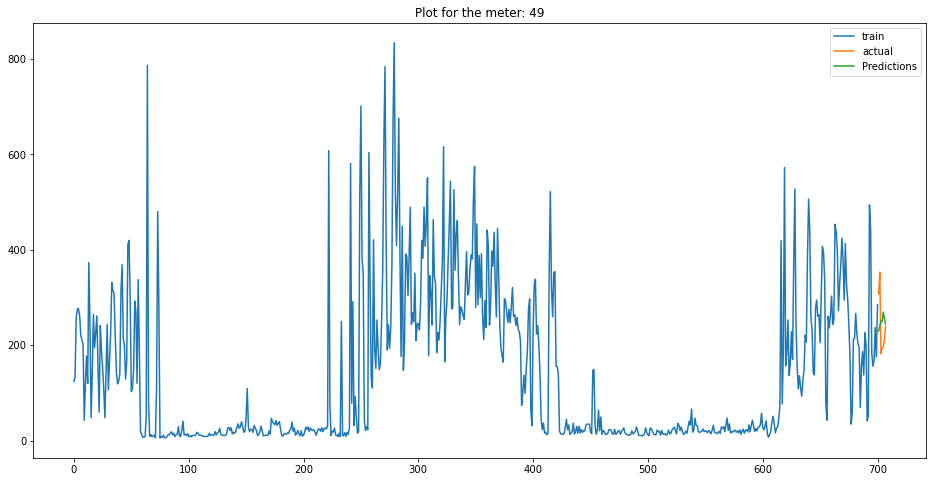

            ds        y
701 2021-07-07  307.462
702 2021-07-08  353.225
703 2021-07-09  182.097
704 2021-07-10  195.202
705 2021-07-11  195.874
706 2021-07-12  210.547
707 2021-07-13  239.990
            ds  Predictions
701 2021-07-07   229.435463
702 2021-07-08   240.555918
703 2021-07-09   249.880147
704 2021-07-10   249.158416
705 2021-07-11   269.222358
706 2021-07-12   256.489726
707 2021-07-13   244.731595
3.2698124379783264


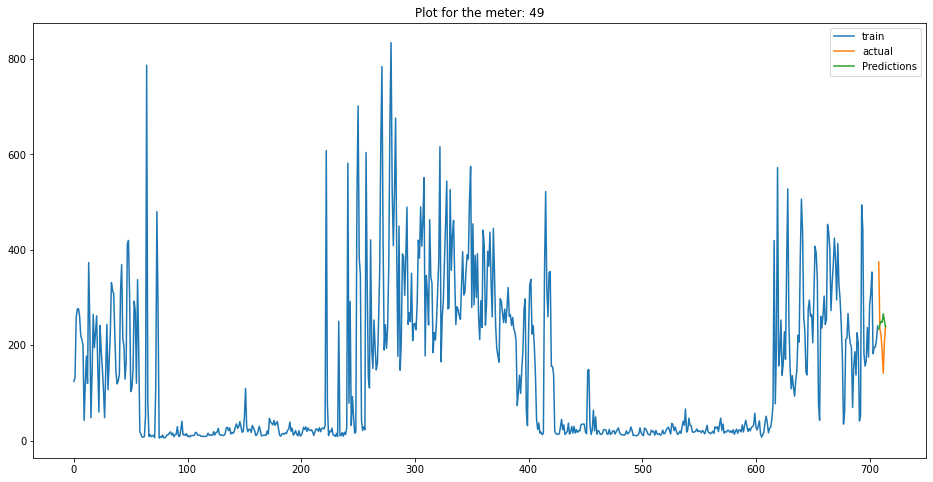

            ds        y
708 2021-07-14  374.224
709 2021-07-15  234.057
710 2021-07-16  221.467
711 2021-07-17  189.950
712 2021-07-18  140.982
713 2021-07-19  206.424
714 2021-07-20  239.987
            ds  Predictions
708 2021-07-14   233.514607
709 2021-07-15   243.251519
710 2021-07-16   249.791596
711 2021-07-17   247.550338
712 2021-07-18   265.554753
713 2021-07-19   251.456898
714 2021-07-20   238.348477
7.61482628491864


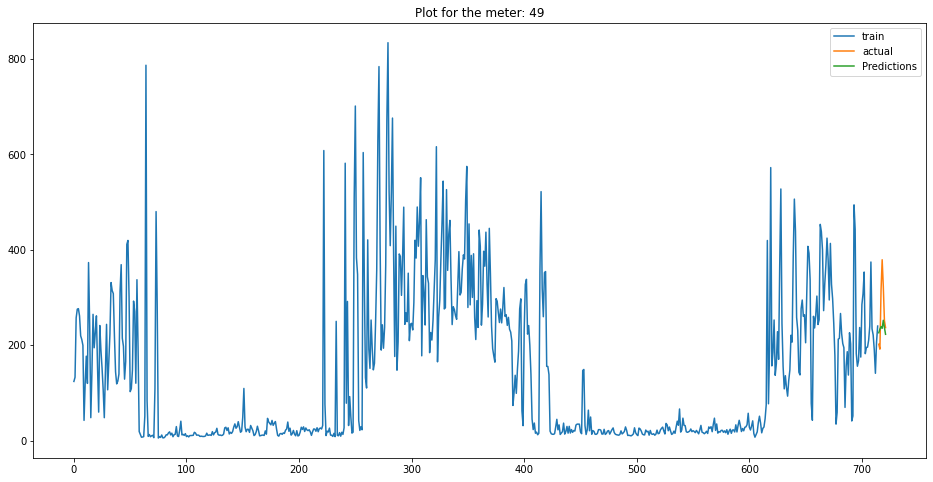

            ds        y
715 2021-07-21  201.877
716 2021-07-22  191.599
717 2021-07-23  314.680
718 2021-07-24  378.978
719 2021-07-25  323.550
720 2021-07-26  251.599
721 2021-07-27  236.804
            ds  Predictions
715 2021-07-21   225.927966
716 2021-07-22   233.541970
717 2021-07-23   238.885785
718 2021-07-24   235.273231
719 2021-07-25   252.087167
720 2021-07-26   237.076335
721 2021-07-27   222.736341
13.351584546806006


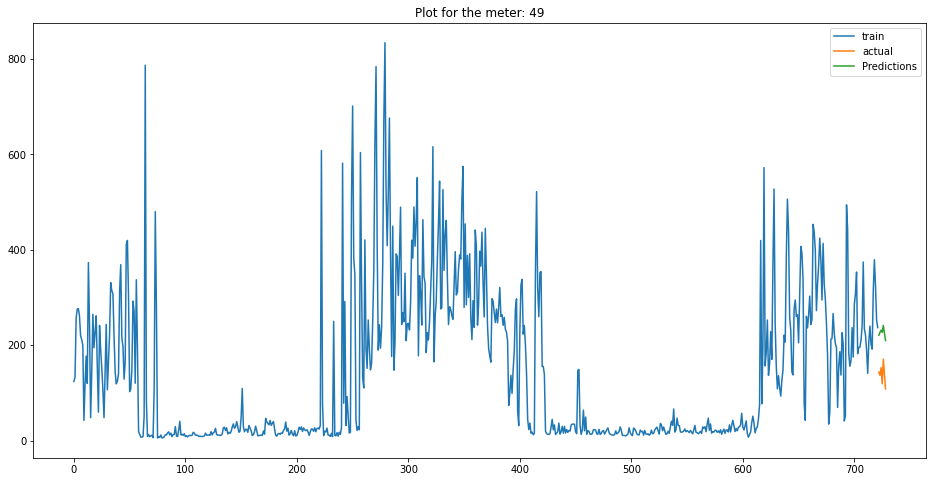

            ds        y
722 2021-07-28  143.401
723 2021-07-29  136.720
724 2021-07-30  152.956
725 2021-07-31  119.041
726 2021-08-01  170.787
727 2021-08-02  139.321
728 2021-08-03  108.318
            ds  Predictions
722 2021-07-28   220.755527
723 2021-07-29   226.881255
724 2021-07-30   231.310493
725 2021-07-31   226.706400
726 2021-08-01   241.320444
727 2021-08-02   224.928200
728 2021-08-03   209.628219
62.95299722846557
   mape_weekly  meterID    type
0        3.270       49  unflag
1        7.615       49  unflag
2       13.352       49  unflag
3       62.953       49    flag


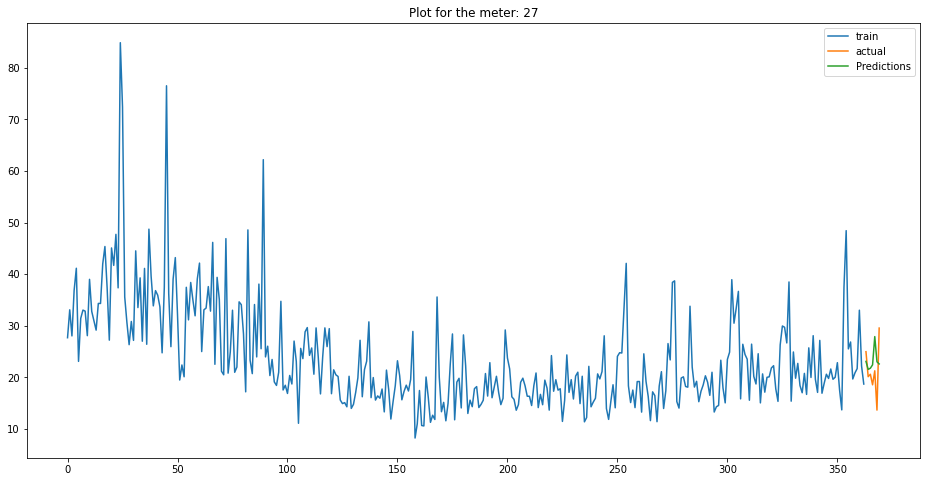

            ds       y
363 2021-07-07  24.990
364 2021-07-08  20.151
365 2021-07-09  20.619
366 2021-07-10  18.576
367 2021-07-11  21.289
368 2021-07-12  13.677
369 2021-07-13  29.562
            ds  Predictions
363 2021-07-07    23.106761
364 2021-07-08    21.559951
365 2021-07-09    21.789716
366 2021-07-10    22.445748
367 2021-07-11    27.910683
368 2021-07-12    23.025596
369 2021-07-13    22.613958
9.12807213273495


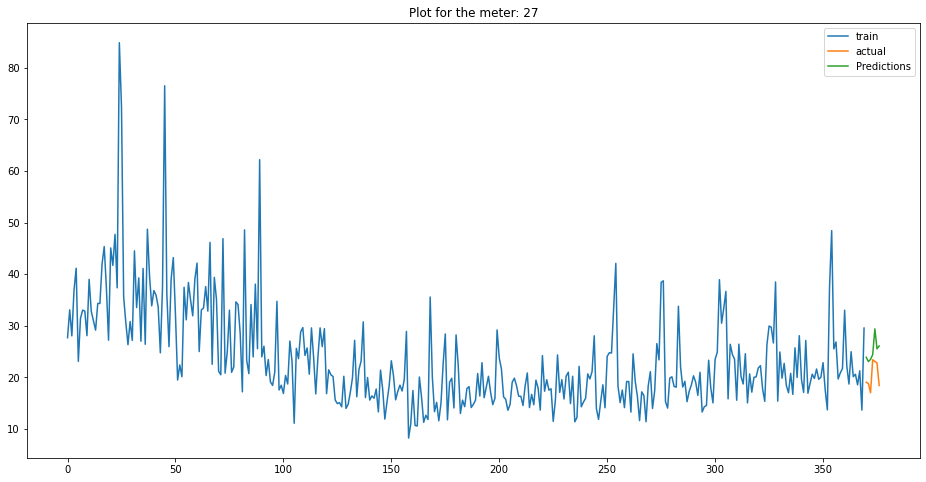

            ds       y
370 2021-07-14  19.084
371 2021-07-15  18.835
372 2021-07-16  17.033
373 2021-07-17  23.432
374 2021-07-18  23.092
375 2021-07-19  22.835
376 2021-07-20  18.443
            ds  Predictions
370 2021-07-14    23.912635
371 2021-07-15    23.084416
372 2021-07-16    23.498435
373 2021-07-17    24.411275
374 2021-07-18    29.407461
375 2021-07-19    25.552117
376 2021-07-20    26.091607
23.259556030817066


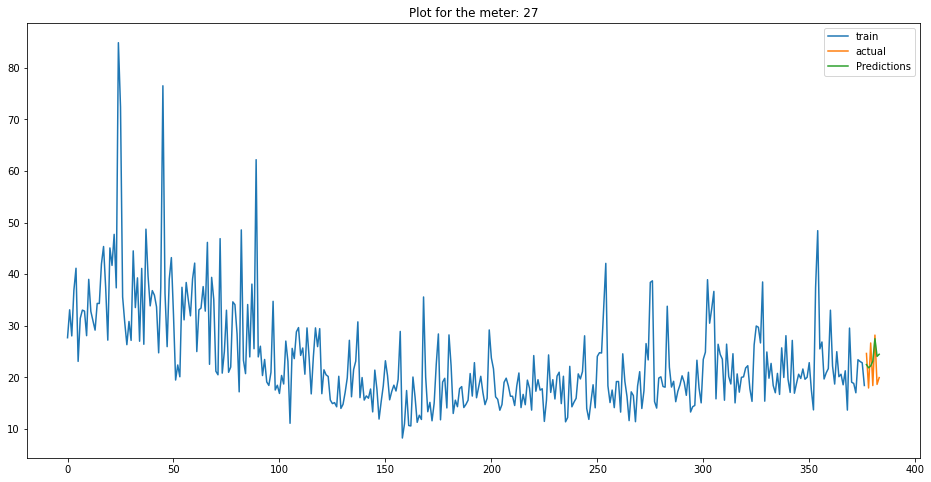

            ds       y
377 2021-07-21  24.648
378 2021-07-22  17.958
379 2021-07-23  26.674
380 2021-07-24  18.430
381 2021-07-25  28.201
382 2021-07-26  18.655
383 2021-07-27  19.971
            ds  Predictions
377 2021-07-21    22.495747
378 2021-07-22    21.865350
379 2021-07-23    22.229739
380 2021-07-24    23.145284
381 2021-07-25    27.498648
382 2021-07-26    24.087066
383 2021-07-27    24.485839
7.293187185102982


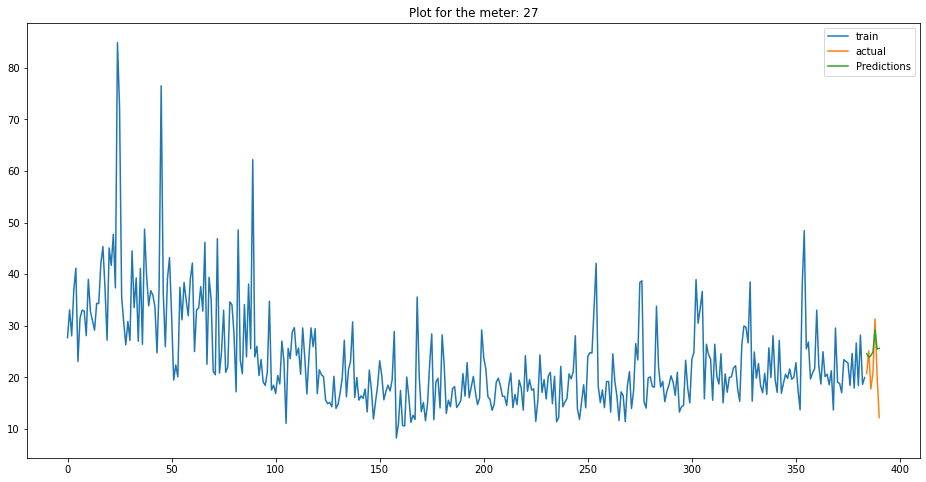

            ds       y
384 2021-07-28  20.749
385 2021-07-29  25.146
386 2021-07-30  17.749
387 2021-07-31  20.819
388 2021-08-01  31.350
389 2021-08-02  20.528
390 2021-08-03  12.226
            ds  Predictions
384 2021-07-28    24.616893
385 2021-07-29    23.848952
386 2021-07-30    24.218031
387 2021-07-31    24.911495
388 2021-08-01    29.249203
389 2021-08-02    25.482190
390 2021-08-03    25.643855
19.791487288341088
   mape_weekly  meterID    type
0        9.128       27  unflag
1       23.260       27  unflag
2        7.293       27  unflag
3       19.791       27  unflag


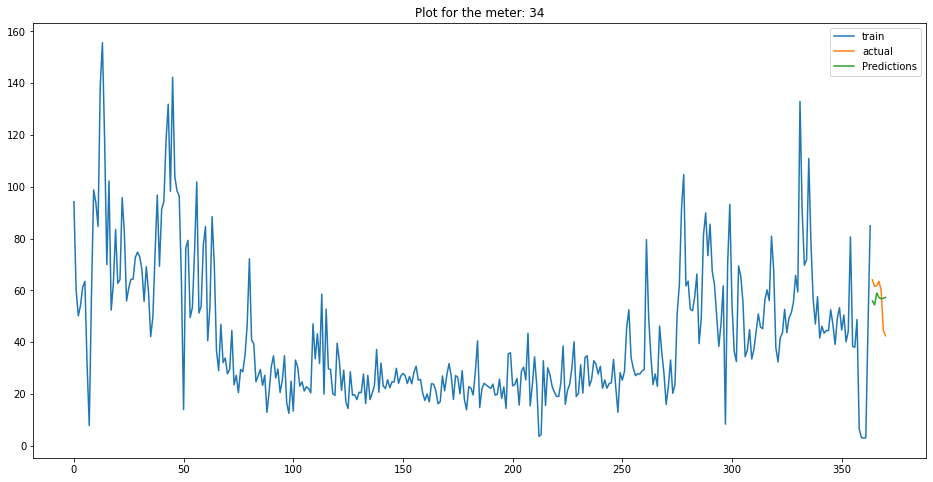

            ds       y
364 2021-07-07  64.095
365 2021-07-08  61.549
366 2021-07-09  61.837
367 2021-07-10  63.471
368 2021-07-11  60.015
369 2021-07-12  44.562
370 2021-07-13  42.468
            ds  Predictions
364 2021-07-07    55.939058
365 2021-07-08    54.383808
366 2021-07-09    59.008323
367 2021-07-10    57.242040
368 2021-07-11    56.776529
369 2021-07-12    56.962244
370 2021-07-13    57.306512
0.09509768618878191


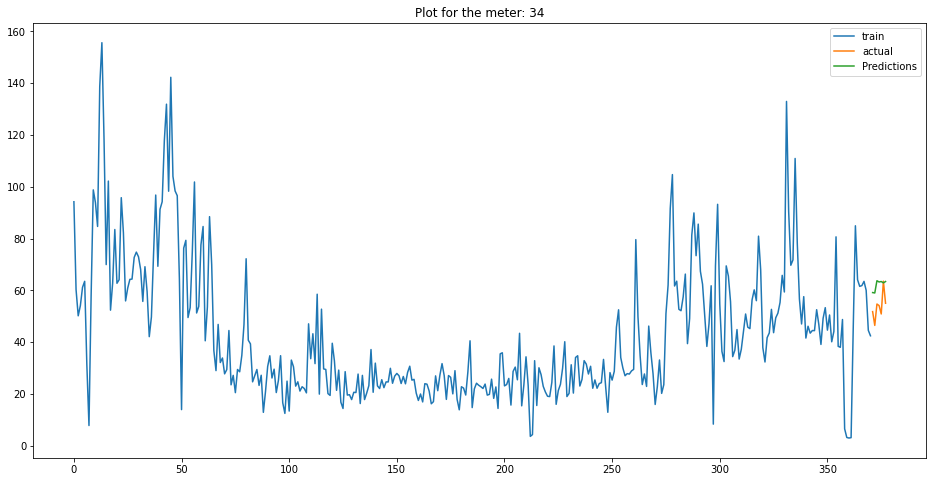

            ds       y
371 2021-07-14  51.796
372 2021-07-15  46.470
373 2021-07-16  54.728
374 2021-07-17  54.136
375 2021-07-18  50.886
376 2021-07-19  63.548
377 2021-07-20  55.028
            ds  Predictions
371 2021-07-14    59.149223
372 2021-07-15    58.994490
373 2021-07-16    63.718544
374 2021-07-17    63.241877
375 2021-07-18    63.416384
376 2021-07-19    62.893625
377 2021-07-20    63.406921
15.462108264551835


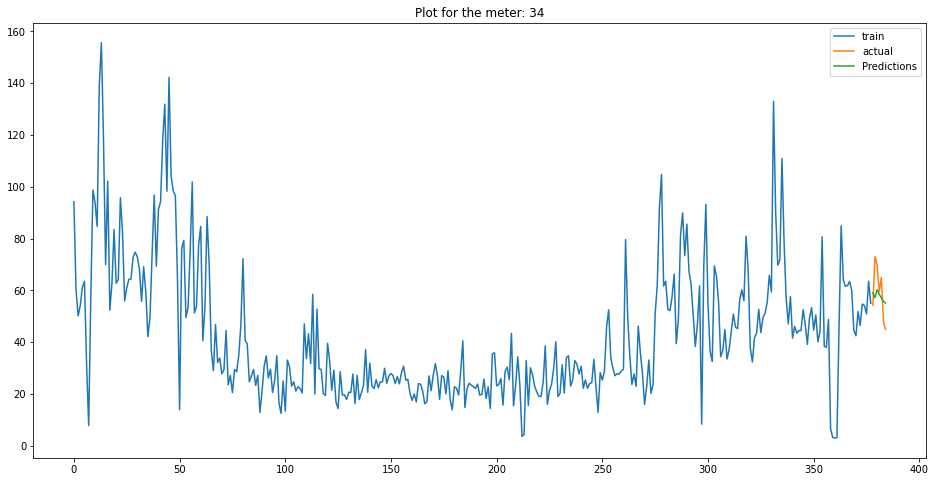

            ds       y
378 2021-07-21  54.233
379 2021-07-22  73.107
380 2021-07-23  69.751
381 2021-07-24  59.397
382 2021-07-25  64.971
383 2021-07-26  48.147
384 2021-07-27  44.899
            ds  Predictions
378 2021-07-21    59.012210
379 2021-07-22    57.192994
380 2021-07-23    60.277329
381 2021-07-24    58.418053
382 2021-07-25    57.171672
383 2021-07-26    55.732635
384 2021-07-27    55.132350
2.7907402979602662


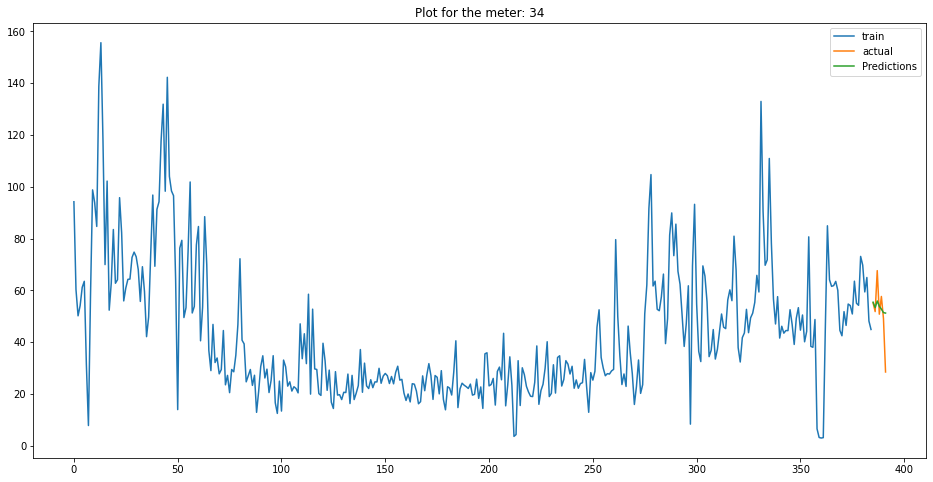

            ds       y
385 2021-07-28  55.155
386 2021-07-29  51.807
387 2021-07-30  67.619
388 2021-07-31  50.805
389 2021-08-01  57.644
390 2021-08-02  49.106
391 2021-08-03  28.482
            ds  Predictions
385 2021-07-28    55.427676
386 2021-07-29    53.339753
387 2021-07-30    55.910725
388 2021-07-31    53.831259
389 2021-08-01    52.759720
390 2021-08-02    51.406026
391 2021-08-03    51.233444
3.685507512522884
   mape_weekly  meterID    type
0        0.095       34  unflag
1       15.462       34  unflag
2        2.791       34  unflag
3        3.686       34  unflag


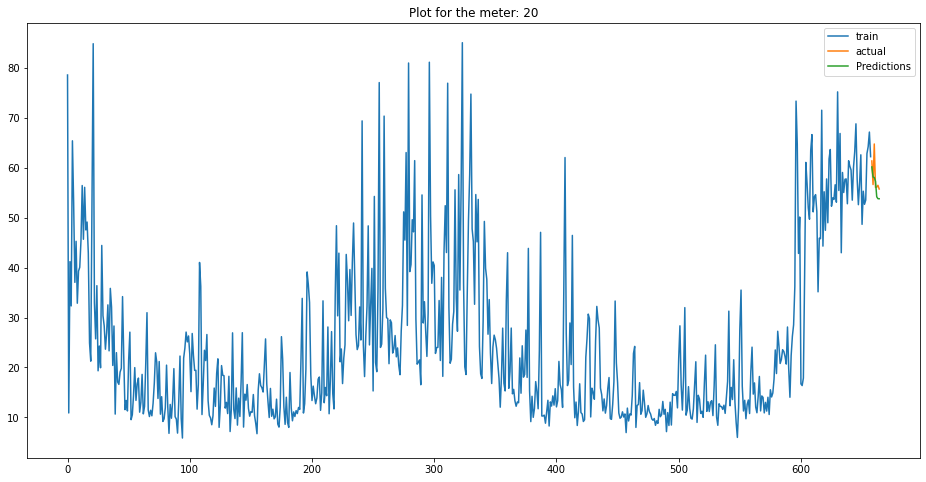

            ds       y
658 2021-07-08  61.377
659 2021-07-09  56.647
660 2021-07-10  64.777
661 2021-07-11  56.073
662 2021-07-12  56.117
663 2021-07-13  56.495
664 2021-07-14  55.757
            ds  Predictions
658 2021-07-08    60.171373
659 2021-07-09    58.158447
660 2021-07-10    58.074925
661 2021-07-11    57.294150
662 2021-07-12    54.199819
663 2021-07-13    53.810759
664 2021-07-14    53.801636
2.8808087116474947


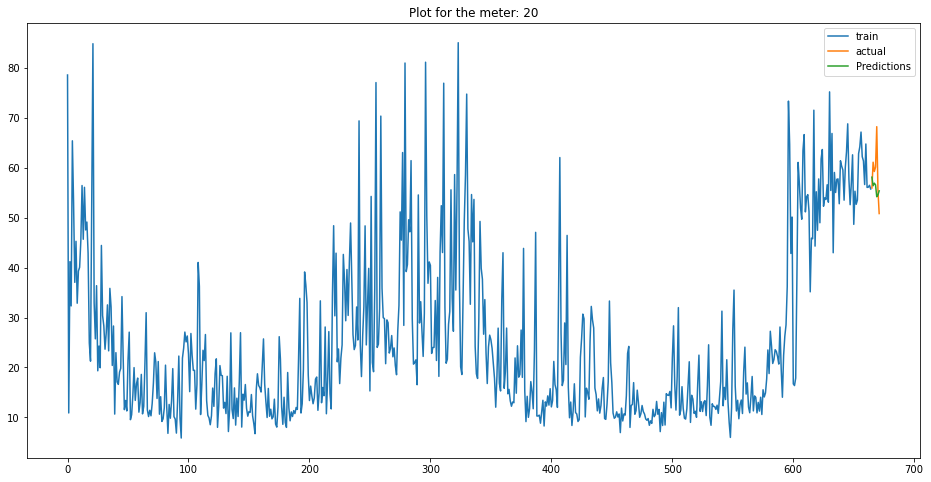

            ds       y
665 2021-07-15  55.963
666 2021-07-16  61.124
667 2021-07-17  59.261
668 2021-07-18  60.132
669 2021-07-19  68.246
670 2021-07-20  55.479
671 2021-07-21  50.834
            ds  Predictions
665 2021-07-15    58.126109
666 2021-07-16    56.405086
667 2021-07-17    56.927971
668 2021-07-18    56.577071
669 2021-07-19    54.206756
670 2021-07-20    54.586372
671 2021-07-21    55.379740
4.581048476841701


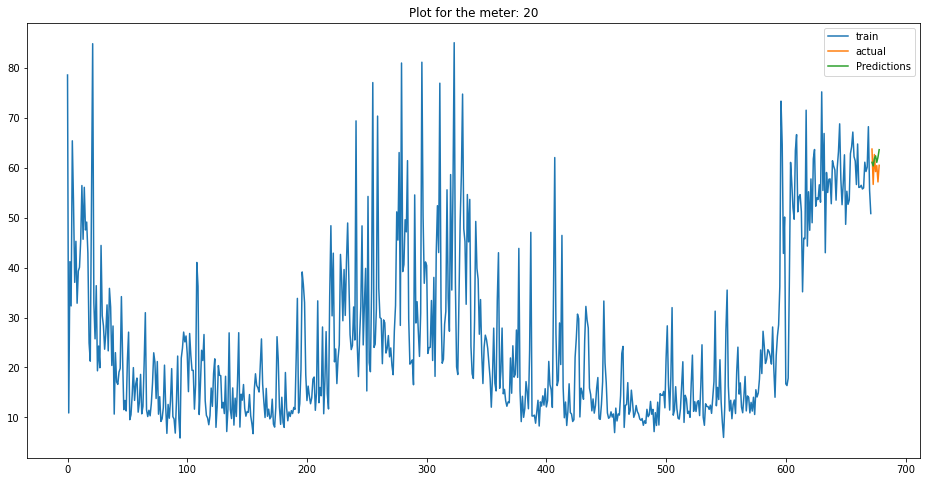

            ds       y
672 2021-07-22  63.753
673 2021-07-23  56.674
674 2021-07-24  62.667
675 2021-07-25  59.244
676 2021-07-26  60.446
677 2021-07-27  57.171
678 2021-07-28  60.499
            ds  Predictions
672 2021-07-22    61.103279
673 2021-07-23    60.379672
674 2021-07-24    61.809425
675 2021-07-25    62.403835
676 2021-07-26    61.097722
677 2021-07-27    62.122474
678 2021-07-28    63.631242
2.8763310454698985


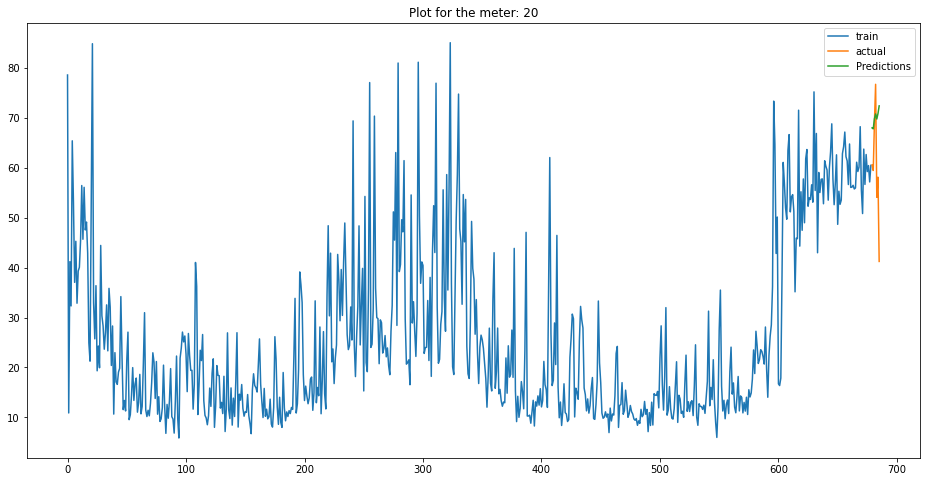

            ds       y
679 2021-07-29  60.561
680 2021-07-30  59.469
681 2021-07-31  69.034
682 2021-08-01  76.736
683 2021-08-02  54.101
684 2021-08-03  58.120
685 2021-08-04  41.241
            ds  Predictions
679 2021-07-29    68.001405
680 2021-07-30    67.808375
681 2021-07-31    69.847744
682 2021-08-01    70.797778
683 2021-08-02    69.781453
684 2021-08-03    70.870133
685 2021-08-04    72.412199
16.757322659435108
   mape_weekly  meterID    type
0        2.881       20  unflag
1        4.581       20  unflag
2        2.876       20  unflag
3       16.757       20  unflag


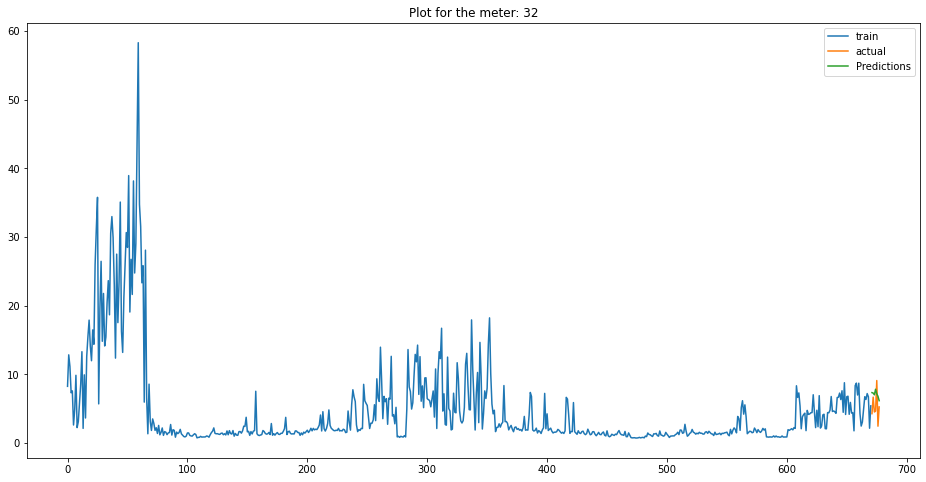

            ds      y
671 2021-07-07  4.266
672 2021-07-08  6.673
673 2021-07-09  4.504
674 2021-07-10  4.634
675 2021-07-11  9.088
676 2021-07-12  2.438
677 2021-07-13  5.243
            ds  Predictions
671 2021-07-07     7.328746
672 2021-07-08     7.262514
673 2021-07-09     7.010348
674 2021-07-10     7.820483
675 2021-07-11     7.149870
676 2021-07-12     6.797655
677 2021-07-13     6.152877
34.40398640442004


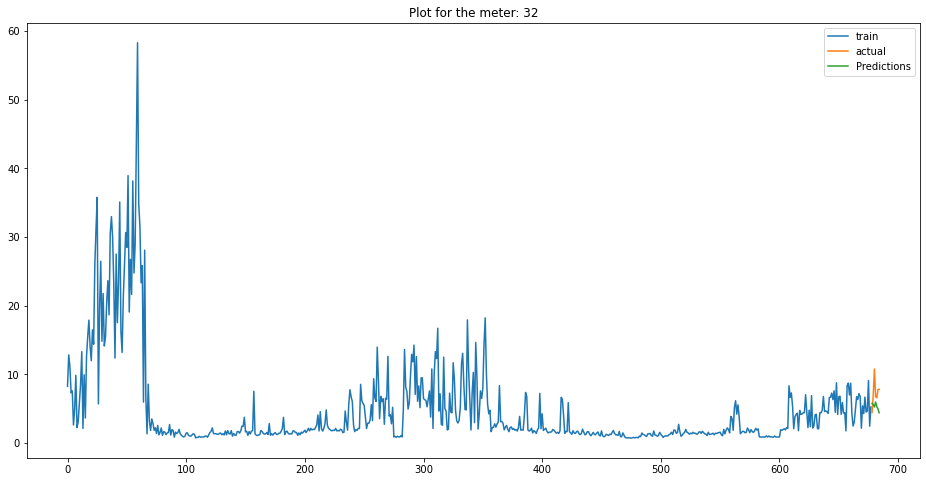

            ds       y
678 2021-07-14   4.435
679 2021-07-15   6.956
680 2021-07-16  10.749
681 2021-07-17   6.753
682 2021-07-18   6.576
683 2021-07-19   7.770
684 2021-07-20   7.805
            ds  Predictions
678 2021-07-14     5.776093
679 2021-07-15     5.583251
680 2021-07-16     5.234134
681 2021-07-17     5.966523
682 2021-07-18     5.296441
683 2021-07-19     4.957481
684 2021-07-20     4.393610
27.106939704257695


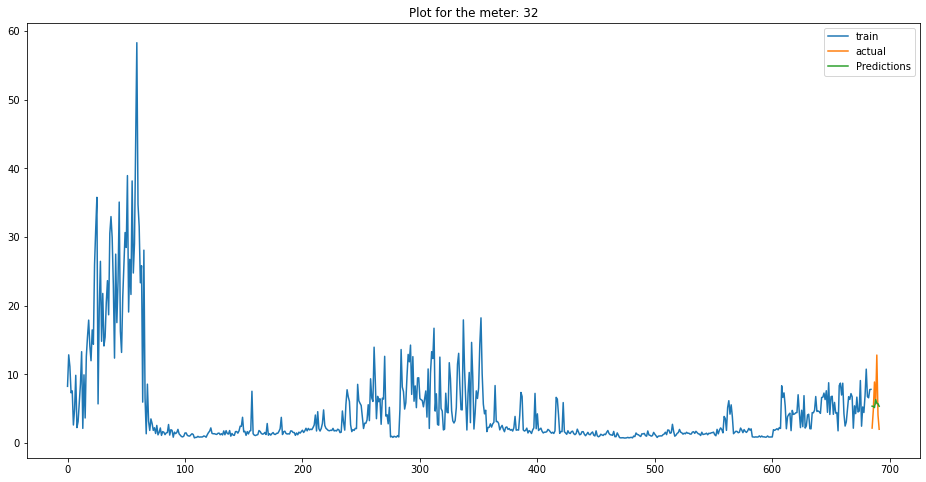

            ds       y
685 2021-07-21   2.161
686 2021-07-22   4.725
687 2021-07-23   8.876
688 2021-07-24   5.651
689 2021-07-25  12.802
690 2021-07-26   4.075
691 2021-07-27   1.990
            ds  Predictions
685 2021-07-21     5.352218
686 2021-07-22     5.328817
687 2021-07-23     5.151661
688 2021-07-24     6.310227
689 2021-07-25     5.785682
690 2021-07-26     5.698424
691 2021-07-27     5.342310
3.253877157490987


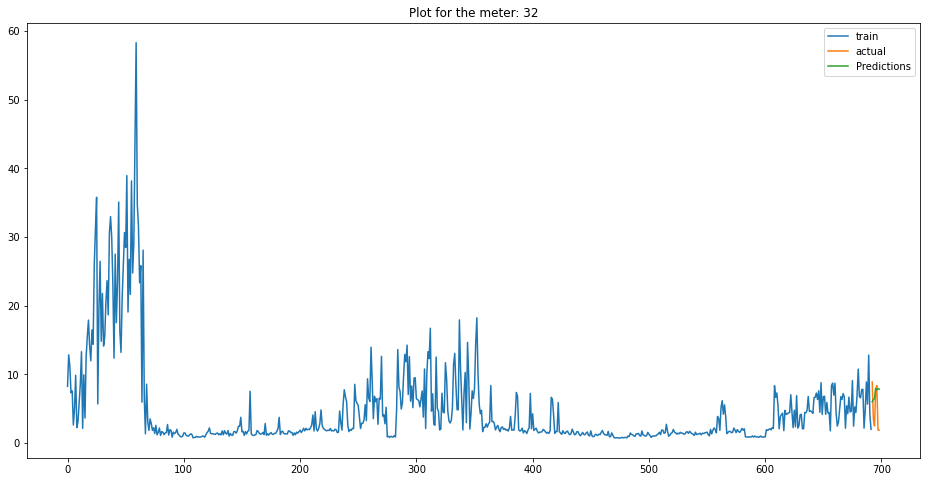

            ds      y
692 2021-07-28  8.882
693 2021-07-29  3.494
694 2021-07-30  2.480
695 2021-07-31  7.903
696 2021-08-01  8.377
697 2021-08-02  1.871
698 2021-08-03  1.867
            ds  Predictions
692 2021-07-28     5.992344
693 2021-07-29     6.300981
694 2021-07-30     6.466446
695 2021-07-31     7.923112
696 2021-08-01     7.744211
697 2021-08-02     7.929271
698 2021-08-03     7.843098
43.94524007961222
   mape_weekly  meterID    type
0       34.404       32  unflag
1       27.107       32  unflag
2        3.254       32  unflag
3       43.945       32  unflag


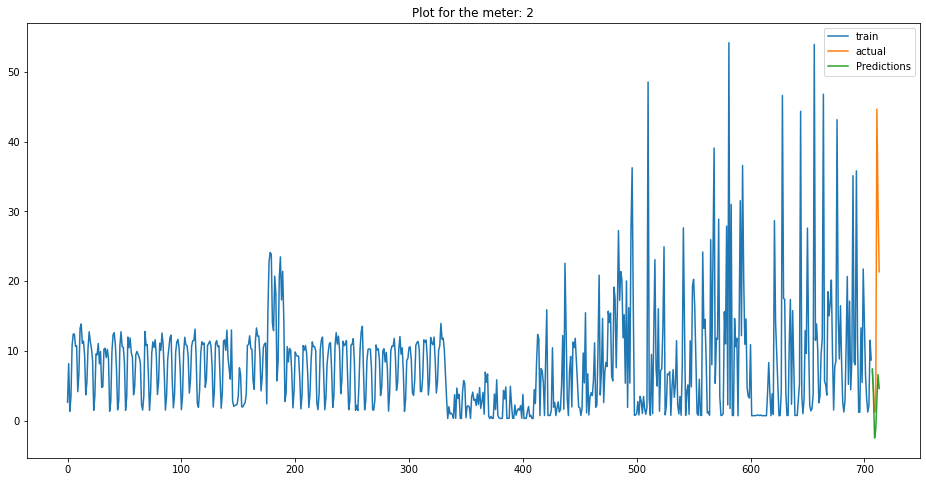

            ds       y
707 2021-07-08   7.144
708 2021-07-09   4.865
709 2021-07-10   1.182
710 2021-07-11   2.227
711 2021-07-12  44.668
712 2021-07-13  31.001
713 2021-07-14  21.342
            ds  Predictions
707 2021-07-08     7.399970
708 2021-07-09     3.365189
709 2021-07-10    -2.505203
710 2021-07-11    -1.234905
711 2021-07-12     2.927472
712 2021-07-13     6.601361
713 2021-07-14     4.614952
81.17137437755508


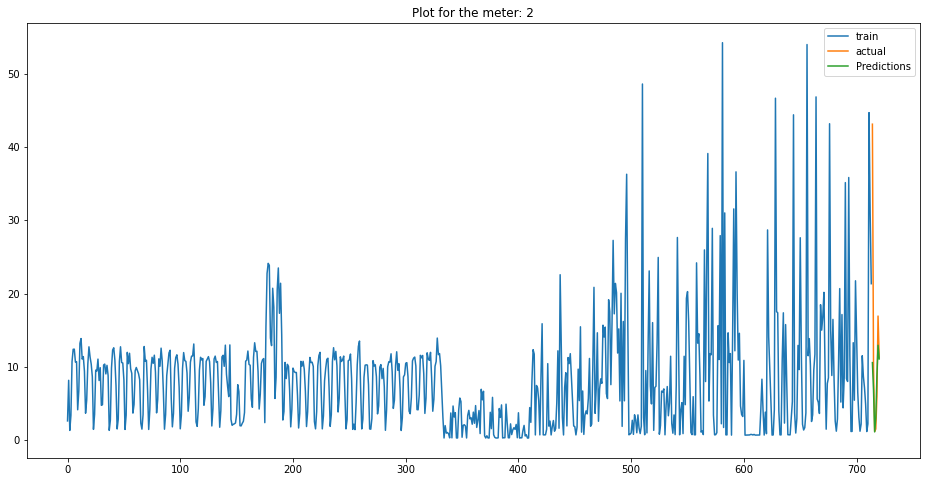

            ds       y
714 2021-07-15  43.093
715 2021-07-16   9.840
716 2021-07-17   1.206
717 2021-07-18   1.533
718 2021-07-19   5.933
719 2021-07-20  16.931
720 2021-07-21  11.226
            ds  Predictions
714 2021-07-15    10.579955
715 2021-07-16     6.786303
716 2021-07-17     1.133306
717 2021-07-18     3.041215
718 2021-07-19     8.779634
719 2021-07-20    12.949395
720 2021-07-21    11.080369
39.45079557056154


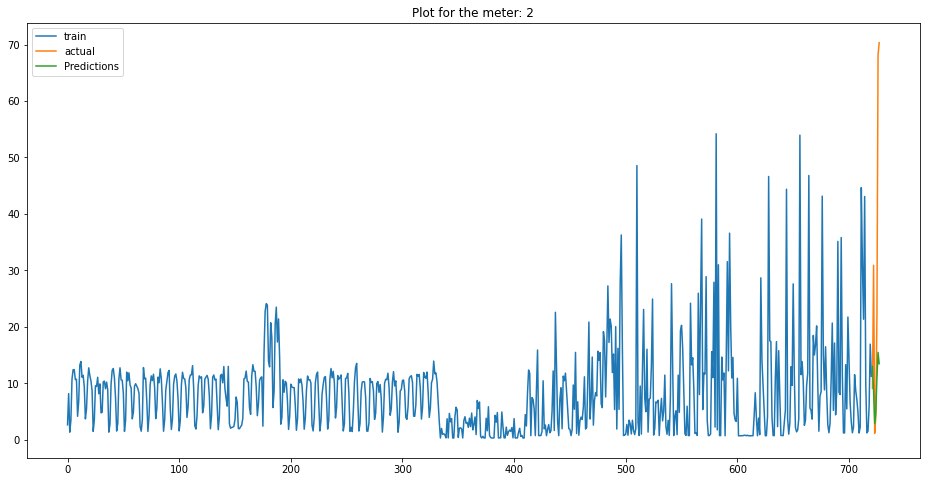

            ds       y
721 2021-07-22   9.087
722 2021-07-23  30.906
723 2021-07-24   1.143
724 2021-07-25   4.097
725 2021-07-26  21.992
726 2021-07-27  68.130
727 2021-07-28  70.335
            ds  Predictions
721 2021-07-22    12.965590
722 2021-07-23     8.540674
723 2021-07-24     2.842710
724 2021-07-25     4.890792
725 2021-07-26    10.934706
726 2021-07-27    15.465130
727 2021-07-28    13.467719
66.40219720402655


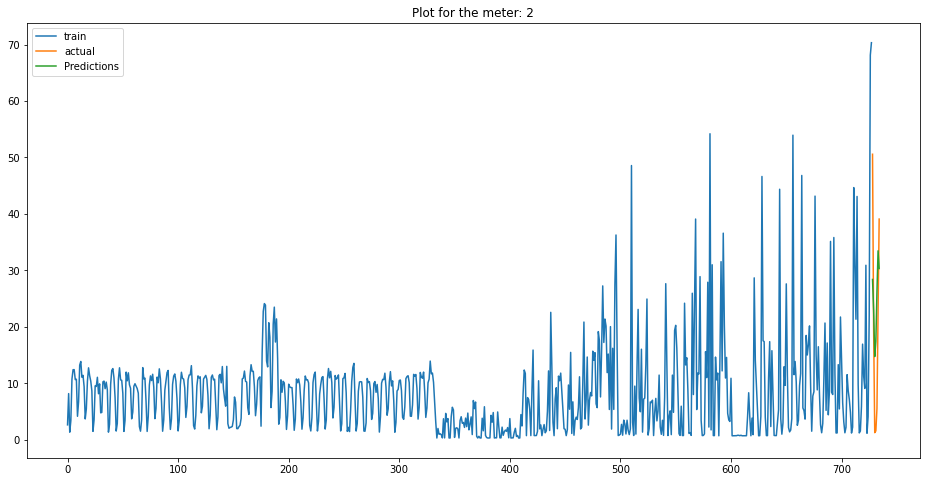

            ds       y
728 2021-07-29  50.571
729 2021-07-30  19.442
730 2021-07-31   1.250
731 2021-08-01   1.569
732 2021-08-02   5.530
733 2021-08-03  22.566
734 2021-08-04  39.086
            ds  Predictions
728 2021-07-29    28.388539
729 2021-07-30    22.895237
730 2021-07-31    14.725300
731 2021-08-01    17.397693
732 2021-08-02    26.222887
733 2021-08-03    33.464952
734 2021-08-04    30.327822
23.860778385736886
   mape_weekly  meterID    type
0       81.171        2    flag
1       39.451        2  unflag
2       66.402        2    flag
3       23.861        2  unflag


In [857]:
for i in flatratelist_above365:
    account_and_days_billcycle11(i,'FlatRate')

In [705]:
#PEAK
meters=[]
z=[]
uni_met=TOU_withDays_above365.MeterId.unique()
for a in uni_met:
    b=account_and_days_billcycle11(a,'peak')
    z.append(b)
z=pd.concat(z)
z   

,mape_weekly,meterID,type
0,1.187,12,unflag
1,10.092,12,unflag
2,14.926,12,unflag
3,16.404,12,unflag
0,41.569,13,unflag
1,9.217,13,unflag
2,21.981,13,unflag
3,11.475,13,unflag
0,17.797,14,unflag
1,18.205,14,unflag


In [699]:
#OFF PEAK
meters=[]
z=[]
uni_met=TOU_withDays_above365.MeterId.unique()
for a in uni_met:
    b=account_and_days_billcycle11(a,'off peak')
    z.append(b)
z=pd.concat(z)
z 

,mape_weekly,meterID,type
0,40.820,12,unflag
1,27.889,12,unflag
2,9.211,12,unflag
3,20.876,12,unflag
0,38.903,13,unflag
1,13.958,13,unflag
2,47.190,13,unflag
3,23.593,13,unflag
0,63.825,14,flag
1,3.888,14,unflag


In [700]:
#SHOULDER
meters=[]
z=[]
uni_met=TOU_withDays_above365.MeterId.unique()
for a in uni_met:
    b=account_and_days_billcycle11(a,'shoulder')
    z.append(b)
z=pd.concat(z)
z 

,mape_weekly,meterID,type
0,1.417,12,unflag
1,25.571,12,unflag
2,13.009,12,unflag
3,28.871,12,unflag
0,24.550,13,unflag
1,20.947,13,unflag
2,4.590,13,unflag
3,25.151,13,unflag
0,23.964,14,unflag
1,74.977,14,flag


In [701]:
#FLATRATE
meters=[]
z=[]
uni_met=flat_withDays_above365.MeterId.unique()
for a in uni_met:
    b=account_and_days_billcycle11(a,'FlatRate')
    z.append(b)
z=pd.concat(z)
z 

,mape_weekly,meterID,type
0,7.280,11,unflag
1,26.717,11,unflag
2,16.715,11,unflag
3,18.484,11,unflag
0,23.388,43,unflag
1,3.511,43,unflag
2,2.363,43,unflag
3,1.737,43,unflag
0,1.624,39,unflag
1,19.547,39,unflag


# **Below predictions are the last 6months of data for all the accounts, when did this way we got all meters with good mape scores and no flagged meters found. 

###**so for this we gave dataframe which have data of last 6months for all the meters.**

In [890]:
#Main function for prediction.
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from datetime import datetime
def account_and_days_billcycle_new(met,t):
                    meterID_df = pd.DataFrame()
                    final=pd.DataFrame()
                    overall_sum = 0 
                    predict_list=[]
                    predict_date_list=[]
                    mape_list = []
                    met_list=[]
                    acc_list=[]
                    matrix_df=pd.DataFrame()
                    met_list.append(met)
                    acc_met=meterIdtoAccount(met)
                    acc=acc_met['AccountNumber'].iloc[0]
                    acc_list.append(acc)
                    if  (met in flatratelist_above365) and (t=='FlatRate'):
                            meterID_df = flat_withDays_above365_new[flat_withDays_above365_new.MeterId == met]
                            meterID_df = meterID_df.drop(['AccountNumber','MeterId','UsageAttribute3','UsageAttribute5','Days'],axis=1)
                            final = meterID_df.reset_index()[['Usagedate','Value']].rename({'Usagedate':'ds','Value':'y'}, axis='columns')
                    elif met in TOU_list_above365:
                            meterID_df = TOU_withDays_above365_new[TOU_withDays_above365_new.MeterId == met]
                            if t=='off peak':
                                    meterID_df = meterID_df.drop(['AccountNumber','MeterId','peak','shoulder','Days'],axis=1)
                                    final = meterID_df.reset_index()[['Usagedate','off peak']].rename({'Usagedate':'ds','off peak':'y'}, axis='columns')
                            elif t=='peak':
                                    meterID_df = meterID_df.drop(['AccountNumber','MeterId','off peak','shoulder','Days'],axis=1)
                                    final = meterID_df.reset_index()[['Usagedate','peak']].rename({'Usagedate':'ds','peak':'y'}, axis='columns')
                            elif t=='shoulder':
                                    meterID_df = meterID_df.drop(['AccountNumber','MeterId','off peak','peak','Days'],axis=1)
                                    final = meterID_df.reset_index()[['Usagedate','shoulder']].rename({'Usagedate':'ds','shoulder':'y'}, axis='columns')
                    for i in range(0,28,7):
                                    train = final[:len(final)-(28-i)]#Train changes throughout the loops as we should increase 1week for every training session to get the  next week predictions.
                                    actual=final[len(train):len(train)+7]
                                    sum_actual=actual['y'].sum()
                                    test=pd.DataFrame()
                                    if  (len(train)>=365):
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = True, uncertainty_samples=0,seasonality_mode='multiplicative').add_seasonality(name='quarterly',period=365.4,fourier_order=5)
                                    else:
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False,uncertainty_samples=0)
                                    p.add_country_holidays(country_name='AUS') 
                                    p.fit(train)
                                    prediction = p.make_future_dataframe(periods=7 , freq='D')
                                    fore = p.predict(prediction)
                                    test['Predictions'] = fore['yhat']
                                    pred_df=pd.DataFrame()
                                    pred_df=test['Predictions']
                                    dff=pd.concat([prediction,pred_df],axis=1)
                                    sum_predictions = test['Predictions'][-7:].sum()
                                    sum_predictions_final = sum_predictions 
                                    MAPE_val = mape_new(sum_actual, sum_predictions_final)
                                    MAPE_new = round(MAPE_val, 3)
                                    mape_list.append(MAPE_new)
                                    overall_sum = overall_sum + sum_predictions
                                    plt.figure(figsize=(16,8))
                                    plt.title('Plot for the meter: ' +str(met))
                                    plt.plot(train.y,label='train')
                                    plt.plot(actual.y,label='actual')
                                    plt.plot(test.Predictions[-7:],label='Predictions')
                                    plt.legend()
                                    plt.show()
                                    print(actual)
                                    print(dff[-7:])
                                    print(MAPE_val)
                    matrix_df['mape_weekly'] = mape_list
                    matrix_df['meterID'] = met
                    matrix_df['type']=['flag' if x>=50 else 'unflag' for x in matrix_df['mape_weekly']]  
                    print(matrix_df)
                    
                                    

                    

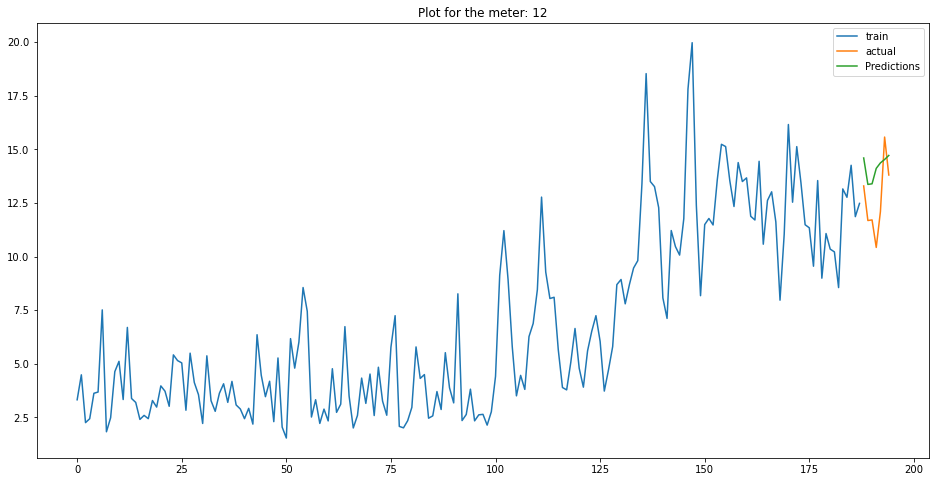

            ds       y
188 2021-07-08  13.292
189 2021-07-09  11.680
190 2021-07-10  11.707
191 2021-07-11  10.425
192 2021-07-12  12.097
193 2021-07-13  15.571
194 2021-07-14  13.801
            ds  Predictions
188 2021-07-08    14.595308
189 2021-07-09    13.363109
190 2021-07-10    13.391300
191 2021-07-11    14.110055
192 2021-07-12    14.366793
193 2021-07-13    14.525699
194 2021-07-14    14.713177
11.846094011916511


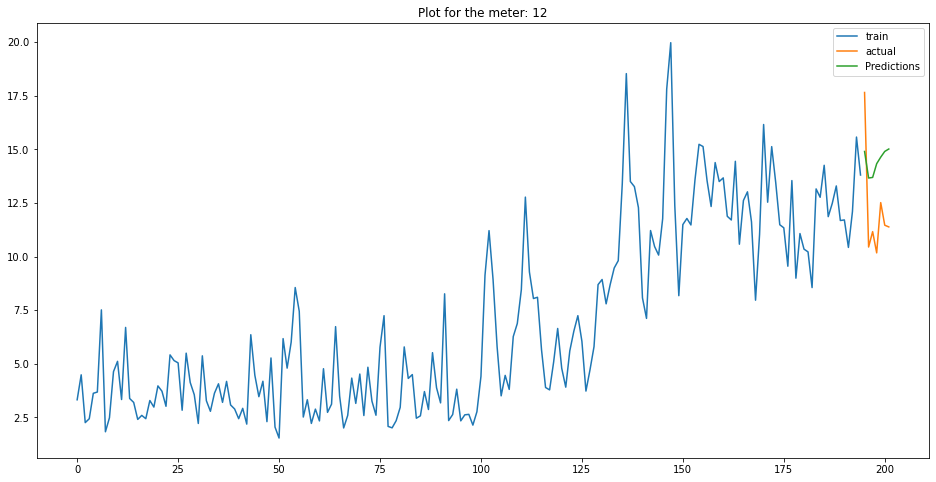

            ds       y
195 2021-07-15  17.649
196 2021-07-16  10.444
197 2021-07-17  11.161
198 2021-07-18  10.171
199 2021-07-19  12.515
200 2021-07-20  11.461
201 2021-07-21  11.381
            ds  Predictions
195 2021-07-15    14.899150
196 2021-07-16    13.661371
197 2021-07-17    13.689115
198 2021-07-18    14.328512
199 2021-07-19    14.634278
200 2021-07-20    14.901004
201 2021-07-21    15.014041
19.27941147770513


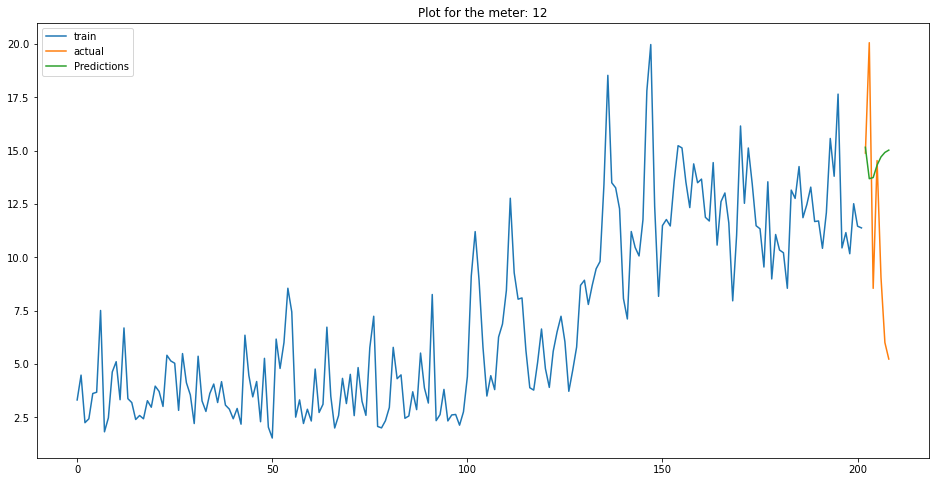

            ds       y
202 2021-07-22  14.887
203 2021-07-23  20.058
204 2021-07-24   8.550
205 2021-07-25  14.535
206 2021-07-26   9.069
207 2021-07-27   6.010
208 2021-07-28   5.238
            ds  Predictions
202 2021-07-22    15.158251
203 2021-07-23    13.687059
204 2021-07-24    13.739973
205 2021-07-25    14.321380
206 2021-07-26    14.706322
207 2021-07-27    14.917355
208 2021-07-28    15.024838
29.622295797551768


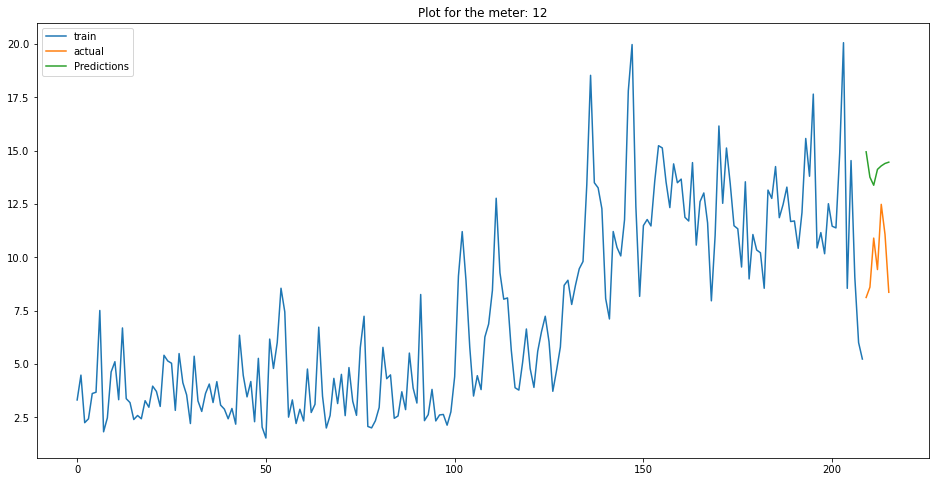

            ds       y
209 2021-07-29   8.122
210 2021-07-30   8.606
211 2021-07-31  10.904
212 2021-08-01   9.430
213 2021-08-02  12.485
214 2021-08-03  11.073
215 2021-08-04   8.365
            ds  Predictions
209 2021-07-29    14.946213
210 2021-07-30    13.757776
211 2021-07-31    13.380078
212 2021-08-01    14.122921
213 2021-08-02    14.286397
214 2021-08-03    14.400987
215 2021-08-04    14.460887
44.02443844172218
   mape_weekly  meterID    type
0       11.846       12  unflag
1       19.279       12  unflag
2       29.622       12  unflag
3       44.024       12  unflag


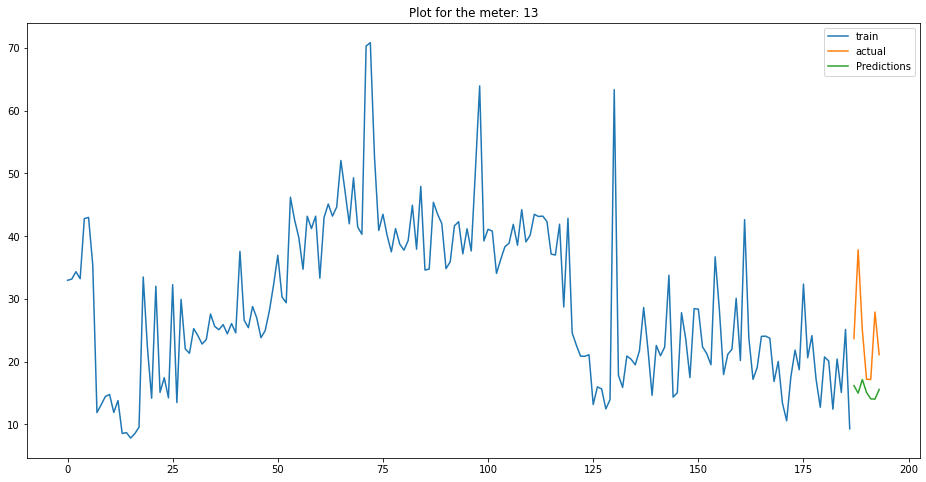

            ds       y
187 2021-07-07  23.689
188 2021-07-08  37.843
189 2021-07-09  25.026
190 2021-07-10  17.194
191 2021-07-11  17.164
192 2021-07-12  27.919
193 2021-07-13  21.124
            ds  Predictions
187 2021-07-07    16.194698
188 2021-07-08    14.998604
189 2021-07-09    17.153116
190 2021-07-10    15.102438
191 2021-07-11    14.077978
192 2021-07-12    14.040699
193 2021-07-13    15.577041
36.95857550255781


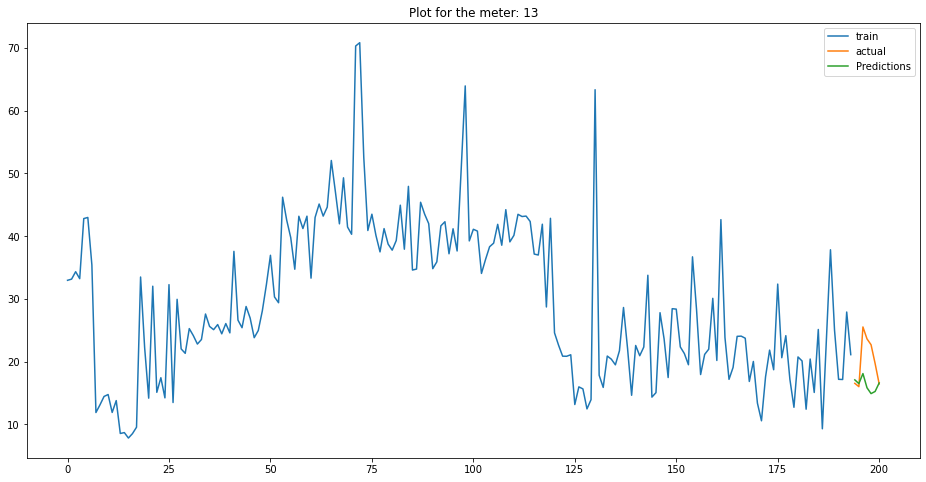

            ds       y
194 2021-07-14  16.553
195 2021-07-15  16.025
196 2021-07-16  25.540
197 2021-07-17  23.643
198 2021-07-18  22.706
199 2021-07-19  19.719
200 2021-07-20  16.463
            ds  Predictions
194 2021-07-14    17.106157
195 2021-07-15    16.508315
196 2021-07-16    18.109503
197 2021-07-17    15.846327
198 2021-07-18    14.916301
199 2021-07-19    15.257716
200 2021-07-20    16.608738
18.696146570651205


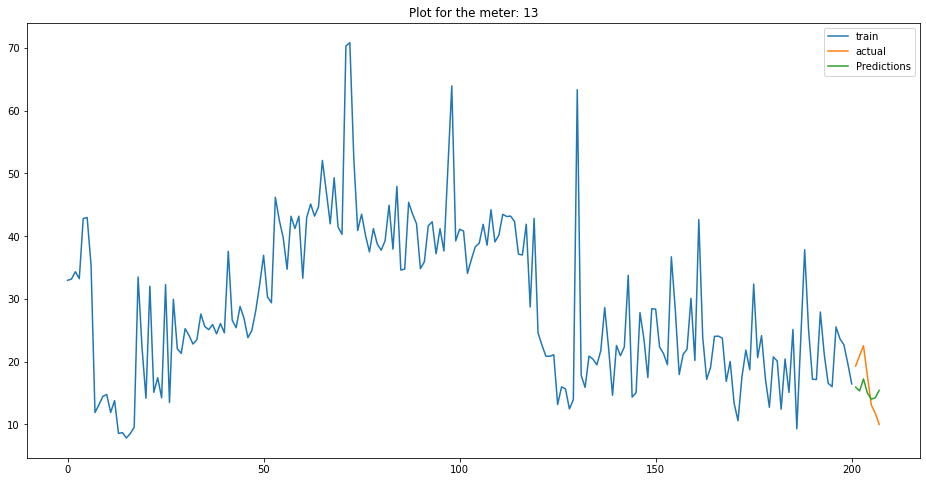

            ds       y
201 2021-07-21  19.299
202 2021-07-22  20.951
203 2021-07-23  22.549
204 2021-07-24  17.714
205 2021-07-25  13.102
206 2021-07-26  11.801
207 2021-07-27  10.003
            ds  Predictions
201 2021-07-21    15.945204
202 2021-07-22    15.344116
203 2021-07-23    17.246862
204 2021-07-24    15.005252
205 2021-07-25    14.034087
206 2021-07-26    14.251413
207 2021-07-27    15.432850
7.069214658200668


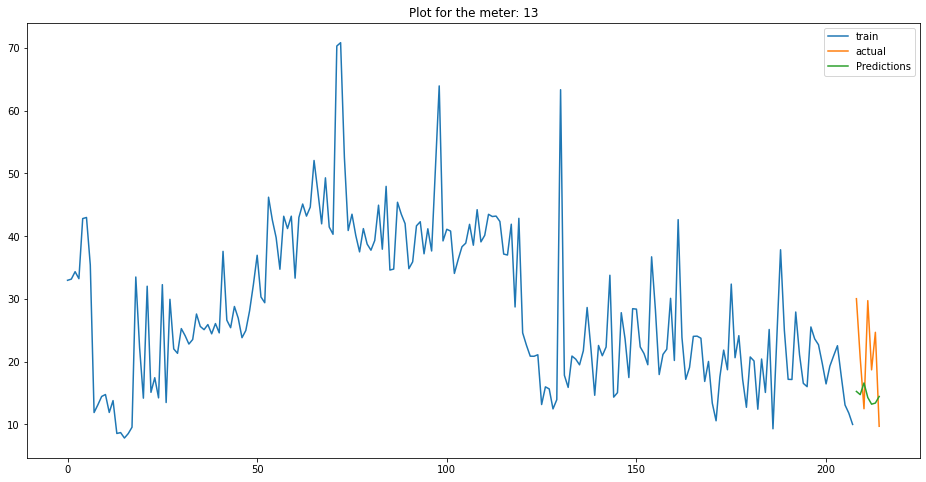

            ds       y
208 2021-07-28  30.045
209 2021-07-29  20.616
210 2021-07-30  12.503
211 2021-07-31  29.734
212 2021-08-01  18.705
213 2021-08-02  24.686
214 2021-08-03   9.708
            ds  Predictions
208 2021-07-28    15.263630
209 2021-07-29    14.752708
210 2021-07-30    16.610641
211 2021-07-31    14.295179
212 2021-08-01    13.229312
213 2021-08-02    13.410218
214 2021-08-03    14.461656
30.11956105171145
   mape_weekly  meterID    type
0       36.959       13  unflag
1       18.696       13  unflag
2        7.069       13  unflag
3       30.120       13  unflag


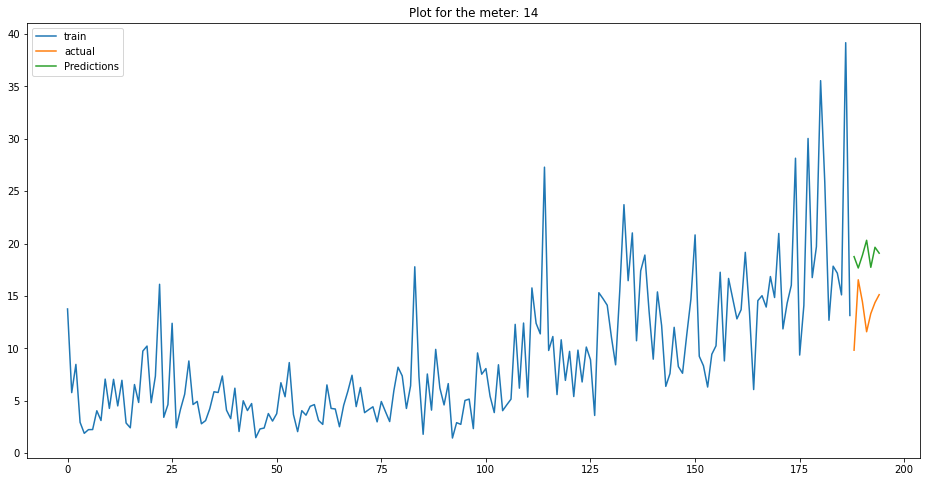

            ds       y
188 2021-07-08   9.813
189 2021-07-09  16.536
190 2021-07-10  14.430
191 2021-07-11  11.575
192 2021-07-12  13.313
193 2021-07-13  14.360
194 2021-07-14  15.114
            ds  Predictions
188 2021-07-08    18.748300
189 2021-07-09    17.662352
190 2021-07-10    18.878885
191 2021-07-11    20.308892
192 2021-07-12    17.728283
193 2021-07-13    19.642032
194 2021-07-14    19.076283
38.78877545077694


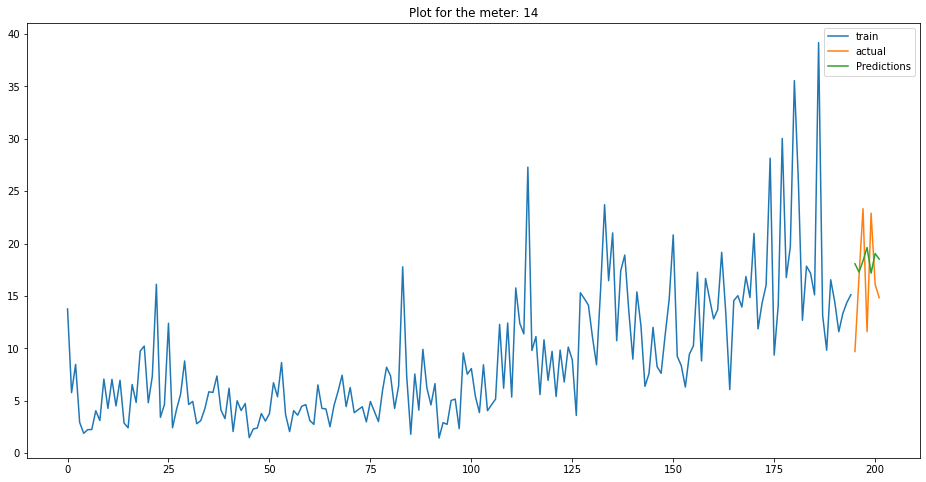

            ds       y
195 2021-07-15   9.690
196 2021-07-16  16.757
197 2021-07-17  23.322
198 2021-07-18  11.589
199 2021-07-19  22.900
200 2021-07-20  16.093
201 2021-07-21  14.833
            ds  Predictions
195 2021-07-15    18.064309
196 2021-07-16    17.277328
197 2021-07-17    18.342433
198 2021-07-18    19.622371
199 2021-07-19    17.174927
200 2021-07-20    19.045832
201 2021-07-21    18.509026
11.157995522915556


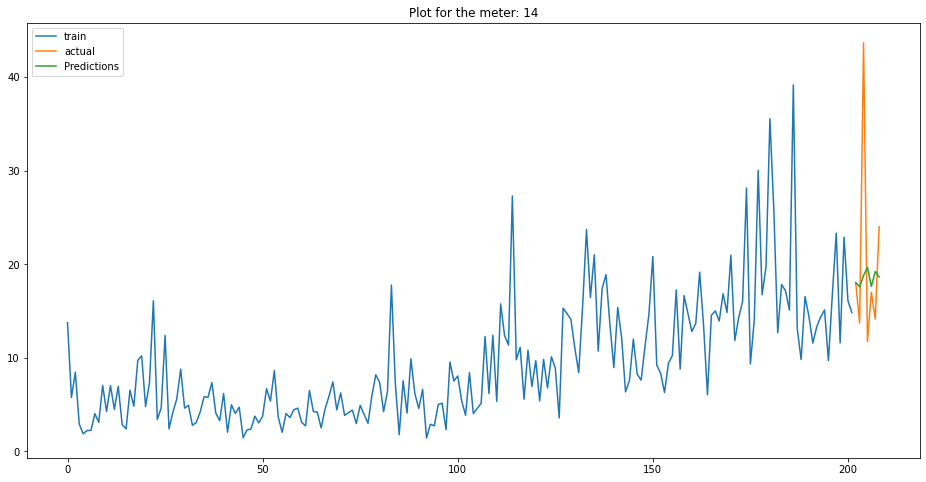

            ds       y
202 2021-07-22  18.000
203 2021-07-23  13.724
204 2021-07-24  43.682
205 2021-07-25  11.753
206 2021-07-26  17.011
207 2021-07-27  14.141
208 2021-07-28  23.999
            ds  Predictions
202 2021-07-22    18.048643
203 2021-07-23    17.588244
204 2021-07-24    18.793529
205 2021-07-25    19.675252
206 2021-07-26    17.637550
207 2021-07-27    19.229957
208 2021-07-28    18.635634
8.925016126354224


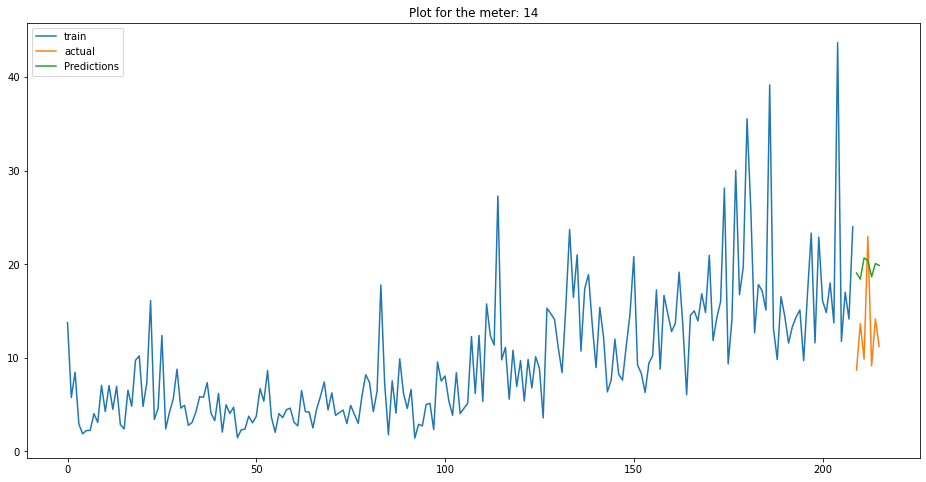

            ds       y
209 2021-07-29   8.701
210 2021-07-30  13.638
211 2021-07-31   9.861
212 2021-08-01  22.979
213 2021-08-02   9.134
214 2021-08-03  14.166
215 2021-08-04  11.234
            ds  Predictions
209 2021-07-29    19.067943
210 2021-07-30    18.410094
211 2021-07-31    20.673297
212 2021-08-01    20.413595
213 2021-08-02    18.658890
214 2021-08-03    20.078716
215 2021-08-04    19.870374
52.90193131303842
   mape_weekly  meterID    type
0       38.789       14  unflag
1       11.158       14  unflag
2        8.925       14  unflag
3       52.902       14    flag


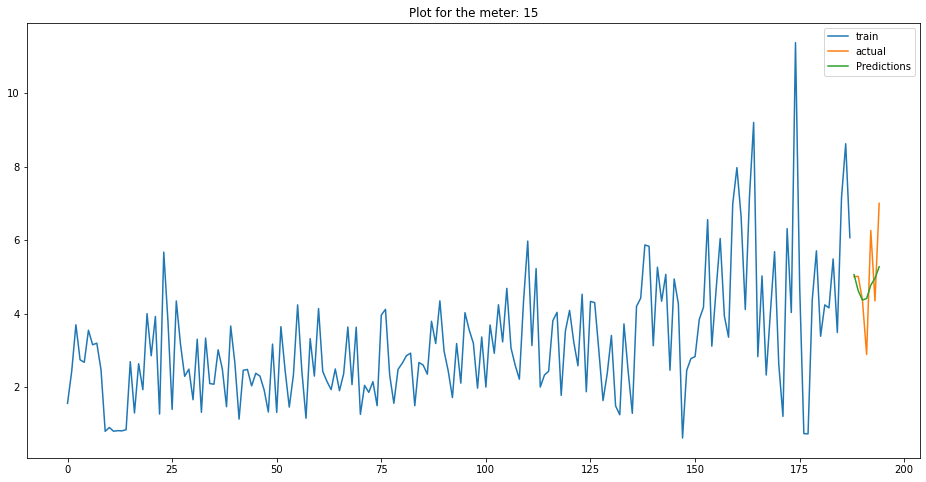

            ds      y
188 2021-07-08  5.006
189 2021-07-09  5.013
190 2021-07-10  4.370
191 2021-07-11  2.890
192 2021-07-12  6.261
193 2021-07-13  4.344
194 2021-07-14  6.999
            ds  Predictions
188 2021-07-08     5.061797
189 2021-07-09     4.619421
190 2021-07-10     4.369565
191 2021-07-11     4.411049
192 2021-07-12     4.774461
193 2021-07-13     4.961154
194 2021-07-14     5.272749
4.050117630746562


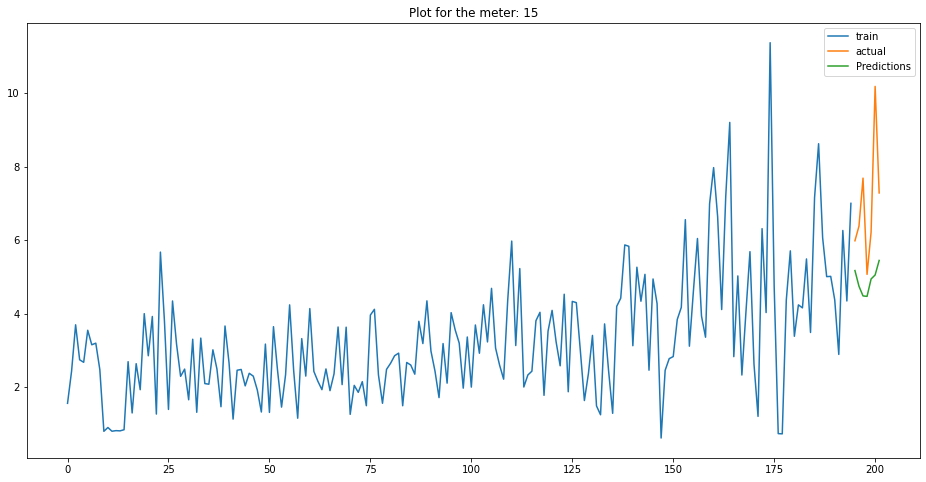

            ds       y
195 2021-07-15   5.981
196 2021-07-16   6.380
197 2021-07-17   7.685
198 2021-07-18   5.068
199 2021-07-19   6.215
200 2021-07-20  10.180
201 2021-07-21   7.282
            ds  Predictions
195 2021-07-15     5.171297
196 2021-07-16     4.743995
197 2021-07-17     4.481540
198 2021-07-18     4.469162
199 2021-07-19     4.942121
200 2021-07-20     5.050905
201 2021-07-21     5.446077
29.68970392727902


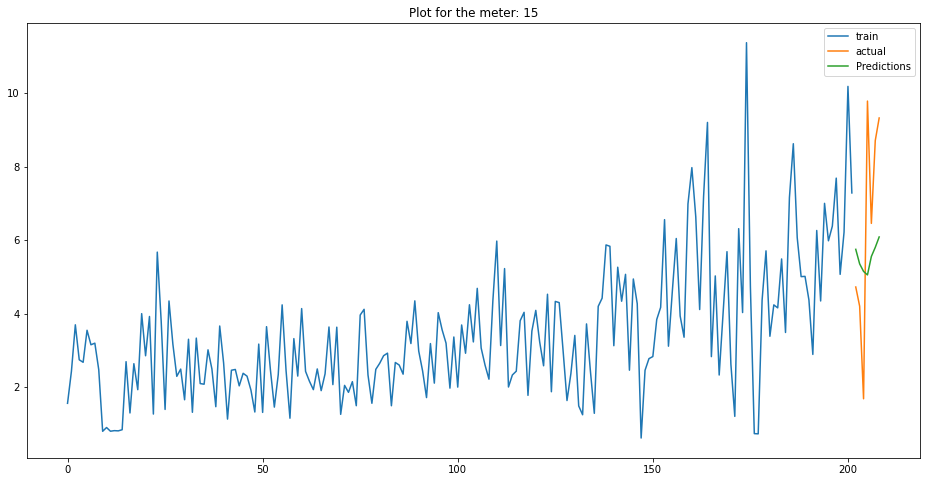

            ds      y
202 2021-07-22  4.724
203 2021-07-23  4.201
204 2021-07-24  1.684
205 2021-07-25  9.781
206 2021-07-26  6.454
207 2021-07-27  8.706
208 2021-07-28  9.321
            ds  Predictions
202 2021-07-22     5.748309
203 2021-07-23     5.352290
204 2021-07-24     5.148143
205 2021-07-25     5.052251
206 2021-07-26     5.554512
207 2021-07-27     5.801754
208 2021-07-28     6.084838
13.658940492852517


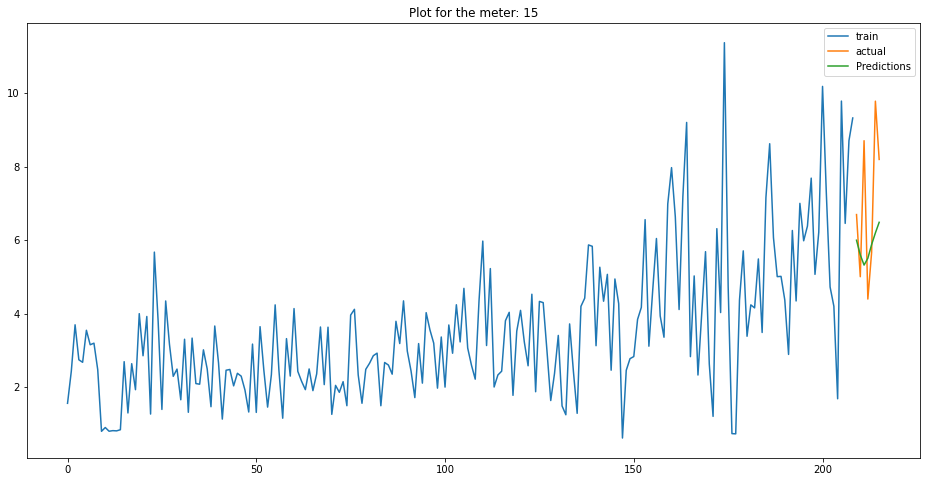

            ds      y
209 2021-07-29  6.694
210 2021-07-30  5.004
211 2021-07-31  8.703
212 2021-08-01  4.396
213 2021-08-02  5.663
214 2021-08-03  9.778
215 2021-08-04  8.194
            ds  Predictions
209 2021-07-29     5.996021
210 2021-07-30     5.597515
211 2021-07-31     5.320196
212 2021-08-01     5.505685
213 2021-08-02     5.878612
214 2021-08-03     6.194967
215 2021-08-04     6.483498
15.393762104462375
   mape_weekly  meterID    type
0        4.050       15  unflag
1       29.690       15  unflag
2       13.659       15  unflag
3       15.394       15  unflag


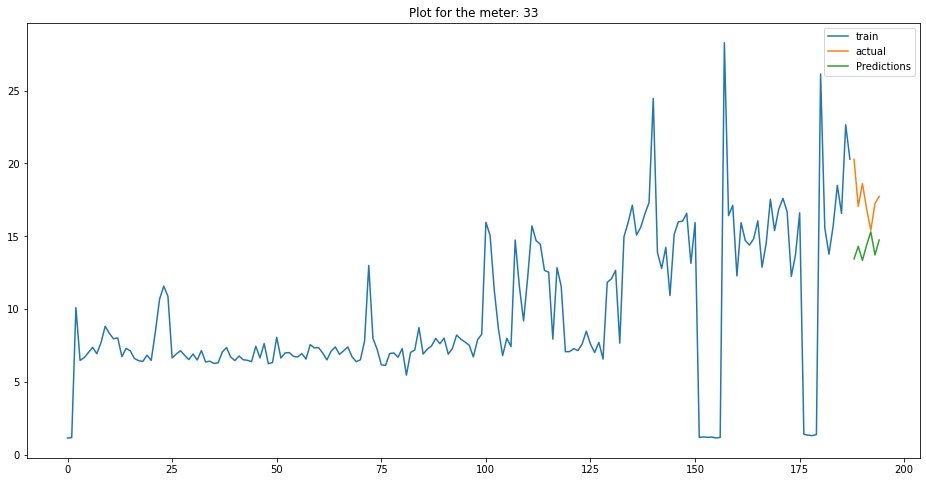

            ds       y
188 2021-07-08  20.283
189 2021-07-09  17.048
190 2021-07-10  18.618
191 2021-07-11  16.888
192 2021-07-12  15.407
193 2021-07-13  17.250
194 2021-07-14  17.743
            ds  Predictions
188 2021-07-08    13.442236
189 2021-07-09    14.303887
190 2021-07-10    13.344307
191 2021-07-11    14.390730
192 2021-07-12    15.304651
193 2021-07-13    13.713089
194 2021-07-14    14.742449
19.4711424990246


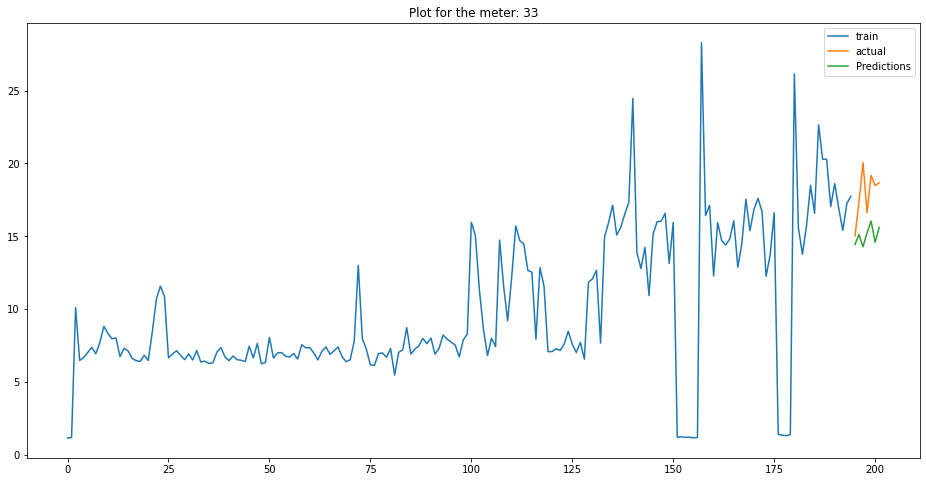

            ds       y
195 2021-07-15  15.018
196 2021-07-16  17.341
197 2021-07-17  20.065
198 2021-07-18  16.630
199 2021-07-19  19.176
200 2021-07-20  18.484
201 2021-07-21  18.665
            ds  Predictions
195 2021-07-15    14.428067
196 2021-07-16    15.107747
197 2021-07-17    14.274309
198 2021-07-18    15.235084
199 2021-07-19    16.038615
200 2021-07-20    14.590307
201 2021-07-21    15.600729
16.034697212193233


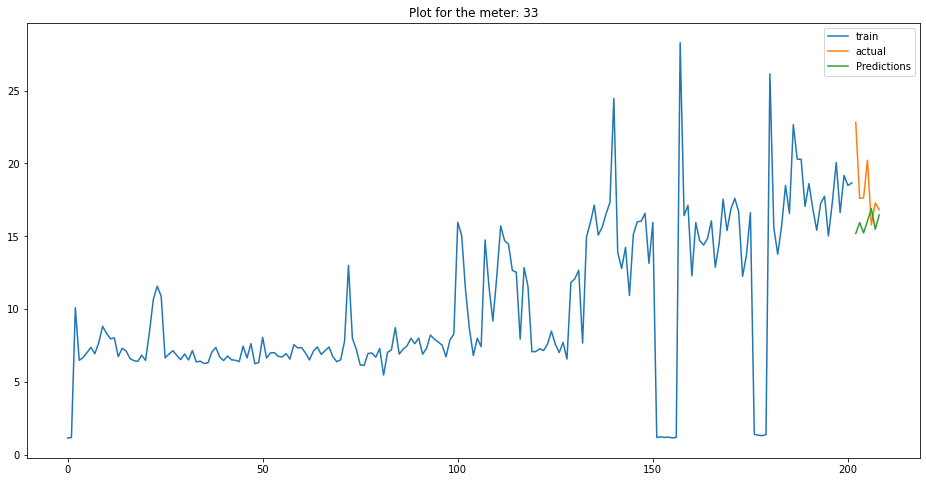

            ds       y
202 2021-07-22  22.836
203 2021-07-23  17.600
204 2021-07-24  17.633
205 2021-07-25  20.225
206 2021-07-26  15.783
207 2021-07-27  17.296
208 2021-07-28  16.820
            ds  Predictions
202 2021-07-22    15.189881
203 2021-07-23    15.936035
204 2021-07-24    15.228053
205 2021-07-25    16.038776
206 2021-07-26    16.902721
207 2021-07-27    15.478792
208 2021-07-28    16.462094
13.227436676890262


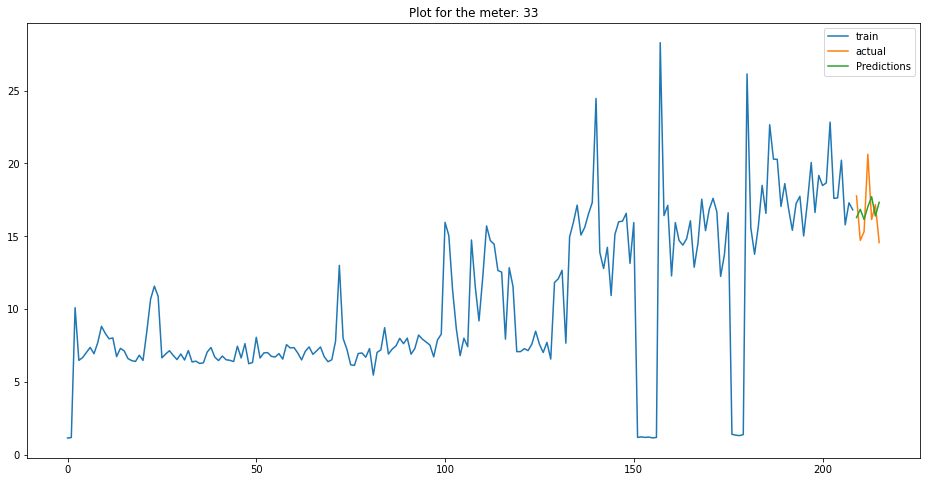

            ds       y
209 2021-07-29  17.768
210 2021-07-30  14.715
211 2021-07-31  15.315
212 2021-08-01  20.628
213 2021-08-02  16.147
214 2021-08-03  17.167
215 2021-08-04  14.565
            ds  Predictions
209 2021-07-29    16.287457
210 2021-07-30    16.847778
211 2021-07-31    16.150630
212 2021-08-01    17.022474
213 2021-08-02    17.717789
214 2021-08-03    16.389878
215 2021-08-04    17.330032
1.2390159186913965
   mape_weekly  meterID    type
0       19.471       33  unflag
1       16.035       33  unflag
2       13.227       33  unflag
3        1.239       33  unflag


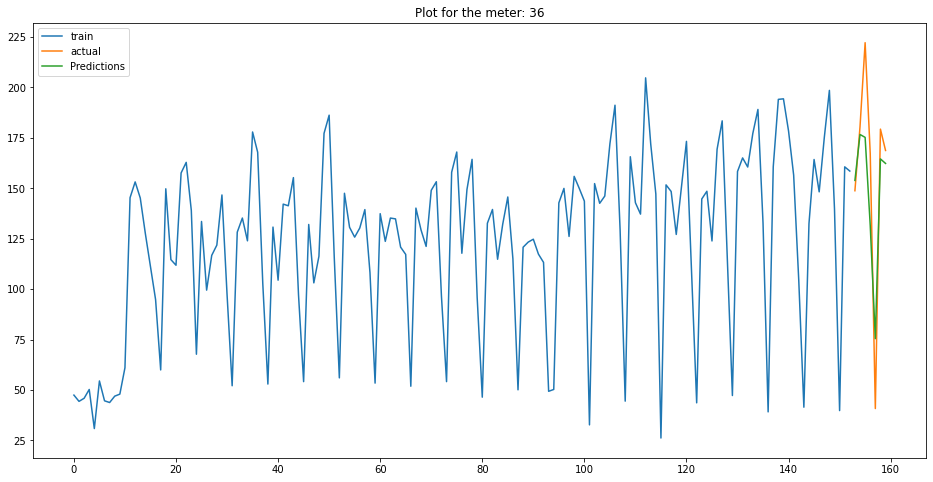

            ds        y
153 2021-06-03  148.772
154 2021-06-04  180.552
155 2021-06-05  222.170
156 2021-06-06  167.226
157 2021-06-07   40.776
158 2021-06-08  179.314
159 2021-06-09  168.730
            ds  Predictions
153 2021-06-03   153.884301
154 2021-06-04   176.651617
155 2021-06-05   175.228026
156 2021-06-06   131.550427
157 2021-06-07    75.428858
158 2021-06-08   164.540781
159 2021-06-09   162.301437
6.135629685666012


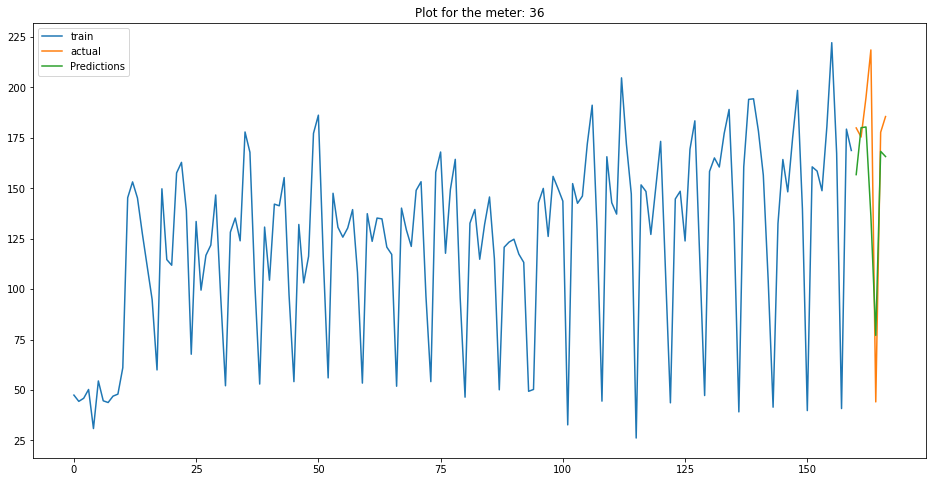

            ds        y
160 2021-06-10  179.906
161 2021-06-11  175.400
162 2021-06-12  194.940
163 2021-06-13  218.576
164 2021-06-14   44.072
165 2021-06-15  177.740
166 2021-06-16  185.544
            ds  Predictions
160 2021-06-10   156.755567
161 2021-06-11   180.025014
162 2021-06-12   180.379036
163 2021-06-13   136.336685
164 2021-06-14    77.066106
165 2021-06-15   168.310779
166 2021-06-16   165.720106
9.48705946816116


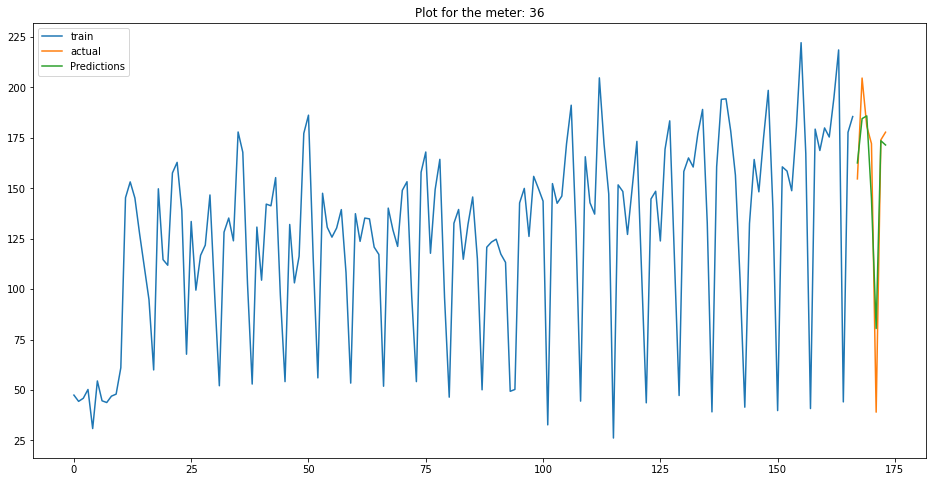

            ds        y
167 2021-06-17  154.642
168 2021-06-18  204.636
169 2021-06-19  180.734
170 2021-06-20  172.124
171 2021-06-21   38.986
172 2021-06-22  173.974
173 2021-06-23  177.794
            ds  Predictions
167 2021-06-17   162.548244
168 2021-06-18   184.524826
169 2021-06-19   185.877291
170 2021-06-20   144.846635
171 2021-06-21    80.476391
172 2021-06-22   173.558760
173 2021-06-23   171.447292
0.03531073488484371


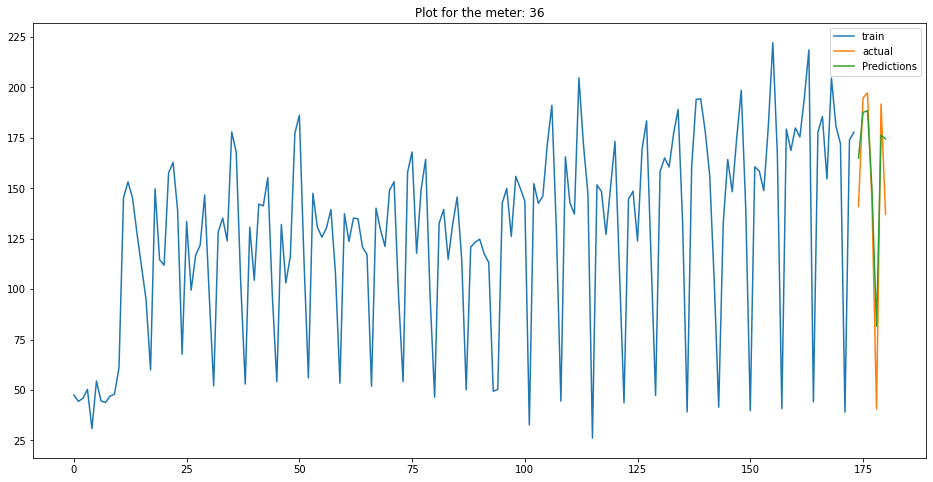

            ds        y
174 2021-06-24  140.902
175 2021-06-25  194.762
176 2021-06-26  197.236
177 2021-06-27  142.422
178 2021-06-28   40.538
179 2021-06-29  191.780
180 2021-06-30  137.056
            ds  Predictions
174 2021-06-24   164.988998
175 2021-06-25   187.606154
176 2021-06-26   188.418465
177 2021-06-27   148.877677
178 2021-06-28    81.555116
179 2021-06-29   176.415697
180 2021-06-30   174.480677
7.432476337931281
   mape_weekly  meterID    type
0        6.136       36  unflag
1        9.487       36  unflag
2        0.035       36  unflag
3        7.432       36  unflag


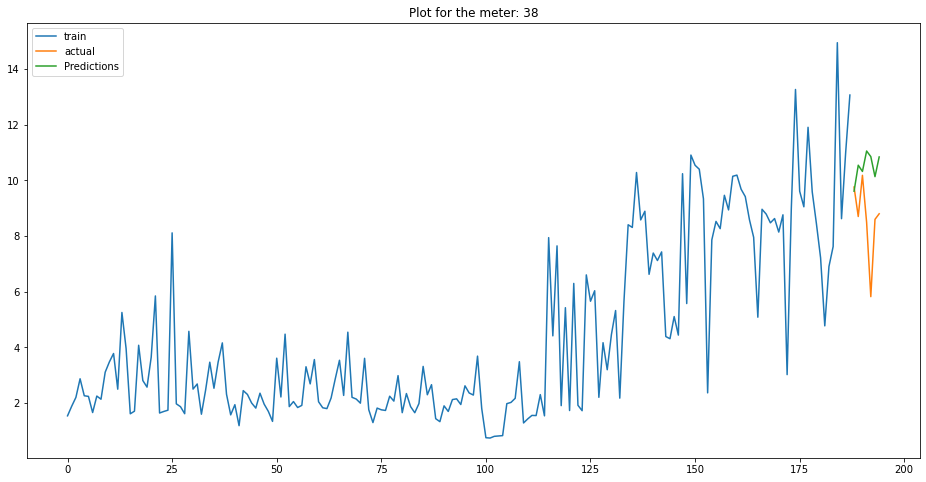

            ds       y
188 2021-07-08   9.761
189 2021-07-09   8.701
190 2021-07-10  10.181
191 2021-07-11   8.492
192 2021-07-12   5.822
193 2021-07-13   8.598
194 2021-07-14   8.799
            ds  Predictions
188 2021-07-08     9.610198
189 2021-07-09    10.543912
190 2021-07-10    10.320065
191 2021-07-11    11.054150
192 2021-07-12    10.852887
193 2021-07-13    10.132825
194 2021-07-14    10.840131
21.53986222343712


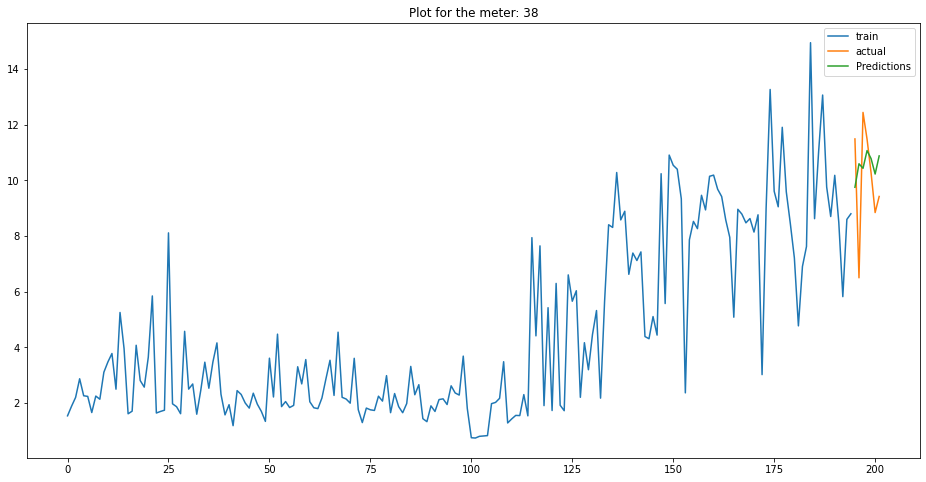

            ds       y
195 2021-07-15  11.488
196 2021-07-16   6.499
197 2021-07-17  12.441
198 2021-07-18  11.480
199 2021-07-19  10.265
200 2021-07-20   8.843
201 2021-07-21   9.421
            ds  Predictions
195 2021-07-15     9.751172
196 2021-07-16    10.595056
197 2021-07-17    10.433244
198 2021-07-18    11.068964
199 2021-07-19    10.779884
200 2021-07-20    10.226405
201 2021-07-21    10.877500
4.678259522662181


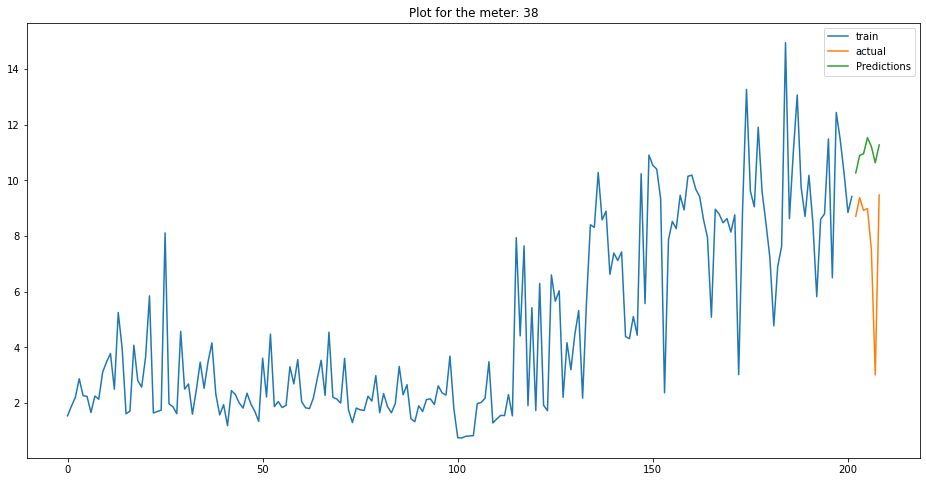

            ds      y
202 2021-07-22  8.711
203 2021-07-23  9.379
204 2021-07-24  8.924
205 2021-07-25  8.987
206 2021-07-26  7.514
207 2021-07-27  3.010
208 2021-07-28  9.473
            ds  Predictions
202 2021-07-22    10.267683
203 2021-07-23    10.895283
204 2021-07-24    10.956845
205 2021-07-25    11.532881
206 2021-07-26    11.215658
207 2021-07-27    10.633814
208 2021-07-28    11.272764
37.10298072280835


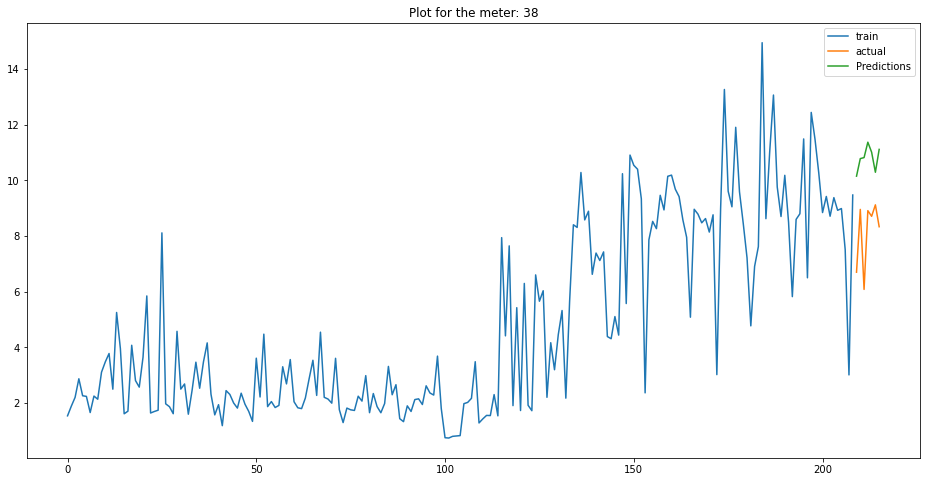

            ds      y
209 2021-07-29  6.699
210 2021-07-30  8.956
211 2021-07-31  6.082
212 2021-08-01  8.911
213 2021-08-02  8.709
214 2021-08-03  9.120
215 2021-08-04  8.334
            ds  Predictions
209 2021-07-29    10.150684
210 2021-07-30    10.781068
211 2021-07-31    10.818122
212 2021-08-01    11.370647
213 2021-08-02    11.012055
214 2021-08-03    10.290648
215 2021-08-04    11.112246
32.95923441645647
   mape_weekly  meterID    type
0       21.540       38  unflag
1        4.678       38  unflag
2       37.103       38  unflag
3       32.959       38  unflag


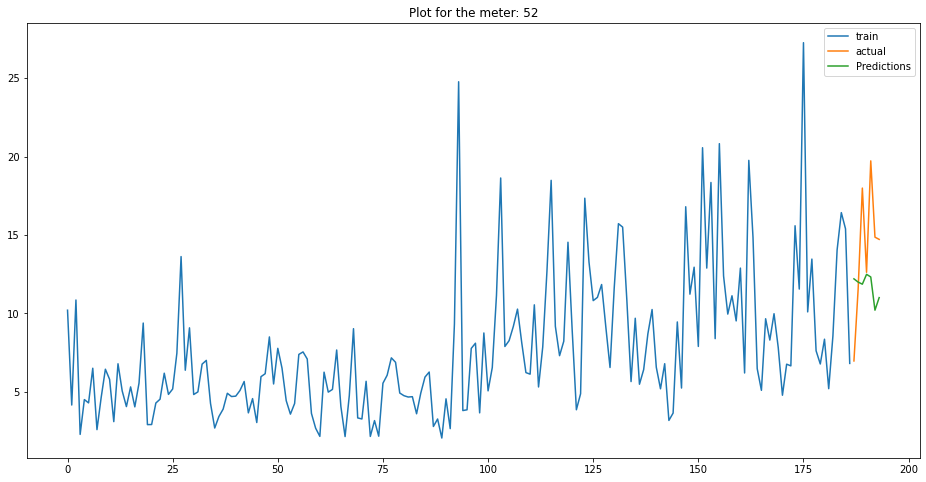

            ds       y
187 2021-07-07   6.955
188 2021-07-08  11.538
189 2021-07-09  17.986
190 2021-07-10  12.612
191 2021-07-11  19.722
192 2021-07-12  14.854
193 2021-07-13  14.712
            ds  Predictions
187 2021-07-07    12.193604
188 2021-07-08    11.986381
189 2021-07-09    11.853599
190 2021-07-10    12.481729
191 2021-07-11    12.314401
192 2021-07-12    10.194953
193 2021-07-13    10.996559
16.62730291125242


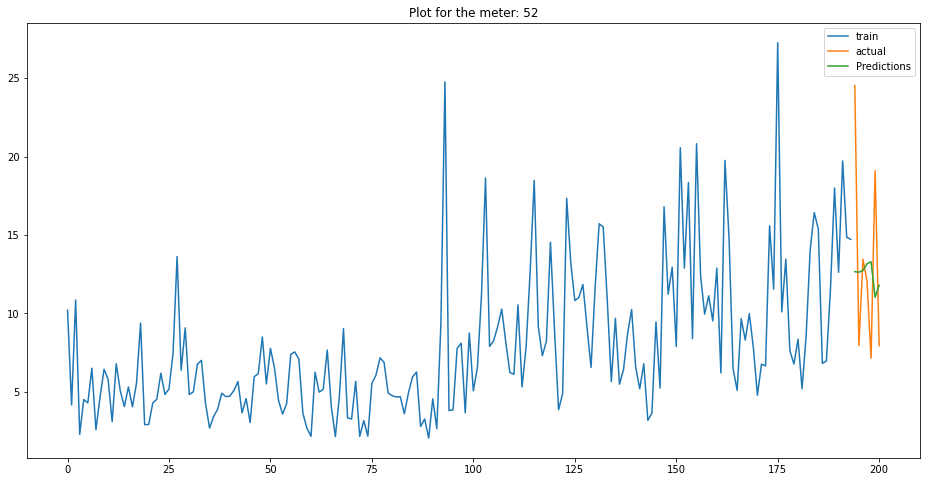

            ds       y
194 2021-07-14  24.533
195 2021-07-15   7.945
196 2021-07-16  13.442
197 2021-07-17  12.064
198 2021-07-18   7.136
199 2021-07-19  19.098
200 2021-07-20   7.929
            ds  Predictions
194 2021-07-14    12.650395
195 2021-07-15    12.618974
196 2021-07-16    12.725951
197 2021-07-17    13.153229
198 2021-07-18    13.285397
199 2021-07-19    11.016612
200 2021-07-20    11.788275
5.326453699074165


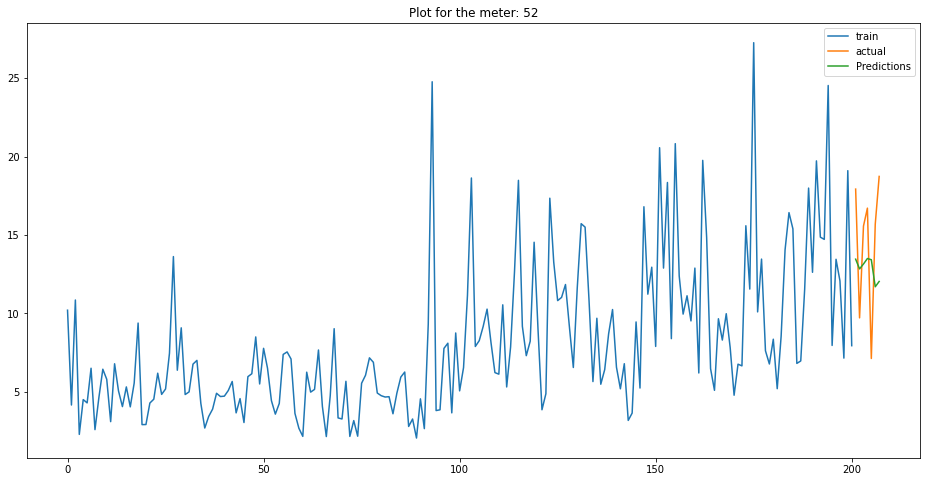

            ds       y
201 2021-07-21  17.921
202 2021-07-22   9.704
203 2021-07-23  15.562
204 2021-07-24  16.706
205 2021-07-25   7.112
206 2021-07-26  15.682
207 2021-07-27  18.730
            ds  Predictions
201 2021-07-21    13.449861
202 2021-07-22    12.828536
203 2021-07-23    13.141184
204 2021-07-24    13.491113
205 2021-07-25    13.414548
206 2021-07-26    11.687873
207 2021-07-27    12.028514
11.216433081962474


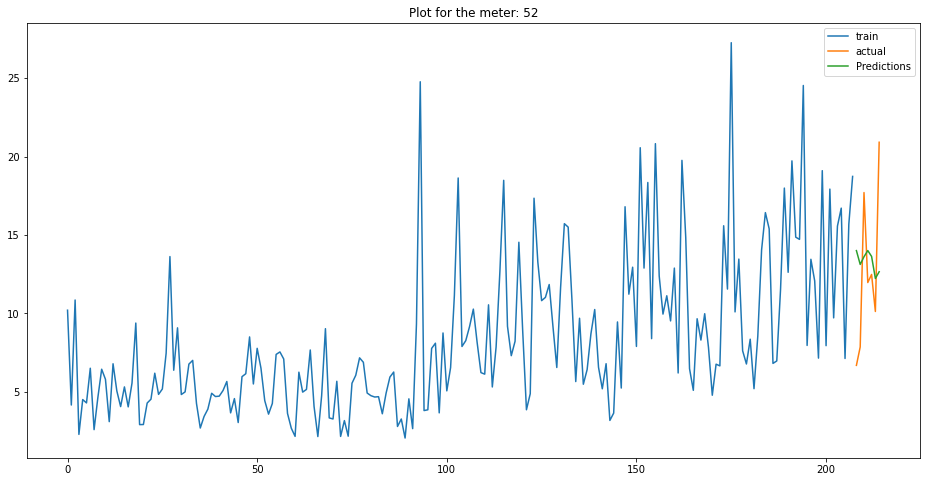

            ds       y
208 2021-07-28   6.674
209 2021-07-29   7.848
210 2021-07-30  17.700
211 2021-07-31  11.958
212 2021-08-01  12.475
213 2021-08-02  10.112
214 2021-08-03  20.910
            ds  Predictions
208 2021-07-28    13.996177
209 2021-07-29    13.113562
210 2021-07-30    13.605580
211 2021-07-31    13.998496
212 2021-08-01    13.625305
213 2021-08-02    12.217474
214 2021-08-03    12.647337
6.303742630980383
   mape_weekly  meterID    type
0       16.627       52  unflag
1        5.326       52  unflag
2       11.216       52  unflag
3        6.304       52  unflag


In [891]:
for i in TOU_list_above365:
    account_and_days_billcycle_new(i,'peak')

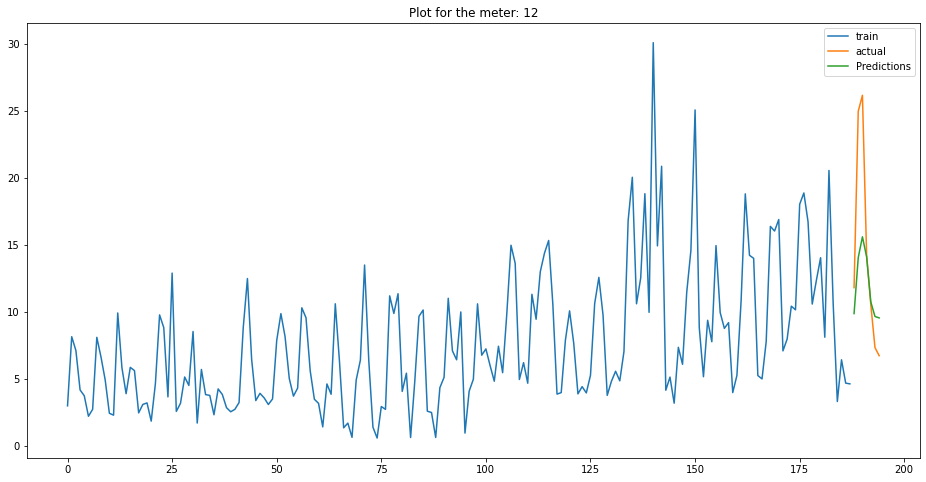

            ds       y
188 2021-07-08  11.799
189 2021-07-09  24.952
190 2021-07-10  26.139
191 2021-07-11  14.243
192 2021-07-12  10.544
193 2021-07-13   7.329
194 2021-07-14   6.725
            ds  Predictions
188 2021-07-08     9.864047
189 2021-07-09    14.039597
190 2021-07-10    15.589326
191 2021-07-11    14.094919
192 2021-07-12    10.736901
193 2021-07-13     9.648275
194 2021-07-14     9.544041
17.90397682691351


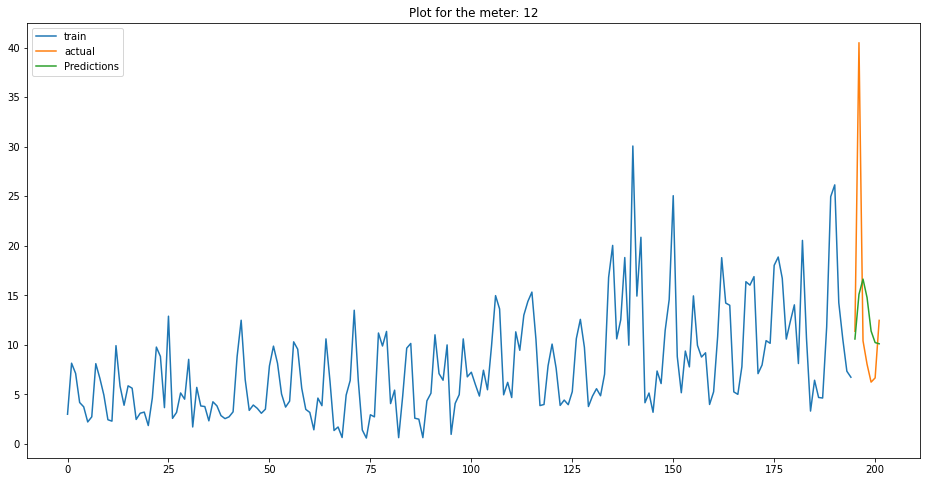

            ds       y
195 2021-07-15  11.367
196 2021-07-16  40.490
197 2021-07-17  10.397
198 2021-07-18   8.037
199 2021-07-19   6.230
200 2021-07-20   6.655
201 2021-07-21  12.462
            ds  Predictions
195 2021-07-15    10.581247
196 2021-07-16    15.097447
197 2021-07-17    16.625747
198 2021-07-18    14.763512
199 2021-07-19    11.387650
200 2021-07-20    10.221077
201 2021-07-21    10.101274
7.172929091706279


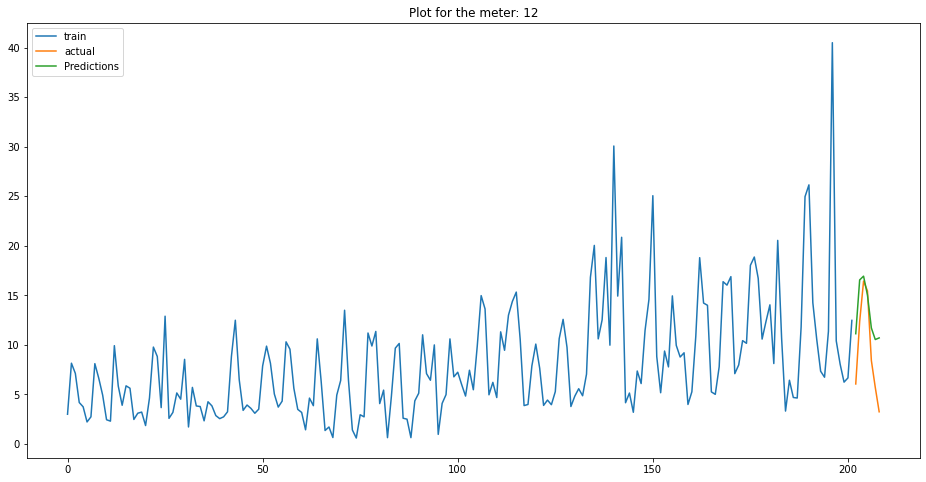

            ds       y
202 2021-07-22   6.044
203 2021-07-23  12.327
204 2021-07-24  16.425
205 2021-07-25  15.443
206 2021-07-26   8.408
207 2021-07-27   5.701
208 2021-07-28   3.236
            ds  Predictions
202 2021-07-22    11.115799
203 2021-07-23    16.545664
204 2021-07-24    16.926122
205 2021-07-25    15.019189
206 2021-07-26    11.697499
207 2021-07-27    10.528694
208 2021-07-28    10.693312
36.90559704194885


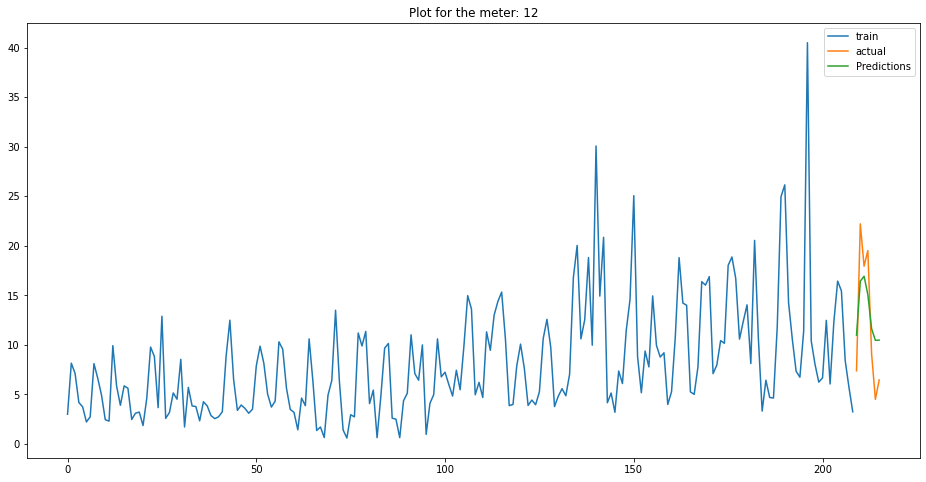

            ds       y
209 2021-07-29   7.376
210 2021-07-30  22.206
211 2021-07-31  17.932
212 2021-08-01  19.506
213 2021-08-02   9.062
214 2021-08-03   4.493
215 2021-08-04   6.445
            ds  Predictions
209 2021-07-29    10.969776
210 2021-07-30    16.419704
211 2021-07-31    16.918905
212 2021-08-01    15.059178
213 2021-08-02    11.615521
214 2021-08-03    10.447591
215 2021-08-04    10.467283
5.605557461977999
   mape_weekly  meterID    type
0       17.904       12  unflag
1        7.173       12  unflag
2       36.906       12  unflag
3        5.606       12  unflag


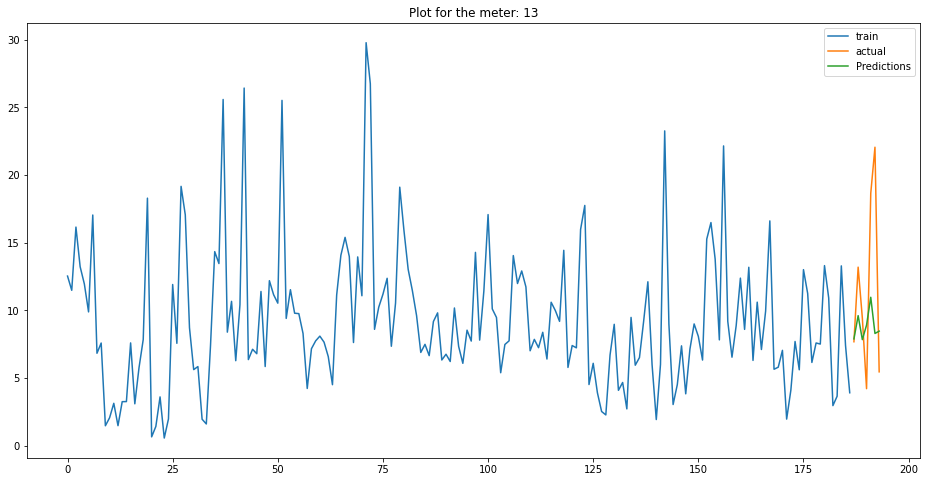

            ds       y
187 2021-07-07   7.680
188 2021-07-08  13.190
189 2021-07-09   9.431
190 2021-07-10   4.214
191 2021-07-11  18.647
192 2021-07-12  22.049
193 2021-07-13   5.458
            ds  Predictions
187 2021-07-07     7.890926
188 2021-07-08     9.608762
189 2021-07-09     7.837532
190 2021-07-10     8.907671
191 2021-07-11    10.964660
192 2021-07-12     8.291119
193 2021-07-13     8.464704
23.18564298687068


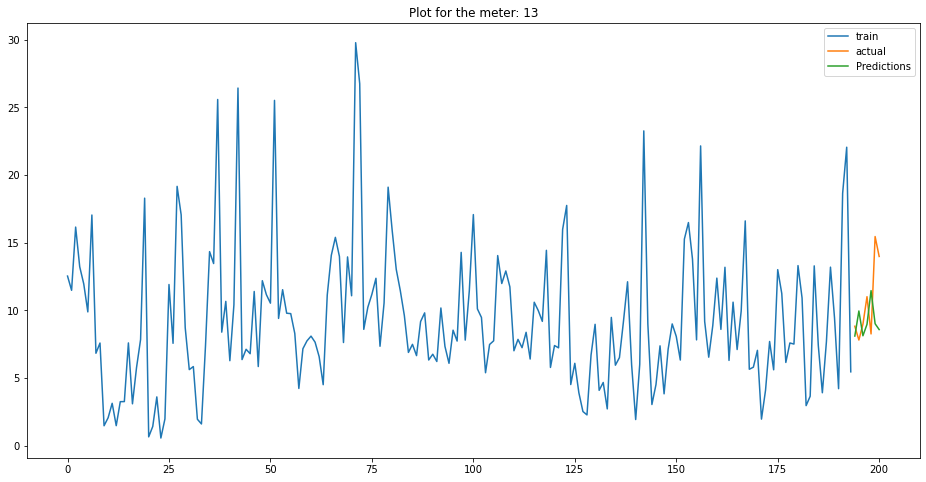

            ds       y
194 2021-07-14   8.825
195 2021-07-15   7.807
196 2021-07-16   8.978
197 2021-07-17  11.009
198 2021-07-18   8.258
199 2021-07-19  15.451
200 2021-07-20  13.980
            ds  Predictions
194 2021-07-14     8.101106
195 2021-07-15     9.952265
196 2021-07-16     8.121148
197 2021-07-17     8.965966
198 2021-07-18    11.456470
199 2021-07-19     9.011121
200 2021-07-20     8.579218
13.61994061828366


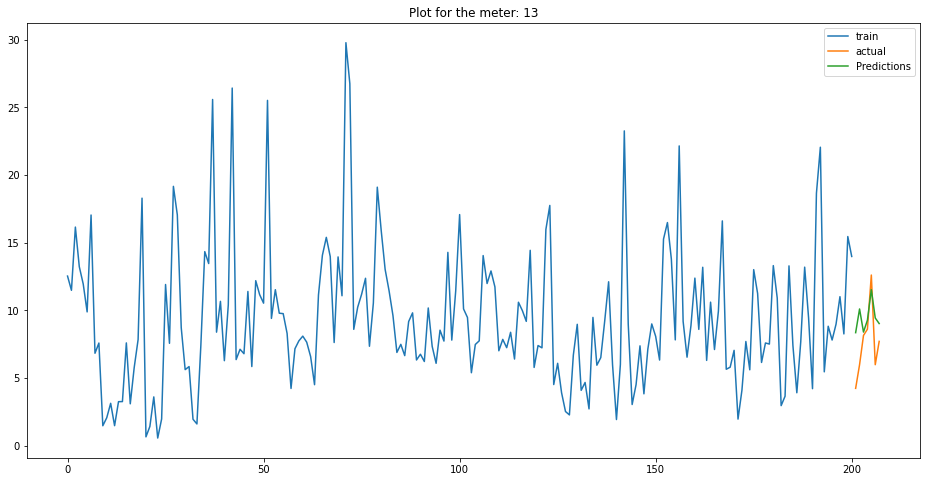

            ds       y
201 2021-07-21   4.237
202 2021-07-22   5.984
203 2021-07-23   8.144
204 2021-07-24   8.606
205 2021-07-25  12.608
206 2021-07-26   5.985
207 2021-07-27   7.708
            ds  Predictions
201 2021-07-21     8.350418
202 2021-07-22    10.101515
203 2021-07-23     8.394916
204 2021-07-24     9.269385
205 2021-07-25    11.528478
206 2021-07-26     9.435232
207 2021-07-27     9.024558
24.08864285393295


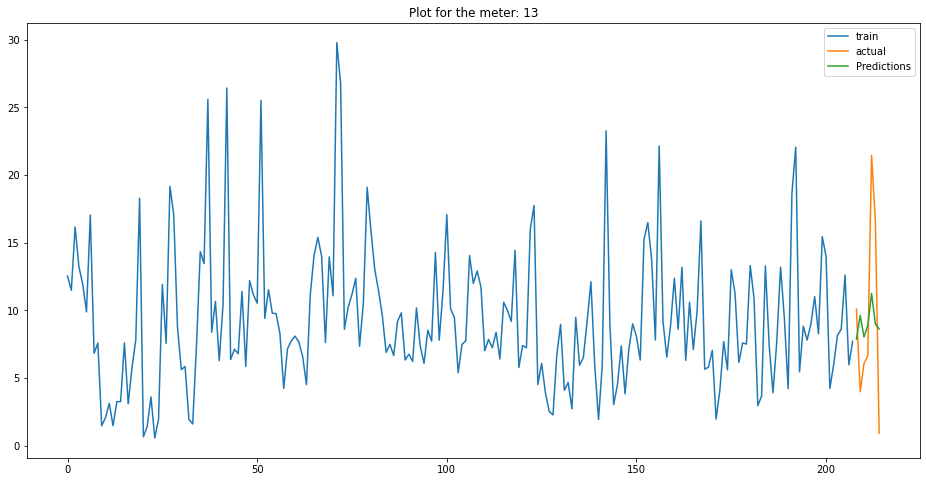

            ds       y
208 2021-07-28  10.092
209 2021-07-29   3.987
210 2021-07-30   6.068
211 2021-07-31   6.665
212 2021-08-01  21.447
213 2021-08-02  16.578
214 2021-08-03   0.925
            ds  Predictions
208 2021-07-28     7.869279
209 2021-07-29     9.626771
210 2021-07-30     8.031976
211 2021-07-31     8.899756
212 2021-08-01    11.251112
213 2021-08-02     8.989280
214 2021-08-03     8.621225
3.7599235227464085
   mape_weekly  meterID    type
0       23.186       13  unflag
1       13.620       13  unflag
2       24.089       13  unflag
3        3.760       13  unflag


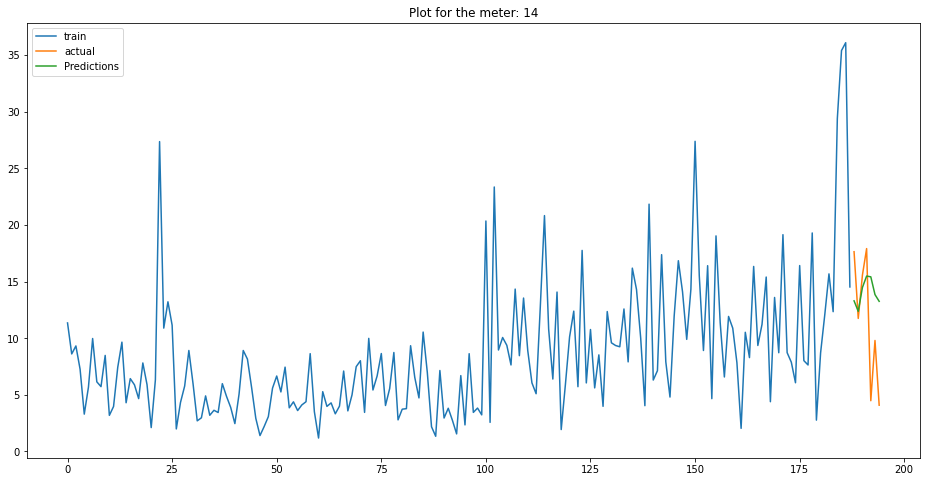

            ds       y
188 2021-07-08  17.644
189 2021-07-09  11.753
190 2021-07-10  15.582
191 2021-07-11  17.920
192 2021-07-12   4.484
193 2021-07-13   9.804
194 2021-07-14   4.088
            ds  Predictions
188 2021-07-08    13.304883
189 2021-07-09    12.379517
190 2021-07-10    14.487011
191 2021-07-11    15.492323
192 2021-07-12    15.425727
193 2021-07-13    13.856647
194 2021-07-14    13.261624
20.833873793617943


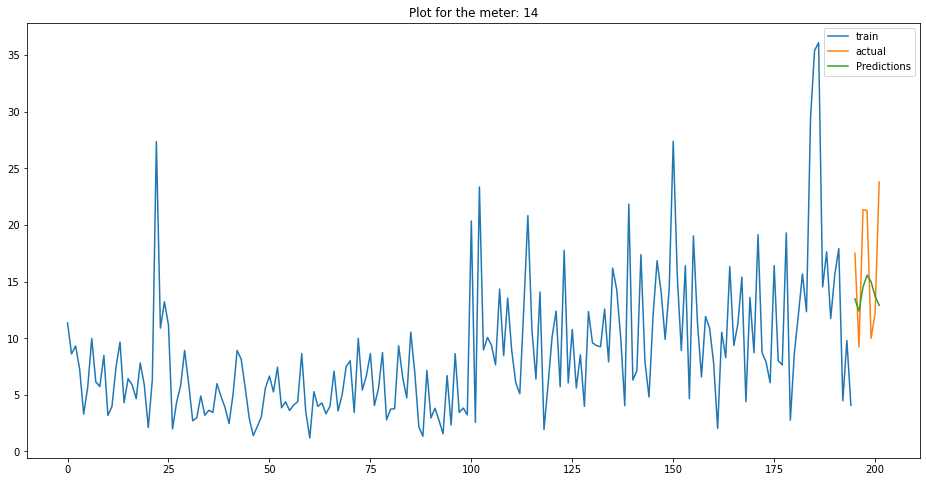

            ds       y
195 2021-07-15  17.515
196 2021-07-16   9.226
197 2021-07-17  21.355
198 2021-07-18  21.281
199 2021-07-19   9.995
200 2021-07-20  12.236
201 2021-07-21  23.806
            ds  Predictions
195 2021-07-15    13.468024
196 2021-07-16    12.400757
197 2021-07-17    14.514821
198 2021-07-18    15.570451
199 2021-07-19    14.992443
200 2021-07-20    13.704769
201 2021-07-21    12.906707
15.471284428966328


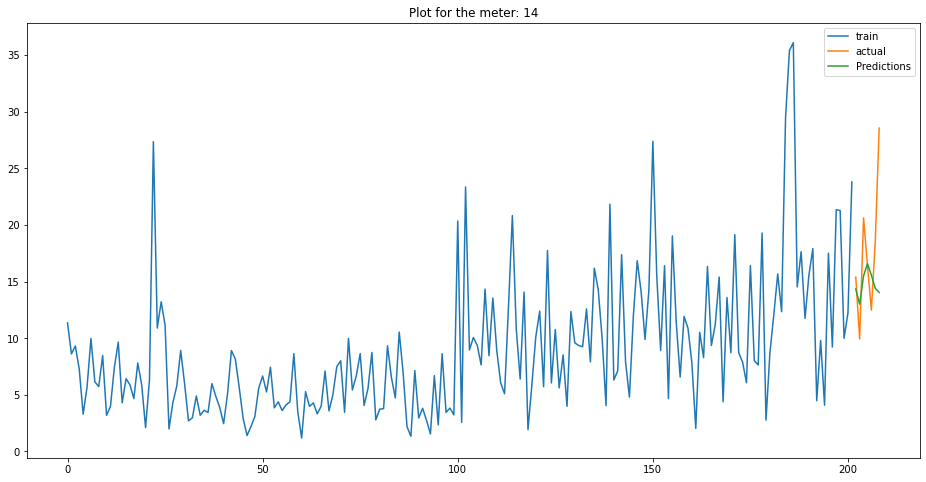

            ds       y
202 2021-07-22  15.399
203 2021-07-23   9.937
204 2021-07-24  20.631
205 2021-07-25  16.425
206 2021-07-26  12.487
207 2021-07-27  18.555
208 2021-07-28  28.560
            ds  Predictions
202 2021-07-22    14.348620
203 2021-07-23    13.016537
204 2021-07-24    15.504801
205 2021-07-25    16.587872
206 2021-07-26    15.578837
207 2021-07-27    14.412178
208 2021-07-28    14.044514
15.16520513170238


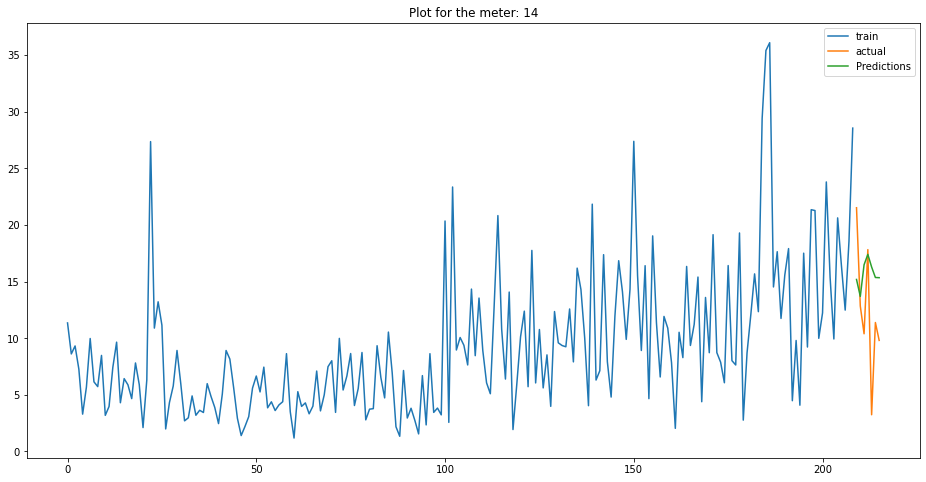

            ds       y
209 2021-07-29  21.528
210 2021-07-30  12.849
211 2021-07-31  10.396
212 2021-08-01  17.828
213 2021-08-02   3.245
214 2021-08-03  11.390
215 2021-08-04   9.811
            ds  Predictions
209 2021-07-29    15.193402
210 2021-07-30    13.696712
211 2021-07-31    16.490167
212 2021-08-01    17.408196
213 2021-08-02    16.293217
214 2021-08-03    15.367507
215 2021-08-04    15.349697
26.137487432261956
   mape_weekly  meterID    type
0       20.834       14  unflag
1       15.471       14  unflag
2       15.165       14  unflag
3       26.137       14  unflag


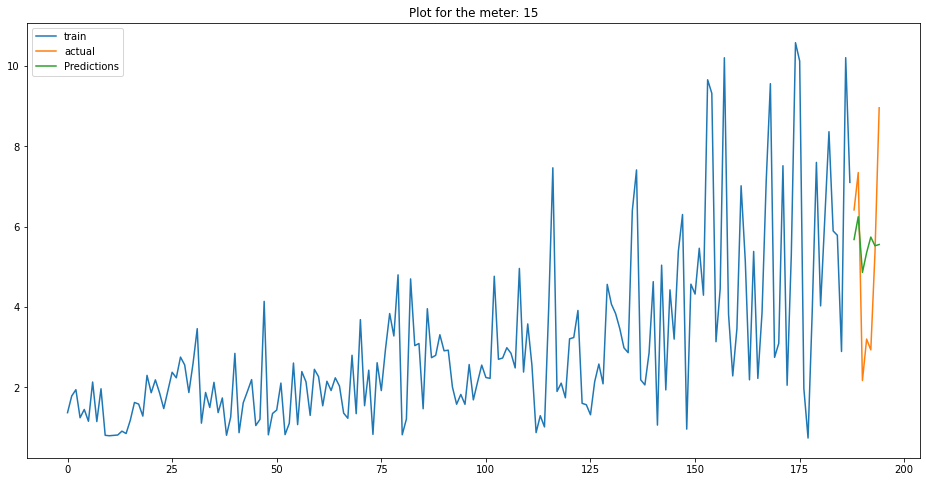

            ds      y
188 2021-07-08  6.415
189 2021-07-09  7.344
190 2021-07-10  2.170
191 2021-07-11  3.200
192 2021-07-12  2.932
193 2021-07-13  5.352
194 2021-07-14  8.957
            ds  Predictions
188 2021-07-08     5.679045
189 2021-07-09     6.246406
190 2021-07-10     4.858902
191 2021-07-11     5.350607
192 2021-07-12     5.739293
193 2021-07-13     5.523214
194 2021-07-14     5.554287
7.098584377051038


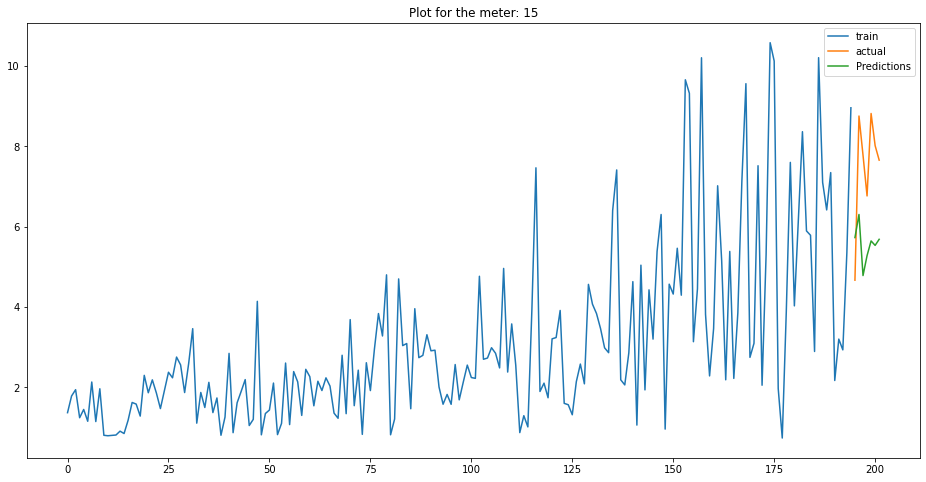

            ds      y
195 2021-07-15  4.666
196 2021-07-16  8.752
197 2021-07-17  7.777
198 2021-07-18  6.763
199 2021-07-19  8.815
200 2021-07-20  8.015
201 2021-07-21  7.654
            ds  Predictions
195 2021-07-15     5.726553
196 2021-07-16     6.301349
197 2021-07-17     4.781632
198 2021-07-18     5.277198
199 2021-07-19     5.643584
200 2021-07-20     5.532293
201 2021-07-21     5.683795
25.73432479818056


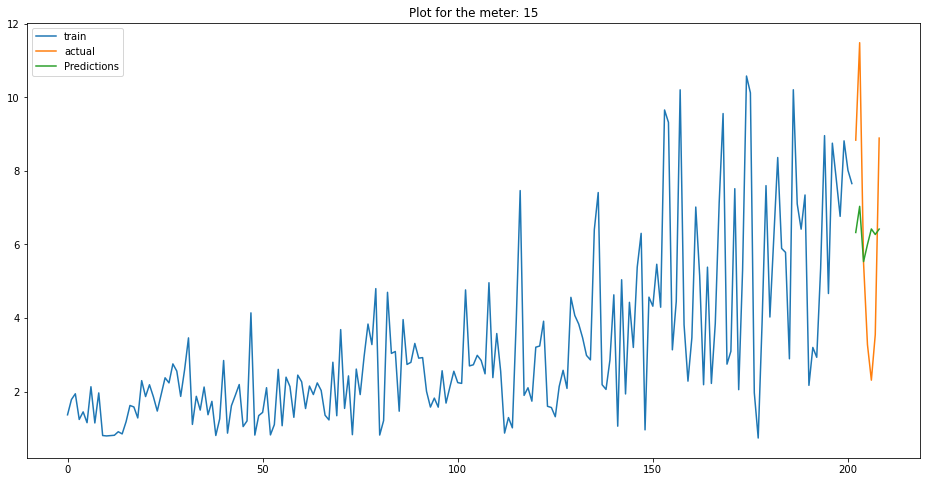

            ds       y
202 2021-07-22   8.834
203 2021-07-23  11.483
204 2021-07-24   5.498
205 2021-07-25   3.276
206 2021-07-26   2.311
207 2021-07-27   3.549
208 2021-07-28   8.890
            ds  Predictions
202 2021-07-22     6.324482
203 2021-07-23     7.035226
204 2021-07-24     5.532946
205 2021-07-25     5.998744
206 2021-07-26     6.420397
207 2021-07-27     6.270006
208 2021-07-28     6.417434
0.36092779233528677


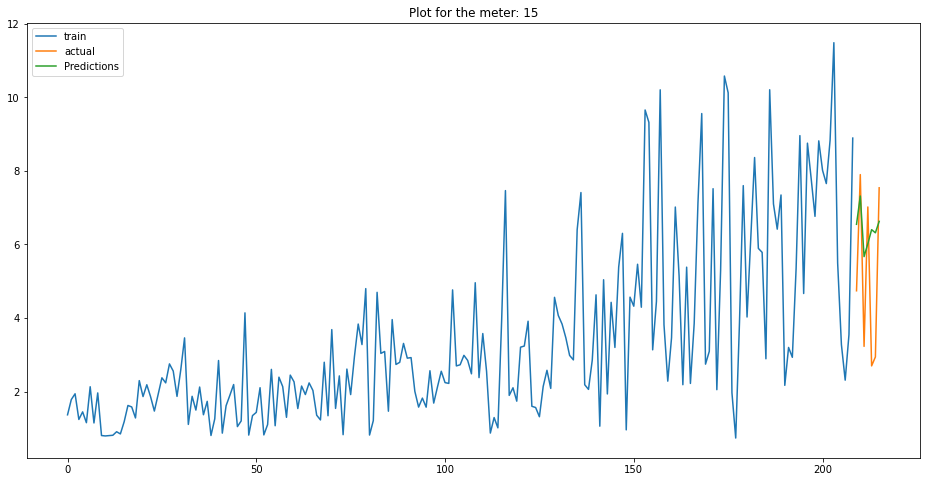

            ds      y
209 2021-07-29  4.740
210 2021-07-30  7.898
211 2021-07-31  3.229
212 2021-08-01  7.018
213 2021-08-02  2.699
214 2021-08-03  2.942
215 2021-08-04  7.539
            ds  Predictions
209 2021-07-29     6.546538
210 2021-07-30     7.315579
211 2021-07-31     5.668393
212 2021-08-01     6.021430
213 2021-08-02     6.401466
214 2021-08-03     6.316243
215 2021-08-04     6.626753
24.487459759458265
   mape_weekly  meterID    type
0        7.099       15  unflag
1       25.734       15  unflag
2        0.361       15  unflag
3       24.487       15  unflag


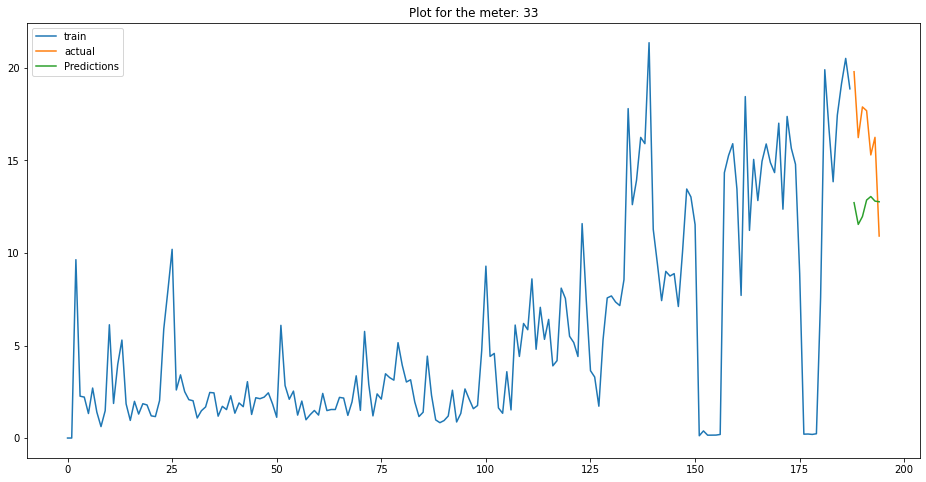

            ds       y
188 2021-07-08  19.789
189 2021-07-09  16.230
190 2021-07-10  17.886
191 2021-07-11  17.683
192 2021-07-12  15.294
193 2021-07-13  16.244
194 2021-07-14  10.913
            ds  Predictions
188 2021-07-08    12.714728
189 2021-07-09    11.541210
190 2021-07-10    11.965468
191 2021-07-11    12.856728
192 2021-07-12    13.047381
193 2021-07-13    12.799335
194 2021-07-14    12.764472
23.105848038743893


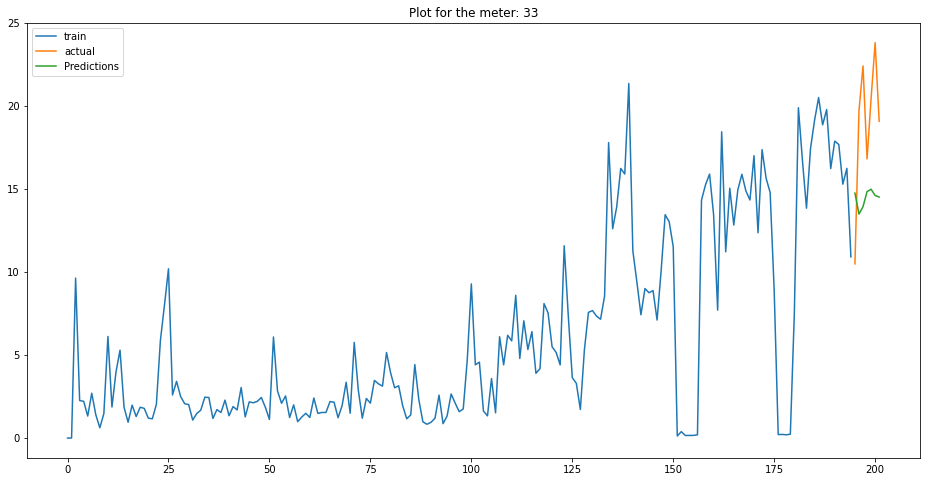

            ds       y
195 2021-07-15  10.493
196 2021-07-16  19.719
197 2021-07-17  22.416
198 2021-07-18  16.816
199 2021-07-19  20.459
200 2021-07-20  23.815
201 2021-07-21  19.083
            ds  Predictions
195 2021-07-15    14.753702
196 2021-07-16    13.490458
197 2021-07-17    13.938321
198 2021-07-18    14.844556
199 2021-07-19    14.987610
200 2021-07-20    14.613741
201 2021-07-21    14.516131
23.83753279780897


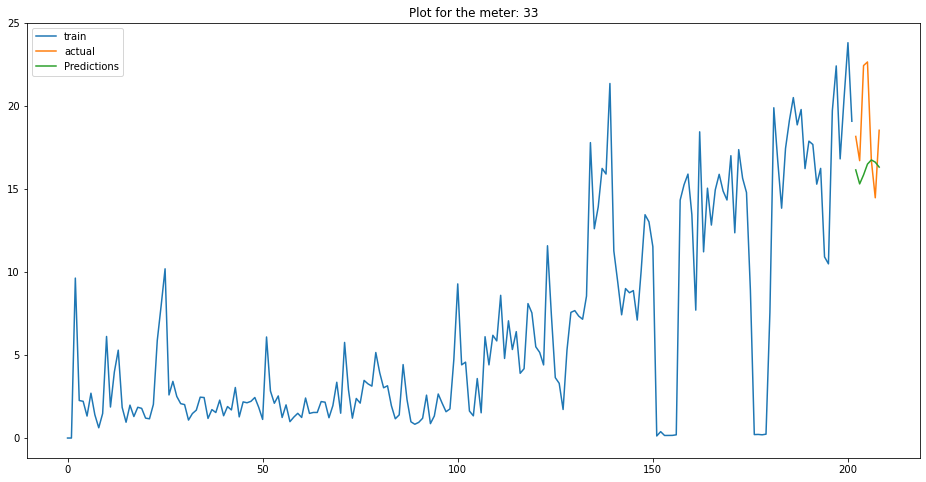

            ds       y
202 2021-07-22  18.168
203 2021-07-23  16.709
204 2021-07-24  22.436
205 2021-07-25  22.653
206 2021-07-26  16.717
207 2021-07-27  14.473
208 2021-07-28  18.540
            ds  Predictions
202 2021-07-22    16.152377
203 2021-07-23    15.308687
204 2021-07-24    15.850756
205 2021-07-25    16.500518
206 2021-07-26    16.752404
207 2021-07-27    16.618770
208 2021-07-28    16.320935
12.484234415688602


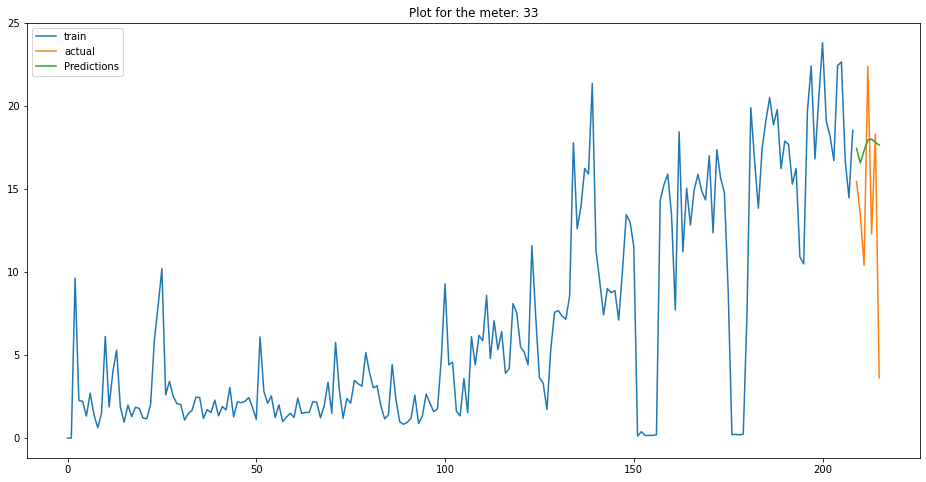

            ds       y
209 2021-07-29  15.459
210 2021-07-30  13.458
211 2021-07-31  10.400
212 2021-08-01  22.392
213 2021-08-02  12.299
214 2021-08-03  18.304
215 2021-08-04   3.633
            ds  Predictions
209 2021-07-29    17.453401
210 2021-07-30    16.570286
211 2021-07-31    17.306155
212 2021-08-01    17.959417
213 2021-08-02    18.004002
214 2021-08-03    17.806808
215 2021-08-04    17.650917
27.938908439511522
   mape_weekly  meterID    type
0       23.106       33  unflag
1       23.838       33  unflag
2       12.484       33  unflag
3       27.939       33  unflag


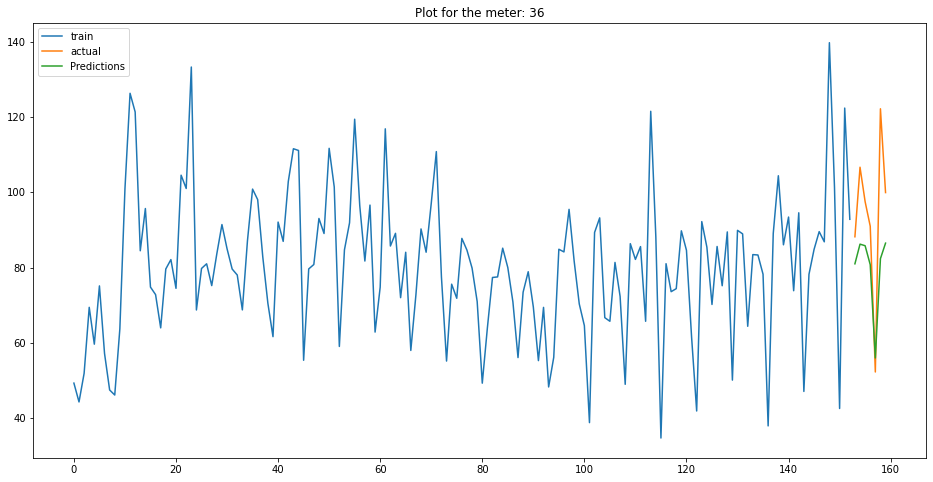

            ds        y
153 2021-06-03   88.162
154 2021-06-04  106.638
155 2021-06-05   97.490
156 2021-06-06   90.974
157 2021-06-07   52.250
158 2021-06-08  122.160
159 2021-06-09   99.904
            ds  Predictions
153 2021-06-03    80.981022
154 2021-06-04    86.203975
155 2021-06-05    85.787549
156 2021-06-06    80.750847
157 2021-06-07    55.980224
158 2021-06-08    82.358030
159 2021-06-09    86.472675
15.061890502462335


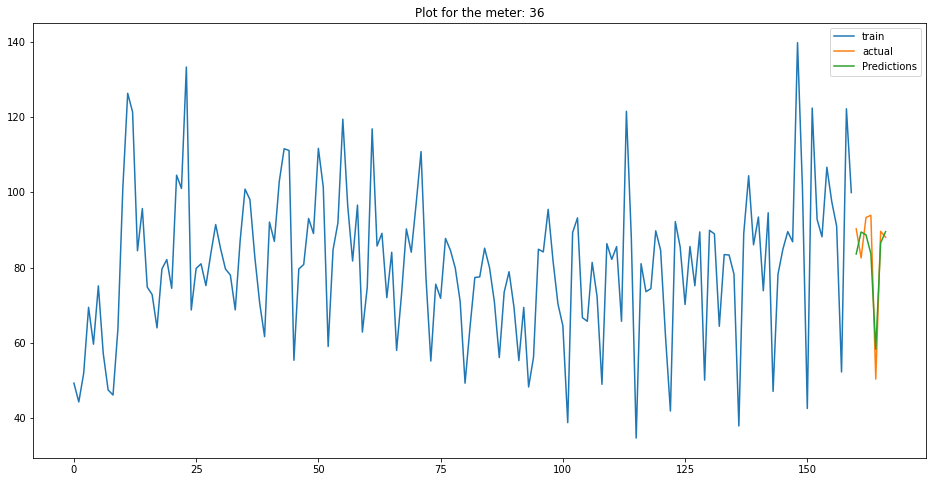

            ds       y
160 2021-06-10  90.274
161 2021-06-11  82.550
162 2021-06-12  93.270
163 2021-06-13  93.868
164 2021-06-14  50.368
165 2021-06-15  89.620
166 2021-06-16  88.030
            ds  Predictions
160 2021-06-10    83.592012
161 2021-06-11    89.432022
162 2021-06-12    88.676877
163 2021-06-13    83.672158
164 2021-06-14    58.284665
165 2021-06-15    86.565786
166 2021-06-16    89.515972
1.4014943503734352


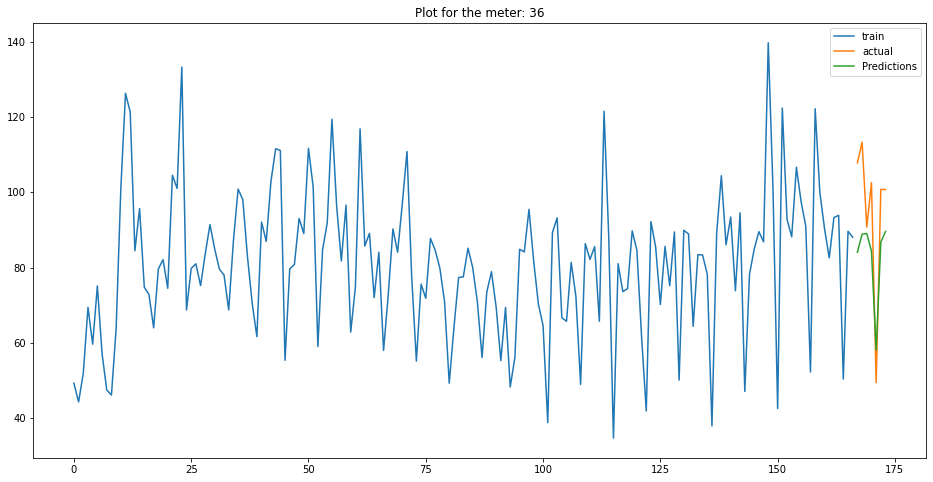

            ds        y
167 2021-06-17  107.780
168 2021-06-18  113.286
169 2021-06-19   90.726
170 2021-06-20  102.528
171 2021-06-21   49.418
172 2021-06-22  100.782
173 2021-06-23  100.706
            ds  Predictions
167 2021-06-17    84.051258
168 2021-06-18    88.837433
169 2021-06-19    89.027359
170 2021-06-20    84.316463
171 2021-06-21    58.083447
172 2021-06-22    86.790004
173 2021-06-23    89.580270
12.708427874222664


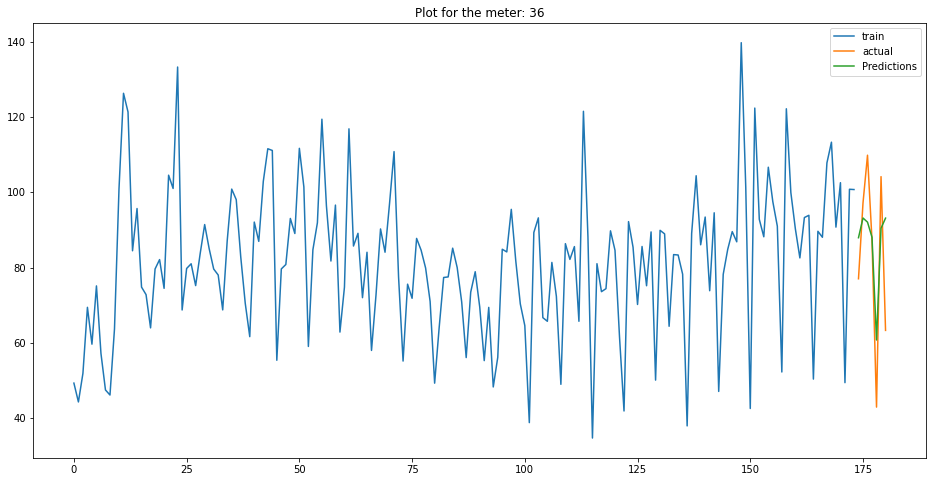

            ds        y
174 2021-06-24   77.008
175 2021-06-25   97.132
176 2021-06-26  109.828
177 2021-06-27   87.154
178 2021-06-28   42.928
179 2021-06-29  104.134
180 2021-06-30   63.302
            ds  Predictions
174 2021-06-24    87.912215
175 2021-06-25    93.152437
176 2021-06-26    92.046163
177 2021-06-27    88.025417
178 2021-06-28    60.745703
179 2021-06-29    90.434482
180 2021-06-30    93.112825
4.117595588496018
   mape_weekly  meterID    type
0       15.062       36  unflag
1        1.401       36  unflag
2       12.708       36  unflag
3        4.118       36  unflag


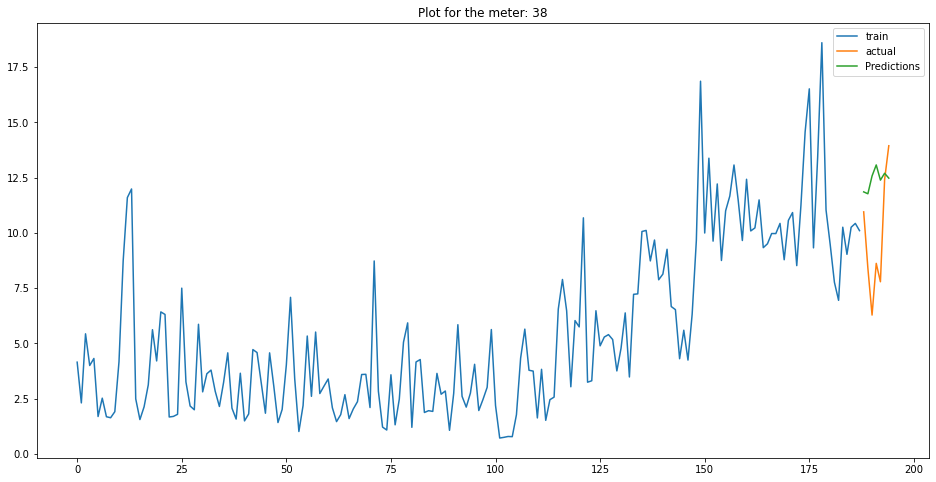

            ds       y
188 2021-07-08  10.954
189 2021-07-09   8.406
190 2021-07-10   6.284
191 2021-07-11   8.623
192 2021-07-12   7.791
193 2021-07-13  12.414
194 2021-07-14  13.945
            ds  Predictions
188 2021-07-08    11.857142
189 2021-07-09    11.772118
190 2021-07-10    12.577468
191 2021-07-11    13.076297
192 2021-07-12    12.390017
193 2021-07-13    12.699199
194 2021-07-14    12.479089
26.94407925476845


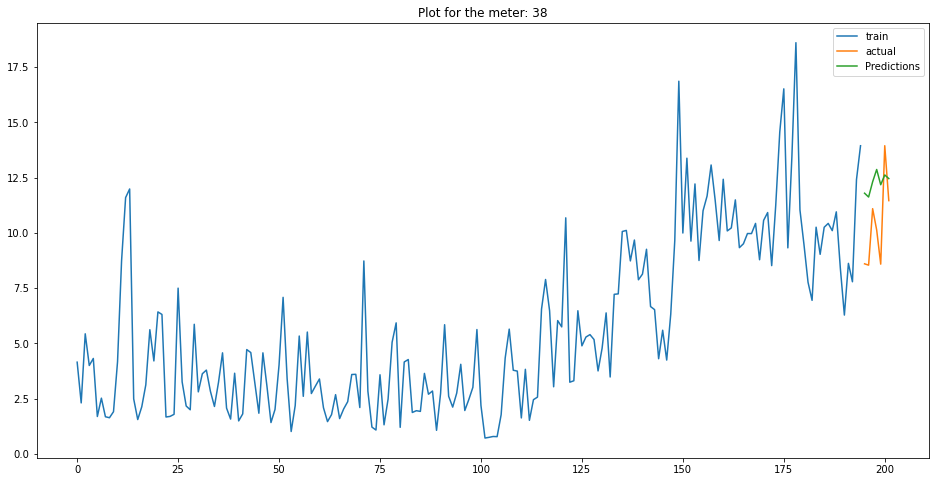

            ds       y
195 2021-07-15   8.603
196 2021-07-16   8.542
197 2021-07-17  11.098
198 2021-07-18  10.133
199 2021-07-19   8.588
200 2021-07-20  13.946
201 2021-07-21  11.462
            ds  Predictions
195 2021-07-15    11.797266
196 2021-07-16    11.624209
197 2021-07-17    12.314365
198 2021-07-18    12.870389
199 2021-07-19    12.179400
200 2021-07-20    12.623283
201 2021-07-21    12.458817
18.647721728273826


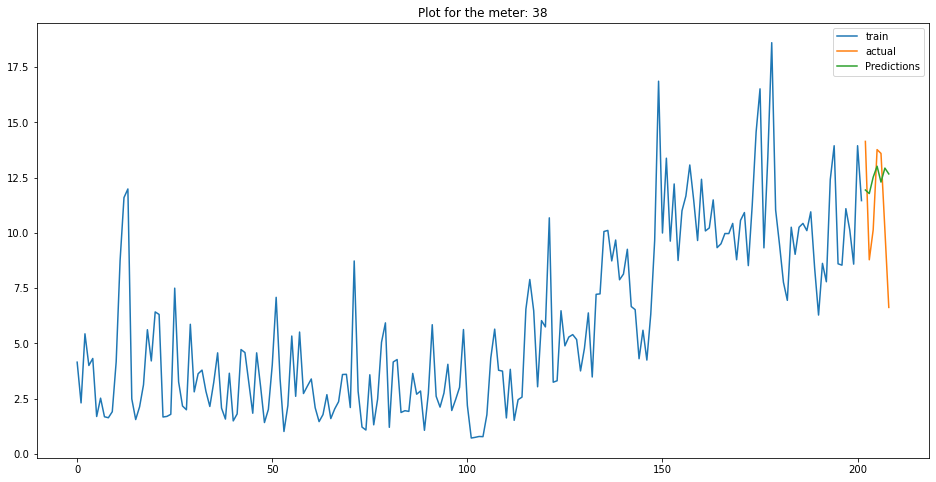

            ds       y
202 2021-07-22  14.141
203 2021-07-23   8.785
204 2021-07-24  10.140
205 2021-07-25  13.770
206 2021-07-26  13.597
207 2021-07-27  10.137
208 2021-07-28   6.630
            ds  Predictions
202 2021-07-22    11.942417
203 2021-07-23    11.780690
204 2021-07-24    12.522238
205 2021-07-25    13.018520
206 2021-07-26    12.300711
207 2021-07-27    12.933184
208 2021-07-28    12.669880
12.911450420560744


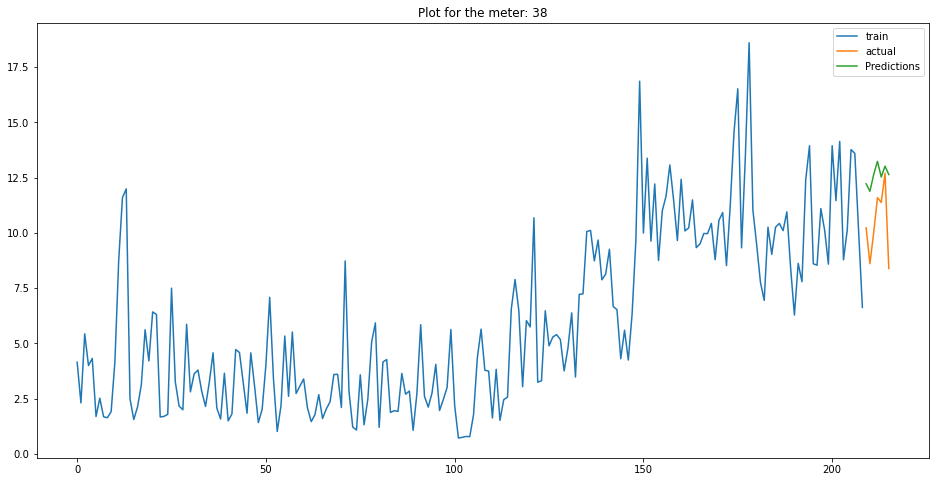

            ds       y
209 2021-07-29  10.231
210 2021-07-30   8.609
211 2021-07-31  10.017
212 2021-08-01  11.598
213 2021-08-02  11.380
214 2021-08-03  12.696
215 2021-08-04   8.392
            ds  Predictions
209 2021-07-29    12.221449
210 2021-07-30    11.883250
211 2021-07-31    12.639979
212 2021-08-01    13.238615
213 2021-08-02    12.528591
214 2021-08-03    13.021165
215 2021-08-04    12.641753
20.914940486032087
   mape_weekly  meterID    type
0       26.944       38  unflag
1       18.648       38  unflag
2       12.911       38  unflag
3       20.915       38  unflag


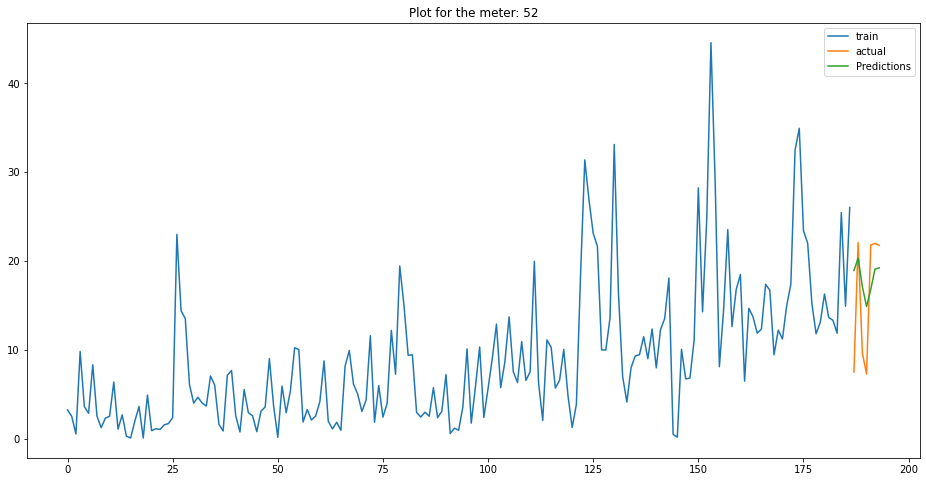

            ds       y
187 2021-07-07   7.491
188 2021-07-08  22.069
189 2021-07-09   9.645
190 2021-07-10   7.277
191 2021-07-11  21.802
192 2021-07-12  21.980
193 2021-07-13  21.756
            ds  Predictions
187 2021-07-07    18.922867
188 2021-07-08    20.322851
189 2021-07-09    17.123208
190 2021-07-10    14.878481
191 2021-07-11    16.801651
192 2021-07-12    19.074663
193 2021-07-13    19.233850
12.799117697826725


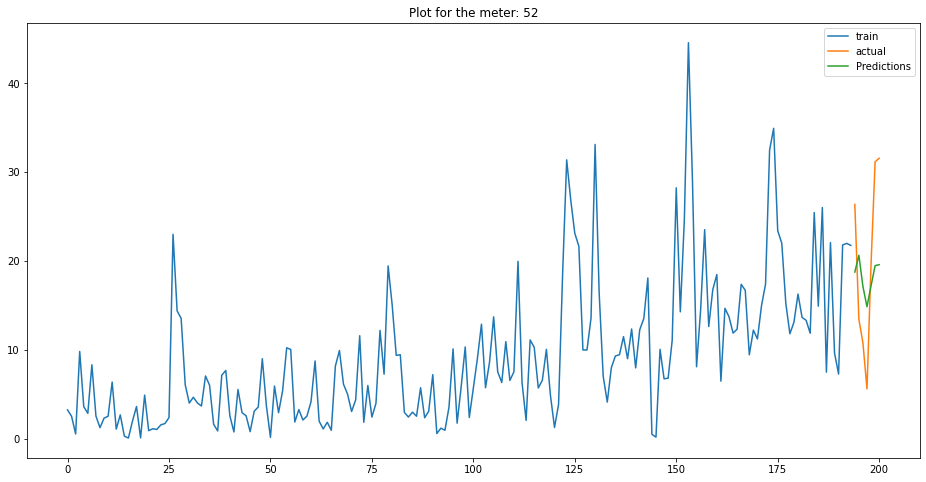

            ds       y
194 2021-07-14  26.361
195 2021-07-15  13.442
196 2021-07-16  10.767
197 2021-07-17   5.611
198 2021-07-18  19.654
199 2021-07-19  31.160
200 2021-07-20  31.560
            ds  Predictions
194 2021-07-14    18.754824
195 2021-07-15    20.643152
196 2021-07-16    17.124593
197 2021-07-17    14.847744
198 2021-07-18    17.210271
199 2021-07-19    19.475238
200 2021-07-20    19.581586
7.8796096114520005


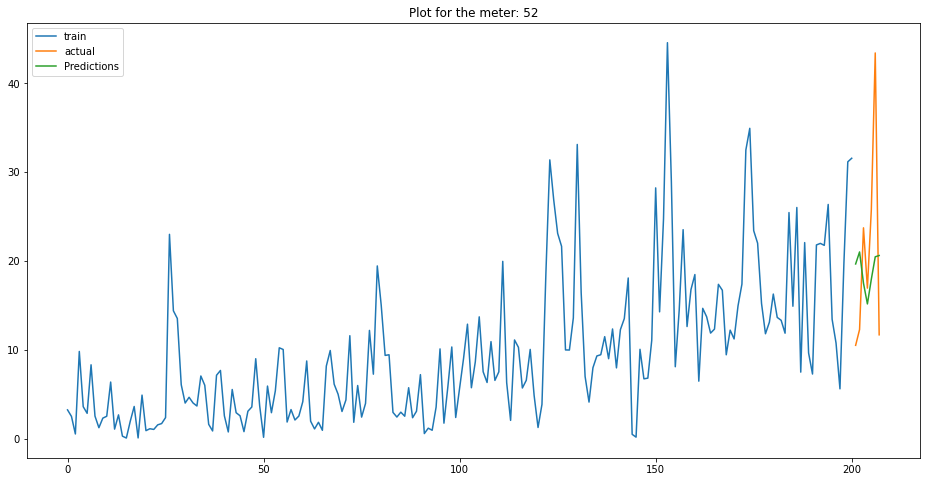

            ds       y
201 2021-07-21  10.507
202 2021-07-22  12.282
203 2021-07-23  23.730
204 2021-07-24  16.946
205 2021-07-25  25.758
206 2021-07-26  43.410
207 2021-07-27  11.691
            ds  Predictions
201 2021-07-21    19.662618
202 2021-07-22    21.017516
203 2021-07-23    17.498437
204 2021-07-24    15.165902
205 2021-07-25    17.944569
206 2021-07-26    20.471231
207 2021-07-27    20.613394
8.280212801485217


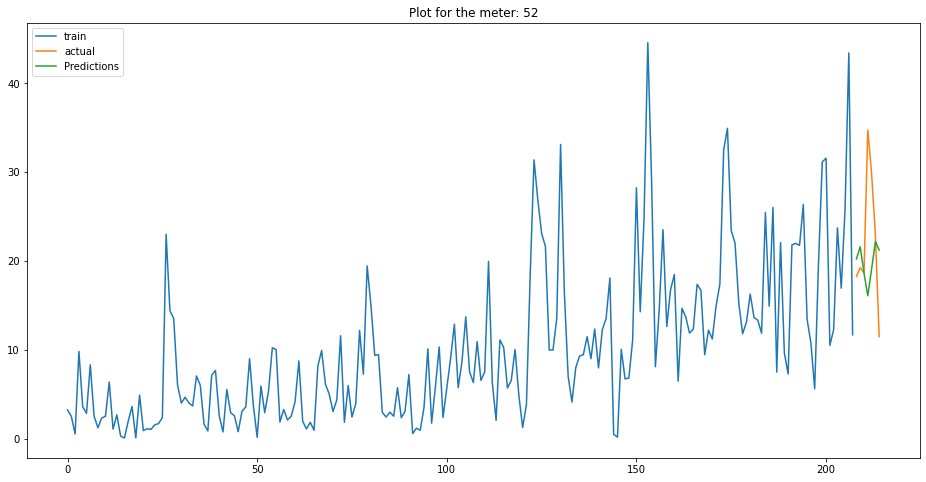

            ds       y
208 2021-07-28  18.258
209 2021-07-29  19.242
210 2021-07-30  18.666
211 2021-07-31  34.742
212 2021-08-01  29.864
213 2021-08-02  23.030
214 2021-08-03  11.474
            ds  Predictions
208 2021-07-28    20.221038
209 2021-07-29    21.599513
210 2021-07-30    18.641423
211 2021-07-31    16.077363
212 2021-08-01    19.060573
213 2021-08-02    22.192814
214 2021-08-03    21.226170
10.469812785391158
   mape_weekly  meterID    type
0       12.799       52  unflag
1        7.880       52  unflag
2        8.280       52  unflag
3       10.470       52  unflag


In [887]:
for i in TOU_list_above365:
    account_and_days_billcycle_new(i,'off peak')

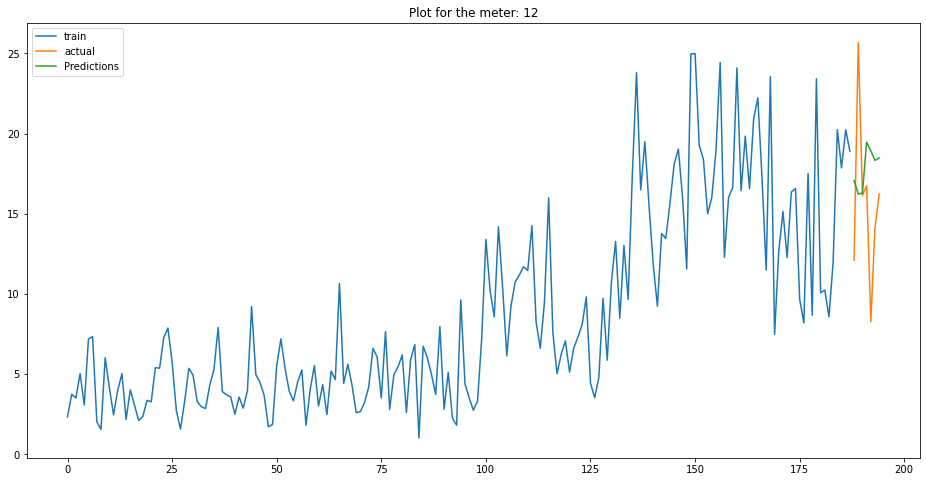

            ds       y
188 2021-07-08  12.106
189 2021-07-09  25.664
190 2021-07-10  16.136
191 2021-07-11  16.743
192 2021-07-12   8.268
193 2021-07-13  14.129
194 2021-07-14  16.235
            ds  Predictions
188 2021-07-08    17.069919
189 2021-07-09    16.225123
190 2021-07-10    16.280966
191 2021-07-11    19.460819
192 2021-07-12    18.924844
193 2021-07-13    18.325006
194 2021-07-14    18.473506
14.16456799623727


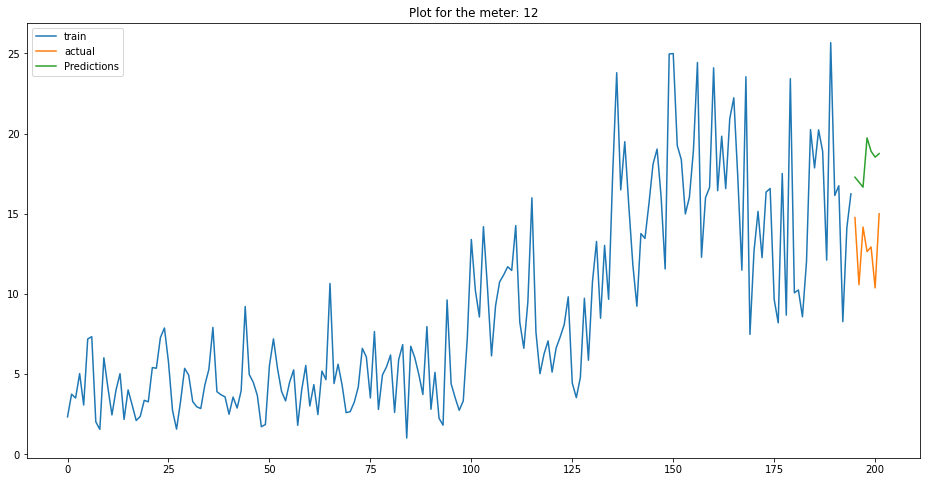

            ds       y
195 2021-07-15  14.759
196 2021-07-16  10.572
197 2021-07-17  14.168
198 2021-07-18  12.641
199 2021-07-19  12.923
200 2021-07-20  10.373
201 2021-07-21  14.995
            ds  Predictions
195 2021-07-15    17.275914
196 2021-07-16    16.966824
197 2021-07-17    16.653833
198 2021-07-18    19.726888
199 2021-07-19    18.891252
200 2021-07-20    18.527637
201 2021-07-21    18.748145
40.20688997445688


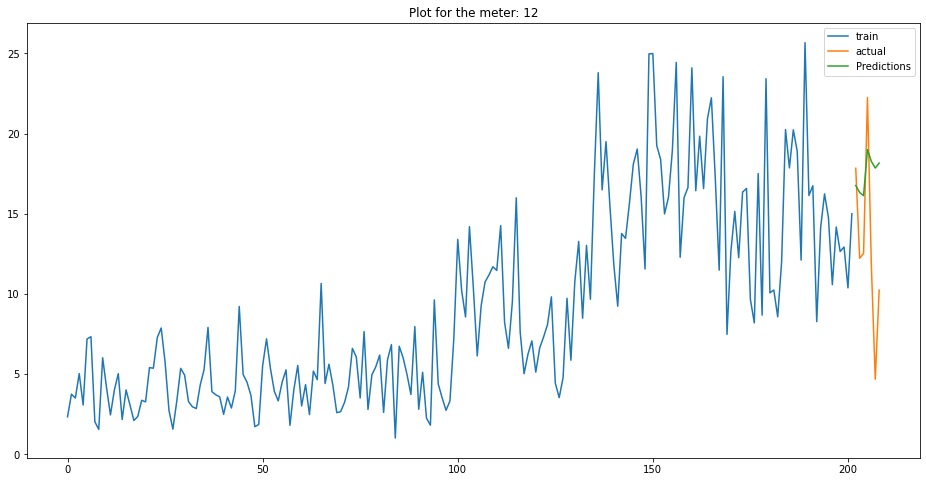

            ds       y
202 2021-07-22  17.831
203 2021-07-23  12.221
204 2021-07-24  12.517
205 2021-07-25  22.245
206 2021-07-26  11.758
207 2021-07-27   4.678
208 2021-07-28  10.231
            ds  Predictions
202 2021-07-22    16.762957
203 2021-07-23    16.317237
204 2021-07-24    16.124889
205 2021-07-25    19.000825
206 2021-07-26    18.257266
207 2021-07-27    17.847572
208 2021-07-28    18.154035
33.86908861324119


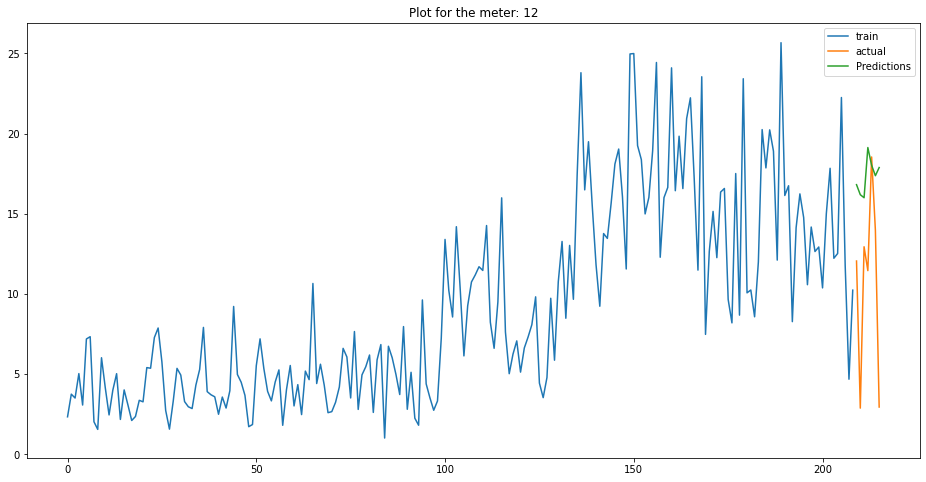

            ds       y
209 2021-07-29  12.049
210 2021-07-30   2.875
211 2021-07-31  12.938
212 2021-08-01  11.450
213 2021-08-02  18.537
214 2021-08-03  13.960
215 2021-08-04   2.943
            ds  Predictions
209 2021-07-29    16.809894
210 2021-07-30    16.184660
211 2021-07-31    15.995991
212 2021-08-01    19.125390
213 2021-08-02    18.018722
214 2021-08-03    17.369136
215 2021-08-04    17.877889
62.3791779925006
   mape_weekly  meterID    type
0       14.165       12  unflag
1       40.207       12  unflag
2       33.869       12  unflag
3       62.379       12    flag


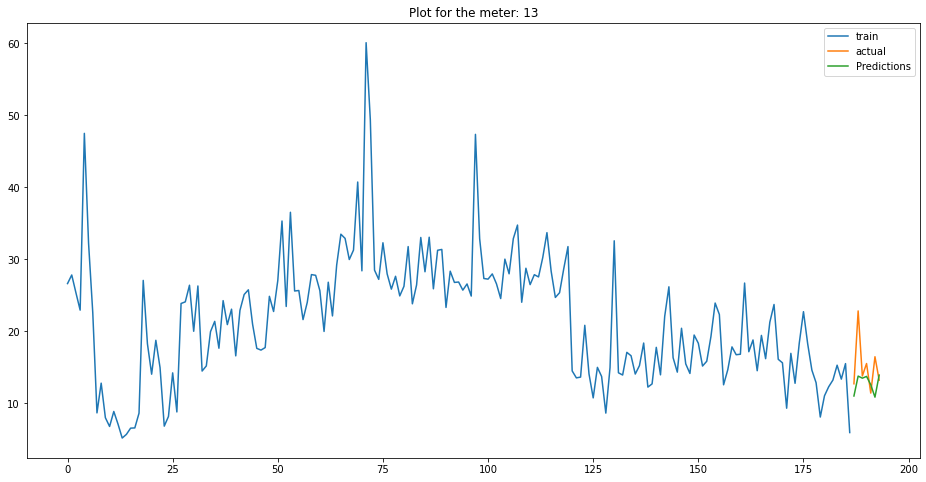

            ds       y
187 2021-07-07  12.722
188 2021-07-08  22.842
189 2021-07-09  13.803
190 2021-07-10  15.533
191 2021-07-11  11.428
192 2021-07-12  16.479
193 2021-07-13  13.221
            ds  Predictions
187 2021-07-07    11.023487
188 2021-07-08    13.786880
189 2021-07-09    13.500917
190 2021-07-10    13.742600
191 2021-07-11    12.591061
192 2021-07-12    10.862910
193 2021-07-13    13.927266
15.649525159716704


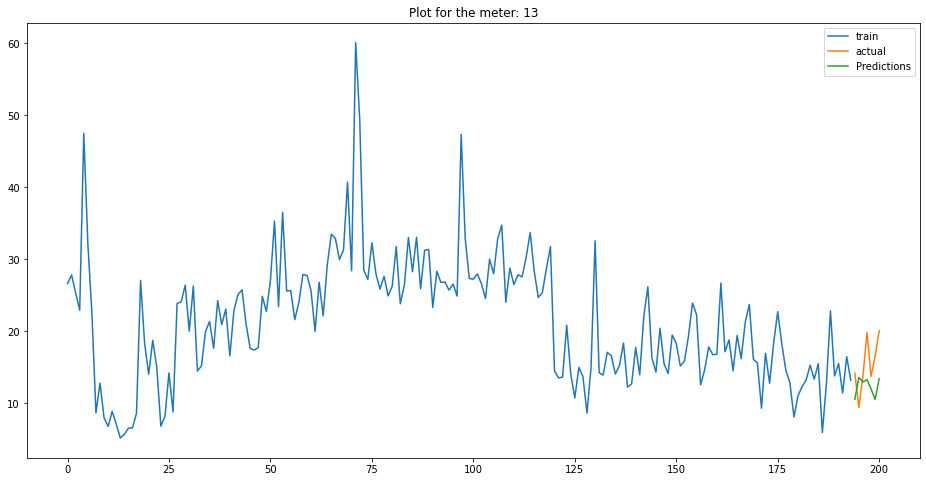

            ds       y
194 2021-07-14  14.182
195 2021-07-15   9.434
196 2021-07-16  13.764
197 2021-07-17  19.838
198 2021-07-18  13.746
199 2021-07-19  16.562
200 2021-07-20  20.089
            ds  Predictions
194 2021-07-14    10.568977
195 2021-07-15    13.602745
196 2021-07-16    12.973524
197 2021-07-17    13.297199
198 2021-07-18    12.008409
199 2021-07-19    10.557690
200 2021-07-20    13.422090
19.685327754106105


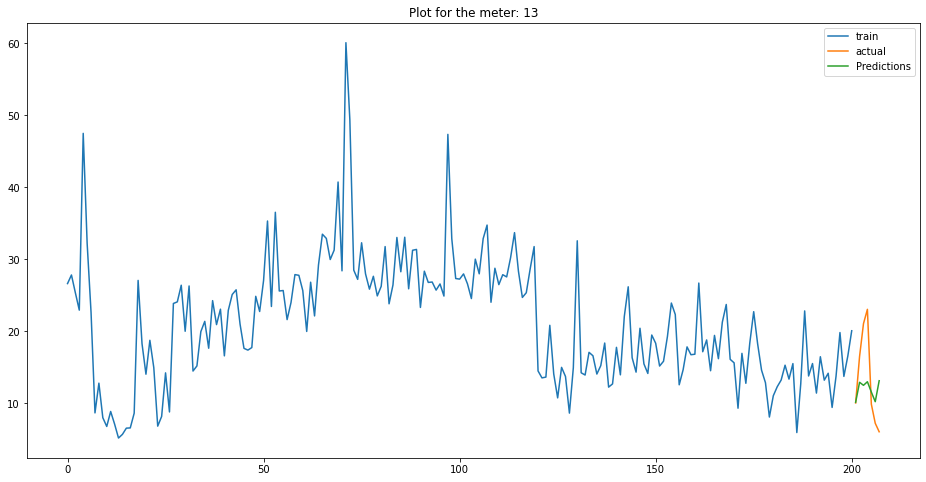

            ds       y
201 2021-07-21  10.055
202 2021-07-22  16.514
203 2021-07-23  21.077
204 2021-07-24  23.064
205 2021-07-25   9.902
206 2021-07-26   7.233
207 2021-07-27   6.054
            ds  Predictions
201 2021-07-21    10.157347
202 2021-07-22    12.926309
203 2021-07-23    12.507238
204 2021-07-24    13.004559
205 2021-07-25    11.573165
206 2021-07-26    10.231715
207 2021-07-27    13.140803
11.03085635051988


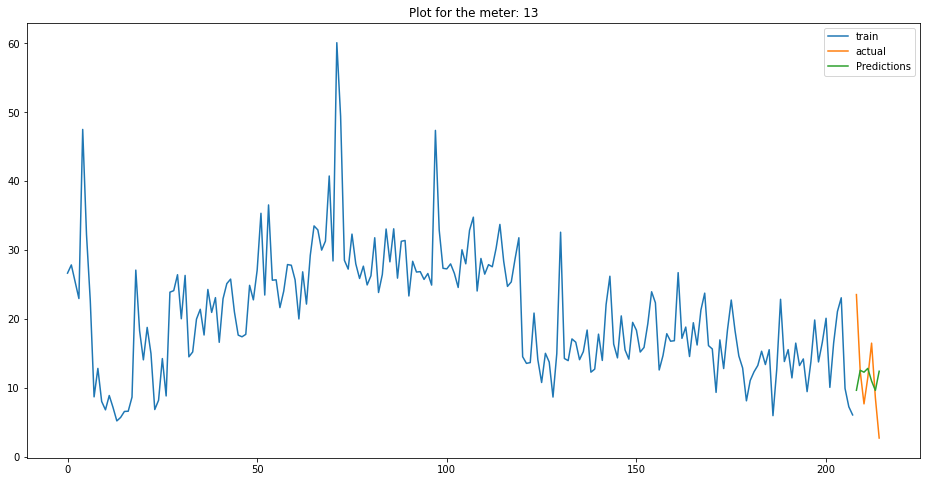

            ds       y
208 2021-07-28  23.529
209 2021-07-29  12.395
210 2021-07-30   7.657
211 2021-07-31  11.474
212 2021-08-01  16.476
213 2021-08-02   8.536
214 2021-08-03   2.696
            ds  Predictions
208 2021-07-28     9.632864
209 2021-07-29    12.530340
210 2021-07-30    12.258292
211 2021-07-31    12.811825
212 2021-08-01    10.973919
213 2021-08-02     9.618137
214 2021-08-03    12.393001
3.074588600925389
   mape_weekly  meterID    type
0       15.650       13  unflag
1       19.685       13  unflag
2       11.031       13  unflag
3        3.075       13  unflag


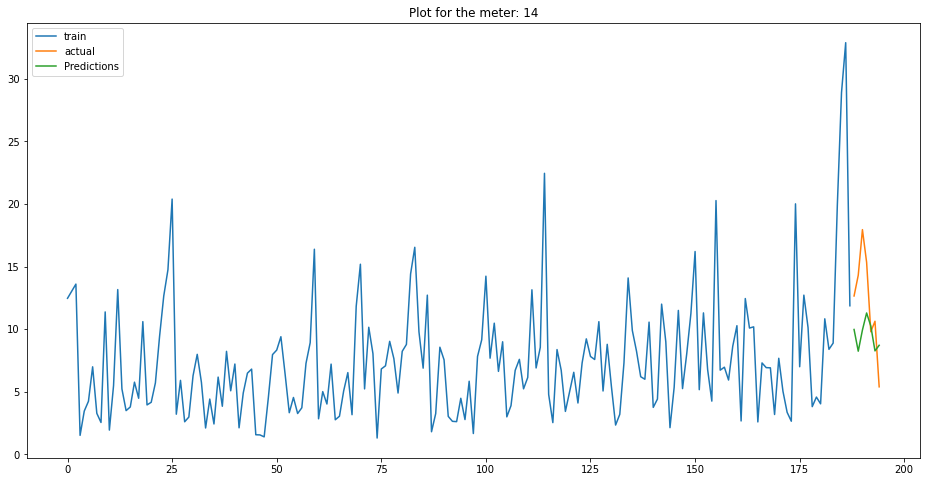

            ds       y
188 2021-07-08  12.649
189 2021-07-09  14.307
190 2021-07-10  17.948
191 2021-07-11  15.336
192 2021-07-12   9.790
193 2021-07-13  10.630
194 2021-07-14   5.394
            ds  Predictions
188 2021-07-08     9.973318
189 2021-07-09     8.239276
190 2021-07-10     9.929668
191 2021-07-11    11.291942
192 2021-07-12    10.247116
193 2021-07-13     8.263806
194 2021-07-14     8.710353
22.542266109020336


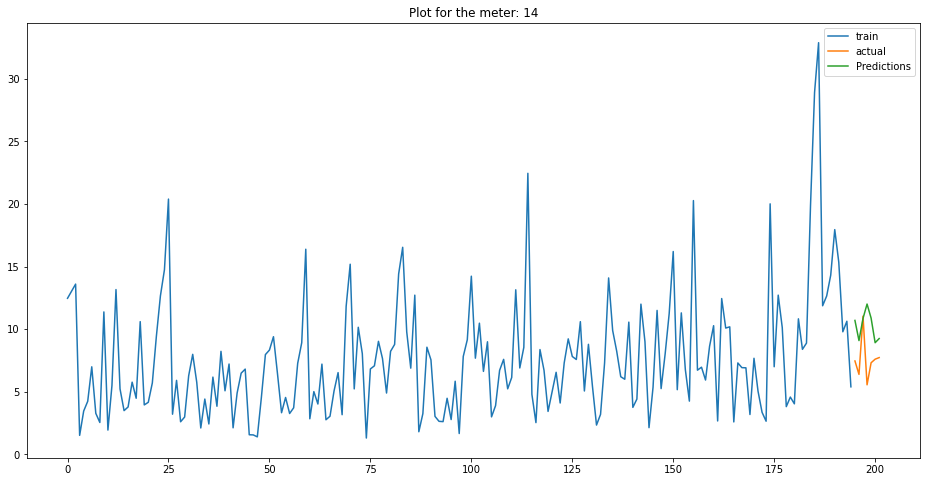

            ds       y
195 2021-07-15   7.459
196 2021-07-16   6.387
197 2021-07-17  11.040
198 2021-07-18   5.554
199 2021-07-19   7.314
200 2021-07-20   7.601
201 2021-07-21   7.728
            ds  Predictions
195 2021-07-15    10.696677
196 2021-07-16     9.087558
197 2021-07-17    10.855484
198 2021-07-18    12.004192
199 2021-07-19    10.885827
200 2021-07-20     8.917640
201 2021-07-21     9.248079
35.062933703502466


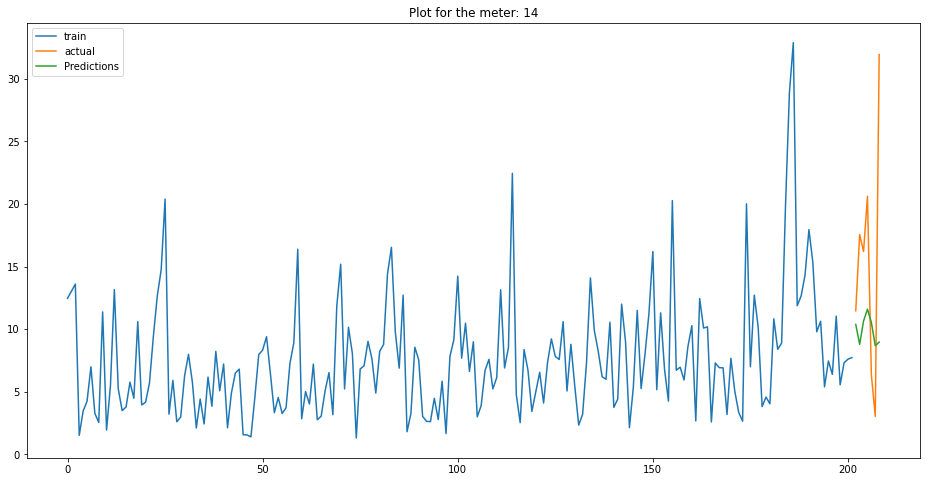

            ds       y
202 2021-07-22  11.468
203 2021-07-23  17.554
204 2021-07-24  16.198
205 2021-07-25  20.608
206 2021-07-26   6.355
207 2021-07-27   3.036
208 2021-07-28  31.929
            ds  Predictions
202 2021-07-22    10.379883
203 2021-07-23     8.786130
204 2021-07-24    10.648765
205 2021-07-25    11.593774
206 2021-07-26    10.539289
207 2021-07-27     8.678538
208 2021-07-28     8.965369
35.05081917755297


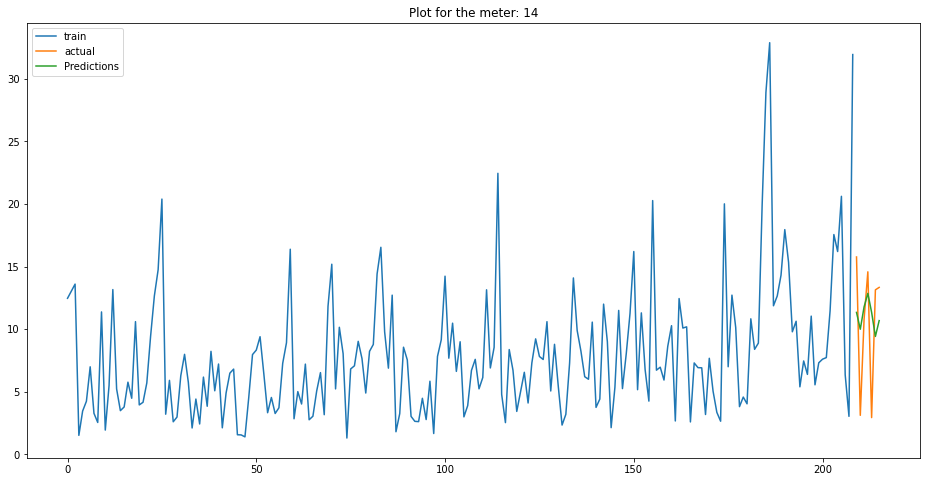

            ds       y
209 2021-07-29  15.764
210 2021-07-30   3.118
211 2021-07-31  10.786
212 2021-08-01  14.578
213 2021-08-02   2.937
214 2021-08-03  13.138
215 2021-08-04  13.335
            ds  Predictions
209 2021-07-29    11.335056
210 2021-07-30     9.993983
211 2021-07-31    11.774368
212 2021-08-01    12.857029
213 2021-08-02    11.340816
214 2021-08-03     9.417876
215 2021-08-04    10.680617
5.082742064429953
   mape_weekly  meterID    type
0       22.542       14  unflag
1       35.063       14  unflag
2       35.051       14  unflag
3        5.083       14  unflag


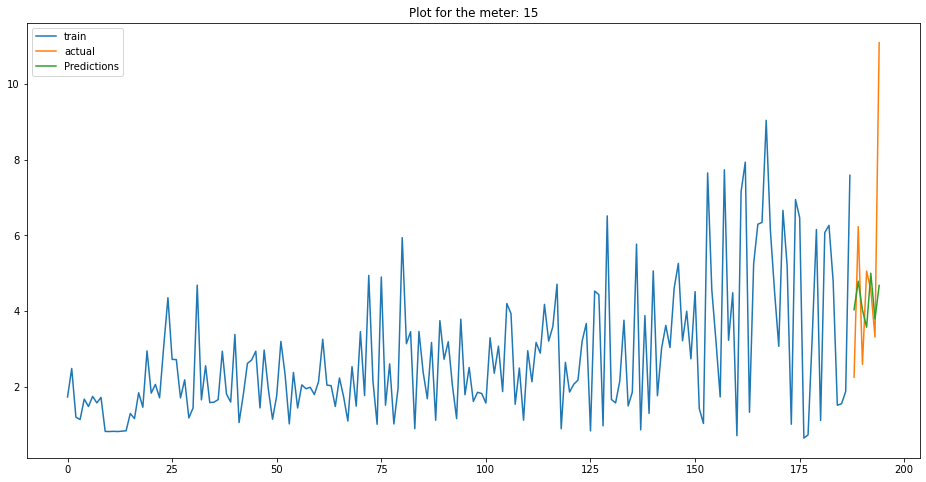

            ds       y
188 2021-07-08   2.262
189 2021-07-09   6.231
190 2021-07-10   2.596
191 2021-07-11   5.059
192 2021-07-12   4.567
193 2021-07-13   3.321
194 2021-07-14  11.081
            ds  Predictions
188 2021-07-08     4.040397
189 2021-07-09     4.791066
190 2021-07-10     4.037525
191 2021-07-11     3.578063
192 2021-07-12     5.003047
193 2021-07-13     3.797850
194 2021-07-14     4.678930
14.779516259026831


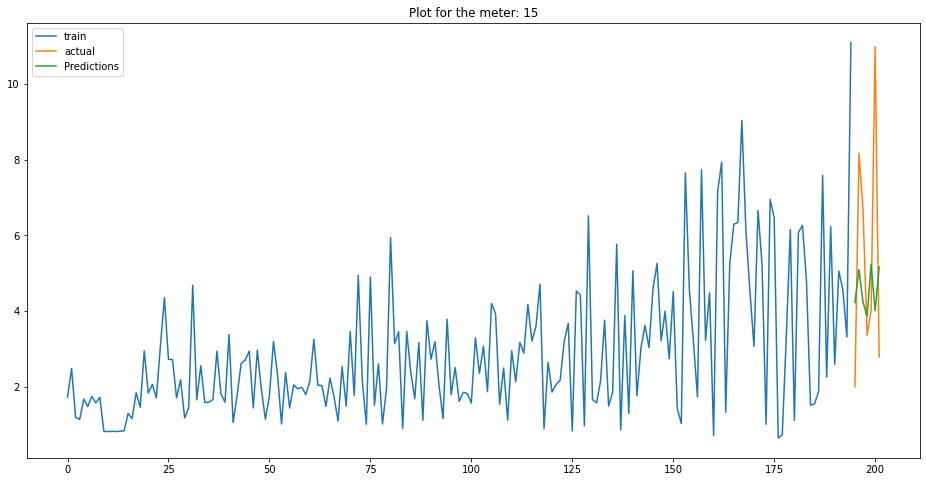

            ds       y
195 2021-07-15   2.007
196 2021-07-16   8.162
197 2021-07-17   6.686
198 2021-07-18   3.362
199 2021-07-19   4.031
200 2021-07-20  10.976
201 2021-07-21   2.794
            ds  Predictions
195 2021-07-15     4.226368
196 2021-07-16     5.097202
197 2021-07-17     4.242578
198 2021-07-18     3.862997
199 2021-07-19     5.239684
200 2021-07-20     4.012377
201 2021-07-21     5.165244
16.23323247355131


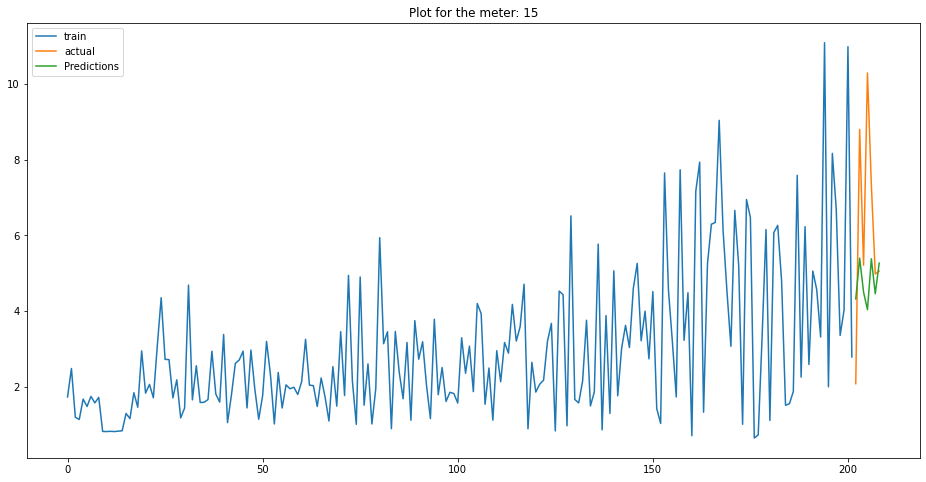

            ds       y
202 2021-07-22   2.090
203 2021-07-23   8.792
204 2021-07-24   5.212
205 2021-07-25  10.283
206 2021-07-26   7.325
207 2021-07-27   4.982
208 2021-07-28   5.061
            ds  Predictions
202 2021-07-22     4.323260
203 2021-07-23     5.399368
204 2021-07-24     4.504083
205 2021-07-25     4.040393
206 2021-07-26     5.383448
207 2021-07-27     4.460029
208 2021-07-28     5.267717
23.698028903628


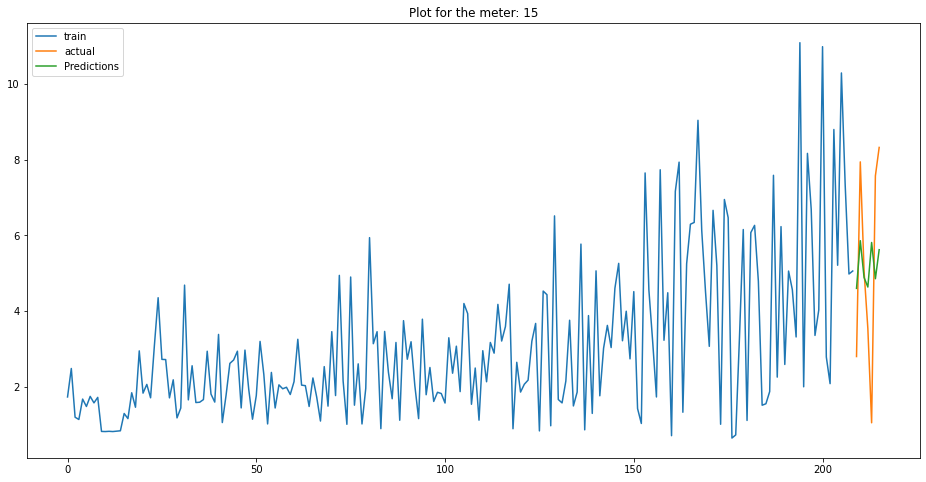

            ds      y
209 2021-07-29  2.805
210 2021-07-30  7.938
211 2021-07-31  5.056
212 2021-08-01  3.547
213 2021-08-02  1.058
214 2021-08-03  7.570
215 2021-08-04  8.319
            ds  Predictions
209 2021-07-29     4.602544
210 2021-07-30     5.860019
211 2021-07-31     4.889829
212 2021-08-01     4.637620
213 2021-08-02     5.812369
214 2021-08-03     4.856889
215 2021-08-04     5.622282
0.03154146714051431
   mape_weekly  meterID    type
0       14.780       15  unflag
1       16.233       15  unflag
2       23.698       15  unflag
3        0.032       15  unflag


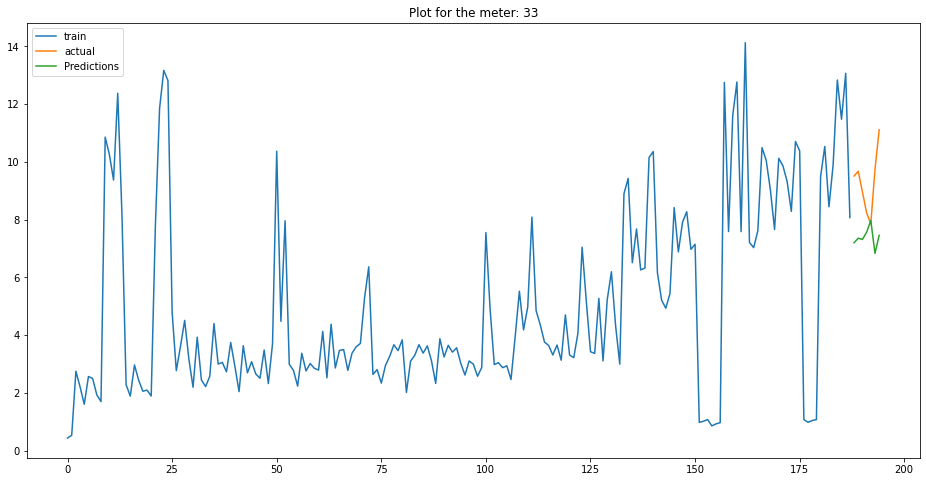

            ds       y
188 2021-07-08   9.511
189 2021-07-09   9.676
190 2021-07-10   8.959
191 2021-07-11   8.237
192 2021-07-12   7.858
193 2021-07-13   9.740
194 2021-07-14  11.111
            ds  Predictions
188 2021-07-08     7.200944
189 2021-07-09     7.356049
190 2021-07-10     7.314764
191 2021-07-11     7.562583
192 2021-07-12     7.969442
193 2021-07-13     6.832289
194 2021-07-14     7.456551
20.58529147526311


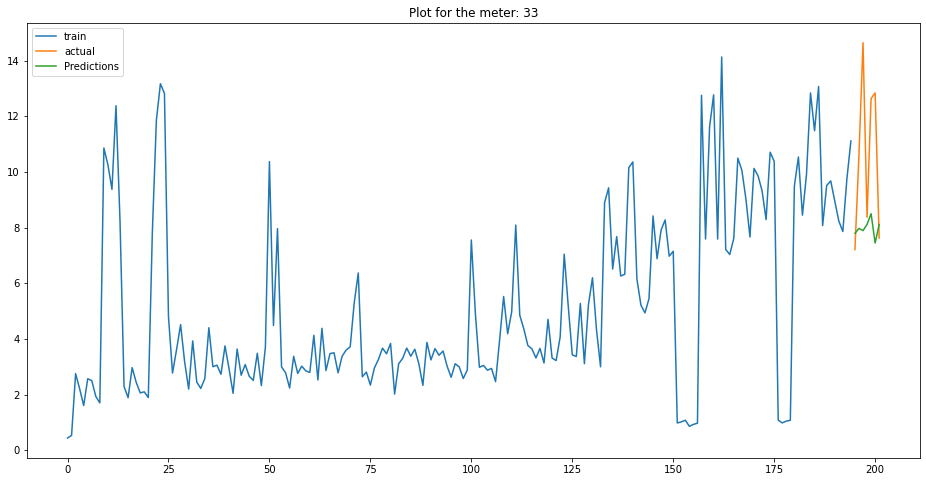

            ds       y
195 2021-07-15   7.208
196 2021-07-16  10.621
197 2021-07-17  14.642
198 2021-07-18   8.370
199 2021-07-19  12.638
200 2021-07-20  12.838
201 2021-07-21   7.623
            ds  Predictions
195 2021-07-15     7.791041
196 2021-07-16     7.969689
197 2021-07-17     7.889303
198 2021-07-18     8.114652
199 2021-07-19     8.497096
200 2021-07-20     7.443752
201 2021-07-21     8.108350
24.51463024740257


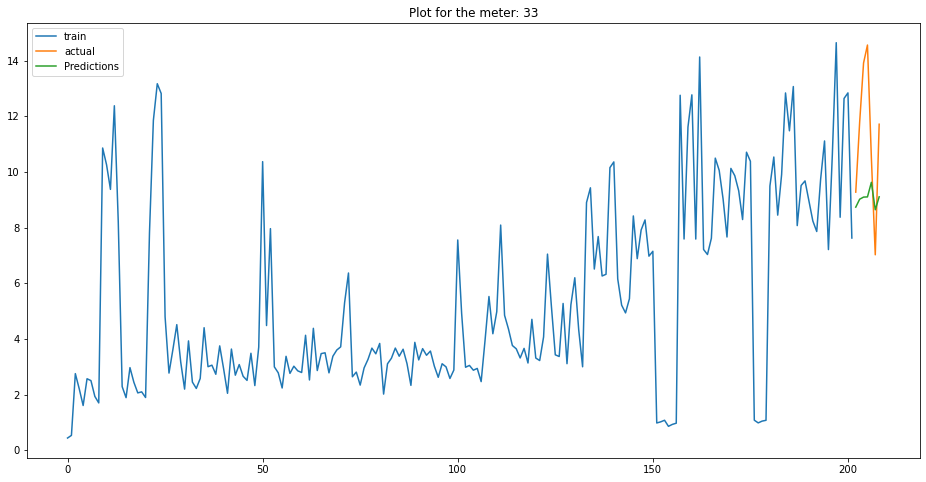

            ds       y
202 2021-07-22   9.272
203 2021-07-23  11.784
204 2021-07-24  13.913
205 2021-07-25  14.558
206 2021-07-26  10.515
207 2021-07-27   7.021
208 2021-07-28  11.712
            ds  Predictions
202 2021-07-22     8.732797
203 2021-07-23     9.018295
204 2021-07-24     9.094224
205 2021-07-25     9.100646
206 2021-07-26     9.625669
207 2021-07-27     8.638858
208 2021-07-28     9.103303
19.627048517354538


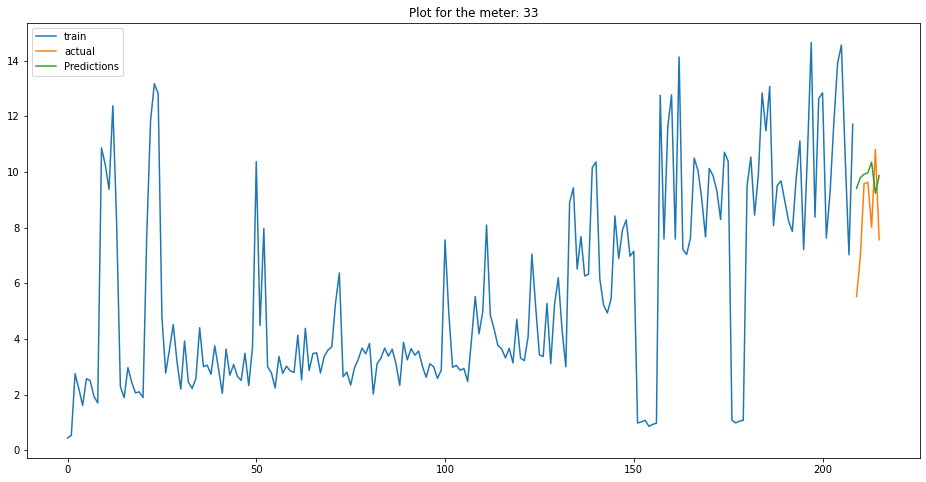

            ds       y
209 2021-07-29   5.512
210 2021-07-30   6.934
211 2021-07-31   9.571
212 2021-08-01   9.627
213 2021-08-02   8.012
214 2021-08-03  10.812
215 2021-08-04   7.561
            ds  Predictions
209 2021-07-29     9.406162
210 2021-07-30     9.787856
211 2021-07-31     9.915764
212 2021-08-01     9.967712
213 2021-08-02    10.346816
214 2021-08-03     9.234256
215 2021-08-04     9.869074
18.09205543591961
   mape_weekly  meterID    type
0       20.585       33  unflag
1       24.515       33  unflag
2       19.627       33  unflag
3       18.092       33  unflag


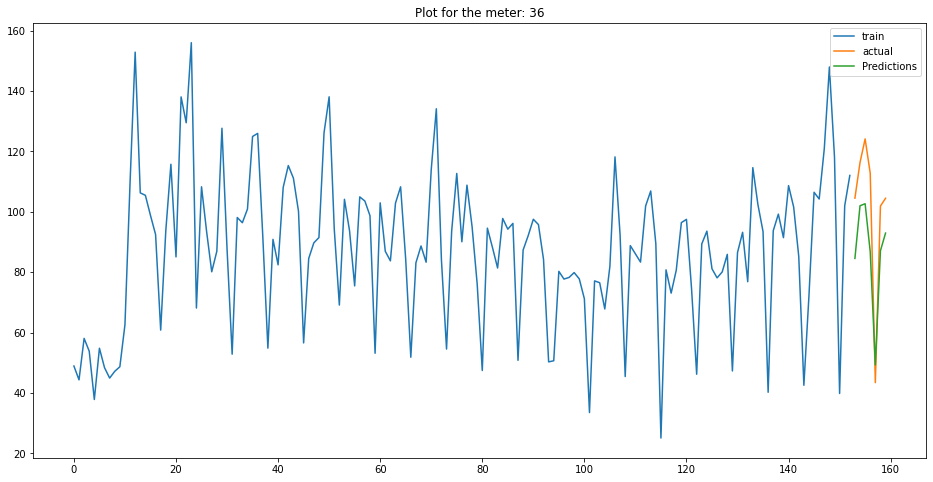

            ds        y
153 2021-06-03  104.510
154 2021-06-04  116.324
155 2021-06-05  124.120
156 2021-06-06  112.784
157 2021-06-07   43.404
158 2021-06-08  101.882
159 2021-06-09  104.464
            ds  Predictions
153 2021-06-03    84.551721
154 2021-06-04   101.988865
155 2021-06-05   102.654825
156 2021-06-06    86.720963
157 2021-06-07    49.270657
158 2021-06-08    87.102883
159 2021-06-09    92.929359
14.455188887018577


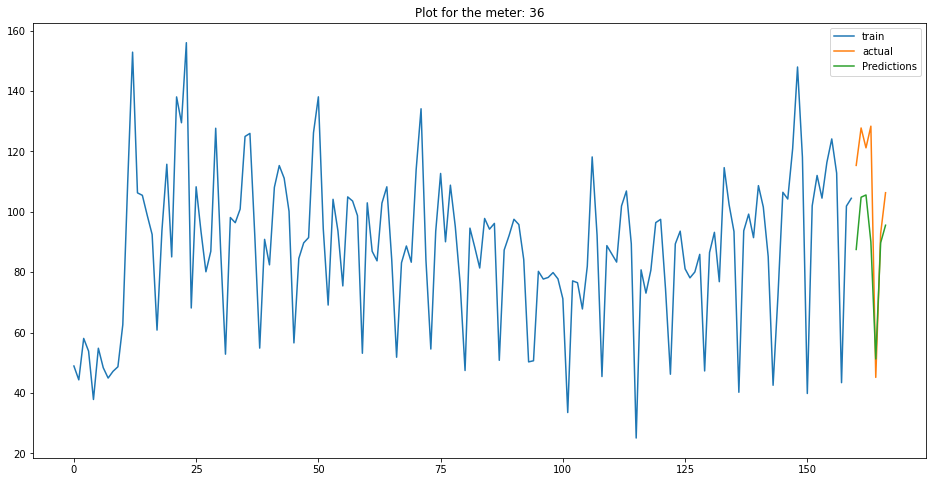

            ds        y
160 2021-06-10  115.352
161 2021-06-11  127.750
162 2021-06-12  121.170
163 2021-06-13  128.342
164 2021-06-14   45.148
165 2021-06-15   92.820
166 2021-06-16  106.312
            ds  Predictions
160 2021-06-10    87.511003
161 2021-06-11   104.819547
162 2021-06-12   105.560806
163 2021-06-13    90.018414
164 2021-06-14    51.259032
165 2021-06-15    89.744208
166 2021-06-16    95.538735
15.258945653295877


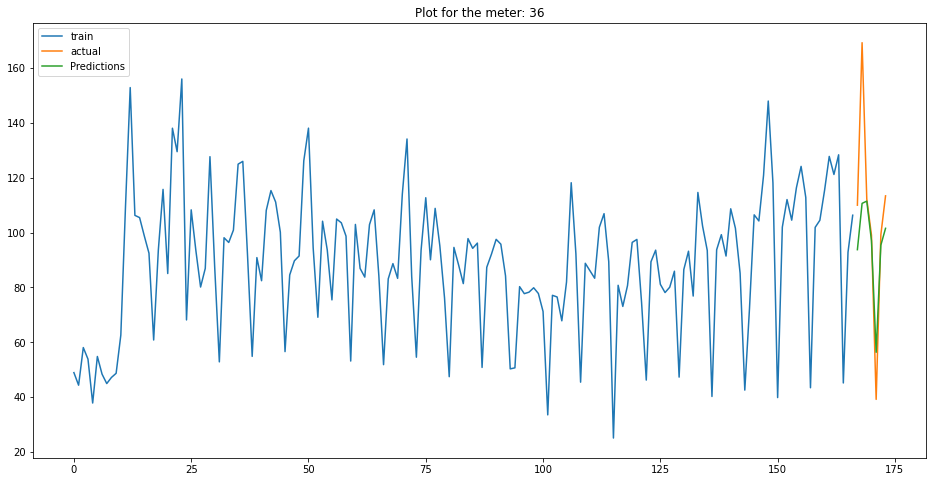

            ds        y
167 2021-06-17  109.972
168 2021-06-18  169.220
169 2021-06-19  112.226
170 2021-06-20   99.082
171 2021-06-21   39.166
172 2021-06-22   99.196
173 2021-06-23  113.376
            ds  Predictions
167 2021-06-17    93.749735
168 2021-06-18   110.635561
169 2021-06-19   111.451582
170 2021-06-20    96.999013
171 2021-06-21    56.336687
172 2021-06-22    95.397573
173 2021-06-23   101.534704
10.257241547304599


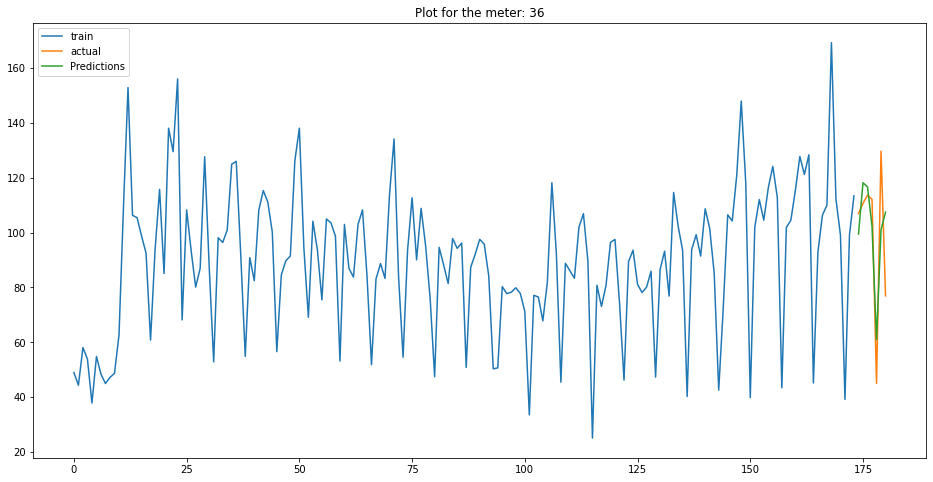

            ds        y
174 2021-06-24  106.942
175 2021-06-25  110.656
176 2021-06-26  113.576
177 2021-06-27  112.144
178 2021-06-28   44.976
179 2021-06-29  129.688
180 2021-06-30   76.906
            ds  Predictions
174 2021-06-24    99.440831
175 2021-06-25   118.153010
176 2021-06-26   116.654429
177 2021-06-27   102.286654
178 2021-06-28    60.918596
179 2021-06-29   100.952707
180 2021-06-30   107.436155
1.5764241496225362
   mape_weekly  meterID    type
0       14.455       36  unflag
1       15.259       36  unflag
2       10.257       36  unflag
3        1.576       36  unflag


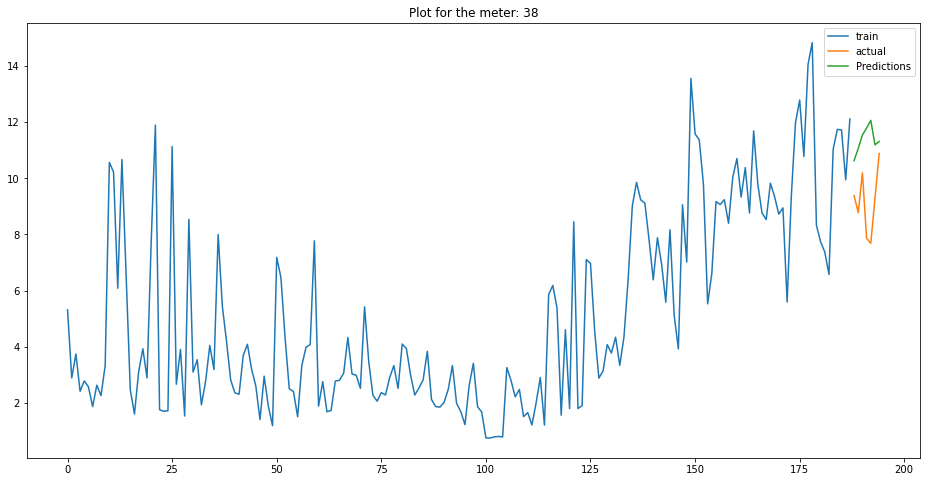

            ds       y
188 2021-07-08   9.384
189 2021-07-09   8.778
190 2021-07-10  10.196
191 2021-07-11   7.860
192 2021-07-12   7.686
193 2021-07-13   9.298
194 2021-07-14  10.883
            ds  Predictions
188 2021-07-08    10.628360
189 2021-07-09    11.068188
190 2021-07-10    11.543652
191 2021-07-11    11.789953
192 2021-07-12    12.064543
193 2021-07-13    11.194229
194 2021-07-14    11.313738
24.214189629265018


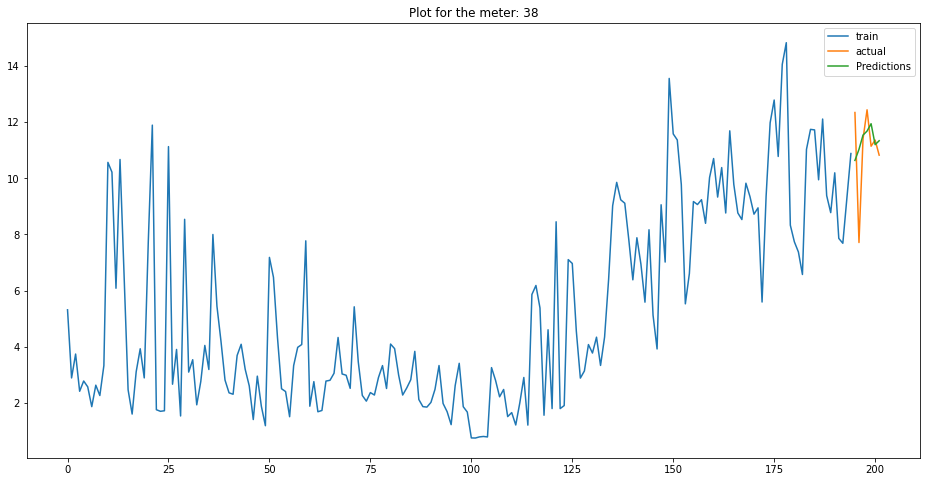

            ds       y
195 2021-07-15  12.344
196 2021-07-16   7.713
197 2021-07-17  11.400
198 2021-07-18  12.441
199 2021-07-19  11.144
200 2021-07-20  11.363
201 2021-07-21  10.826
            ds  Predictions
195 2021-07-15    10.638358
196 2021-07-16    11.032157
197 2021-07-17    11.539156
198 2021-07-18    11.683218
199 2021-07-19    11.945266
200 2021-07-20    11.199149
201 2021-07-21    11.338674
2.777354222122077


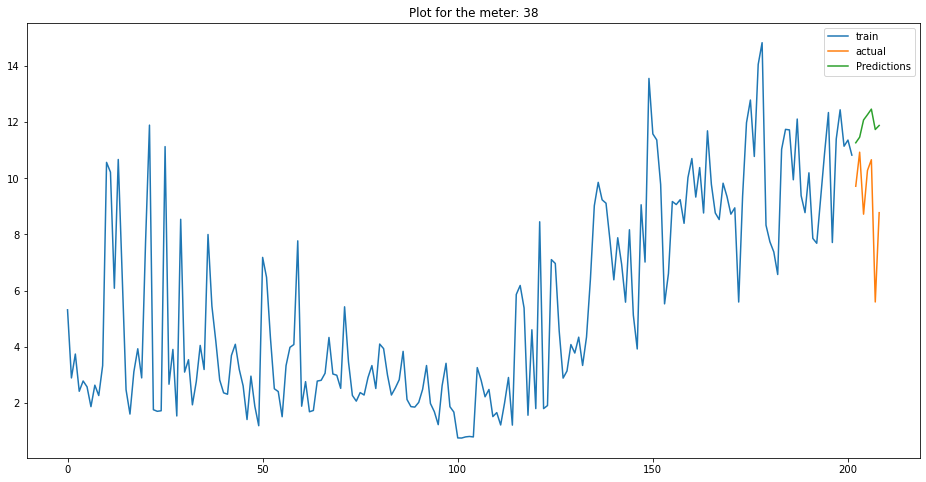

            ds       y
202 2021-07-22   9.718
203 2021-07-23  10.931
204 2021-07-24   8.723
205 2021-07-25  10.279
206 2021-07-26  10.662
207 2021-07-27   5.595
208 2021-07-28   8.776
            ds  Predictions
202 2021-07-22    11.266363
203 2021-07-23    11.466074
204 2021-07-24    12.078657
205 2021-07-25    12.266403
206 2021-07-26    12.465103
207 2021-07-27    11.739516
208 2021-07-28    11.882421
28.570490611654005


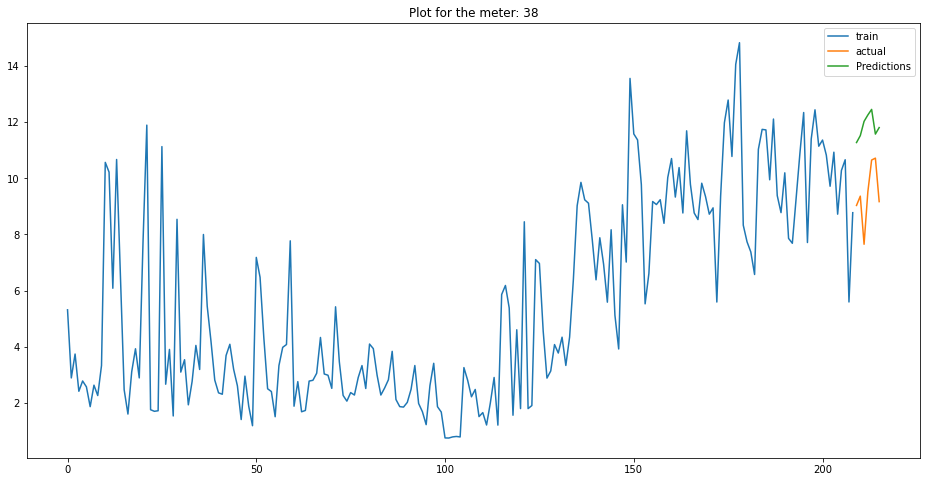

            ds       y
209 2021-07-29   9.034
210 2021-07-30   9.365
211 2021-07-31   7.651
212 2021-08-01   9.517
213 2021-08-02  10.652
214 2021-08-03  10.719
215 2021-08-04   9.170
            ds  Predictions
209 2021-07-29    11.274721
210 2021-07-30    11.520378
211 2021-07-31    12.028888
212 2021-08-01    12.255695
213 2021-08-02    12.455585
214 2021-08-03    11.575617
215 2021-08-04    11.807395
25.428510058227584
   mape_weekly  meterID    type
0       24.214       38  unflag
1        2.777       38  unflag
2       28.570       38  unflag
3       25.429       38  unflag


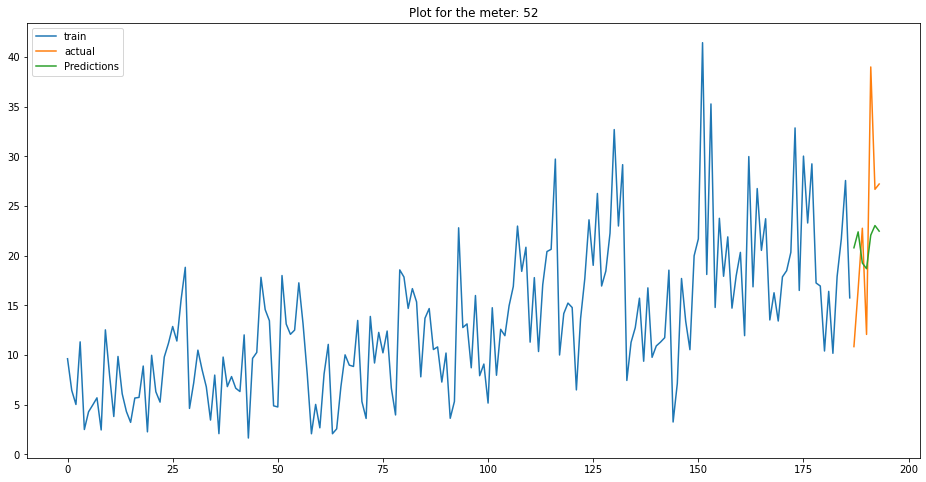

            ds       y
187 2021-07-07  10.840
188 2021-07-08  16.604
189 2021-07-09  22.752
190 2021-07-10  12.066
191 2021-07-11  38.984
192 2021-07-12  26.668
193 2021-07-13  27.204
            ds  Predictions
187 2021-07-07    20.786448
188 2021-07-08    22.389498
189 2021-07-09    19.251601
190 2021-07-10    18.681085
191 2021-07-11    22.057871
192 2021-07-12    23.025160
193 2021-07-13    22.459234
4.169150986287906


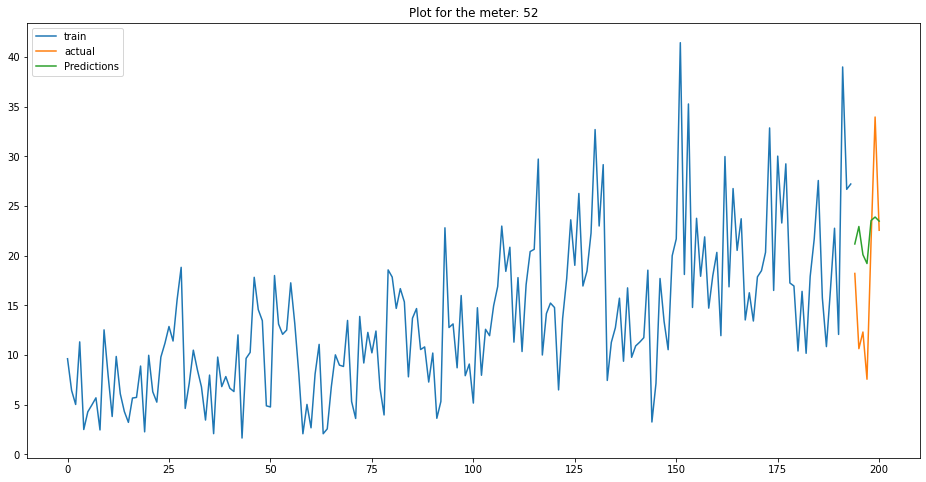

            ds       y
194 2021-07-14  18.204
195 2021-07-15  10.634
196 2021-07-16  12.310
197 2021-07-17   7.558
198 2021-07-18  21.389
199 2021-07-19  33.947
200 2021-07-20  22.548
            ds  Predictions
194 2021-07-14    21.169714
195 2021-07-15    22.928286
196 2021-07-16    20.089360
197 2021-07-17    19.202047
198 2021-07-18    23.526839
199 2021-07-19    23.880988
200 2021-07-20    23.469139
21.863000957091447


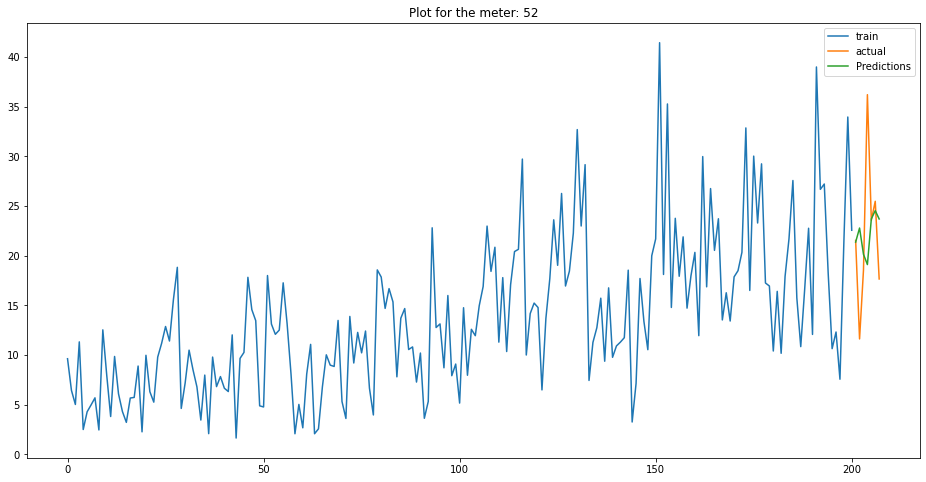

            ds       y
201 2021-07-21  21.522
202 2021-07-22  11.613
203 2021-07-23  18.549
204 2021-07-24  36.196
205 2021-07-25  23.556
206 2021-07-26  25.466
207 2021-07-27  17.649
            ds  Predictions
201 2021-07-21    21.359663
202 2021-07-22    22.775506
203 2021-07-23    20.127780
204 2021-07-24    19.096291
205 2021-07-25    23.694301
206 2021-07-26    24.521943
207 2021-07-27    23.686086
0.459763829002496


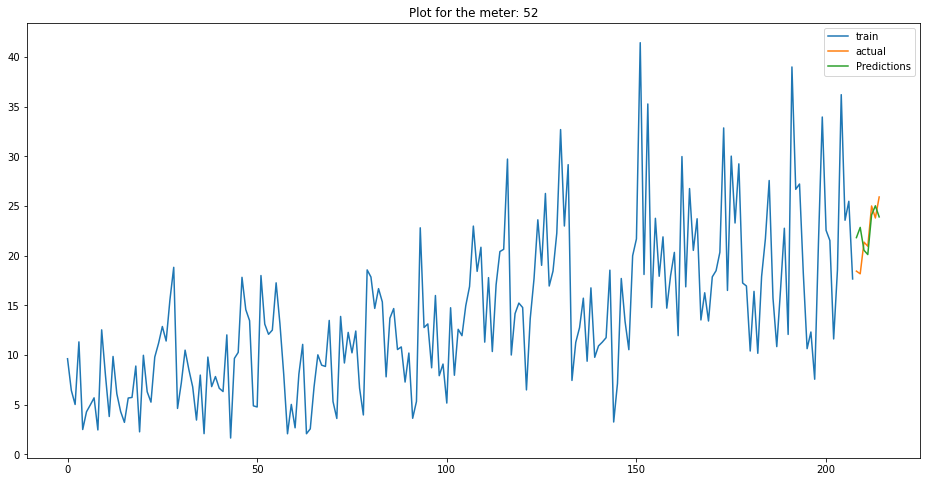

            ds       y
208 2021-07-28  18.436
209 2021-07-29  18.167
210 2021-07-30  21.356
211 2021-07-31  20.942
212 2021-08-01  24.994
213 2021-08-02  23.786
214 2021-08-03  25.898
            ds  Predictions
208 2021-07-28    21.808616
209 2021-07-29    22.836758
210 2021-07-30    20.535113
211 2021-07-31    20.106024
212 2021-08-01    24.095672
213 2021-08-02    25.013510
214 2021-08-03    23.894692
3.06772678891431
   mape_weekly  meterID    type
0        4.169       52  unflag
1       21.863       52  unflag
2        0.460       52  unflag
3        3.068       52  unflag


In [888]:
for i in TOU_list_above365:
    account_and_days_billcycle_new(i,'shoulder')

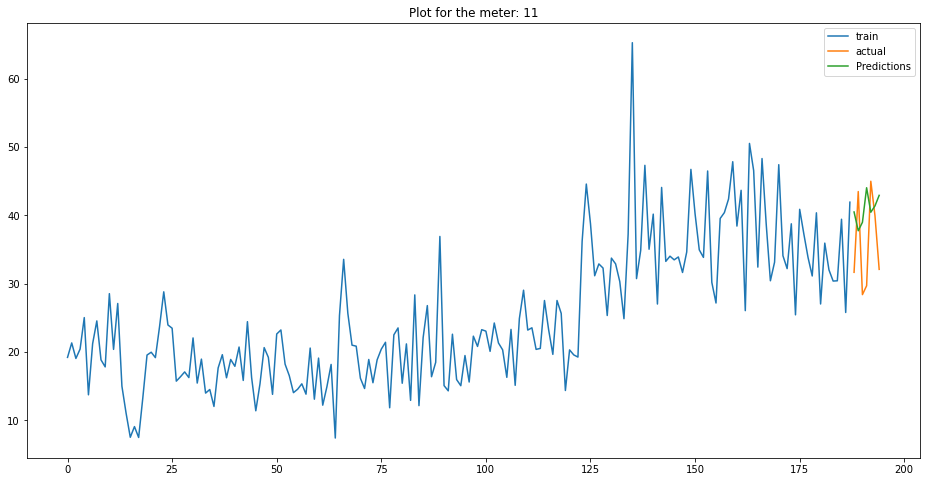

            ds       y
188 2021-07-08  31.663
189 2021-07-09  43.481
190 2021-07-10  28.400
191 2021-07-11  29.698
192 2021-07-12  44.989
193 2021-07-13  39.941
194 2021-07-14  32.097
            ds  Predictions
188 2021-07-08    40.494986
189 2021-07-09    37.744495
190 2021-07-10    38.982217
191 2021-07-11    44.039433
192 2021-07-12    40.453920
193 2021-07-13    41.383675
194 2021-07-14    42.925116
14.286564485940156


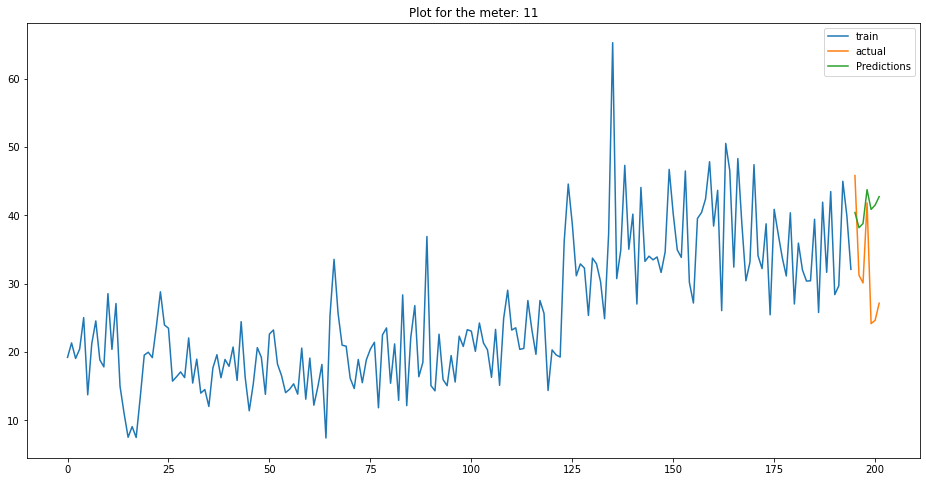

            ds       y
195 2021-07-15  45.820
196 2021-07-16  31.237
197 2021-07-17  30.108
198 2021-07-18  41.821
199 2021-07-19  24.158
200 2021-07-20  24.641
201 2021-07-21  27.141
            ds  Predictions
195 2021-07-15    40.418743
196 2021-07-16    38.194677
197 2021-07-17    38.801918
198 2021-07-18    43.760442
199 2021-07-19    40.873428
200 2021-07-20    41.507022
201 2021-07-21    42.740303
27.284765961002567


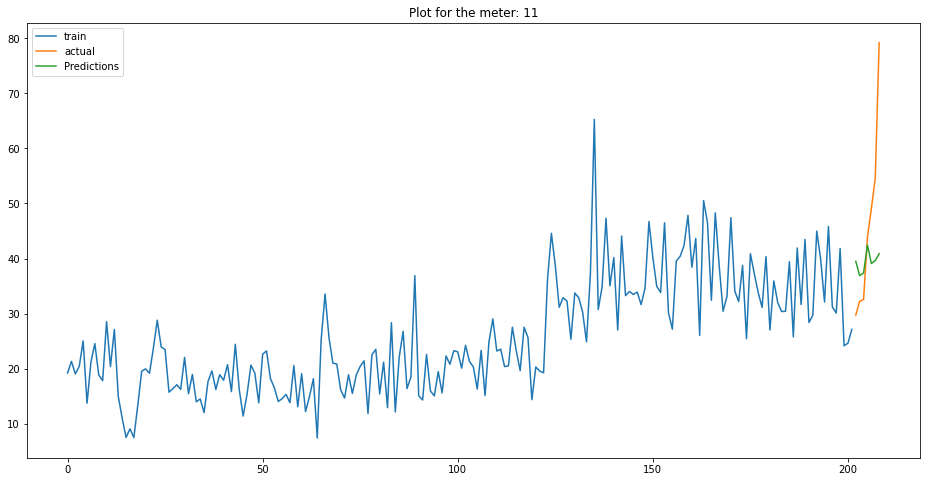

            ds       y
202 2021-07-22  29.735
203 2021-07-23  32.264
204 2021-07-24  32.540
205 2021-07-25  43.889
206 2021-07-26  49.072
207 2021-07-27  54.641
208 2021-07-28  79.195
            ds  Predictions
202 2021-07-22    39.505616
203 2021-07-23    36.906555
204 2021-07-24    37.382169
205 2021-07-25    42.458517
206 2021-07-26    39.110091
207 2021-07-27    39.634479
208 2021-07-28    40.885701
14.144967225601407


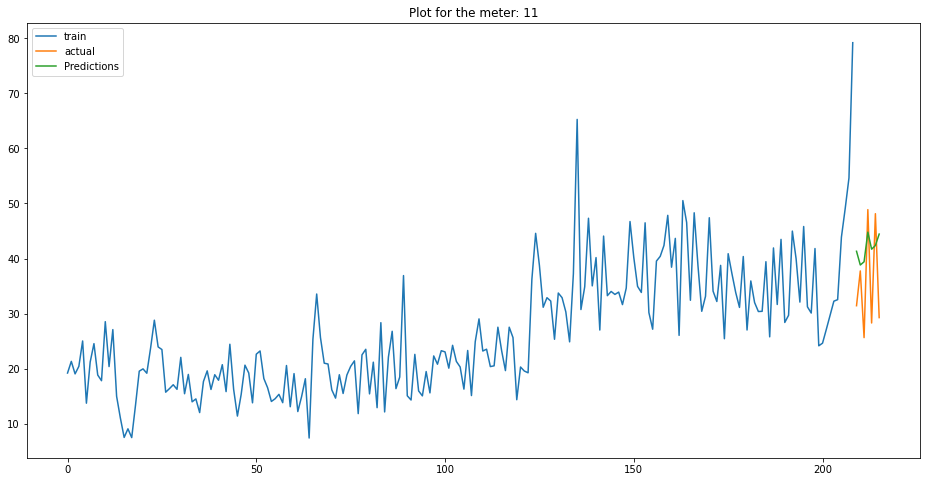

            ds       y
209 2021-07-29  31.440
210 2021-07-30  37.756
211 2021-07-31  25.645
212 2021-08-01  48.886
213 2021-08-02  28.304
214 2021-08-03  48.148
215 2021-08-04  29.280
            ds  Predictions
209 2021-07-29    41.323163
210 2021-07-30    38.832400
211 2021-07-31    39.417015
212 2021-08-01    44.795122
213 2021-08-02    41.702685
214 2021-08-03    42.373192
215 2021-08-04    44.443526
17.4089146832829
   mape_weekly  meterID    type
0       14.287       11  unflag
1       27.285       11  unflag
2       14.145       11  unflag
3       17.409       11  unflag


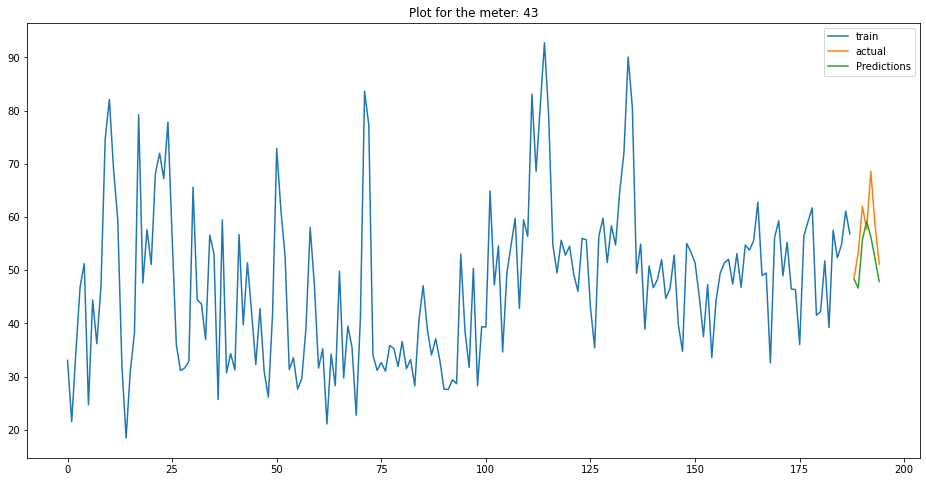

            ds       y
188 2021-07-08  48.530
189 2021-07-09  53.286
190 2021-07-10  62.030
191 2021-07-11  57.619
192 2021-07-12  68.623
193 2021-07-13  58.613
194 2021-07-14  51.144
            ds  Predictions
188 2021-07-08    48.283758
189 2021-07-09    46.630285
190 2021-07-10    55.721589
191 2021-07-11    59.223246
192 2021-07-12    56.300621
193 2021-07-13    52.206631
194 2021-07-14    47.879190
8.40317653087289


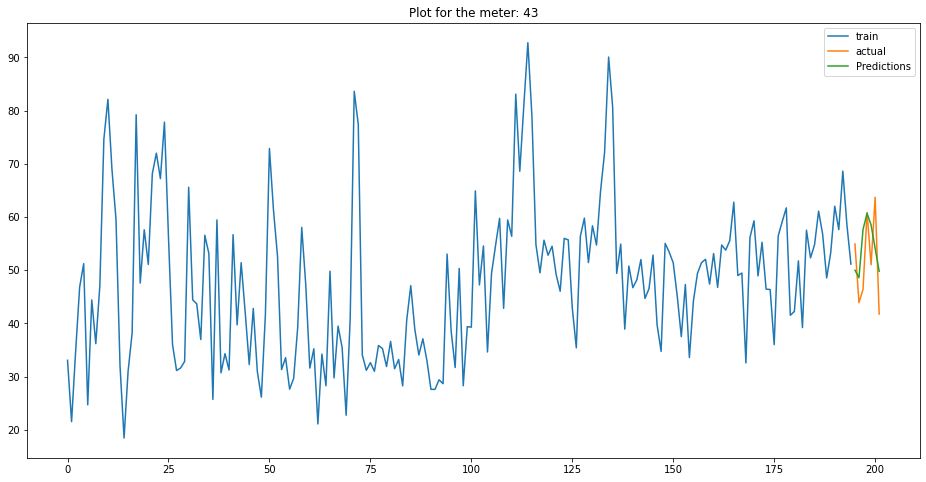

            ds       y
195 2021-07-15  54.931
196 2021-07-16  43.884
197 2021-07-17  46.399
198 2021-07-18  60.843
199 2021-07-19  51.019
200 2021-07-20  63.713
201 2021-07-21  41.751
            ds  Predictions
195 2021-07-15    49.998579
196 2021-07-16    48.587026
197 2021-07-17    57.640072
198 2021-07-18    60.698061
199 2021-07-19    58.492848
200 2021-07-20    54.132649
201 2021-07-21    49.784307
4.632189952931247


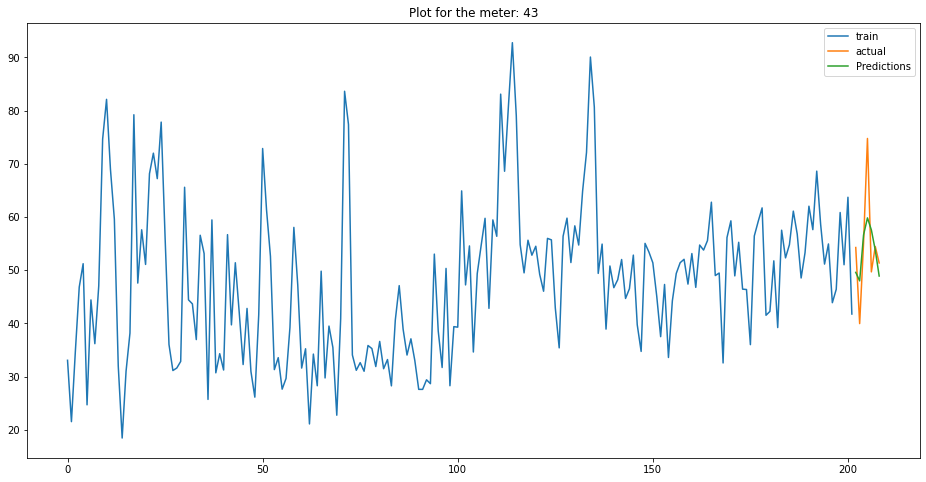

            ds       y
202 2021-07-22  54.260
203 2021-07-23  39.953
204 2021-07-24  55.106
205 2021-07-25  74.768
206 2021-07-26  49.680
207 2021-07-27  54.449
208 2021-07-28  51.360
            ds  Predictions
202 2021-07-22    49.584774
203 2021-07-23    47.986100
204 2021-07-24    56.624680
205 2021-07-25    59.833426
206 2021-07-26    57.564396
207 2021-07-27    53.780294
208 2021-07-28    48.900114
1.3968787692697073


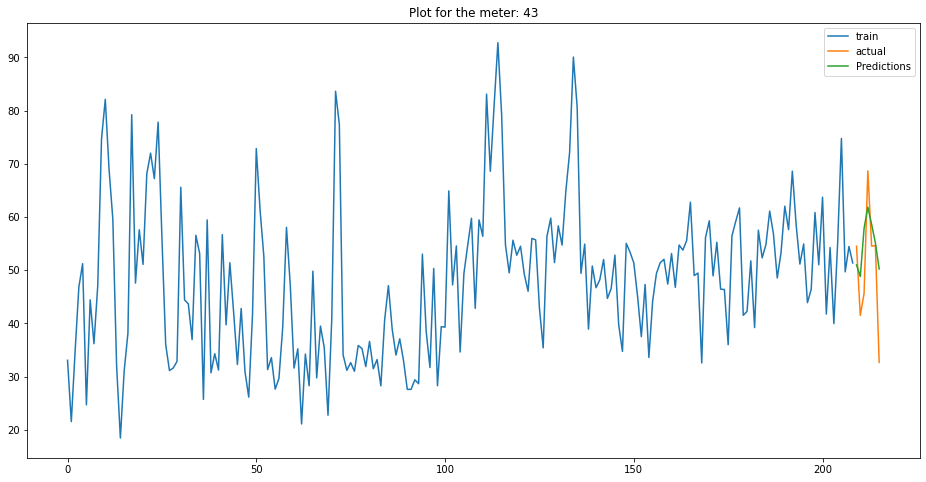

            ds       y
209 2021-07-29  54.515
210 2021-07-30  41.494
211 2021-07-31  45.619
212 2021-08-01  68.684
213 2021-08-02  54.523
214 2021-08-03  54.630
215 2021-08-04  32.670
            ds  Predictions
209 2021-07-29    50.991274
210 2021-07-30    48.807424
211 2021-07-31    57.852240
212 2021-08-01    61.854289
213 2021-08-02    58.601287
214 2021-08-03    55.138453
215 2021-08-04    50.234446
8.901248909401142
   mape_weekly  meterID    type
0        8.403       43  unflag
1        4.632       43  unflag
2        1.397       43  unflag
3        8.901       43  unflag


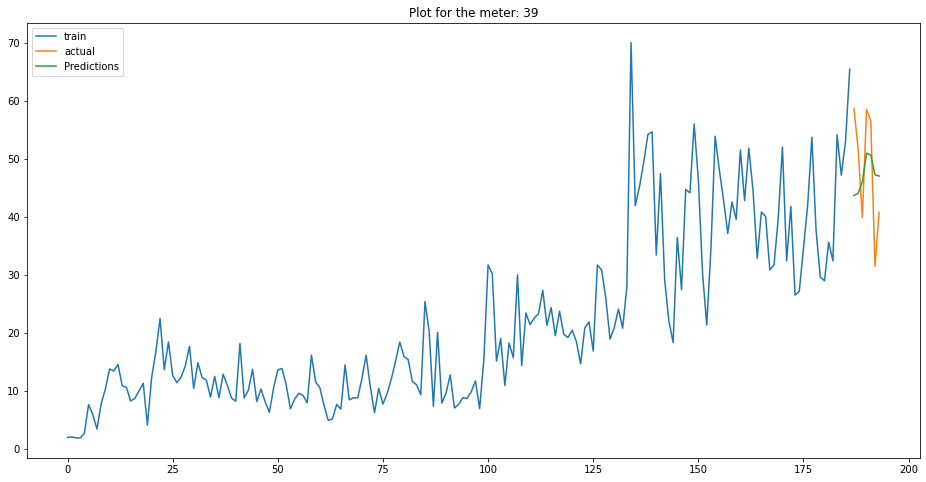

            ds       y
187 2021-07-07  58.674
188 2021-07-08  51.779
189 2021-07-09  39.930
190 2021-07-10  58.569
191 2021-07-11  56.639
192 2021-07-12  31.501
193 2021-07-13  40.812
            ds  Predictions
187 2021-07-07    43.713964
188 2021-07-08    44.102014
189 2021-07-09    46.070356
190 2021-07-10    51.012357
191 2021-07-11    50.707267
192 2021-07-12    47.296570
193 2021-07-13    47.080776
2.3440666263760264


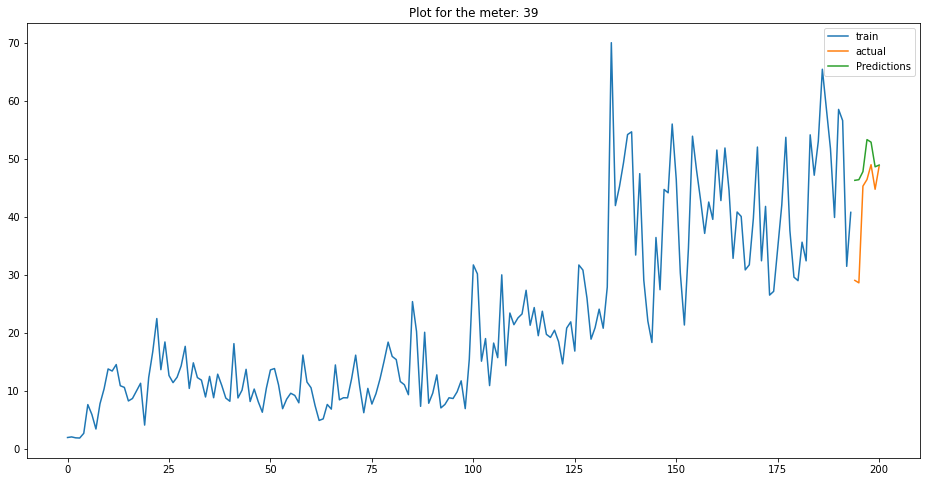

            ds       y
194 2021-07-14  29.082
195 2021-07-15  28.655
196 2021-07-16  45.336
197 2021-07-17  46.477
198 2021-07-18  49.031
199 2021-07-19  44.792
200 2021-07-20  48.803
            ds  Predictions
194 2021-07-14    46.334807
195 2021-07-15    46.447413
196 2021-07-16    47.835871
197 2021-07-17    53.361684
198 2021-07-18    52.917792
199 2021-07-19    48.668494
200 2021-07-20    48.973649
17.921975100362705


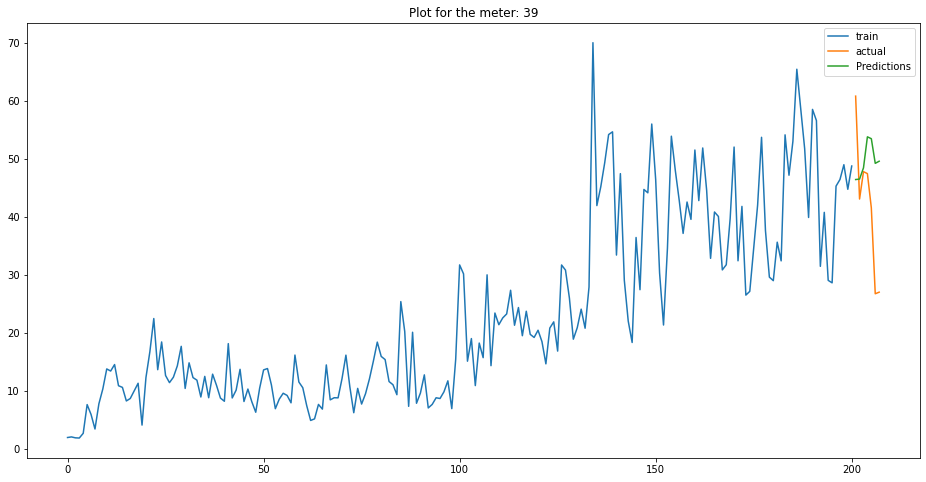

            ds       y
201 2021-07-21  60.857
202 2021-07-22  43.112
203 2021-07-23  47.831
204 2021-07-24  47.493
205 2021-07-25  41.593
206 2021-07-26  26.773
207 2021-07-27  27.047
            ds  Predictions
201 2021-07-21    46.471614
202 2021-07-22    46.552641
203 2021-07-23    48.485902
204 2021-07-24    53.839784
205 2021-07-25    53.514836
206 2021-07-26    49.266961
207 2021-07-27    49.632722
18.00386149874828


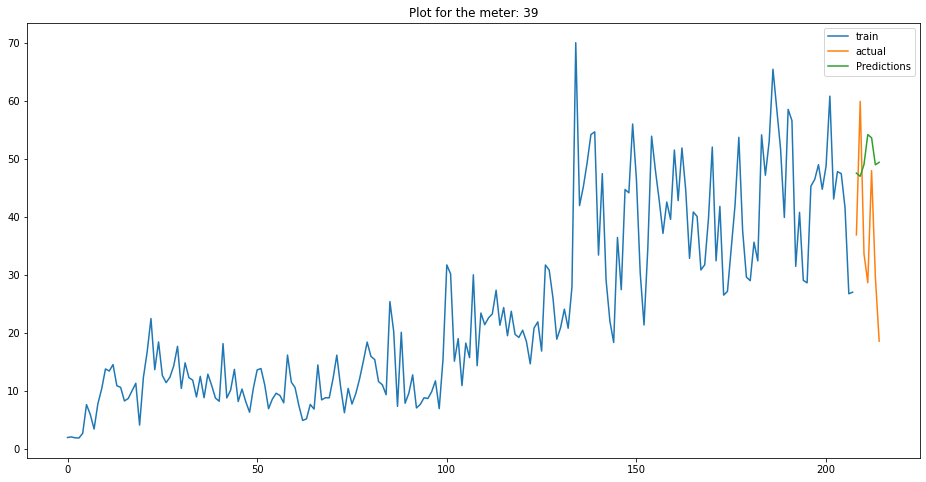

            ds       y
208 2021-07-28  36.922
209 2021-07-29  59.948
210 2021-07-30  33.650
211 2021-07-31  28.682
212 2021-08-01  48.006
213 2021-08-02  29.661
214 2021-08-03  18.595
            ds  Predictions
208 2021-07-28    47.579655
209 2021-07-29    47.031327
210 2021-07-30    49.075899
211 2021-07-31    54.224887
212 2021-08-01    53.671063
213 2021-08-02    49.017164
214 2021-08-03    49.442053
37.02206504152862
   mape_weekly  meterID    type
0        2.344       39  unflag
1       17.922       39  unflag
2       18.004       39  unflag
3       37.022       39  unflag


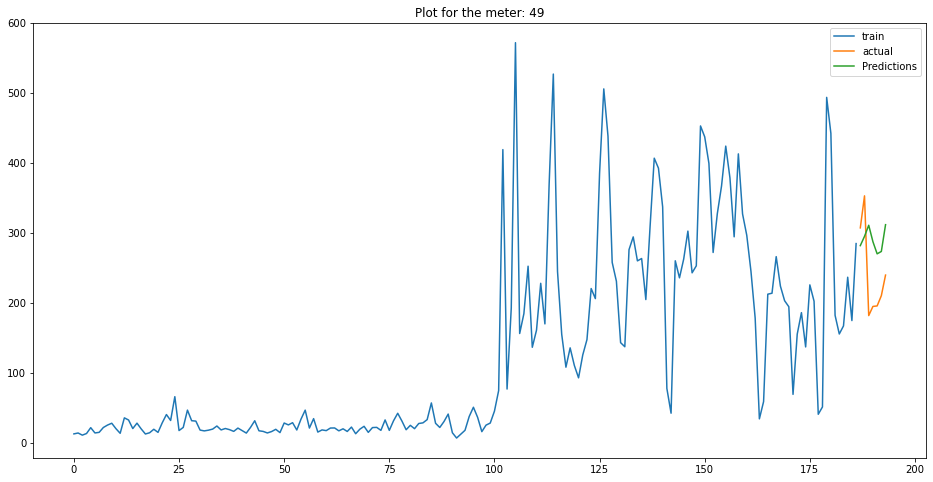

            ds        y
187 2021-07-07  307.462
188 2021-07-08  353.225
189 2021-07-09  182.097
190 2021-07-10  195.202
191 2021-07-11  195.874
192 2021-07-12  210.547
193 2021-07-13  239.990
            ds  Predictions
187 2021-07-07   282.081318
188 2021-07-08   295.370342
189 2021-07-09   311.197252
190 2021-07-10   287.681155
191 2021-07-11   270.350837
192 2021-07-12   273.739612
193 2021-07-13   312.022986
20.662973262593088


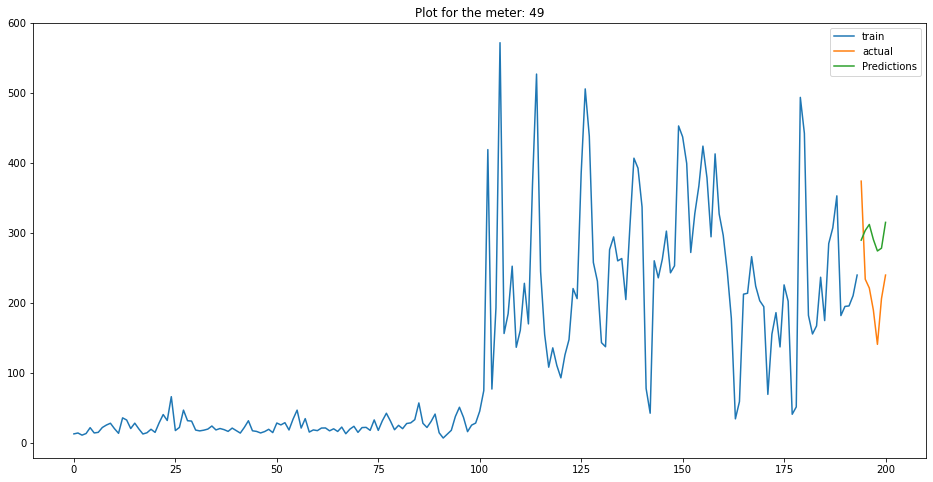

            ds        y
194 2021-07-14  374.224
195 2021-07-15  234.057
196 2021-07-16  221.467
197 2021-07-17  189.950
198 2021-07-18  140.982
199 2021-07-19  206.424
200 2021-07-20  239.987
            ds  Predictions
194 2021-07-14   289.909807
195 2021-07-15   303.785764
196 2021-07-16   312.304226
197 2021-07-17   290.833332
198 2021-07-18   274.437600
199 2021-07-19   278.413367
200 2021-07-20   315.308651
28.49258371556351


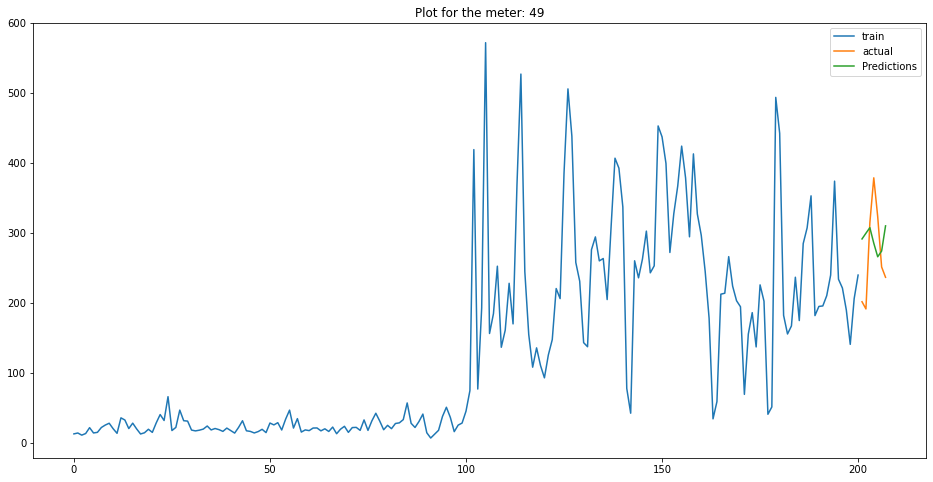

            ds        y
201 2021-07-21  201.877
202 2021-07-22  191.599
203 2021-07-23  314.680
204 2021-07-24  378.978
205 2021-07-25  323.550
206 2021-07-26  251.599
207 2021-07-27  236.804
            ds  Predictions
201 2021-07-21   291.641045
202 2021-07-22   299.791621
203 2021-07-23   307.739657
204 2021-07-24   285.535747
205 2021-07-25   266.142584
206 2021-07-26   274.320692
207 2021-07-27   310.325115
7.182896850103482


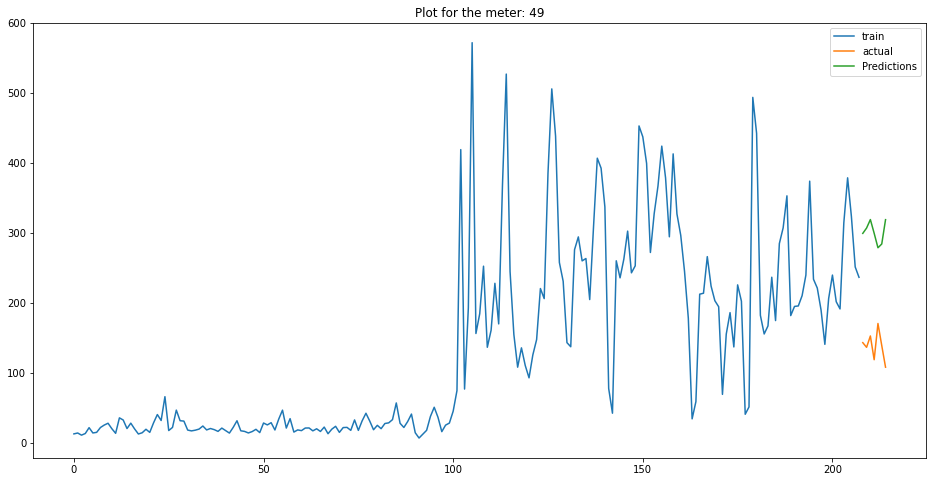

            ds        y
208 2021-07-28  143.401
209 2021-07-29  136.720
210 2021-07-30  152.956
211 2021-07-31  119.041
212 2021-08-01  170.787
213 2021-08-02  139.321
214 2021-08-03  108.318
            ds  Predictions
208 2021-07-28   299.586329
209 2021-07-29   307.210346
210 2021-07-30   319.324980
211 2021-07-31   299.709033
212 2021-08-01   279.025920
213 2021-08-02   284.405780
214 2021-08-03   319.185534
117.2439293299964
   mape_weekly  meterID    type
0       20.663       49  unflag
1       28.493       49  unflag
2        7.183       49  unflag
3      117.244       49    flag


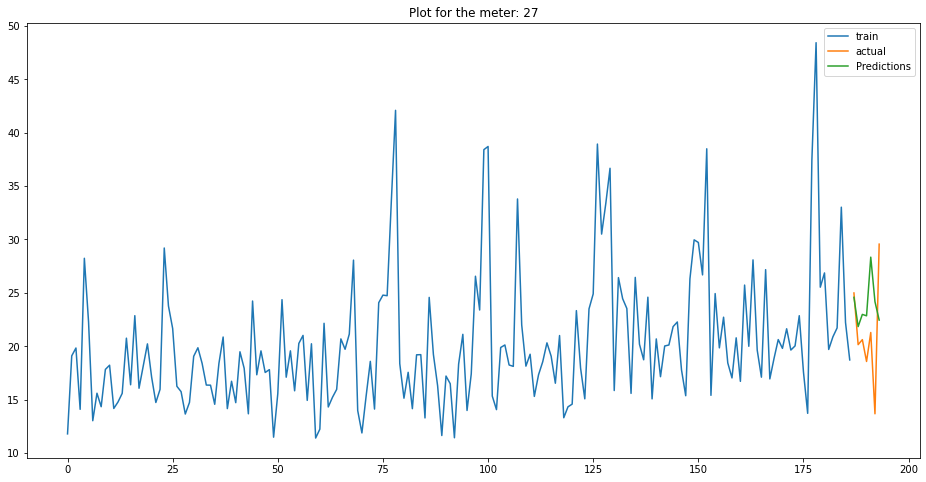

            ds       y
187 2021-07-07  24.990
188 2021-07-08  20.151
189 2021-07-09  20.619
190 2021-07-10  18.576
191 2021-07-11  21.289
192 2021-07-12  13.677
193 2021-07-13  29.562
            ds  Predictions
187 2021-07-07    24.581170
188 2021-07-08    21.841460
189 2021-07-09    22.983723
190 2021-07-10    22.852919
191 2021-07-11    28.345060
192 2021-07-12    24.175901
193 2021-07-13    22.452191
12.3390640501597


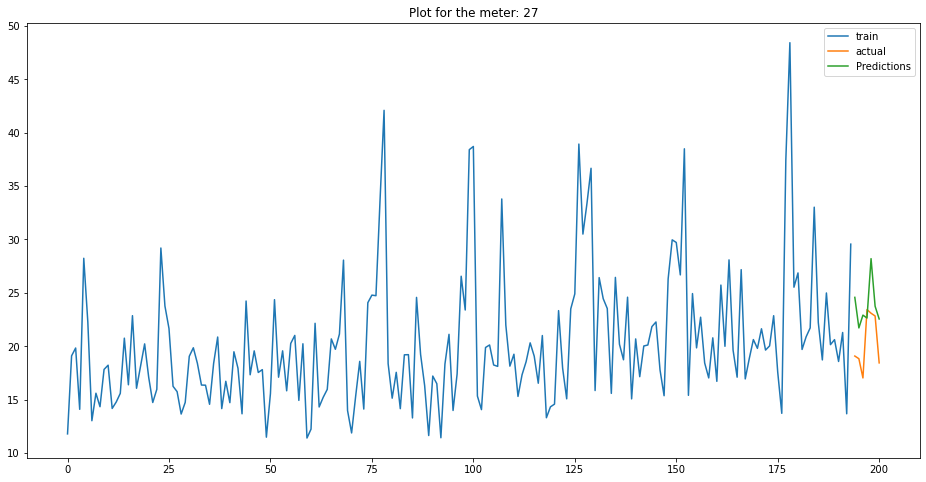

            ds       y
194 2021-07-14  19.084
195 2021-07-15  18.835
196 2021-07-16  17.033
197 2021-07-17  23.432
198 2021-07-18  23.092
199 2021-07-19  22.835
200 2021-07-20  18.443
            ds  Predictions
194 2021-07-14    24.578933
195 2021-07-15    21.716409
196 2021-07-16    22.915002
197 2021-07-17    22.643607
198 2021-07-18    28.204565
199 2021-07-19    23.744949
200 2021-07-20    22.555868
16.535671607689107


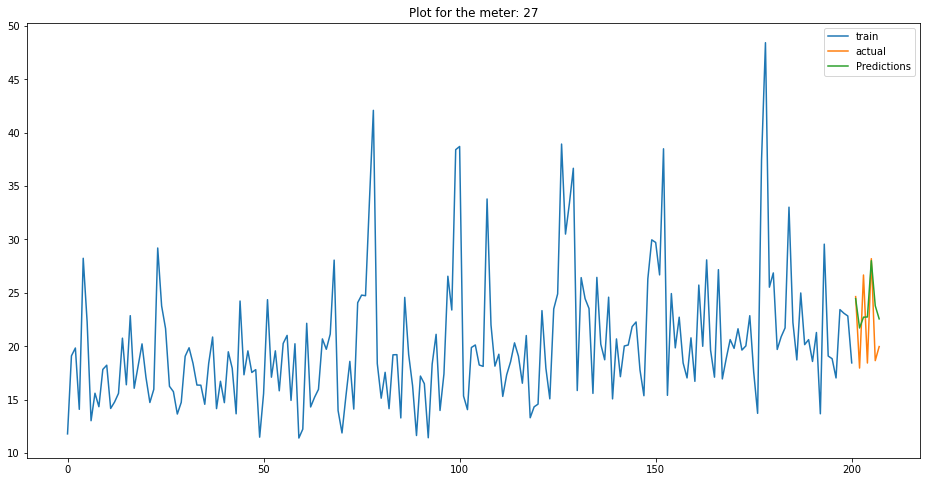

            ds       y
201 2021-07-21  24.648
202 2021-07-22  17.958
203 2021-07-23  26.674
204 2021-07-24  18.430
205 2021-07-25  28.201
206 2021-07-26  18.655
207 2021-07-27  19.971
            ds  Predictions
201 2021-07-21    24.455301
202 2021-07-22    21.710964
203 2021-07-23    22.722626
204 2021-07-24    22.742829
205 2021-07-25    28.012337
206 2021-07-26    23.794717
207 2021-07-27    22.564183
7.419554435155734


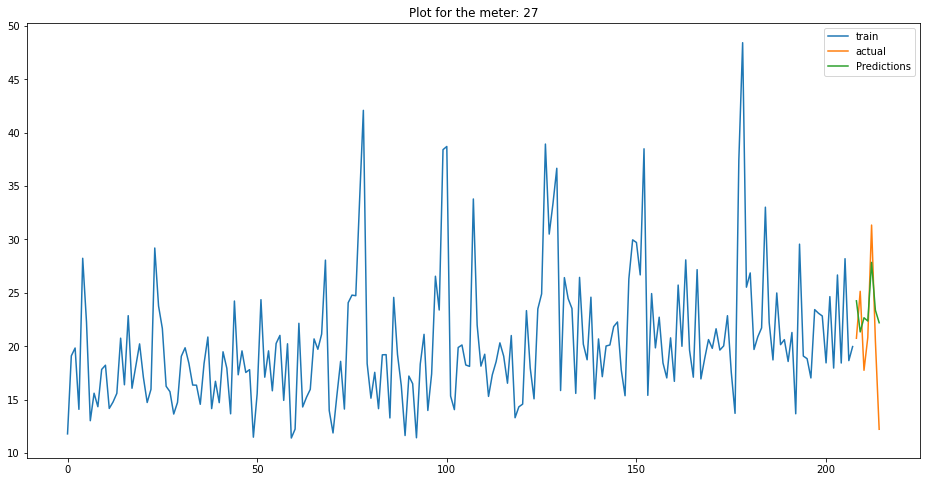

            ds       y
208 2021-07-28  20.749
209 2021-07-29  25.146
210 2021-07-30  17.749
211 2021-07-31  20.819
212 2021-08-01  31.350
213 2021-08-02  20.528
214 2021-08-03  12.226
            ds  Predictions
208 2021-07-28    24.255908
209 2021-07-29    21.343355
210 2021-07-30    22.669205
211 2021-07-31    22.365375
212 2021-08-01    27.854782
213 2021-08-02    23.383054
214 2021-08-03    22.202104
10.437569965109947
   mape_weekly  meterID    type
0       12.339       27  unflag
1       16.536       27  unflag
2        7.420       27  unflag
3       10.438       27  unflag


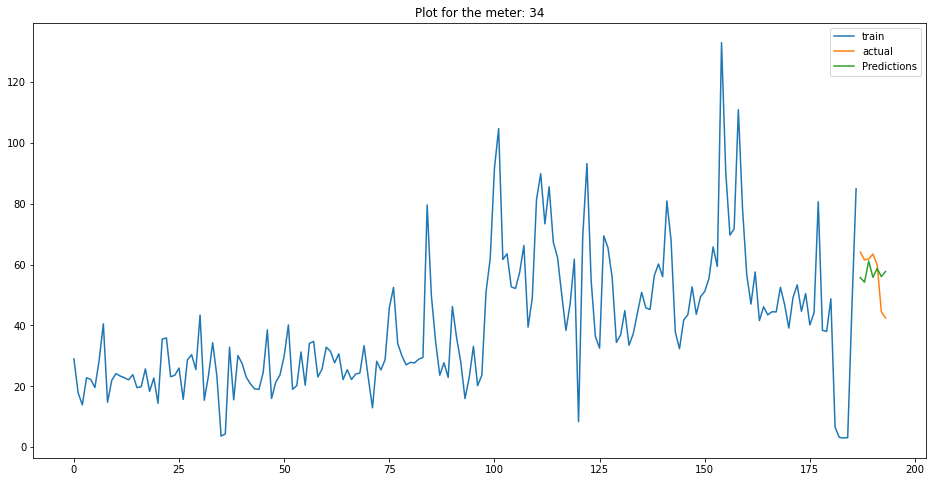

            ds       y
187 2021-07-07  64.095
188 2021-07-08  61.549
189 2021-07-09  61.837
190 2021-07-10  63.471
191 2021-07-11  60.015
192 2021-07-12  44.562
193 2021-07-13  42.468
            ds  Predictions
187 2021-07-07    55.720122
188 2021-07-08    54.201033
189 2021-07-09    61.170454
190 2021-07-10    55.809328
191 2021-07-11    58.751330
192 2021-07-12    56.054285
193 2021-07-13    57.757071
0.3685009234448658


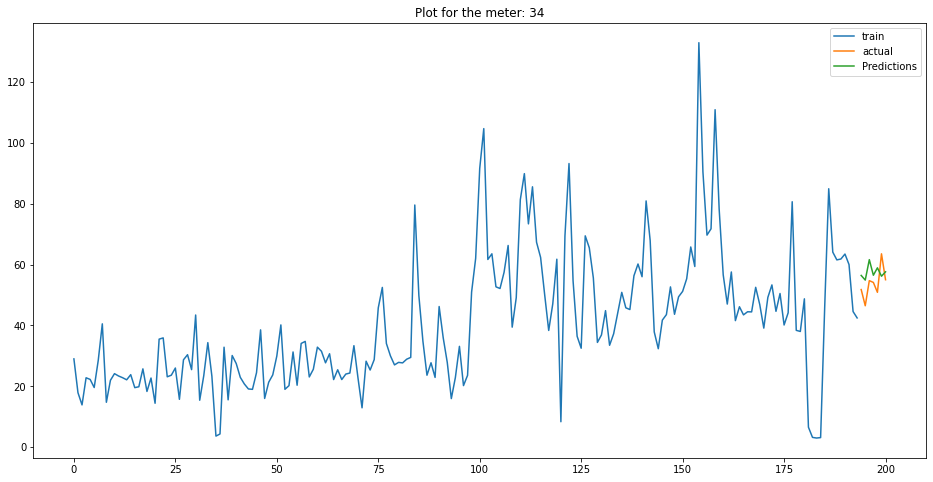

            ds       y
194 2021-07-14  51.796
195 2021-07-15  46.470
196 2021-07-16  54.728
197 2021-07-17  54.136
198 2021-07-18  50.886
199 2021-07-19  63.548
200 2021-07-20  55.028
            ds  Predictions
194 2021-07-14    56.435457
195 2021-07-15    54.914032
196 2021-07-16    61.626419
197 2021-07-17    56.505132
198 2021-07-18    58.934447
199 2021-07-19    56.181336
200 2021-07-20    57.624148
6.805500678462571


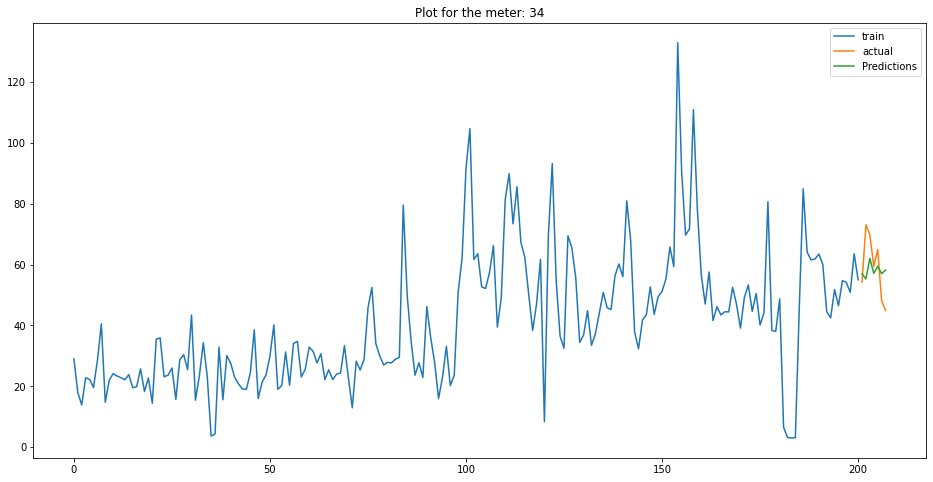

            ds       y
201 2021-07-21  54.233
202 2021-07-22  73.107
203 2021-07-23  69.751
204 2021-07-24  59.397
205 2021-07-25  64.971
206 2021-07-26  48.147
207 2021-07-27  44.899
            ds  Predictions
201 2021-07-21    56.971936
202 2021-07-22    55.303334
203 2021-07-23    62.052499
204 2021-07-24    57.103226
205 2021-07-25    59.431062
206 2021-07-26    57.033110
207 2021-07-27    58.196641
2.0296962946894705


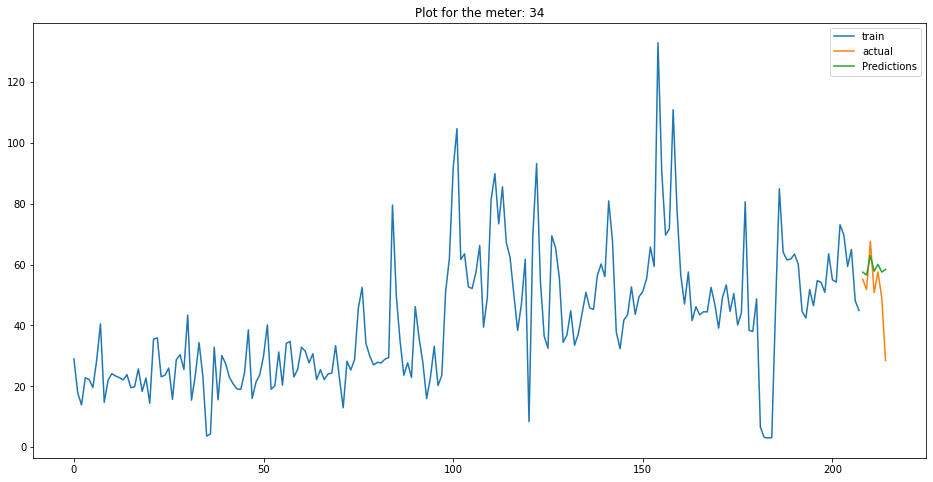

            ds       y
208 2021-07-28  55.155
209 2021-07-29  51.807
210 2021-07-30  67.619
211 2021-07-31  50.805
212 2021-08-01  57.644
213 2021-08-02  49.106
214 2021-08-03  28.482
            ds  Predictions
208 2021-07-28    57.518493
209 2021-07-29    56.567473
210 2021-07-30    62.988007
211 2021-07-31    57.800085
212 2021-08-01    60.077057
213 2021-08-02    57.550003
214 2021-08-03    58.383528
13.939028743678039
   mape_weekly  meterID    type
0        0.369       34  unflag
1        6.806       34  unflag
2        2.030       34  unflag
3       13.939       34  unflag


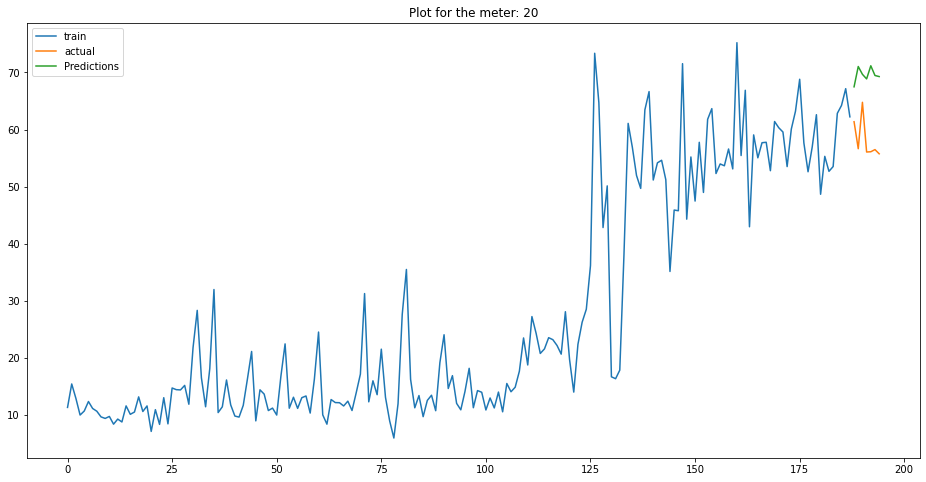

            ds       y
188 2021-07-08  61.377
189 2021-07-09  56.647
190 2021-07-10  64.777
191 2021-07-11  56.073
192 2021-07-12  56.117
193 2021-07-13  56.495
194 2021-07-14  55.757
            ds  Predictions
188 2021-07-08    67.491356
189 2021-07-09    71.049206
190 2021-07-10    69.679846
191 2021-07-11    68.876279
192 2021-07-12    71.176618
193 2021-07-13    69.473396
194 2021-07-14    69.286922
19.59287760227514


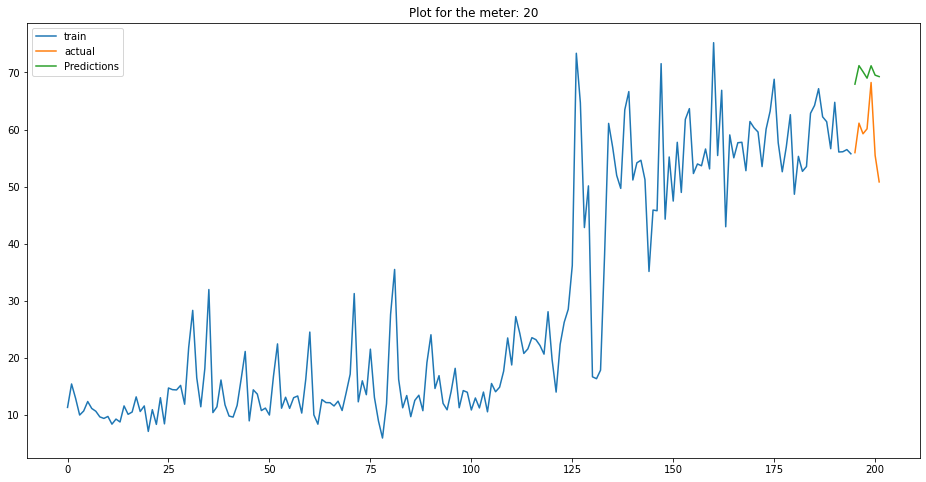

            ds       y
195 2021-07-15  55.963
196 2021-07-16  61.124
197 2021-07-17  59.261
198 2021-07-18  60.132
199 2021-07-19  68.246
200 2021-07-20  55.479
201 2021-07-21  50.834
            ds  Predictions
195 2021-07-15    67.958026
196 2021-07-16    71.201140
197 2021-07-17    70.135857
198 2021-07-18    69.008393
199 2021-07-19    71.179888
200 2021-07-20    69.532711
201 2021-07-21    69.279751
18.795483451096953


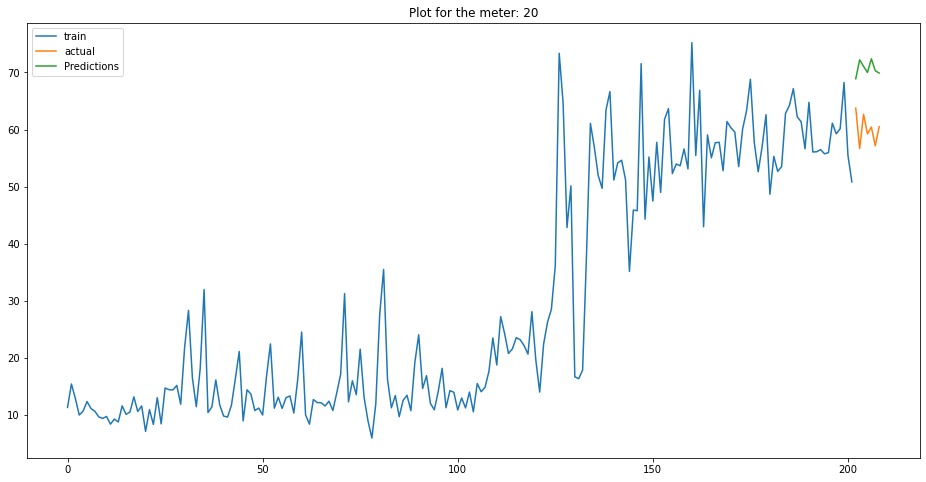

            ds       y
202 2021-07-22  63.753
203 2021-07-23  56.674
204 2021-07-24  62.667
205 2021-07-25  59.244
206 2021-07-26  60.446
207 2021-07-27  57.171
208 2021-07-28  60.499
            ds  Predictions
202 2021-07-22    68.902808
203 2021-07-23    72.213791
204 2021-07-24    71.073370
205 2021-07-25    70.013961
206 2021-07-26    72.396249
207 2021-07-27    70.311107
208 2021-07-28    69.899317
17.684836470459057


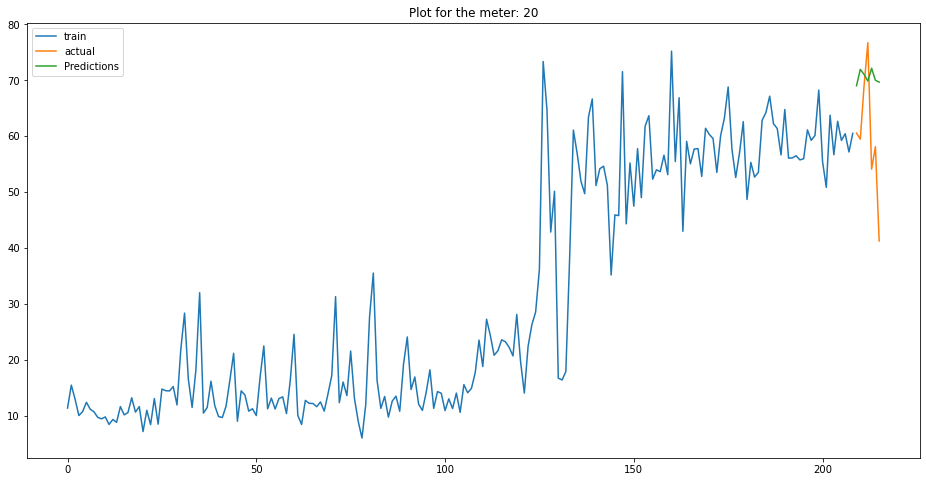

            ds       y
209 2021-07-29  60.561
210 2021-07-30  59.469
211 2021-07-31  69.034
212 2021-08-01  76.736
213 2021-08-02  54.101
214 2021-08-03  58.120
215 2021-08-04  41.241
            ds  Predictions
209 2021-07-29    69.028326
210 2021-07-30    71.963060
211 2021-07-31    71.059358
212 2021-08-01    69.864651
213 2021-08-02    72.156772
214 2021-08-03    70.010827
215 2021-08-04    69.670938
17.76739431467429
   mape_weekly  meterID    type
0       19.593       20  unflag
1       18.795       20  unflag
2       17.685       20  unflag
3       17.767       20  unflag


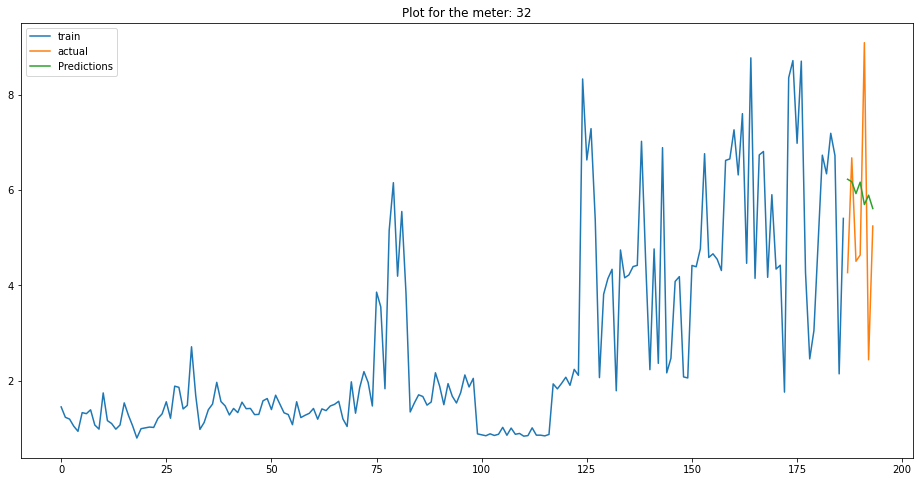

            ds      y
187 2021-07-07  4.266
188 2021-07-08  6.673
189 2021-07-09  4.504
190 2021-07-10  4.634
191 2021-07-11  9.088
192 2021-07-12  2.438
193 2021-07-13  5.243
            ds  Predictions
187 2021-07-07     6.224497
188 2021-07-08     6.172241
189 2021-07-09     5.923415
190 2021-07-10     6.162528
191 2021-07-11     5.693811
192 2021-07-12     5.889656
193 2021-07-13     5.610059
13.109175721530328


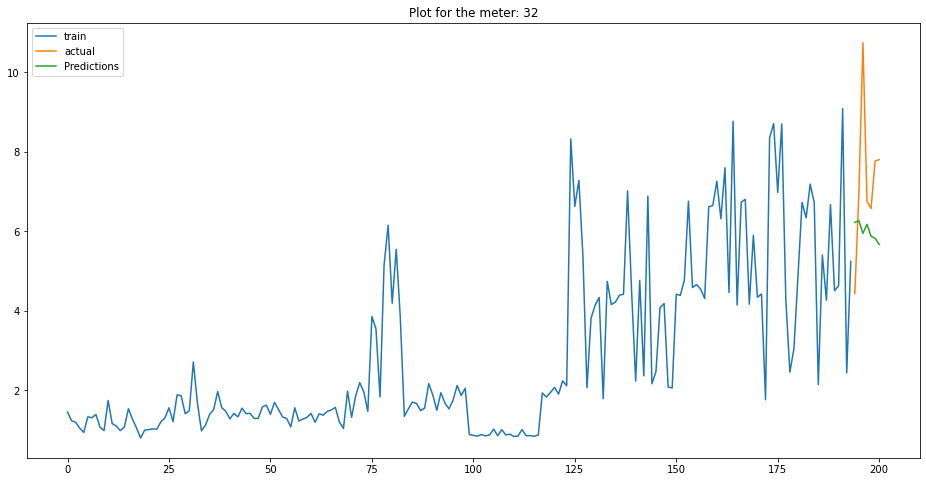

            ds       y
194 2021-07-14   4.435
195 2021-07-15   6.956
196 2021-07-16  10.749
197 2021-07-17   6.753
198 2021-07-18   6.576
199 2021-07-19   7.770
200 2021-07-20   7.805
            ds  Predictions
194 2021-07-14     6.228079
195 2021-07-15     6.264495
196 2021-07-16     5.948206
197 2021-07-17     6.176005
198 2021-07-18     5.877212
199 2021-07-19     5.825794
200 2021-07-20     5.669447
17.739130968433788


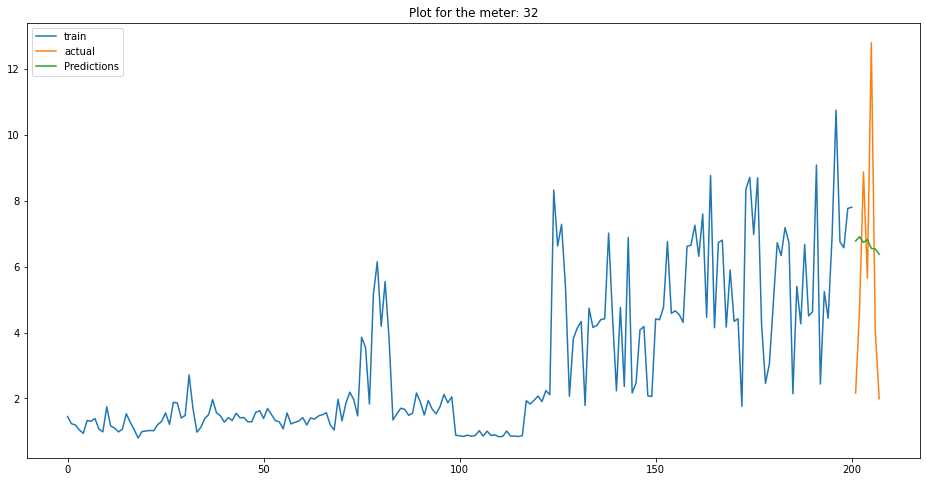

            ds       y
201 2021-07-21   2.161
202 2021-07-22   4.725
203 2021-07-23   8.876
204 2021-07-24   5.651
205 2021-07-25  12.802
206 2021-07-26   4.075
207 2021-07-27   1.990
            ds  Predictions
201 2021-07-21     6.780603
202 2021-07-22     6.910899
203 2021-07-23     6.736853
204 2021-07-24     6.823584
205 2021-07-25     6.554158
206 2021-07-26     6.539247
207 2021-07-27     6.376037
15.991512578341185


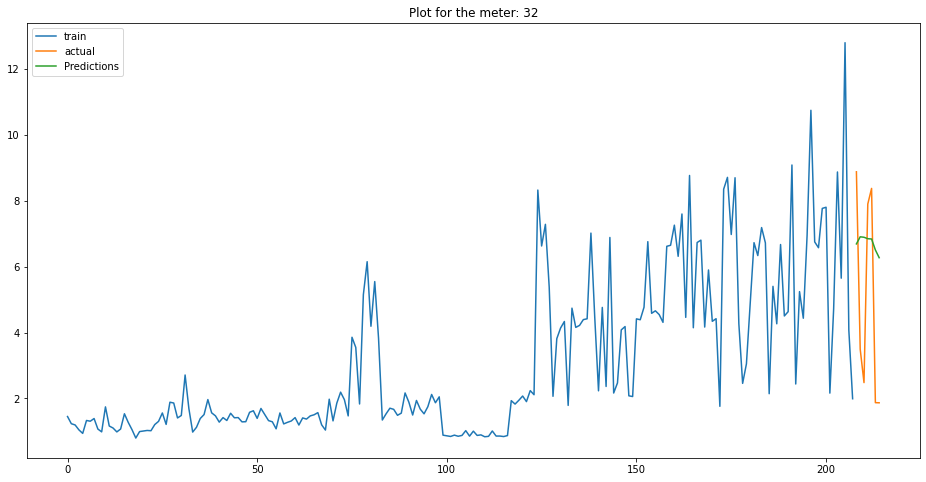

            ds      y
208 2021-07-28  8.882
209 2021-07-29  3.494
210 2021-07-30  2.480
211 2021-07-31  7.903
212 2021-08-01  8.377
213 2021-08-02  1.871
214 2021-08-03  1.867
            ds  Predictions
208 2021-07-28     6.692359
209 2021-07-29     6.907178
210 2021-07-30     6.893761
211 2021-07-31     6.849498
212 2021-08-01     6.840639
213 2021-08-02     6.508237
214 2021-08-03     6.272881
34.66924752038873
   mape_weekly  meterID    type
0       13.109       32  unflag
1       17.739       32  unflag
2       15.992       32  unflag
3       34.669       32  unflag


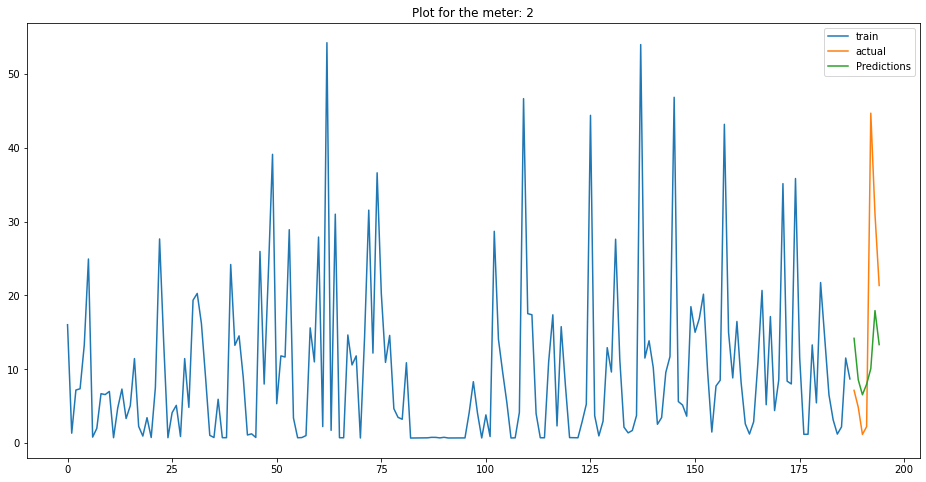

            ds       y
188 2021-07-08   7.144
189 2021-07-09   4.865
190 2021-07-10   1.182
191 2021-07-11   2.227
192 2021-07-12  44.668
193 2021-07-13  31.001
194 2021-07-14  21.342
            ds  Predictions
188 2021-07-08    14.190131
189 2021-07-09     8.579753
190 2021-07-10     6.550406
191 2021-07-11     7.976531
192 2021-07-12    10.082926
193 2021-07-13    17.946069
194 2021-07-14    13.339220
30.031364751922716


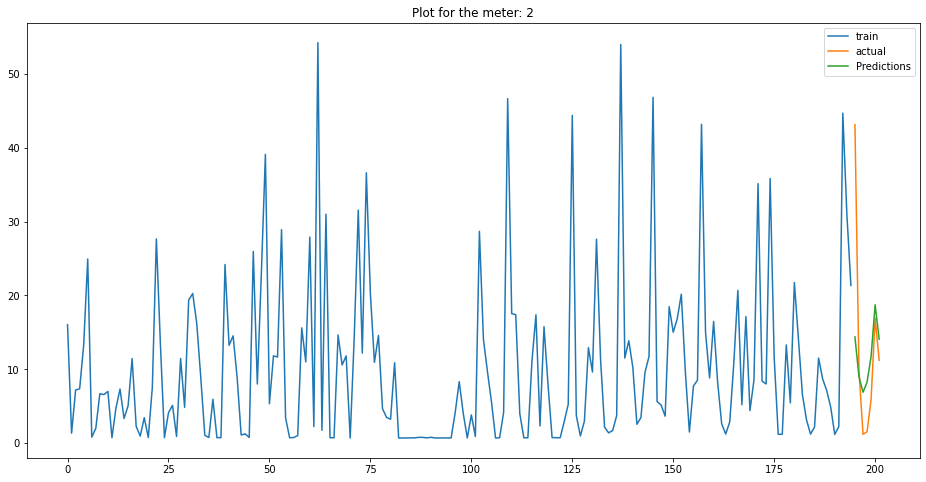

            ds       y
195 2021-07-15  43.093
196 2021-07-16   9.840
197 2021-07-17   1.206
198 2021-07-18   1.533
199 2021-07-19   5.933
200 2021-07-20  16.931
201 2021-07-21  11.226
            ds  Predictions
195 2021-07-15    14.379546
196 2021-07-16     8.975321
197 2021-07-17     6.890128
198 2021-07-18     8.245021
199 2021-07-19    11.744213
200 2021-07-20    18.729723
201 2021-07-21    14.074841
7.490037321328878


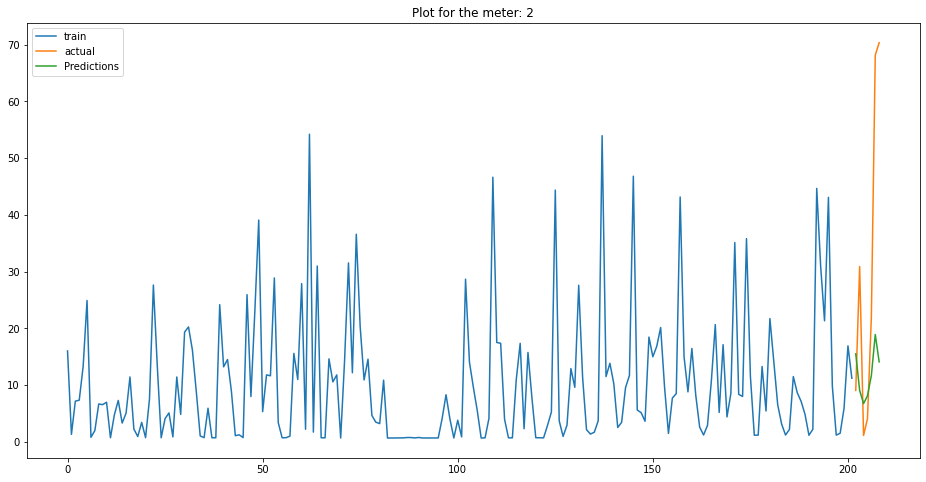

            ds       y
202 2021-07-22   9.087
203 2021-07-23  30.906
204 2021-07-24   1.143
205 2021-07-25   4.097
206 2021-07-26  21.992
207 2021-07-27  68.130
208 2021-07-28  70.335
            ds  Predictions
202 2021-07-22    15.531835
203 2021-07-23     9.066461
204 2021-07-24     6.757977
205 2021-07-25     8.127025
206 2021-07-26    11.712297
207 2021-07-27    18.924262
208 2021-07-28    14.109720
59.05023219090763


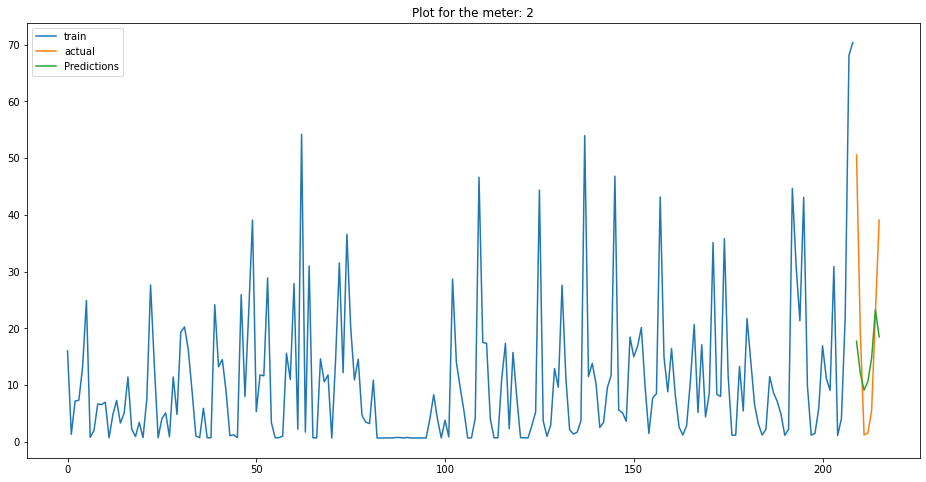

            ds       y
209 2021-07-29  50.571
210 2021-07-30  19.442
211 2021-07-31   1.250
212 2021-08-01   1.569
213 2021-08-02   5.530
214 2021-08-03  22.566
215 2021-08-04  39.086
            ds  Predictions
209 2021-07-29    17.757882
210 2021-07-30    12.141276
211 2021-07-31     9.106784
212 2021-08-01    10.647045
213 2021-08-02    14.765143
214 2021-08-03    23.280682
215 2021-08-04    18.511700
24.142933974471624
   mape_weekly  meterID    type
0       30.031        2  unflag
1        7.490        2  unflag
2       59.050        2    flag
3       24.143        2  unflag


In [889]:
for i in flatratelist_above365:
    account_and_days_billcycle_new(i,'FlatRate')